In [1]:
import os
import numpy as np
import requests
import math
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline
import sys
import timeit

import pyQEDA as pq
import sys
sys.path.append("/Users/chenjie/pyQEDA/pyscripts")
import pyQEDA_function_cj as pf
import pyQEDA_potential as pqp
import normalization_function as nf
import makeUniqueUgVector_cj as mu
import makeUniqueUgVector_3D_cj as mu_3D

import tensorflow as tf
from tensorflow.keras import layers, Model, backend
from tensorflow.keras import applications
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D, Reshape

-------------------------------------------------------------------------------------------------------------------

# I. Load the initial training set

1. load raw data:

(0.1443143799603049-3.469446951953614e-17j)  real: 0.1443143799603049  imag: -3.469446951953614e-17
5


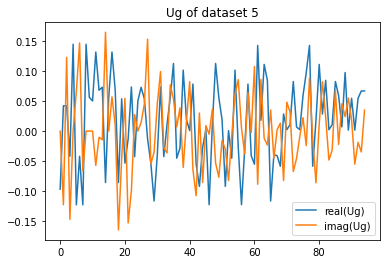

In [2]:
# load the structure vector Ug:
name = "normalized_ZnO_r8_test_makeunique_200"
File = "r8_test_makeunique"
Nx = 70

Ug = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/My_labels_" + name + ".csv", dtype=complex) 

dataset = 5
print(Ug[dataset,4],' real:',np.real(Ug[dataset,4]),' imag:',np.imag(Ug[dataset,4]))
re = np.real(Ug[dataset,:])
im = np.imag(Ug[dataset,:])

plt.plot(re,label='real(Ug)')
plt.plot(im,label='imag(Ug)')
plt.legend()
plt.title('Ug of dataset '+str(dataset))
np.imag(Ug[dataset,:])-np.imag(Ug[dataset+1,:])
print(dataset)

thickness of dataset 5: 987.0


Text(0.5, 1.0, 'thickness')

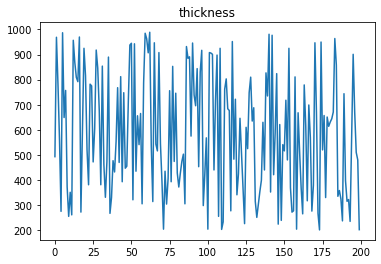

In [3]:
# load the thickness t:
t = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/My_thickness_" + name + ".csv", dtype=float) 
print('thickness of dataset '+str(dataset)+':', t[dataset])
plt.plot(t)
plt.title('thickness')

shape of the diffraction pattern:  (4900,)
X.max()=  0.9796883914151951


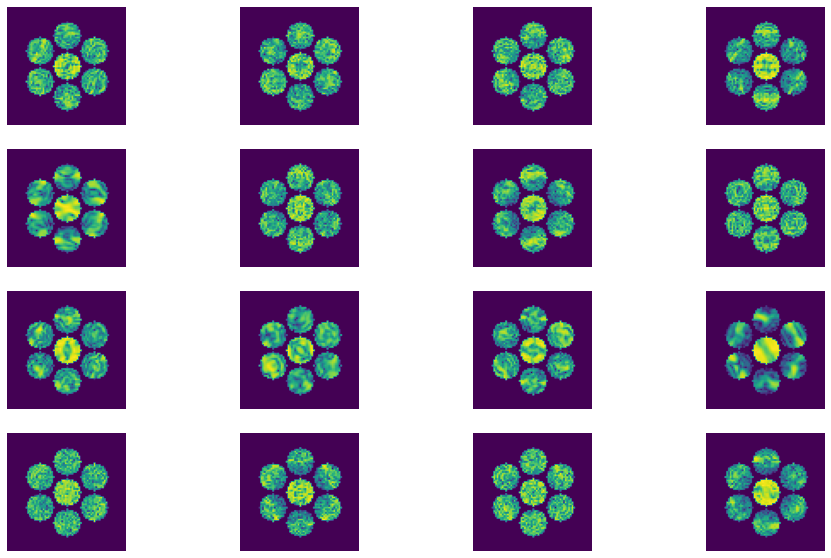

In [4]:
# load the raw data of diffraction Pattern X:
X = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/random_diffs_" + name + ".csv", dtype=float) 
print('shape of the diffraction pattern: ', X[dataset].shape)

# reshape the Pixels Array(for that they were saved as flatten array):
X = X.reshape(len(X),Nx,Nx,1)

def nlogf(x):
    return np.log(1+1000*x)
nlog = np.vectorize(nlogf)

nlogf_X = nlogf(X)

# plot first few Diffraction Pattern:
Ncol = 4
Nrow = 4
fig,ax=plt.subplots(Nrow,Ncol,figsize=(16,10))
for j in range(Ncol*Nrow):
    plt.subplot(Nrow,Ncol,j+1)
    plt.imshow(nlogf_X[j])
    plt.axis('off')
    
print("X.max()= ", X.max())

2. Data processing:

shape of Ug_2real: (200, 95, 2)


Text(0.5, 1.0, 'first 2 sets of imag.parts of the Ug')

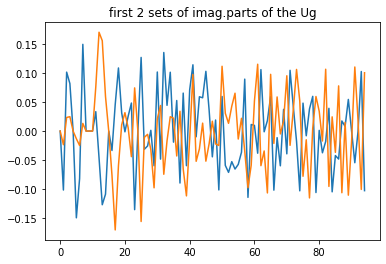

In [5]:
# Ug processing:
Ug_2real =[]
for i in range(0,len(Ug)):
    Ug_2real.append(np.concatenate((np.array(Ug[i].real,ndmin=2).T, np.array(Ug[i].imag,ndmin=2).T),axis=1))    
Ug_2real = np.asarray(Ug_2real)

numUg = Ug_2real.shape[1]
print('shape of Ug_2real:', Ug_2real.shape)

# Plot the first 2 sets of imaginary parts of the structure factors:
plt.plot(Ug_2real[0,:,1])
plt.plot(Ug_2real[1,:,1])
plt.title('first 2 sets of imag.parts of the Ug')

shape of Ug_2real: (200, 190)


Text(0.5, 1.0, 'Ug of dataset 5')

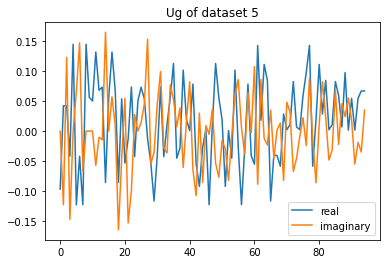

In [6]:
# combine real and imaginary numbers into one row:
# This interlaces real and imaginary numbers. 
Ug_2real = Ug_2real.reshape(-1,2*numUg)
print('shape of Ug_2real:',Ug_2real.shape)

plt.plot(Ug_2real[dataset,0:2*numUg:2],label='real')
plt.plot(Ug_2real[dataset,1:2*numUg:2],label='imaginary')
plt.legend()
plt.title('Ug of dataset '+str(dataset))

In [7]:
# normalize the thickness
t = t.astype('float32')
t = t/1000
t = t.reshape(len(t),1)

print('thickness of dataset' +str(dataset) + ':', t[dataset])

thickness of dataset5: [0.987]


In [8]:
# join Ug and t into Output(Y):
Y = np.append(Ug_2real,t,axis=1)
print('Dataset size: \n Input X:',X.shape,'Output Y:',Y.shape)

Dataset size: 
 Input X: (200, 70, 70, 1) Output Y: (200, 191)


3. define the size of training set and testing set:

In [9]:
trainsize = 150
testsize = 50
X_train = nlogf_X[:trainsize,]
X_test = nlogf_X[trainsize:trainsize+testsize,]
Y_train = Y[:trainsize,]
Y_test = Y[trainsize:trainsize+testsize,]

4. load the experimental Data:

the shape of the experimental pattern:  (1, 70, 70, 1)
0.9742559258987338


Text(0.5, 1.0, 'experimental Pattern')

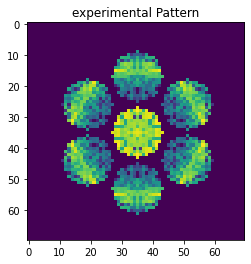

In [10]:
X_exp = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/diff_pattern_" + name + ".csv", dtype=float) 
X_exp = X_exp.reshape(1,Nx,Nx,1)
print('the shape of the experimental pattern: ',X_exp.shape)
print(X_exp.max())

nlogf_X_exp = nlogf(X_exp)
plt.imshow(nlogf_X_exp[0])
plt.title('experimental Pattern')

In [11]:
X_train.max(), nlogf_X_exp.max(), Y_train.max(), X.max(), X_exp.max()

(6.888254765288546,
 6.882699924655138,
 0.9890000224113464,
 0.9796883914151951,
 0.9742559258987338)

---------------------------------------------------------------------------------------------------------------

# II. Build the neural network

In [12]:
backend.clear_session()

num_of_features = 2*numUg+1

# invert the Input to the form which can be used in the ResNet50 Model
target_size = X_train.shape[1:3]
input_size = (*target_size, 3)

# insert ResNet50 Model
base_model = applications.ResNet50(include_top=False, weights='imagenet', input_shape=input_size)  

# combine the ResNet50 model with my model
x = Flatten()(base_model.output)
x = Dense(num_of_features*16, activation='tanh')(x)
x = Dense(num_of_features*4, activation='tanh')(x)
x = Dense(num_of_features, activation='tanh')(x)
x = Dense(num_of_features, activation='tanh')(x)
model = Model(inputs=base_model.input, outputs=x)

# remove the output layer and replaced it with the regression output layer we want in ResNet50
# keep the weights of the first 49 layers of the ResNet50 model unchanged during the training process 
for layer in base_model.layers[:-1]:
    layer.trainable = False

model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 70, 70, 3)]  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 76, 76, 3)    0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 35, 35, 64)   9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 35, 35, 64)   256         conv1_conv[0][0]                 
______________________________________________________________________________________________

In [13]:
opt = tf.keras.optimizers.Adam(lr=0.001) 
model.compile(loss='mse', optimizer=opt, metrics='acc')

#save the model
model.save(name + ".h5")

train the NN without iteration to have a check:

Epoch 1/10
8/8 [==============================] - 5s 361ms/step - loss: 0.2278 - acc: 0.0000e+00 - val_loss: 0.0843 - val_acc: 0.0000e+00
Epoch 2/10
8/8 [==============================] - 2s 228ms/step - loss: 0.0579 - acc: 0.8667 - val_loss: 0.0335 - val_acc: 0.9800
Epoch 3/10
8/8 [==============================] - 2s 228ms/step - loss: 0.0227 - acc: 1.0000 - val_loss: 0.0176 - val_acc: 0.9800
Epoch 4/10
8/8 [==============================] - 2s 229ms/step - loss: 0.0133 - acc: 1.0000 - val_loss: 0.0096 - val_acc: 0.9800
Epoch 5/10
8/8 [==============================] - 2s 229ms/step - loss: 0.0089 - acc: 1.0000 - val_loss: 0.0069 - val_acc: 0.9800
Epoch 6/10
8/8 [==============================] - 2s 232ms/step - loss: 0.0067 - acc: 1.0000 - val_loss: 0.0063 - val_acc: 0.9800
Epoch 7/10
8/8 [==============================] - 2s 233ms/step - loss: 0.0059 - acc: 1.0000 - val_loss: 0.0058 - val_acc: 0.9800
Epoch 8/10
8/8 [==============================] - 2s 232ms/step - loss: 0.0056 - a

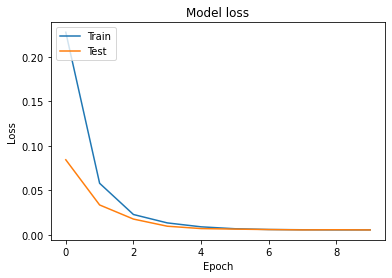

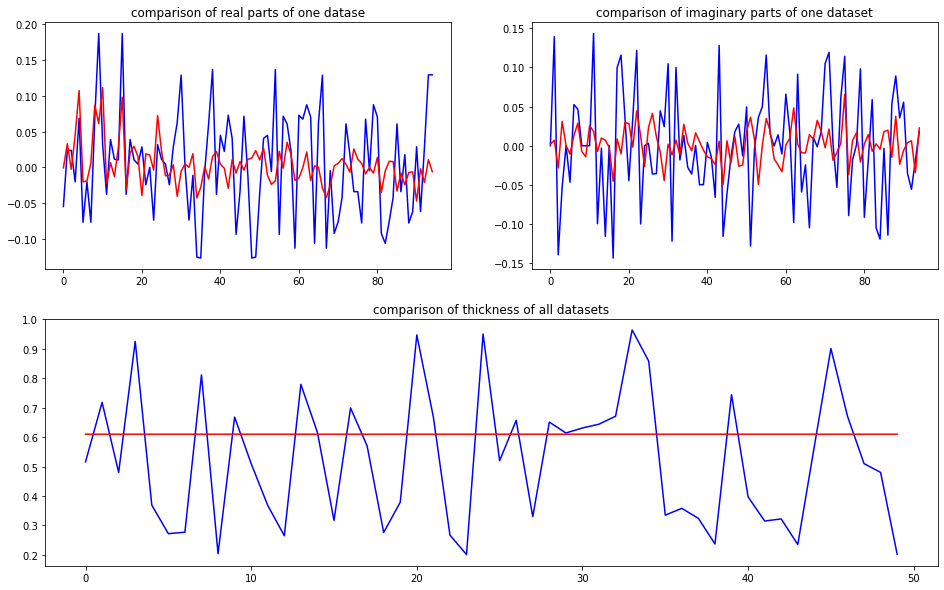

predicted thickness: 0.60988337


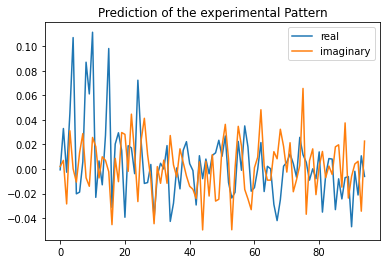

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_makeunique/r8_test_makeunique/r8_test_makeunique.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=609.8833680152893
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00064241+0.00000000e+00j  0.0152124 +1.77273436e-02j
  0.0152124 -1.77273436e-02j  0.01324154+8.93602753e-03j
  0.09707061+3.66474944e-03j -0.00713502-1.97662222e-02j
 

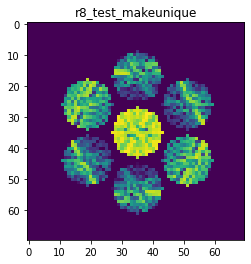

X_sim1.max():  0.9852678385505265
nlogf_X_sim1.max():  6.893927959246729
Time:  24.574434008


In [14]:
start = timeit.default_timer()

# load and compile the model
model = load_model(name + ".h5")


# invert the 1 channel image Array to 3 Channel, to use ResNet50
X_train_3C = np.concatenate((X_train,X_train,X_train),axis=3) #same value for every channel
X_test_3C = np.concatenate((X_test,X_test,X_test),axis=3)

# train the model
#model.fit(X_train, Y_train, validation_data=(X_test, Y_test), batch_size=20, epochs=20)
model.fit(X_train_3C, Y_train, validation_data=(X_test_3C, Y_test), batch_size=20, epochs=10)

# plot the model loss
plt.plot(model.history.history['loss'])
plt.plot(model.history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
#plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Model_Loss' + '/' + 'Model_Loss{0:d}.png'.format(i))
plt.show()
plt.close()
    

# Prediction of the testing set
Y_test_pred = model.predict(X_test_3C)    
Ug_test_pred_complex = Y_test_pred[:,:2*numUg].reshape(-1,numUg,2)
Ug_test_complex = Y_test[:,:2*numUg].reshape(-1,numUg,2)    
t_test_pred = Y_test_pred[:,2*numUg]
t_test = Y_test[:,2*numUg]
    
# plot the comparison of imaginary parts, real parts and thickness
gs = gridspec.GridSpec(2, 2)
fig = plt.figure(figsize=(16,10))
    
ax1 = fig.add_subplot(gs[0, 0]) 
ax1.plot(Ug_test_complex[2,:,0],'b')
ax1.plot(Ug_test_pred_complex[2,:,0],'r')
ax1.set_title('comparison of real parts of one datase')
    
ax2 = fig.add_subplot(gs[0, 1]) 
ax2.plot(Ug_test_complex[2,:,1],'b')
ax2.plot(Ug_test_pred_complex[2,:,1],'r')
ax2.set_title('comparison of imaginary parts of one dataset')
    
ax3 = fig.add_subplot(gs[1, :])
ax3.plot(t_test[:],'b')
ax3.plot(t_test_pred[:],'r')
ax3.set_title('comparison of thickness of all datasets')
#plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Comparison' + '/' + 'My_Comparison{0:d}.png'.format(i))
plt.show()
plt.close()
    
    
# Prediction of the experimental Pattern
X_exp_3C = np.concatenate((nlogf_X_exp,nlogf_X_exp,nlogf_X_exp),axis=3) #X_exp.shape=(1,70,70,1); X_exp_3C.shape=(1,70,70,3)
Y_exp_pred = model.predict(X_exp_3C) #Y_exp_pred = (1,191)
    
Ug_t_exp_pred = Y_exp_pred[0,:] #Ug_t_exp_pred.shape=(191,)
Ug_exp_pred = Ug_t_exp_pred[0:2*numUg] #Ug_exp_pred.shape=(190,)
t_exp_pred = Ug_t_exp_pred[2*numUg]
if t_exp_pred < 0 or t_exp_pred > 1:
    t_exp_pred = np.random.randint(200,1001)/1000
    print("wrong thickness, use random thickness", t_exp_pred)
else:
    print("predicted thickness:", t_exp_pred)
    

# plot the results
plt.plot(Ug_exp_pred[0:2*numUg:2],label='real')
plt.plot(Ug_exp_pred[1:2*numUg:2],label='imaginary')
plt.legend()
plt.title('Prediction of the experimental Pattern')
#plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Prediction' + '/' + 'Ug{0:d}.png'.format(i))
plt.show()
plt.close()
    
# normalization
Ug_pred = np.array(range( np.int((Ug_t_exp_pred.size - 1)/2) ), dtype=complex)
Ug_pred.real = Ug_t_exp_pred[0:-1:2]
Ug_pred.imag = Ug_t_exp_pred[1:-1:2]

Ug_pred_normalized = nf.normalization(file=File, origin_Ug=Ug_pred)
Ug_pred_normalized = np.asarray(Ug_pred_normalized)

# reshape
Ug_pred_normalized_2real = np.concatenate((np.array(Ug_pred_normalized.real,ndmin=2).T, np.array(Ug_pred_normalized.imag,ndmin=2).T),axis=1)  
Ug_pred_normalized_2real = np.asarray(Ug_pred_normalized_2real)
Ug_t_pred_normalized_2real = np.append(Ug_pred_normalized_2real.reshape(numUg*2), Ug_t_exp_pred[-1])

# Compute the LARBED pattern: X_sim, from the predicted {Ug,t}: Y_exp_pred
file = File+".qed"
X_sim1 = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg=Ug_t_pred_normalized_2real, InputUgdoFlip=False)
X_sim1 = X_sim1.reshape(Nx,Nx,1)
nlogf_X_sim1 = nlogf(X_sim1)
print("X_sim1.max(): ", X_sim1.max())
print("nlogf_X_sim1.max(): ", nlogf_X_sim1.max())

    
stop = timeit.default_timer()
print('Time: ', stop - start)

Applied shift of unit cell origin (fractional coordinates): 0.01183679681571384 -0.09448160760974157 -0.13712794419318491
Ug[ 0 ]: 0.00064 3.14159  =>  0.00064 3.14159
Ug[ 1 ]: 0.02336 0.8616  =>  0.02336 -0.0
Ug[ 2 ]: 0.02336 -0.8616  =>  0.02336 0.0
Ug[ 3 ]: 0.01597 0.59365  =>  0.01597 0.0
Ug[ 4 ]: 0.09714 0.03774  =>  0.09714 -1.41751
Ug[ 5 ]: 0.02101 -1.91721  =>  0.02101 -1.64926
Ug[ 6 ]: 0.01597 -0.59365  =>  0.01597 -0.0
Ug[ 7 ]: 0.02101 1.91721  =>  0.02101 1.64926
Ug[ 8 ]: 0.09714 -0.03774  =>  0.09714 1.41751
Ug[ 9 ]: 0.07991 -0.07437  =>  0.07991 -0.0
Ug[ 10 ]: 0.09555 0.27685  =>  0.09555 -0.51038
Ug[ 11 ]: 0.04182 2.27928  =>  0.04182 -3.06794
Ug[ 12 ]: 0.01567 -0.53512  =>  0.01567 0.1329
Ug[ 13 ]: 0.00833 -0.93021  =>  0.00833 -1.12379
Ug[ 14 ]: 0.02984 0.29495  =>  0.02984 1.82457
Ug[ 15 ]: 0.07991 0.07437  =>  0.07991 0.0
Ug[ 16 ]: 0.04182 -2.27928  =>  0.04182 3.06794
Ug[ 17 ]: 0.01567 0.53512  =>  0.01567 -0.1329
Ug[ 18 ]: 0.02984 -0.29495  =>  0.02984 -1.82457
Ug[ 

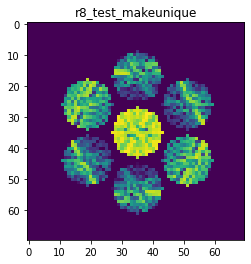

X_sim2.max():  0.9852678385505255
nlogf_X_sim2.max():  6.893927959246728


In [15]:
# make unique Ug
UgUnique, r0 = mu_3D.makeUniqueUgVector(Ug_pred_normalized,1,6,9,file = File)

# reshape
UgUnique_2real = np.concatenate((np.array(UgUnique.real,ndmin=2).T, np.array(UgUnique.imag,ndmin=2).T),axis=1)  
UgUnique_2real = np.asarray(UgUnique_2real)
UgUnique_t_2real = np.append(UgUnique_2real.reshape(numUg*2), Ug_t_exp_pred[-1])

# Compute the LARBED pattern: X_sim, from the predicted {Ug,t}: Y_exp_pred
X_sim2 = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg=UgUnique_t_2real, InputUgdoFlip=False)
X_sim2 = X_sim2.reshape(Nx,Nx,1)
nlogf_X_sim2 = nlogf(X_sim2)
print("X_sim2.max(): ", X_sim2.max())
print("nlogf_X_sim2.max(): ", nlogf_X_sim2.max())

In [16]:
(X_sim2[:]-X_sim1[:]).mean()

1.4889170039232908e-17

In [17]:
print('the ture thickness: 500')
print('the predicted thickness:',Ug_t_exp_pred[-1]*1000)

the ture thickness: 500
the predicted thickness: 609.8833680152893


In [18]:
simulation_pattern = np.asarray(X_sim2)
print('the shape of the simulated pattern', X_sim2.shape)
print('the shape of the experimental pattern', X_exp.shape)

the shape of the simulated pattern (70, 70, 1)
the shape of the experimental pattern (1, 70, 70, 1)


Text(0.5, 1.0, 'experimental Pattern')

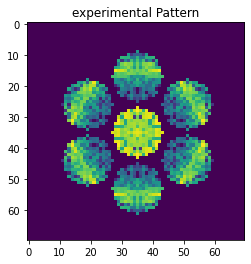

In [19]:
# plot the experimental Pattern:
plt.imshow(nlogf_X_exp[0])
plt.title('experimental Pattern')

Text(0.5, 1.0, 'simulation pattern')

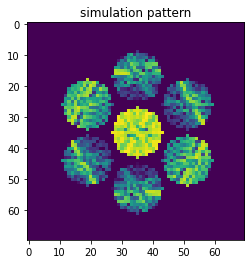

In [20]:
# plot the final simulated Pattern:
plt.imshow(nlogf_X_sim2)
plt.title("simulation pattern")

R-factor:  0.6994510787422217


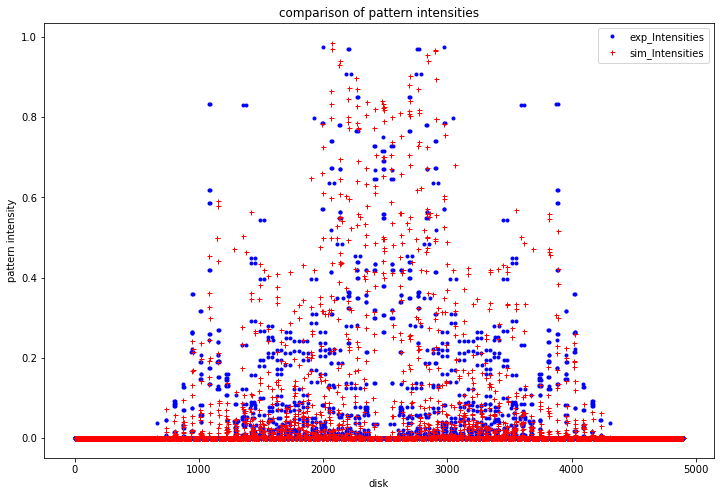

In [21]:
exp_Intensities = X_exp[0].reshape(Nx*Nx)
sim_Intensities = X_sim2.reshape(Nx*Nx)
R = np.sum(np.abs(sim_Intensities - exp_Intensities))/np.sum(exp_Intensities)
print("R-factor: ", R)    
plt.figure(figsize=(12,8))
plt.plot(exp_Intensities, "bo", markersize=3, label="exp_Intensities")
plt.plot(sim_Intensities, "r+", markersize=5, label="sim_Intensities")
plt.legend()
plt.xlabel("disk")
plt.ylabel("pattern intensity")
plt.title("comparison of pattern intensities")
plt.show()

-------------------------------------------------------------------------------------------------------------------

# III. Replace the initial training set with new training set

>>>train the initial training set:
Epoch 1/10
8/8 [==============================] - 4s 326ms/step - loss: 0.2312 - acc: 0.6000 - val_loss: 0.0923 - val_acc: 0.9800
Epoch 2/10
8/8 [==============================] - 2s 231ms/step - loss: 0.0638 - acc: 1.0000 - val_loss: 0.0351 - val_acc: 0.9800
Epoch 3/10
8/8 [==============================] - 2s 232ms/step - loss: 0.0239 - acc: 1.0000 - val_loss: 0.0182 - val_acc: 0.9800
Epoch 4/10
8/8 [==============================] - 2s 234ms/step - loss: 0.0144 - acc: 1.0000 - val_loss: 0.0106 - val_acc: 0.9800
Epoch 5/10
8/8 [==============================] - 2s 227ms/step - loss: 0.0094 - acc: 1.0000 - val_loss: 0.0088 - val_acc: 0.9800
Epoch 6/10
8/8 [==============================] - 2s 233ms/step - loss: 0.0075 - acc: 1.0000 - val_loss: 0.0074 - val_acc: 0.9800
Epoch 7/10
8/8 [==============================] - 2s 234ms/step - loss: 0.0065 - acc: 1.0000 - val_loss: 0.0066 - val_acc: 0.9800
Epoch 8/10
8/8 [==============================] - 2s 23

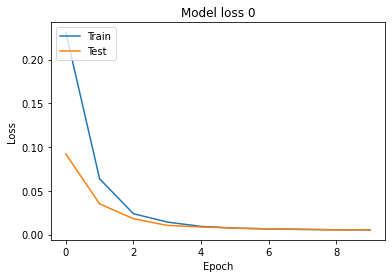

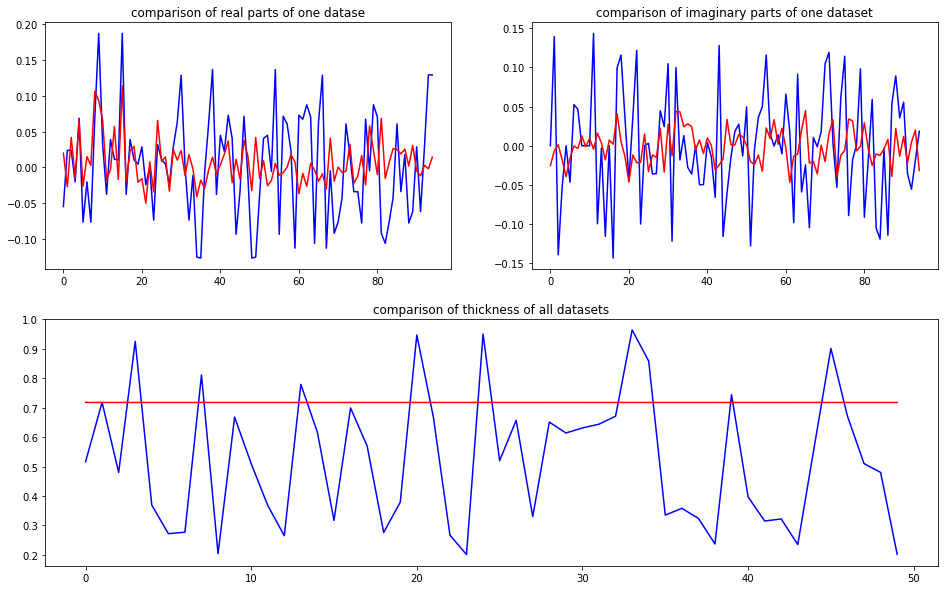

predicted thickness: 0.71772313


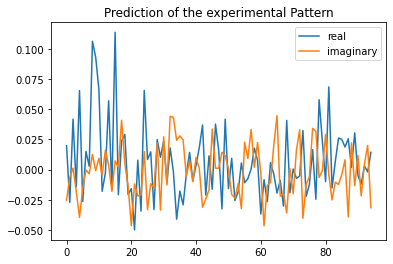

Applied shift of unit cell origin (fractional coordinates): 0.0065260632808817895 0.24236061306460227 0.07515310546649454
Ug[ 0 ]: 0.01997 0.0  =>  0.01997 0.0
Ug[ 1 ]: 0.00838 -0.4722  =>  0.00838 -0.0
Ug[ 2 ]: 0.00838 0.4722  =>  0.00838 0.0
Ug[ 3 ]: 0.00888 -1.5228  =>  0.00888 -0.0
Ug[ 4 ]: 0.09058 -0.29449  =>  0.09058 1.70051
Ug[ 5 ]: 0.01322 -2.66533  =>  0.01322 -1.61474
Ug[ 6 ]: 0.00888 1.5228  =>  0.00888 0.0
Ug[ 7 ]: 0.01322 2.66533  =>  0.01322 1.61474
Ug[ 8 ]: 0.09058 0.29449  =>  0.09058 -1.70051
Ug[ 9 ]: 0.10452 -0.041  =>  0.10452 0.0
Ug[ 10 ]: 0.0664 -0.04182  =>  0.0664 0.47139
Ug[ 11 ]: 0.01965 -2.97863  =>  0.01965 2.87335
Ug[ 12 ]: 0.01635 -0.86923  =>  0.01635 -2.35102
Ug[ 13 ]: 0.03771 0.51167  =>  0.03771 -0.49792
Ug[ 14 ]: 0.01323 -1.07547  =>  0.01323 -3.02946
Ug[ 15 ]: 0.10452 0.041  =>  0.10452 0.0
Ug[ 16 ]: 0.01965 2.97863  =>  0.01965 -2.87335
Ug[ 17 ]: 0.01635 0.86923  =>  0.01635 2.35102
Ug[ 18 ]: 0.01323 1.07547  =>  0.01323 3.02946
Ug[ 19 ]: 0.00311 -2

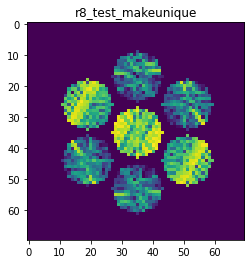

X_sim.max(): 0.979778551098654
nlogf_X_sim.max(): 6.888346696160862
>>>replaced the 1. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 340ms/step - loss: 0.0054 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 246ms/step - loss: 0.0054 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 247ms/step - loss: 0.0054 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 1.0000


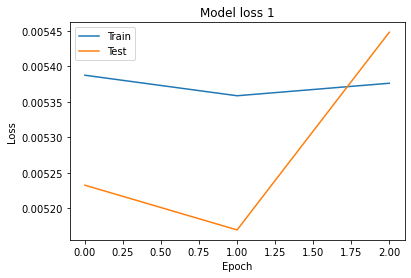

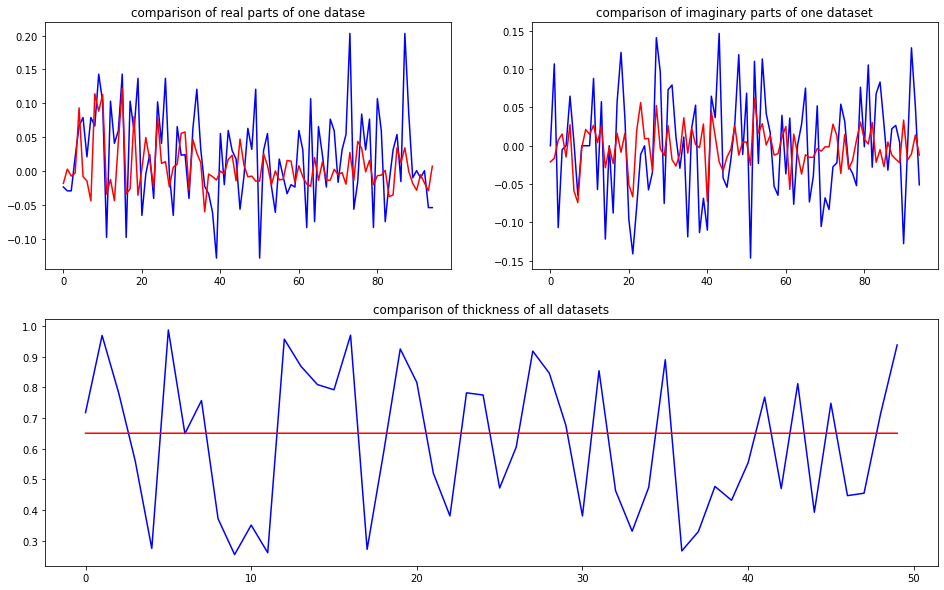

predicted thickness: 0.65040183


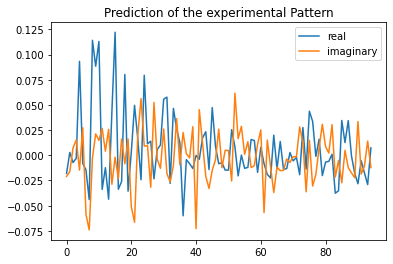

Applied shift of unit cell origin (fractional coordinates): -0.01794418708138451 -0.2874731099170762 0.2794073028165948
Ug[ 0 ]: 0.0181 3.14159  =>  0.0181 3.14159
Ug[ 1 ]: 0.01201 -1.75557  =>  0.01201 -0.0
Ug[ 2 ]: 0.01201 1.75557  =>  0.01201 0.0
Ug[ 3 ]: 0.03822 1.80625  =>  0.03822 -0.0
Ug[ 4 ]: 0.10289 -0.05759  =>  0.10289 -0.10827
Ug[ 5 ]: 0.0574 2.04689  =>  0.0574 -1.51493
Ug[ 6 ]: 0.03822 -1.80625  =>  0.03822 0.0
Ug[ 7 ]: 0.0574 -2.04689  =>  0.0574 1.51493
Ug[ 8 ]: 0.10289 0.05759  =>  0.10289 0.10827
Ug[ 9 ]: 0.10491 0.11275  =>  0.10491 -0.0
Ug[ 10 ]: 0.09537 0.02684  =>  0.09537 1.66966
Ug[ 11 ]: 0.04208 2.50816  =>  0.04208 0.63984
Ug[ 12 ]: 0.02017 -2.83722  =>  0.02017 -1.14372
Ug[ 13 ]: 0.01811 2.6825  =>  0.01811 -0.15162
Ug[ 14 ]: 0.06189 -0.1625  =>  0.06189 -0.22457
Ug[ 15 ]: 0.10491 -0.11275  =>  0.10491 0.0
Ug[ 16 ]: 0.04208 -2.50816  =>  0.04208 -0.63984
Ug[ 17 ]: 0.02017 2.83722  =>  0.02017 1.14372
Ug[ 18 ]: 0.06189 0.1625  =>  0.06189 0.22457
Ug[ 19 ]: 0.0

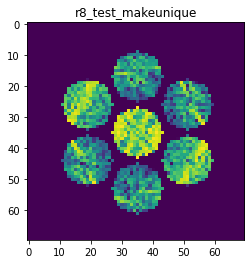

X_sim.max(): 0.9457326958174324
nlogf_X_sim.max(): 6.853016789157708
>>>replaced the 2. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 333ms/step - loss: 0.0054 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 240ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 235ms/step - loss: 0.0054 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 1.0000


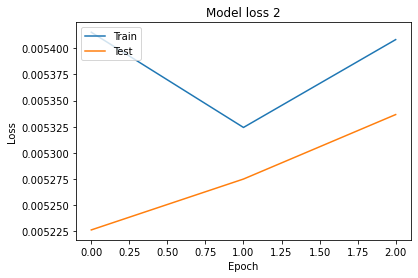

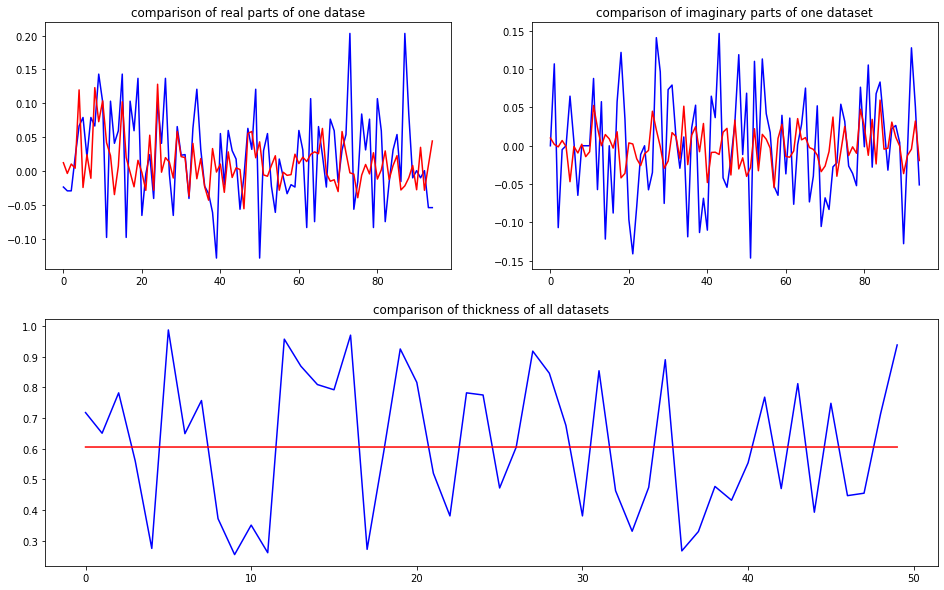

predicted thickness: 0.605485


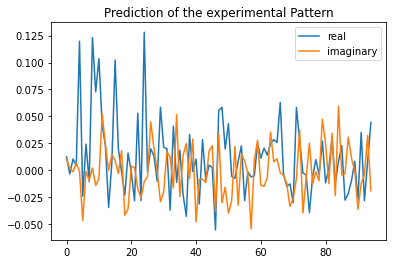

Applied shift of unit cell origin (fractional coordinates): 0.021123884562986042 -0.04254753246437434 -0.06985666080688488
Ug[ 0 ]: 0.01238 0.0  =>  0.01238 0.0
Ug[ 1 ]: 0.00383 0.43892  =>  0.00383 0.0
Ug[ 2 ]: 0.00383 -0.43892  =>  0.00383 -0.0
Ug[ 3 ]: 0.01483 0.26733  =>  0.01483 0.0
Ug[ 4 ]: 0.12224 -0.01263  =>  0.12224 -0.71889
Ug[ 5 ]: 0.02546 -2.31786  =>  0.02546 -2.14627
Ug[ 6 ]: 0.01483 -0.26733  =>  0.01483 -0.0
Ug[ 7 ]: 0.02546 2.31786  =>  0.02546 2.14627
Ug[ 8 ]: 0.12224 0.01263  =>  0.12224 0.71889
Ug[ 9 ]: 0.08876 -0.13273  =>  0.08876 -0.0
Ug[ 10 ]: 0.11657 0.01017  =>  0.11657 -0.29603
Ug[ 11 ]: 0.04172 0.73146  =>  0.04172 1.3031
Ug[ 12 ]: 0.01089 0.25178  =>  0.01089 0.65184
Ug[ 13 ]: 0.01836 2.97156  =>  0.01836 2.9327
Ug[ 14 ]: 0.02923 1.84088  =>  0.02923 2.67986
Ug[ 15 ]: 0.08876 0.13273  =>  0.08876 0.0
Ug[ 16 ]: 0.04172 -0.73146  =>  0.04172 -1.3031
Ug[ 17 ]: 0.01089 -0.25178  =>  0.01089 -0.65184
Ug[ 18 ]: 0.02923 -1.84088  =>  0.02923 -2.67986
Ug[ 19 ]: 0.

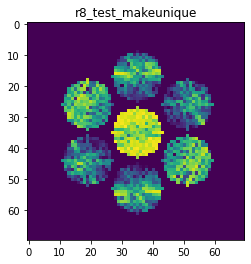

X_sim.max(): 0.9641410952502824
nlogf_X_sim.max(): 6.872274303345545
>>>replaced the 3. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 345ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0053 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 255ms/step - loss: 0.0054 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 254ms/step - loss: 0.0054 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000


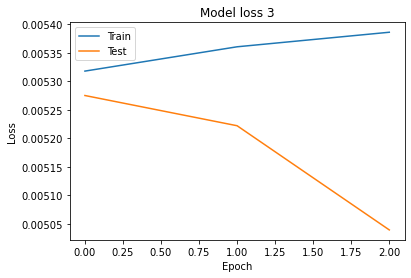

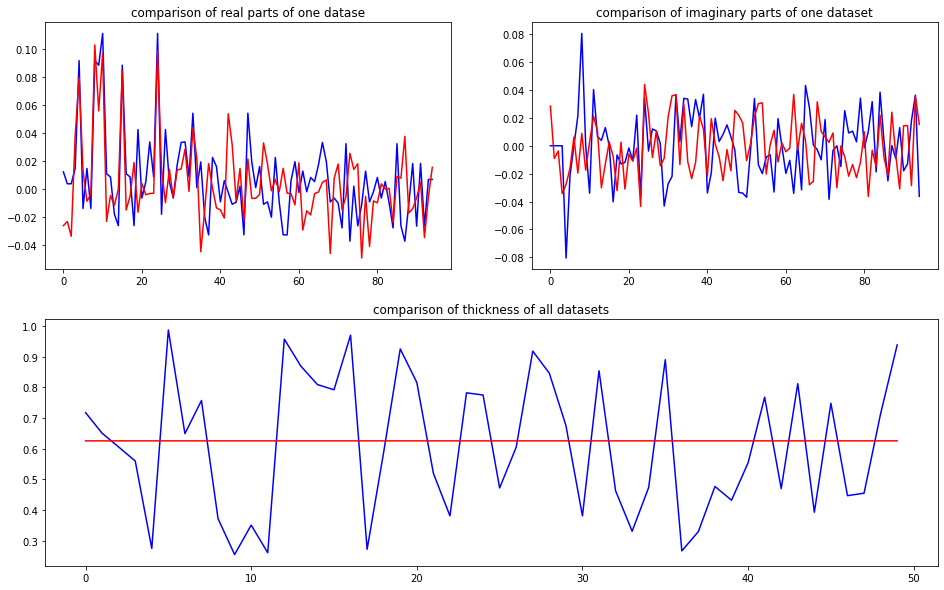

predicted thickness: 0.6255186


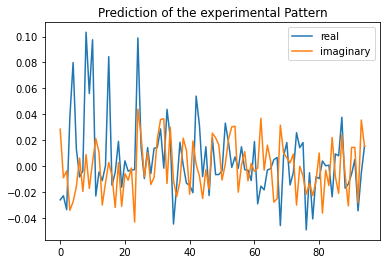

Applied shift of unit cell origin (fractional coordinates): 0.02289284790626788 0.14821061019252843 0.4848815822506437
Ug[ 0 ]: 0.02608 3.14159  =>  0.02608 3.14159
Ug[ 1 ]: 0.02849 -3.0466  =>  0.02849 0.0
Ug[ 2 ]: 0.02849 3.0466  =>  0.02849 0.0
Ug[ 3 ]: 0.02503 -0.93123  =>  0.02503 0.0
Ug[ 4 ]: 0.09431 -0.19676  =>  0.09431 -2.50211
Ug[ 5 ]: 0.0051 0.36004  =>  0.0051 -1.75533
Ug[ 6 ]: 0.02503 0.93123  =>  0.02503 -0.0
Ug[ 7 ]: 0.0051 -0.36004  =>  0.0051 1.75533
Ug[ 8 ]: 0.09431 0.19676  =>  0.09431 2.50211
Ug[ 9 ]: 0.07148 -0.14384  =>  0.07148 0.0
Ug[ 10 ]: 0.10138 -0.20474  =>  0.10138 2.9857
Ug[ 11 ]: 0.02387 2.48918  =>  0.02387 -0.41358
Ug[ 12 ]: 0.02179 1.78978  =>  0.02179 1.00239
Ug[ 13 ]: 0.0268 -1.50949  =>  0.0268 0.74972
Ug[ 14 ]: 0.01242 -0.68311  =>  0.01242 1.76608
Ug[ 15 ]: 0.07148 0.14384  =>  0.07148 0.0
Ug[ 16 ]: 0.02387 -2.48918  =>  0.02387 0.41358
Ug[ 17 ]: 0.02179 -1.78978  =>  0.02179 -1.00239
Ug[ 18 ]: 0.01242 0.68311  =>  0.01242 -1.76608
Ug[ 19 ]: 0.017

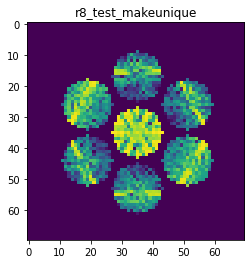

X_sim.max(): 0.9290236388995107
nlogf_X_sim.max(): 6.835210003995782
>>>replaced the 4. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 349ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 261ms/step - loss: 0.0054 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 255ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000


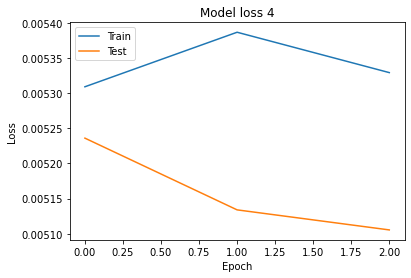

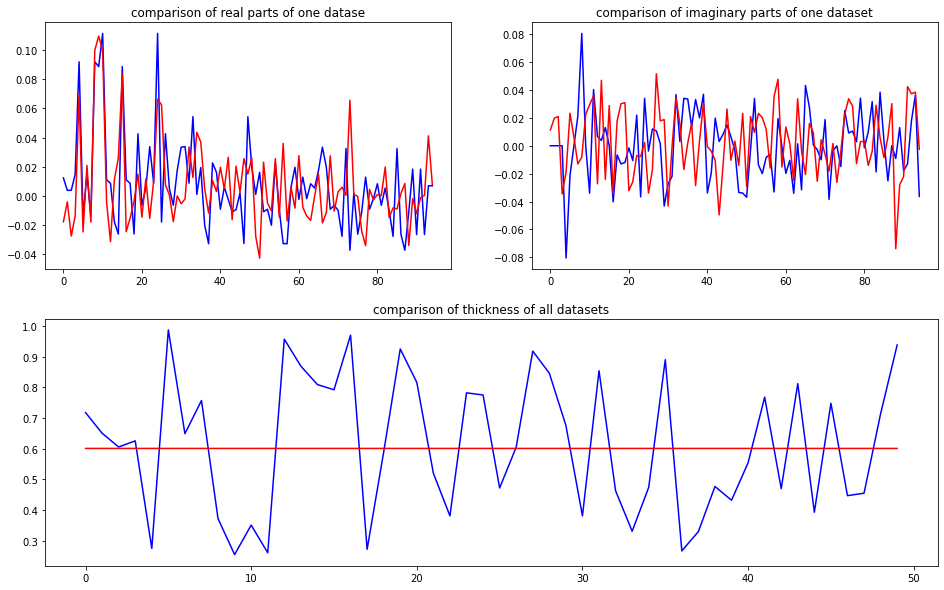

predicted thickness: 0.60094416


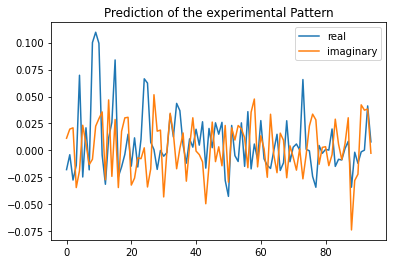

Applied shift of unit cell origin (fractional coordinates): 0.00544740081872191 0.2229207503269438 0.49437061154622525
Ug[ 0 ]: 0.01786 3.14159  =>  0.01786 3.14159
Ug[ 1 ]: 0.01584 -3.10622  =>  0.01584 -0.0
Ug[ 2 ]: 0.01584 3.10622  =>  0.01584 0.0
Ug[ 3 ]: 0.02067 -1.40065  =>  0.02067 -0.0
Ug[ 4 ]: 0.08447 -0.06061  =>  0.08447 -1.83692
Ug[ 5 ]: 0.02812 2.43682  =>  0.02812 0.73125
Ug[ 6 ]: 0.02067 1.40065  =>  0.02067 0.0
Ug[ 7 ]: 0.02812 -2.43682  =>  0.02812 -0.73125
Ug[ 8 ]: 0.08447 0.06061  =>  0.08447 1.83692
Ug[ 9 ]: 0.09607 -0.03423  =>  0.09607 -0.0
Ug[ 10 ]: 0.08338 0.16007  =>  0.08338 -2.98267
Ug[ 11 ]: 0.03797 1.96199  =>  0.03797 -1.11
Ug[ 12 ]: 0.03254 -2.37572  =>  0.03254 2.54104
Ug[ 13 ]: 0.05464 0.83472  =>  0.05464 2.57452
Ug[ 14 ]: 0.02931 -1.18418  =>  0.02931 0.62636
Ug[ 15 ]: 0.09607 0.03423  =>  0.09607 0.0
Ug[ 16 ]: 0.03797 -1.96199  =>  0.03797 1.11
Ug[ 17 ]: 0.03254 2.37572  =>  0.03254 -2.54104
Ug[ 18 ]: 0.02931 1.18418  =>  0.02931 -0.62636
Ug[ 19 ]: 0

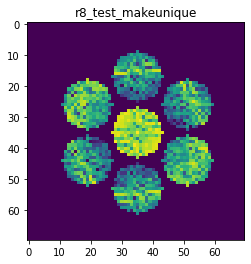

X_sim.max(): 0.9474969480246905
nlogf_X_sim.max(): 6.854878571683746
>>>replaced the 5. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 347ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 264ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 266ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000


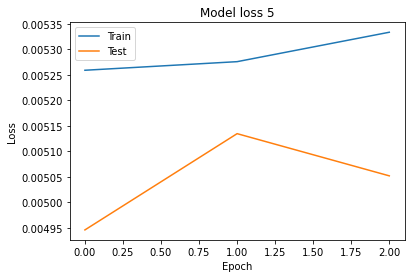

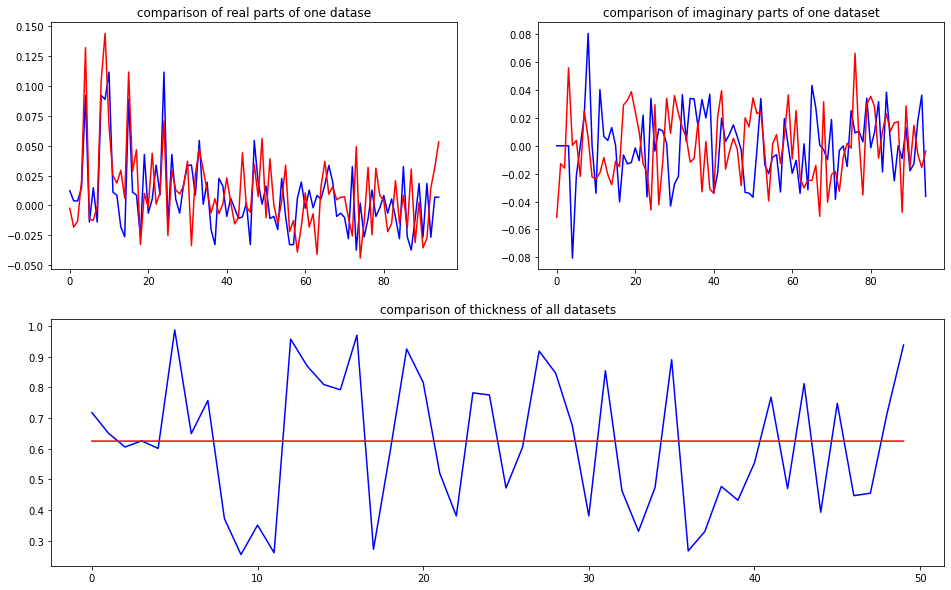

predicted thickness: 0.6247869


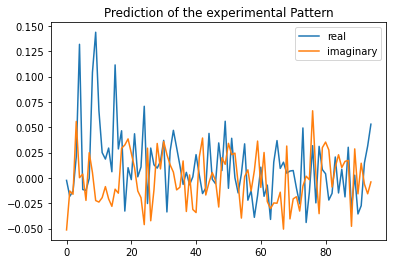

Applied shift of unit cell origin (fractional coordinates): 0.0074328249625483355 -0.2332967873652838 -0.48396847664971904
Ug[ 0 ]: 0.00257 3.14159  =>  0.00257 3.14159
Ug[ 1 ]: 0.01567 3.04086  =>  0.01567 0.0
Ug[ 2 ]: 0.01567 -3.04086  =>  0.01567 -0.0
Ug[ 3 ]: 0.03906 1.46585  =>  0.03906 0.0
Ug[ 4 ]: 0.11707 -0.02371  =>  0.11707 1.75276
Ug[ 5 ]: 0.01214 -2.08736  =>  0.01214 -0.51234
Ug[ 6 ]: 0.03906 -1.46585  =>  0.03906 -0.0
Ug[ 7 ]: 0.01214 2.08736  =>  0.01214 0.51234
Ug[ 8 ]: 0.11707 0.02371  =>  0.11707 -1.75276
Ug[ 9 ]: 0.12664 -0.0467  =>  0.12664 -0.0
Ug[ 10 ]: 0.06906 0.16282  =>  0.06906 -2.83134
Ug[ 11 ]: 0.02685 -0.08169  =>  0.02685 3.00587
Ug[ 12 ]: 0.03755 -0.52491  =>  0.03755 0.98764
Ug[ 13 ]: 0.02512 -1.48882  =>  0.02512 -3.01714
Ug[ 14 ]: 0.03305 -1.98759  =>  0.03305 2.56582
Ug[ 15 ]: 0.12664 0.0467  =>  0.12664 0.0
Ug[ 16 ]: 0.02685 0.08169  =>  0.02685 -3.00587
Ug[ 17 ]: 0.03755 0.52491  =>  0.03755 -0.98764
Ug[ 18 ]: 0.03305 1.98759  =>  0.03305 -2.56582
U

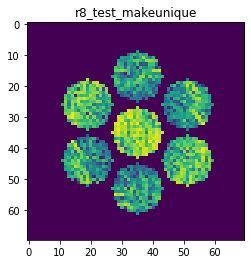

X_sim.max(): 0.9105977112541395
nlogf_X_sim.max(): 6.8151987866774375
>>>replaced the 6. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 367ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 270ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 273ms/step - loss: 0.0054 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000


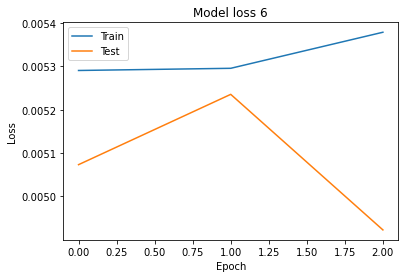

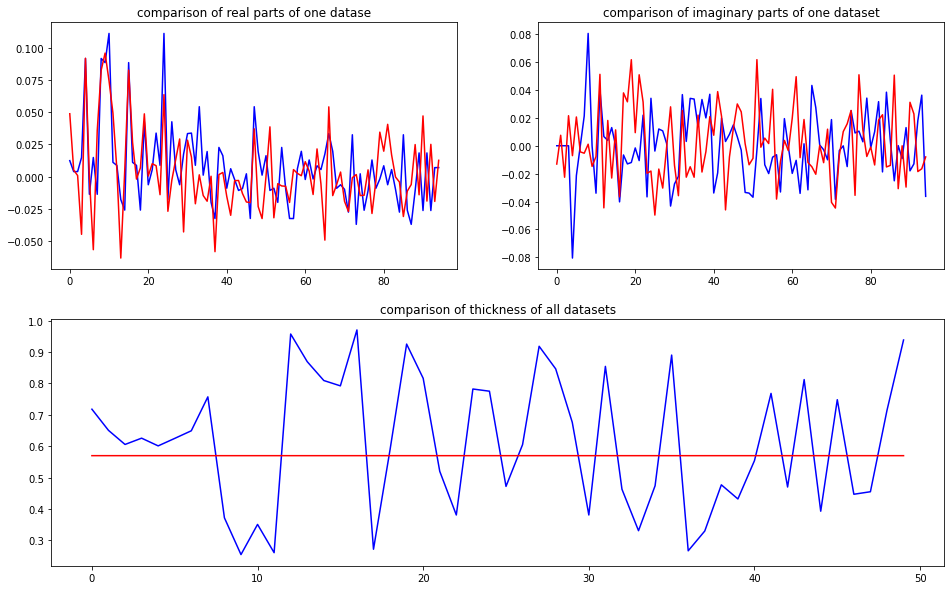

predicted thickness: 0.5698147


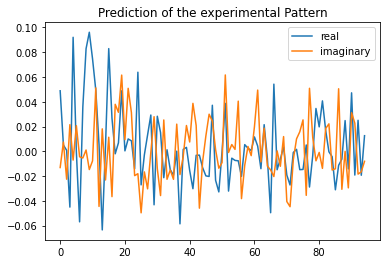

Applied shift of unit cell origin (fractional coordinates): 0.02310820466969079 -0.4604009111638042 -0.21943805736051178
Ug[ 0 ]: 0.04882 0.0  =>  0.04882 0.0
Ug[ 1 ]: 0.01529 1.37877  =>  0.01529 0.0
Ug[ 2 ]: 0.01529 -1.37877  =>  0.01529 -0.0
Ug[ 3 ]: 0.05271 2.89278  =>  0.05271 0.0
Ug[ 4 ]: 0.08742 -0.04666  =>  0.08742 1.96497
Ug[ 5 ]: 0.02198 0.63521  =>  0.02198 -0.87881
Ug[ 6 ]: 0.05271 -2.89278  =>  0.05271 -0.0
Ug[ 7 ]: 0.02198 -0.63521  =>  0.02198 0.87881
Ug[ 8 ]: 0.08742 0.04666  =>  0.08742 -1.96497
Ug[ 9 ]: 0.09034 -0.14519  =>  0.09034 0.0
Ug[ 10 ]: 0.06935 0.07467  =>  0.06935 -1.15891
Ug[ 11 ]: 0.05804 0.85753  =>  0.05804 2.38149
Ug[ 12 ]: 0.04128 -1.52836  =>  0.04128 1.50962
Ug[ 13 ]: 0.05665 2.50026  =>  0.05665 -2.12372
Ug[ 14 ]: 0.02791 -1.3667  =>  0.02791 3.05005
Ug[ 15 ]: 0.09034 0.14519  =>  0.09034 0.0
Ug[ 16 ]: 0.05804 -0.85753  =>  0.05804 -2.38149
Ug[ 17 ]: 0.04128 1.52836  =>  0.04128 -1.50962
Ug[ 18 ]: 0.02791 1.3667  =>  0.02791 -3.05005
Ug[ 19 ]: 0.0

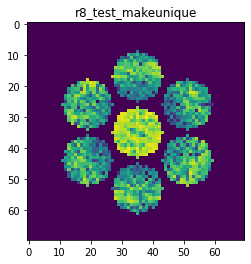

X_sim.max(): 0.9462099615355922
nlogf_X_sim.max(): 6.853520780898334
>>>replaced the 7. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 356ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 265ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 269ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000


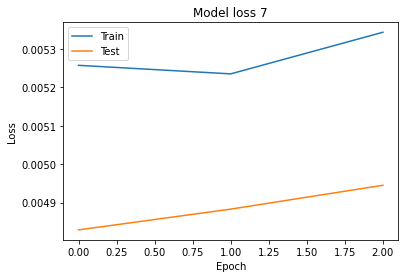

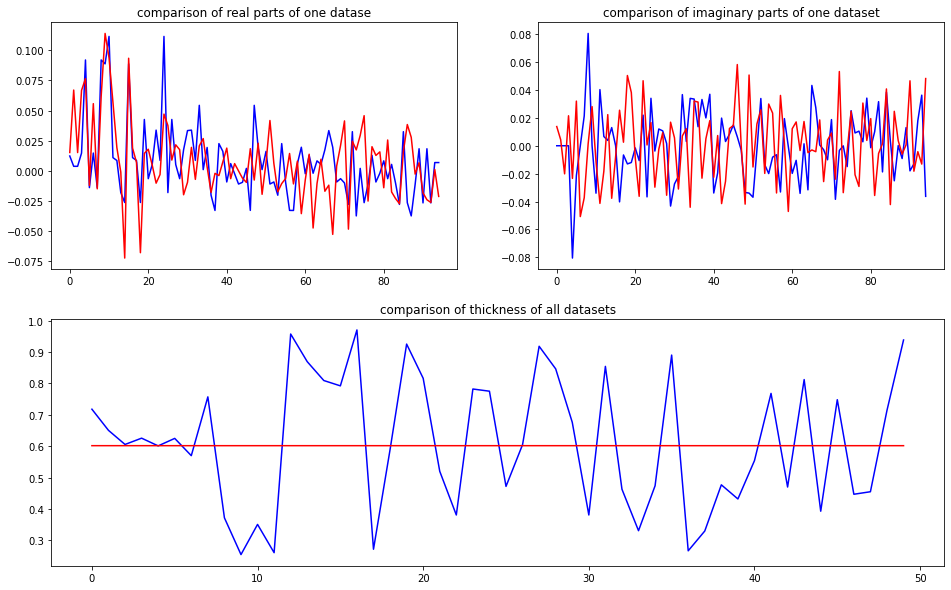

predicted thickness: 0.60160583


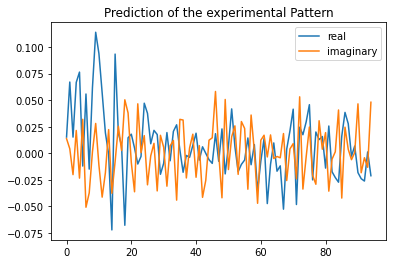

Applied shift of unit cell origin (fractional coordinates): -0.027264626903958936 -0.08485290996010311 -0.0457771033181892
Ug[ 0 ]: 0.01526 0.0  =>  0.01526 0.0
Ug[ 1 ]: 0.0429 0.28763  =>  0.0429 0.0
Ug[ 2 ]: 0.0429 -0.28763  =>  0.0429 0.0
Ug[ 3 ]: 0.07112 0.53315  =>  0.07112 0.0
Ug[ 4 ]: 0.07018 -0.17773  =>  0.07018 -0.9985
Ug[ 5 ]: 0.03721 1.94152  =>  0.03721 1.696
Ug[ 6 ]: 0.07112 -0.53315  =>  0.07112 0.0
Ug[ 7 ]: 0.03721 -1.94152  =>  0.03721 -1.696
Ug[ 8 ]: 0.07018 0.17773  =>  0.07018 0.9985
Ug[ 9 ]: 0.10511 0.17131  =>  0.10511 0.0
Ug[ 10 ]: 0.07182 -0.19622  =>  0.07182 -0.65516
Ug[ 11 ]: 0.0505 -0.72247  =>  0.0505 -0.60615
Ug[ 12 ]: 0.01679 -0.67031  =>  0.01679 -0.30847
Ug[ 13 ]: 0.03181 0.95709  =>  0.03181 1.0313
Ug[ 14 ]: 0.08273 -2.58068  =>  0.08273 -1.93122
Ug[ 15 ]: 0.10511 -0.17131  =>  0.10511 0.0
Ug[ 16 ]: 0.0505 0.72247  =>  0.0505 0.60615
Ug[ 17 ]: 0.01679 0.67031  =>  0.01679 0.30847
Ug[ 18 ]: 0.08273 2.58068  =>  0.08273 1.93122
Ug[ 19 ]: 0.02339 1.04378 

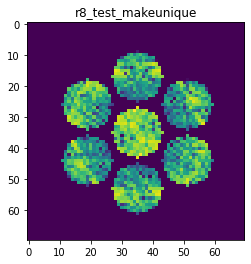

X_sim.max(): 0.9696318376689658
nlogf_X_sim.max(): 6.877947238482353
>>>replaced the 8. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 351ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 263ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 264ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000


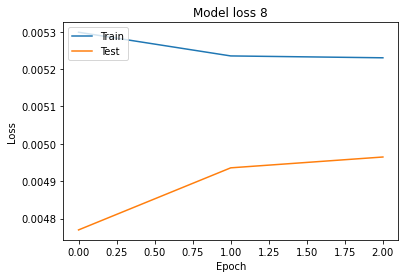

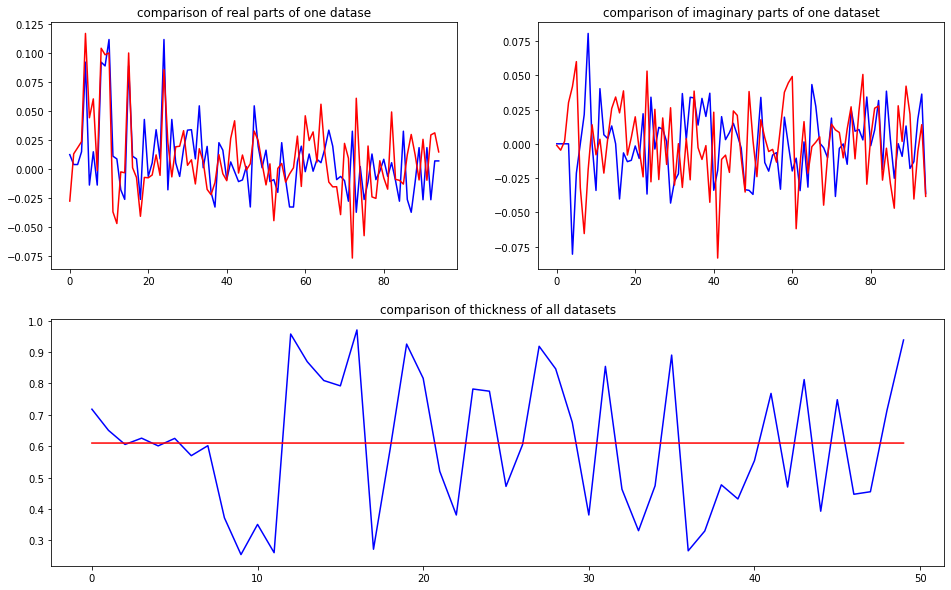

predicted thickness: 0.60996026


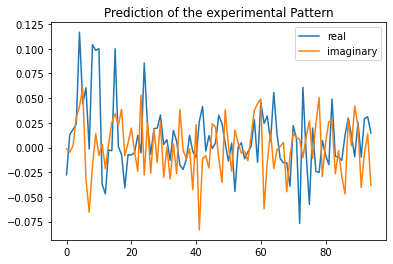

Applied shift of unit cell origin (fractional coordinates): 0.01617763284004973 -0.10154913896490869 0.03298047665364528
Ug[ 0 ]: 0.0277 3.14159  =>  0.0277 3.14159
Ug[ 1 ]: 0.01602 -0.20722  =>  0.01602 0.0
Ug[ 2 ]: 0.01602 0.20722  =>  0.01602 -0.0
Ug[ 3 ]: 0.05216 0.63805  =>  0.05216 -0.0
Ug[ 4 ]: 0.11407 0.26901  =>  0.11407 -0.16182
Ug[ 5 ]: 0.06619 1.24542  =>  0.06619 0.40015
Ug[ 6 ]: 0.05216 -0.63805  =>  0.05216 0.0
Ug[ 7 ]: 0.06619 -1.24542  =>  0.06619 -0.40015
Ug[ 8 ]: 0.11407 -0.26901  =>  0.11407 0.16182
Ug[ 9 ]: 0.09933 -0.10165  =>  0.09933 0.0
Ug[ 10 ]: 0.09304 0.10556  =>  0.09304 0.41443
Ug[ 11 ]: 0.02036 -2.65016  =>  0.02036 -2.75573
Ug[ 12 ]: 0.04054 -2.30754  =>  0.04054 -1.56784
Ug[ 13 ]: 0.01454 -0.80905  =>  0.01454 0.13787
Ug[ 14 ]: 0.0278 2.48443  =>  0.0278 3.0169
Ug[ 15 ]: 0.09933 0.10165  =>  0.09933 0.0
Ug[ 16 ]: 0.02036 2.65016  =>  0.02036 2.75573
Ug[ 17 ]: 0.04054 2.30754  =>  0.04054 1.56784
Ug[ 18 ]: 0.0278 -2.48443  =>  0.0278 -3.0169
Ug[ 19 ]: 0.

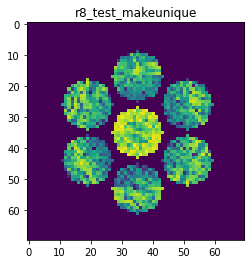

X_sim.max(): 0.9048766074687721
nlogf_X_sim.max(): 6.808903101920789
>>>replaced the 9. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 369ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 290ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 287ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000


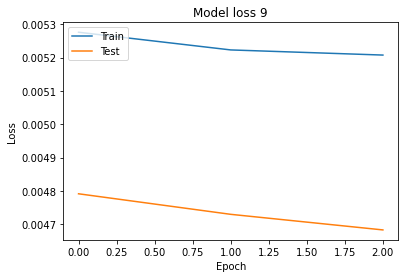

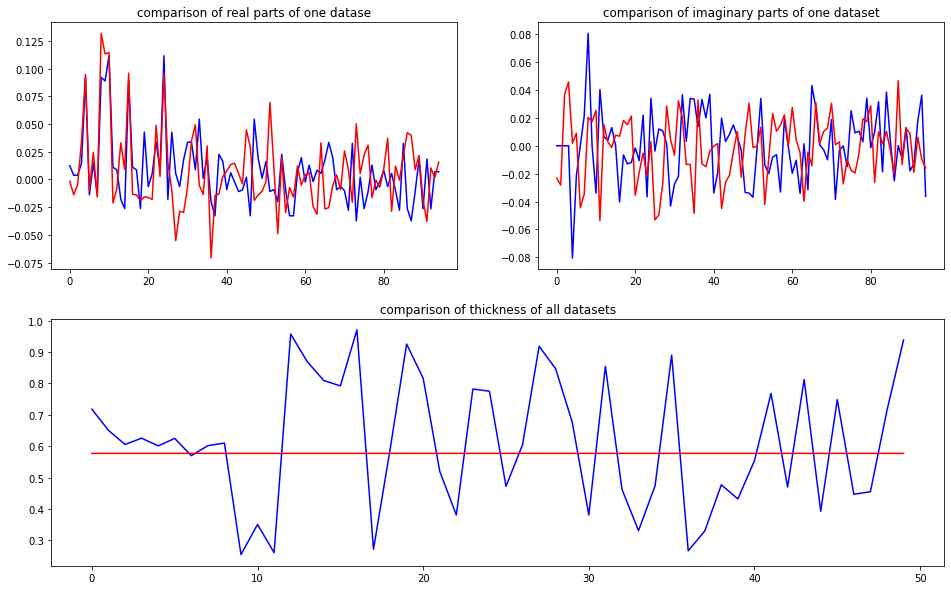

predicted thickness: 0.57707155


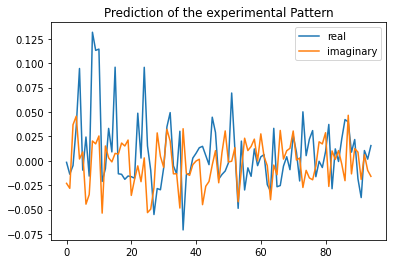

Applied shift of unit cell origin (fractional coordinates): -0.007401371552590674 -0.15732554189781534 0.29457055640152185
Ug[ 0 ]: 0.00166 3.14159  =>  0.00166 3.14159
Ug[ 1 ]: 0.03391 -1.85084  =>  0.03391 0.0
Ug[ 2 ]: 0.03391 1.85084  =>  0.03391 0.0
Ug[ 3 ]: 0.05396 0.98851  =>  0.05396 0.0
Ug[ 4 ]: 0.1133 -0.08085  =>  0.1133 0.78149
Ug[ 5 ]: 0.02526 2.09788  =>  0.02526 -0.74146
Ug[ 6 ]: 0.05396 -0.98851  =>  0.05396 -0.0
Ug[ 7 ]: 0.02526 -2.09788  =>  0.02526 0.74146
Ug[ 8 ]: 0.1133 0.08085  =>  0.1133 -0.78149
Ug[ 9 ]: 0.10444 0.0465  =>  0.10444 0.0
Ug[ 10 ]: 0.10552 0.10644  =>  0.10552 1.91077
Ug[ 11 ]: 0.03487 -2.09063  =>  0.03487 2.29521
Ug[ 12 ]: 0.01111 -3.00541  =>  0.01111 -2.06341
Ug[ 13 ]: 0.03702 0.86079  =>  0.03702 -2.62955
Ug[ 14 ]: 0.00957 -2.12093  =>  0.00957 -3.02977
Ug[ 15 ]: 0.10444 -0.0465  =>  0.10444 0.0
Ug[ 16 ]: 0.03487 2.09063  =>  0.03487 -2.29521
Ug[ 17 ]: 0.01111 3.00541  =>  0.01111 2.06341
Ug[ 18 ]: 0.00957 2.12093  =>  0.00957 3.02977
Ug[ 19 ]:

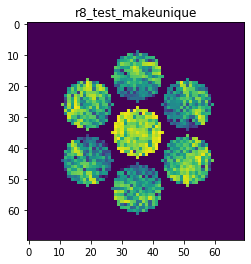

X_sim.max(): 0.8324456941104487
nlogf_X_sim.max(): 6.725568546031578
>>>replaced the 10. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 372ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 279ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 272ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000


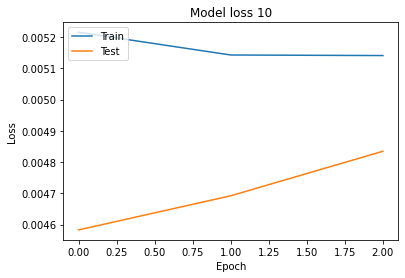

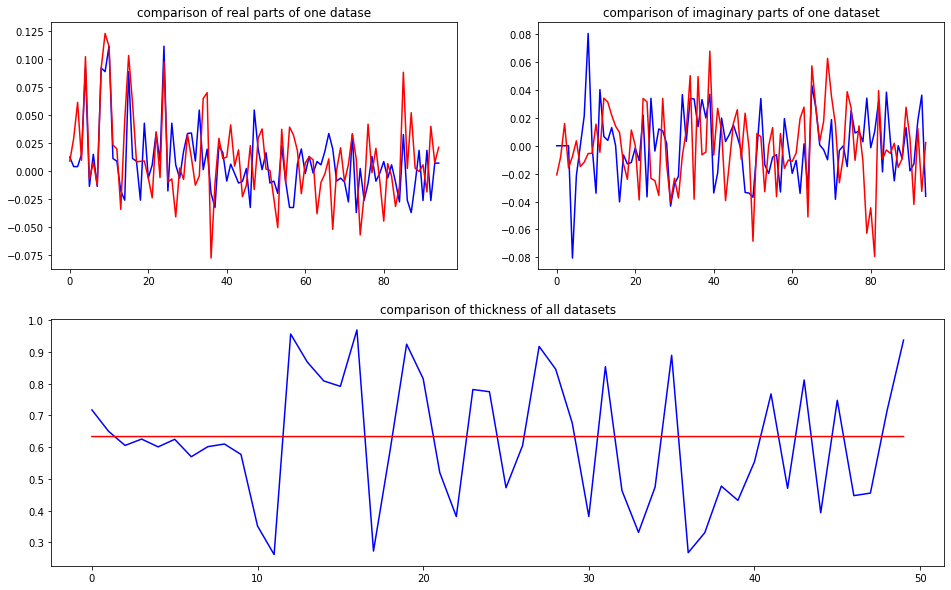

predicted thickness: 0.6335069


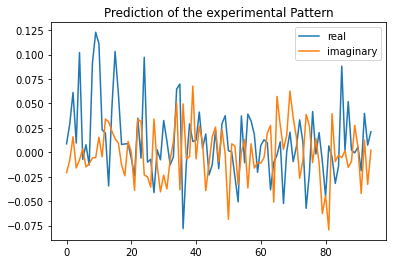

Applied shift of unit cell origin (fractional coordinates): 0.013445830387341888 0.009568987601325227 0.0412282925276389
Ug[ 0 ]: 0.00874 0.0  =>  0.00874 0.0
Ug[ 1 ]: 0.04689 -0.25905  =>  0.04689 0.0
Ug[ 2 ]: 0.04689 0.25905  =>  0.04689 0.0
Ug[ 3 ]: 0.00863 -0.06012  =>  0.00863 -0.0
Ug[ 4 ]: 0.0973 -0.01018  =>  0.0973 0.30898
Ug[ 5 ]: 0.01267 2.48942  =>  0.01267 2.2905
Ug[ 6 ]: 0.00863 0.06012  =>  0.00863 0.0
Ug[ 7 ]: 0.01267 -2.48942  =>  0.01267 -2.2905
Ug[ 8 ]: 0.0973 0.01018  =>  0.0973 -0.30898
Ug[ 9 ]: 0.11399 -0.08448  =>  0.11399 0.0
Ug[ 10 ]: 0.10652 0.18363  =>  0.10652 0.52716
Ug[ 11 ]: 0.04249 -0.16808  =>  0.04249 -0.34265
Ug[ 12 ]: 0.02733 1.0377  =>  0.02733 1.06206
Ug[ 13 ]: 0.03587 2.23797  =>  0.03587 2.52137
Ug[ 14 ]: 0.0354 0.70554  =>  0.0354 0.47086
Ug[ 15 ]: 0.11399 0.08448  =>  0.11399 -0.0
Ug[ 16 ]: 0.04249 0.16808  =>  0.04249 0.34265
Ug[ 17 ]: 0.02733 -1.0377  =>  0.02733 -1.06206
Ug[ 18 ]: 0.0354 -0.70554  =>  0.0354 -0.47086
Ug[ 19 ]: 0.02336 1.53287

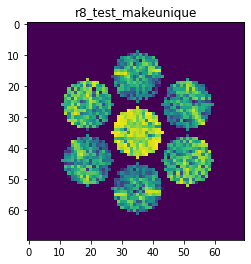

X_sim.max(): 0.9075920821727684
nlogf_X_sim.max(): 6.811896238971648
>>>replaced the 11. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 371ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 258ms/step - loss: 0.0053 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 256ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000


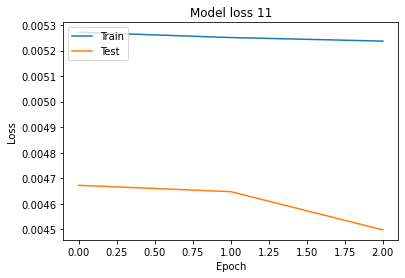

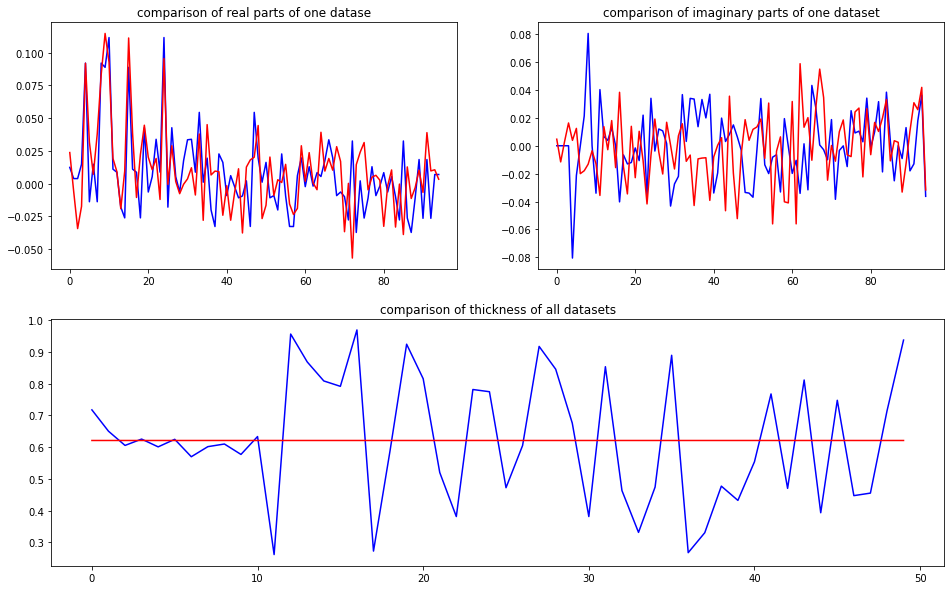

predicted thickness: 0.6211032


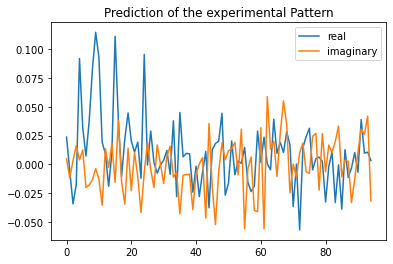

Applied shift of unit cell origin (fractional coordinates): -0.00849721364468002 -0.29328798591015703 0.4438855901662109
Ug[ 0 ]: 0.02372 0.0  =>  0.02372 0.0
Ug[ 1 ]: 0.02149 -2.78902  =>  0.02149 -0.0
Ug[ 2 ]: 0.02149 2.78902  =>  0.02149 0.0
Ug[ 3 ]: 0.01886 1.84278  =>  0.01886 -0.0
Ug[ 4 ]: 0.08812 0.09787  =>  0.08812 1.0441
Ug[ 5 ]: 0.038 0.41142  =>  0.038 2.06281
Ug[ 6 ]: 0.01886 -1.84278  =>  0.01886 0.0
Ug[ 7 ]: 0.038 -0.41142  =>  0.038 -2.06281
Ug[ 8 ]: 0.08812 -0.09787  =>  0.08812 -1.0441
Ug[ 9 ]: 0.11354 0.05339  =>  0.11354 0.0
Ug[ 10 ]: 0.09454 -0.03162  =>  0.09454 2.70401
Ug[ 11 ]: 0.04696 -0.90643  =>  0.04696 2.53435
Ug[ 12 ]: 0.01439 1.6212  =>  0.01439 -2.87259
Ug[ 13 ]: 0.01475 -2.30075  =>  0.01475 2.27765
Ug[ 14 ]: 0.03069 1.02656  =>  0.03069 0.02694
Ug[ 15 ]: 0.11354 -0.05339  =>  0.11354 0.0
Ug[ 16 ]: 0.04696 0.90643  =>  0.04696 -2.53435
Ug[ 17 ]: 0.01439 -1.6212  =>  0.01439 2.87259
Ug[ 18 ]: 0.03069 -1.02656  =>  0.03069 -0.02694
Ug[ 19 ]: 0.03792 0.244

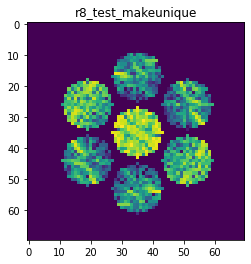

X_sim.max(): 0.9531072982283605
nlogf_X_sim.max(): 6.860776137061277
>>>replaced the 12. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 364ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 283ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 294ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000


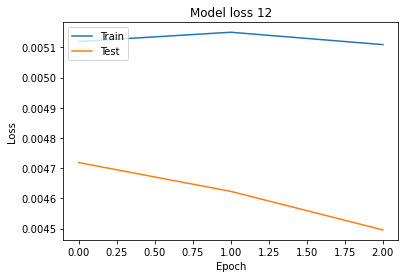

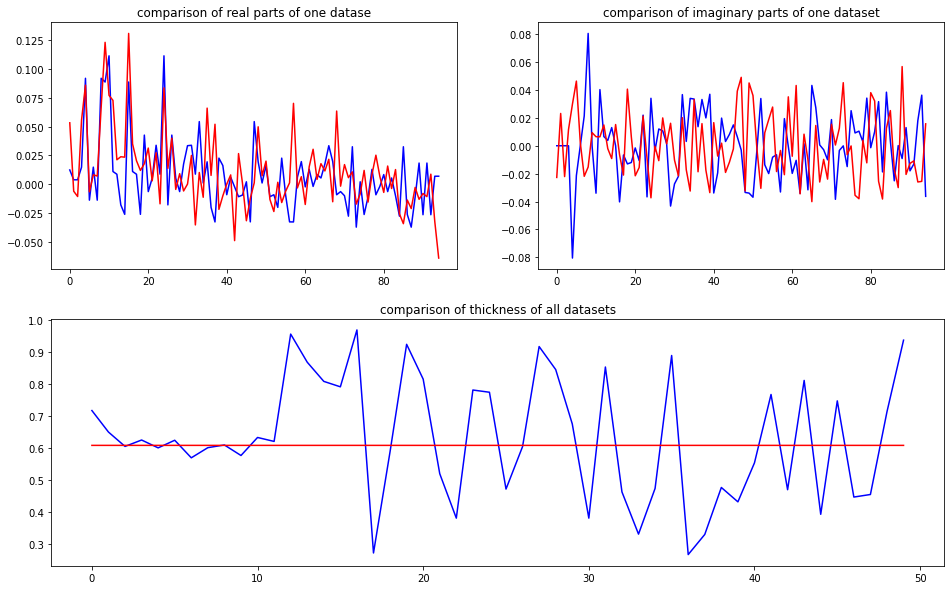

predicted thickness: 0.608748


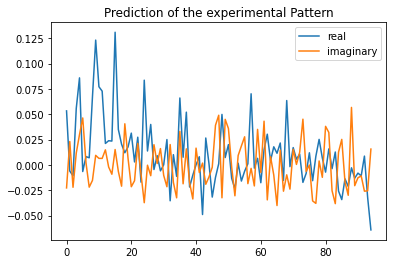

Applied shift of unit cell origin (fractional coordinates): 0.0036136479342669943 -0.023518559214989097 -0.3064313169381323
Ug[ 0 ]: 0.05337 0.0  =>  0.05337 0.0
Ug[ 1 ]: 0.02409 1.92536  =>  0.02409 -0.0
Ug[ 2 ]: 0.02409 -1.92536  =>  0.02409 0.0
Ug[ 3 ]: 0.03235 0.14777  =>  0.03235 0.0
Ug[ 4 ]: 0.07979 0.28741  =>  0.07979 -1.78572
Ug[ 5 ]: 0.03415 1.5626  =>  0.03415 -2.94299
Ug[ 6 ]: 0.03235 -0.14777  =>  0.03235 0.0
Ug[ 7 ]: 0.03415 -1.5626  =>  0.03415 2.94299
Ug[ 8 ]: 0.07979 -0.28741  =>  0.07979 1.78572
Ug[ 9 ]: 0.12732 -0.02271  =>  0.12732 0.0
Ug[ 10 ]: 0.08342 0.26523  =>  0.08342 -1.63743
Ug[ 11 ]: 0.05432 0.11897  =>  0.05432 2.06704
Ug[ 12 ]: 0.02745 0.71188  =>  0.02745 0.88235
Ug[ 13 ]: 0.01884 -0.04624  =>  0.01884 -1.80112
Ug[ 14 ]: 0.0306 -0.9506  =>  0.0306 1.14524
Ug[ 15 ]: 0.12732 0.02271  =>  0.12732 -0.0
Ug[ 16 ]: 0.05432 -0.11897  =>  0.05432 -2.06704
Ug[ 17 ]: 0.02745 -0.71188  =>  0.02745 -0.88235
Ug[ 18 ]: 0.0306 0.9506  =>  0.0306 -1.14524
Ug[ 19 ]: 0.030

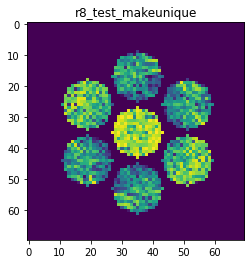

X_sim.max(): 0.8535509641920322
nlogf_X_sim.max(): 6.750576142897701
>>>replaced the 13. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 400ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 296ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 304ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 1.0000


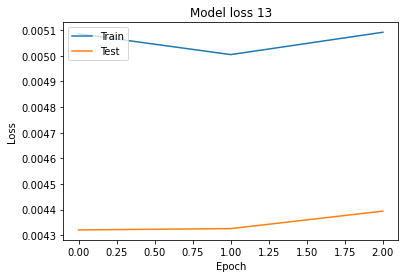

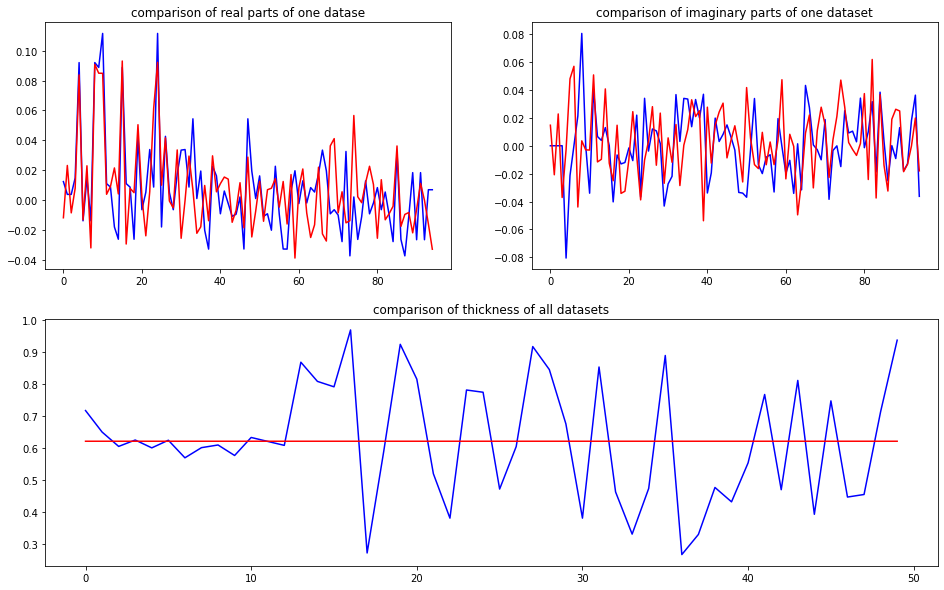

predicted thickness: 0.6216957


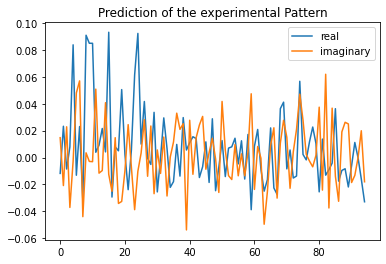

Applied shift of unit cell origin (fractional coordinates): -0.008537758534028302 0.1992789672348492 0.19827853931372344
Ug[ 0 ]: 0.0118 3.14159  =>  0.0118 3.14159
Ug[ 1 ]: 0.02303 -1.24582  =>  0.02303 0.0
Ug[ 2 ]: 0.02303 1.24582  =>  0.02303 -0.0
Ug[ 3 ]: 0.04953 -1.25211  =>  0.04953 0.0
Ug[ 4 ]: 0.08752 -0.03584  =>  0.08752 2.46209
Ug[ 5 ]: 0.0512 2.02647  =>  0.0512 2.03275
Ug[ 6 ]: 0.04953 1.25211  =>  0.04953 0.0
Ug[ 7 ]: 0.0512 -2.02647  =>  0.0512 -2.03275
Ug[ 8 ]: 0.08752 0.03584  =>  0.08752 -2.46209
Ug[ 9 ]: 0.0893 0.05364  =>  0.0893 0.0
Ug[ 10 ]: 0.08878 0.03973  =>  0.08878 1.2319
Ug[ 11 ]: 0.04004 1.8935  =>  0.04004 0.59404
Ug[ 12 ]: 0.01567 -0.99789  =>  0.01567 -2.30365
Ug[ 13 ]: 0.01706 -0.39048  =>  0.01706 -0.45041
Ug[ 14 ]: 0.03772 1.44829  =>  0.03772 -1.10328
Ug[ 15 ]: 0.0893 -0.05364  =>  0.0893 -0.0
Ug[ 16 ]: 0.04004 -1.8935  =>  0.04004 -0.59404
Ug[ 17 ]: 0.01567 0.99789  =>  0.01567 2.30365
Ug[ 18 ]: 0.03772 -1.44829  =>  0.03772 1.10328
Ug[ 19 ]: 0.0552

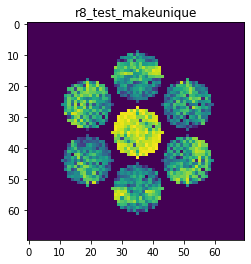

X_sim.max(): 0.8930411595880684
nlogf_X_sim.max(): 6.795751813921397
>>>replaced the 14. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 392ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 288ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 296ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 1.0000


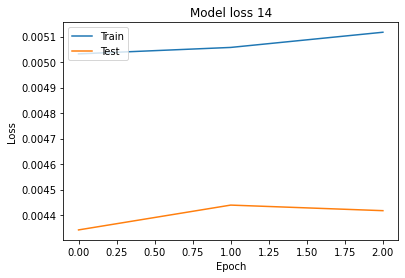

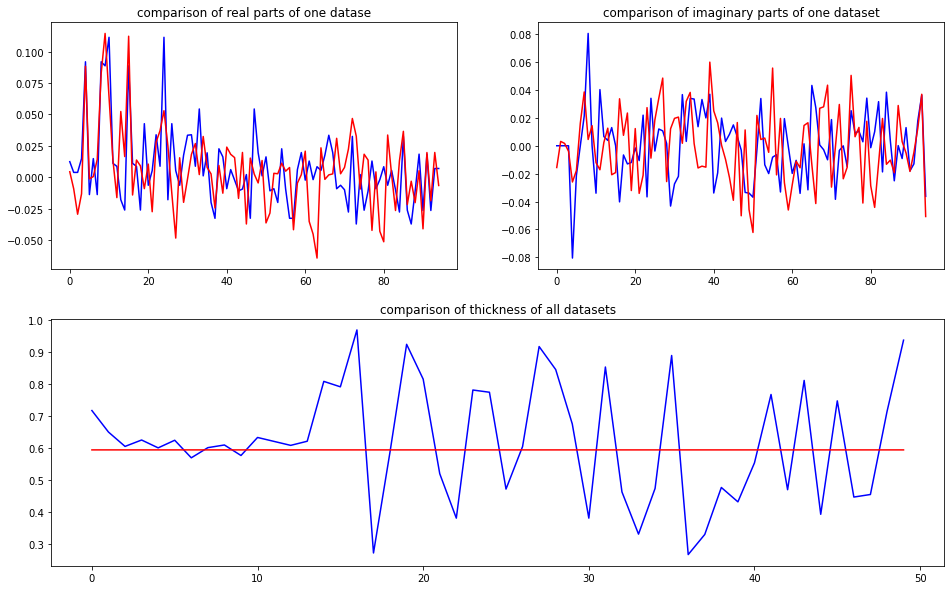

predicted thickness: 0.59459865


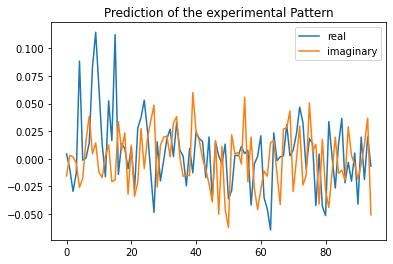

Applied shift of unit cell origin (fractional coordinates): -0.023526782464854675 0.34002920433827916 -0.494172166001086
Ug[ 0 ]: 0.00434 0.0  =>  0.00434 0.0
Ug[ 1 ]: 0.01939 3.10498  =>  0.01939 -0.0
Ug[ 2 ]: 0.01939 -3.10498  =>  0.01939 0.0
Ug[ 3 ]: 0.01187 -2.13647  =>  0.01187 0.0
Ug[ 4 ]: 0.08656 -0.17699  =>  0.08656 -1.1455
Ug[ 5 ]: 0.02884 -1.34755  =>  0.02884 -2.38929
Ug[ 6 ]: 0.01187 2.13647  =>  0.01187 -0.0
Ug[ 7 ]: 0.02884 1.34755  =>  0.02884 2.38929
Ug[ 8 ]: 0.08656 0.17699  =>  0.08656 1.1455
Ug[ 9 ]: 0.11413 0.14782  =>  0.11413 0.0
Ug[ 10 ]: 0.0584 -0.02822  =>  0.0584 3.00217
Ug[ 11 ]: 0.02538 -1.58661  =>  0.02538 1.37054
Ug[ 12 ]: 0.00289 -2.04545  =>  0.00289 1.95344
Ug[ 13 ]: 0.03871 -0.07779  =>  0.03871 0.81613
Ug[ 14 ]: 0.02554 -1.04834  =>  0.02554 -0.22765
Ug[ 15 ]: 0.11413 -0.14782  =>  0.11413 -0.0
Ug[ 16 ]: 0.02538 1.58661  =>  0.02538 -1.37054
Ug[ 17 ]: 0.00289 2.04545  =>  0.00289 -1.95344
Ug[ 18 ]: 0.02554 1.04834  =>  0.02554 0.22765
Ug[ 19 ]: 0.03

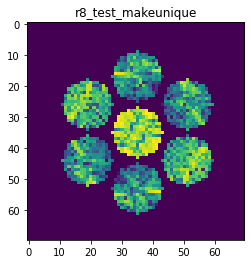

X_sim.max(): 0.9152244293997955
nlogf_X_sim.max(): 6.820261344925803
>>>replaced the 15. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 375ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 300ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 265ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 1.0000


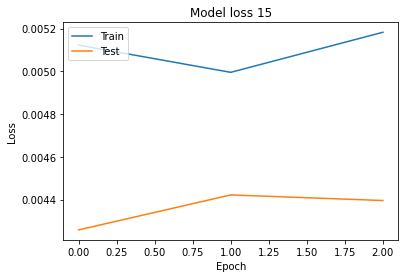

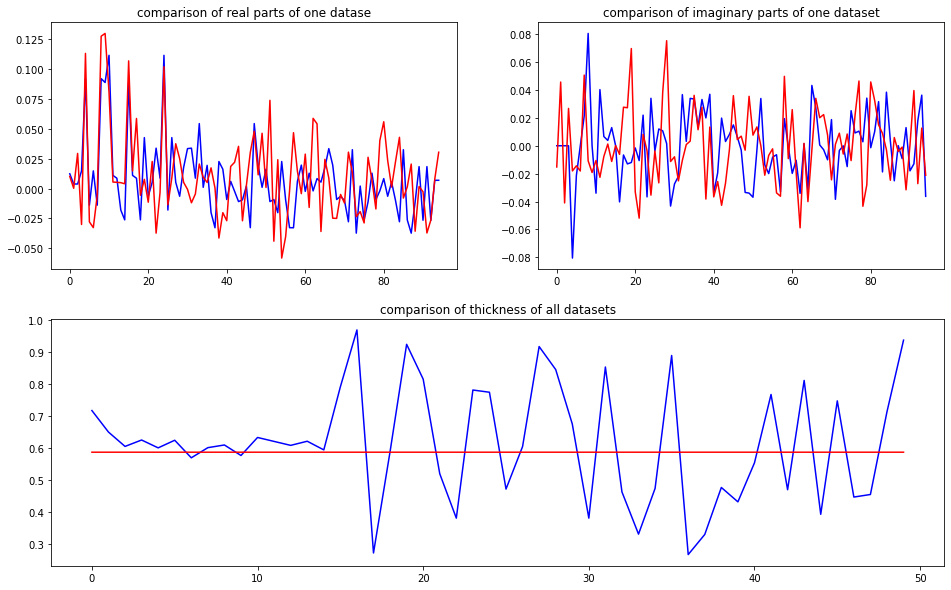

predicted thickness: 0.58737797


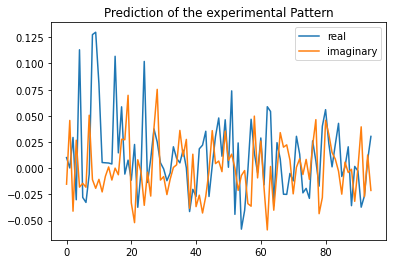

Applied shift of unit cell origin (fractional coordinates): 0.012780983699765727 -0.4010348836652748 -0.1972372291748191
Ug[ 0 ]: 0.01017 0.0  =>  0.01017 0.0
Ug[ 1 ]: 0.04579 1.23928  =>  0.04579 -0.0
Ug[ 2 ]: 0.04579 -1.23928  =>  0.04579 0.0
Ug[ 3 ]: 0.03851 2.51978  =>  0.03851 0.0
Ug[ 4 ]: 0.12073 -0.02995  =>  0.12073 2.49418
Ug[ 5 ]: 0.03656 -2.04624  =>  0.03656 2.95645
Ug[ 6 ]: 0.03851 -2.51978  =>  0.03851 0.0
Ug[ 7 ]: 0.03656 2.04624  =>  0.03656 -2.95645
Ug[ 8 ]: 0.12073 0.02995  =>  0.12073 -2.49418
Ug[ 9 ]: 0.11908 -0.08031  =>  0.11908 0.0
Ug[ 10 ]: 0.09237 0.13393  =>  0.09237 -1.02504
Ug[ 11 ]: 0.01299 -0.68145  =>  0.01299 0.63813
Ug[ 12 ]: 0.03656 -0.5058  =>  0.03656 2.09428
Ug[ 13 ]: 0.00495 2.61611  =>  0.00495 -2.30628
Ug[ 14 ]: 0.01927 -1.60926  =>  0.01927 2.2301
Ug[ 15 ]: 0.11908 0.08031  =>  0.11908 0.0
Ug[ 16 ]: 0.01299 0.68145  =>  0.01299 -0.63813
Ug[ 17 ]: 0.03656 0.5058  =>  0.03656 -2.09428
Ug[ 18 ]: 0.01927 1.60926  =>  0.01927 -2.2301
Ug[ 19 ]: 0.0488

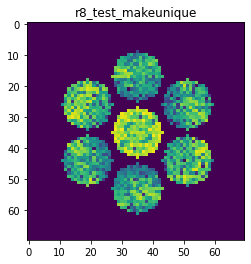

X_sim.max(): 0.8883590292577208
nlogf_X_sim.max(): 6.790501011418199
>>>replaced the 16. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 379ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 311ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 316ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000


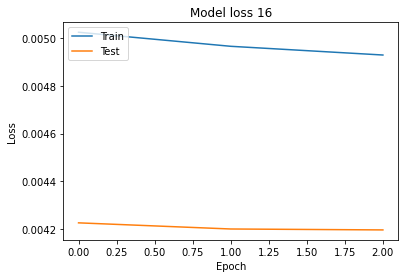

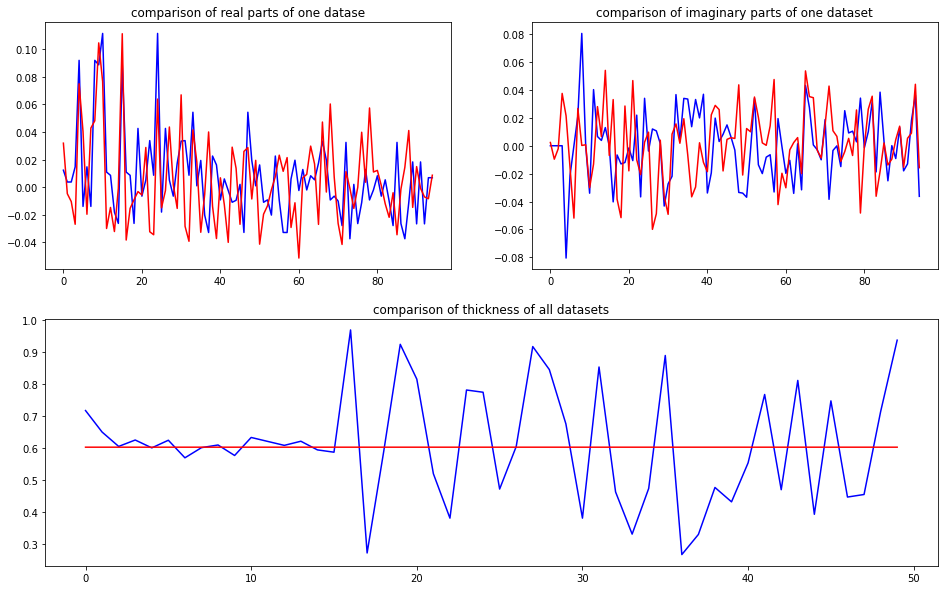

predicted thickness: 0.60307795


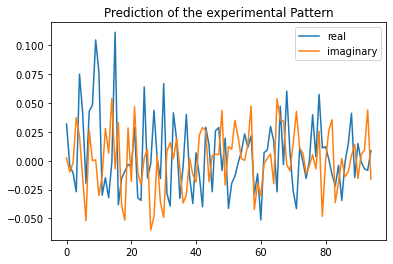

Applied shift of unit cell origin (fractional coordinates): -0.005640226786252717 -0.3260779345857076 0.42541089710782903
Ug[ 0 ]: 0.03197 0.0  =>  0.03197 0.0
Ug[ 1 ]: 0.00839 -2.67294  =>  0.00839 -0.0
Ug[ 2 ]: 0.00839 2.67294  =>  0.00839 0.0
Ug[ 3 ]: 0.05033 2.04881  =>  0.05033 -0.0
Ug[ 4 ]: 0.06251 0.17101  =>  0.06251 0.79514
Ug[ 5 ]: 0.04667 -0.46699  =>  0.04667 1.09445
Ug[ 6 ]: 0.05033 -2.04881  =>  0.05033 0.0
Ug[ 7 ]: 0.04667 0.46699  =>  0.04667 -1.09445
Ug[ 8 ]: 0.06251 -0.17101  =>  0.06251 -0.79514
Ug[ 9 ]: 0.10804 0.03544  =>  0.10804 0.0
Ug[ 10 ]: 0.07214 -0.22802  =>  0.07214 2.40948
Ug[ 11 ]: 0.04114 -2.5454  =>  0.04114 1.02941
Ug[ 12 ]: 0.03639 1.99431  =>  0.03639 -2.27551
Ug[ 13 ]: 0.02351 -3.07481  =>  0.02351 1.6115
Ug[ 14 ]: 0.053 1.66329  =>  0.053 1.00372
Ug[ 15 ]: 0.10804 -0.03544  =>  0.10804 0.0
Ug[ 16 ]: 0.04114 2.5454  =>  0.04114 -1.02941
Ug[ 17 ]: 0.03639 -1.99431  =>  0.03639 2.27551
Ug[ 18 ]: 0.053 -1.66329  =>  0.053 -1.00372
Ug[ 19 ]: 0.04424 1.6

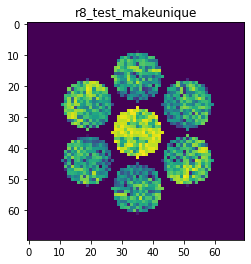

X_sim.max(): 0.8900248452238807
nlogf_X_sim.max(): 6.792372311732859
>>>replaced the 17. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 380ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 294ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 286ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000


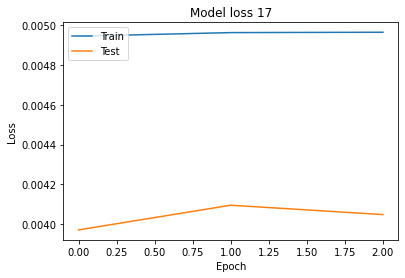

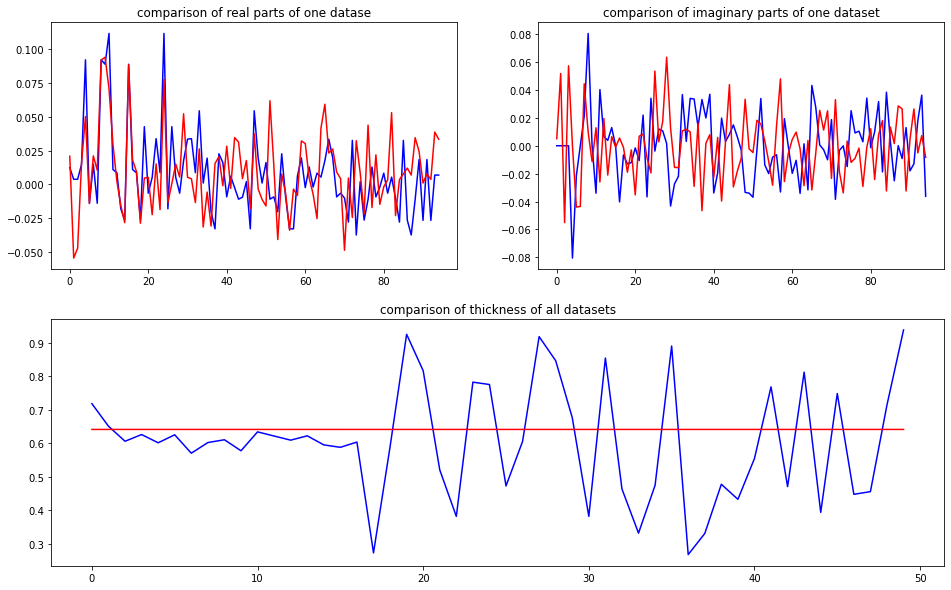

predicted thickness: 0.6408163


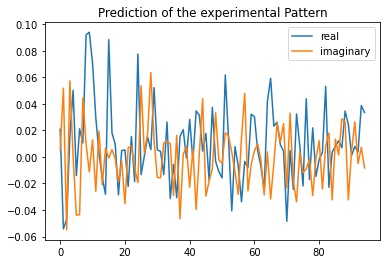

Applied shift of unit cell origin (fractional coordinates): 0.009049494671880204 -0.19401180723271788 -0.37111844360720087
Ug[ 0 ]: 0.02083 0.0  =>  0.02083 0.0
Ug[ 1 ]: 0.07369 2.33181  =>  0.07369 0.0
Ug[ 2 ]: 0.07369 -2.33181  =>  0.07369 -0.0
Ug[ 3 ]: 0.05371 1.21901  =>  0.05371 0.0
Ug[ 4 ]: 0.07107 -0.06853  =>  0.07107 2.66384
Ug[ 5 ]: 0.04417 -1.61318  =>  0.04417 -0.50039
Ug[ 6 ]: 0.05371 -1.21901  =>  0.05371 0.0
Ug[ 7 ]: 0.04417 1.61318  =>  0.04417 0.50039
Ug[ 8 ]: 0.07107 0.06853  =>  0.07107 -2.66384
Ug[ 9 ]: 0.09107 -0.05686  =>  0.09107 0.0
Ug[ 10 ]: 0.07568 0.21538  =>  0.07568 -2.05956
Ug[ 11 ]: 0.02861 -0.58394  =>  0.02861 1.80473
Ug[ 12 ]: 0.01196 1.0467  =>  0.01196 2.32257
Ug[ 13 ]: 0.03996 -1.94161  =>  0.03996 -2.99755
Ug[ 14 ]: 0.03114 2.72013  =>  0.03114 0.04462
Ug[ 15 ]: 0.09107 0.05686  =>  0.09107 0.0
Ug[ 16 ]: 0.02861 0.58394  =>  0.02861 -1.80473
Ug[ 17 ]: 0.01196 -1.0467  =>  0.01196 -2.32257
Ug[ 18 ]: 0.03114 -2.72013  =>  0.03114 -0.04462
Ug[ 19 ]: 0

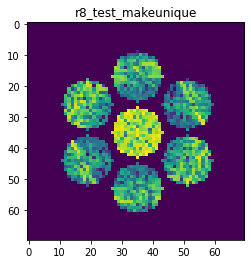

X_sim.max(): 0.8898573924623208
nlogf_X_sim.max(): 6.792184361307729
>>>replaced the 18. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 397ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 290ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 292ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000


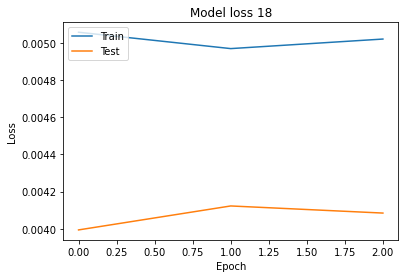

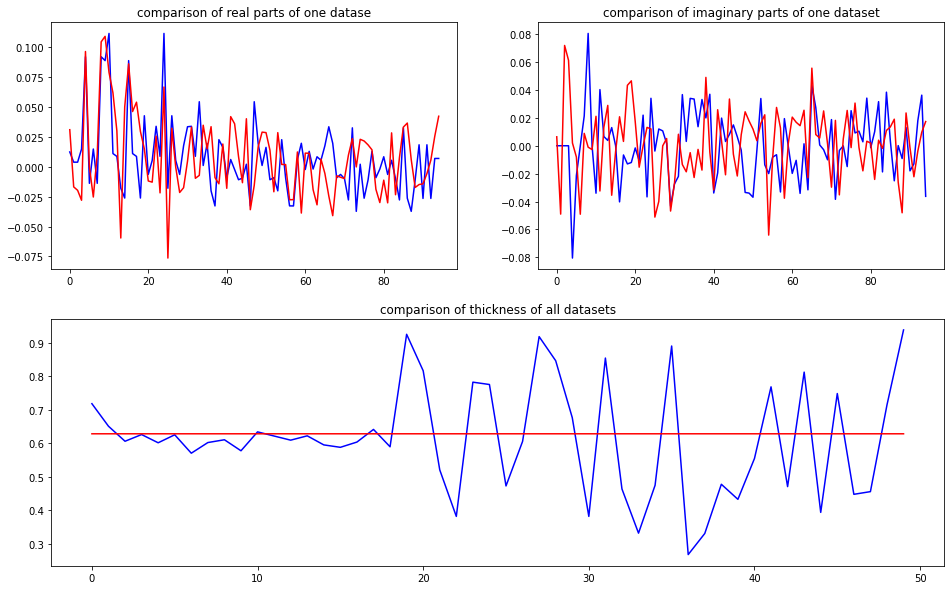

predicted thickness: 0.6277806


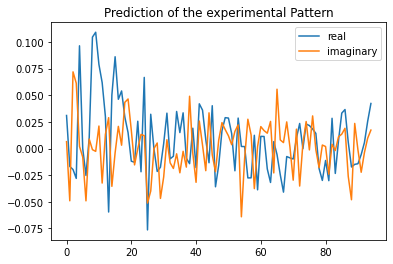

Applied shift of unit cell origin (fractional coordinates): -0.001183238476444986 -0.32136202674679154 0.29639982810558274
Ug[ 0 ]: 0.031 0.0  =>  0.031 0.0
Ug[ 1 ]: 0.06317 -1.86234  =>  0.06317 0.0
Ug[ 2 ]: 0.06317 1.86234  =>  0.06317 0.0
Ug[ 3 ]: 0.06125 2.01918  =>  0.06125 -0.0
Ug[ 4 ]: 0.10068 0.015  =>  0.10068 -0.14184
Ug[ 5 ]: 0.00982 -1.03067  =>  0.00982 1.371
Ug[ 6 ]: 0.06125 -2.01918  =>  0.06125 0.0
Ug[ 7 ]: 0.00982 1.03067  =>  0.00982 -1.371
Ug[ 8 ]: 0.10068 -0.015  =>  0.10068 0.14184
Ug[ 9 ]: 0.09782 0.00743  =>  0.09782 0.0
Ug[ 10 ]: 0.07306 0.06213  =>  0.07306 1.91703
Ug[ 11 ]: 0.06026 -0.45634  =>  0.06026 -2.32611
Ug[ 12 ]: 0.04237 0.12003  =>  0.04237 2.13177
Ug[ 13 ]: 0.07871 2.60875  =>  0.07871 0.19964
Ug[ 14 ]: 0.05609 -0.77847  =>  0.05609 -0.62907
Ug[ 15 ]: 0.09782 -0.00743  =>  0.09782 0.0
Ug[ 16 ]: 0.06026 0.45634  =>  0.06026 2.32611
Ug[ 17 ]: 0.04237 -0.12003  =>  0.04237 -2.13177
Ug[ 18 ]: 0.05609 0.77847  =>  0.05609 0.62907
Ug[ 19 ]: 0.04919 1.0706

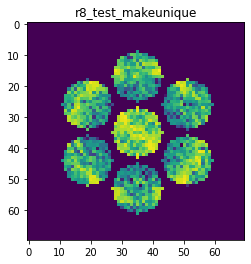

X_sim.max(): 0.7929033207494554
nlogf_X_sim.max(): 6.676961691553225
>>>replaced the 19. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 411ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 308ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 312ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000


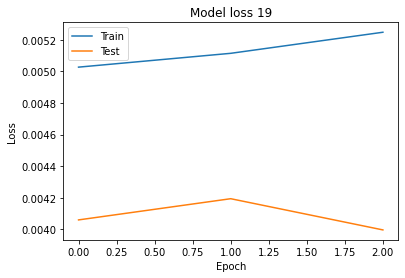

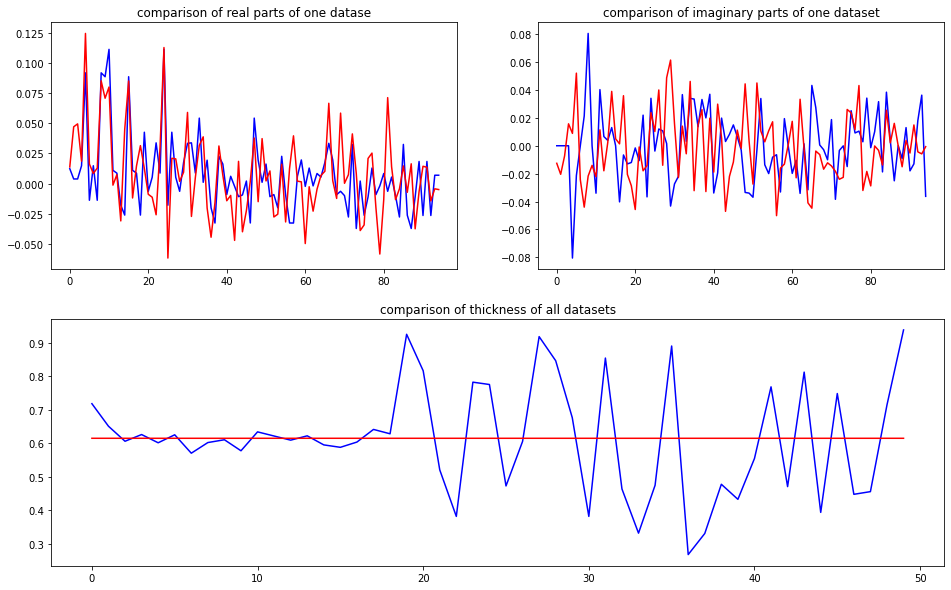

predicted thickness: 0.61436296


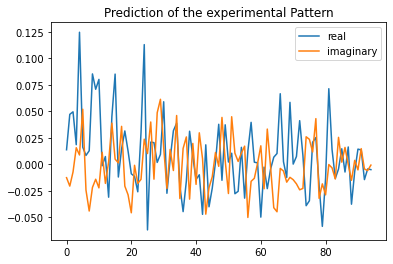

Applied shift of unit cell origin (fractional coordinates): 0.019272275767179207 -0.15544098307864515 0.02170189000001411
Ug[ 0 ]: 0.01379 0.0  =>  0.01379 0.0
Ug[ 1 ]: 0.04884 -0.13636  =>  0.04884 0.0
Ug[ 2 ]: 0.04884 0.13636  =>  0.04884 0.0
Ug[ 3 ]: 0.02411 0.97666  =>  0.02411 0.0
Ug[ 4 ]: 0.10612 0.14484  =>  0.10612 -0.69547
Ug[ 5 ]: 0.0502 1.27629  =>  0.0502 0.16327
Ug[ 6 ]: 0.02411 -0.97666  =>  0.02411 0.0
Ug[ 7 ]: 0.0502 -1.27629  =>  0.0502 -0.16327
Ug[ 8 ]: 0.10612 -0.14484  =>  0.10612 0.69547
Ug[ 9 ]: 0.0786 -0.12109  =>  0.0786 0.0
Ug[ 10 ]: 0.09928 -0.23349  =>  0.09928 0.02396
Ug[ 11 ]: 0.00831 2.49132  =>  0.00831 2.47605
Ug[ 12 ]: 0.02907 -1.18324  =>  0.02907 -0.08549
Ug[ 13 ]: 0.0466 -3.05718  =>  0.0466 -1.82306
Ug[ 14 ]: 0.0485 0.6602  =>  0.0485 1.6216
Ug[ 15 ]: 0.0786 0.12109  =>  0.0786 0.0
Ug[ 16 ]: 0.00831 -2.49132  =>  0.00831 -2.47605
Ug[ 17 ]: 0.02907 1.18324  =>  0.02907 0.08549
Ug[ 18 ]: 0.0485 -0.6602  =>  0.0485 -1.6216
Ug[ 19 ]: 0.03823 -1.11576  =

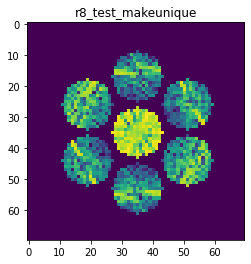

X_sim.max(): 0.9636867128604958
nlogf_X_sim.max(): 6.871803398743307
>>>replaced the 20. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 412ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0039 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 332ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0039 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 3s 332ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0039 - val_acc: 1.0000


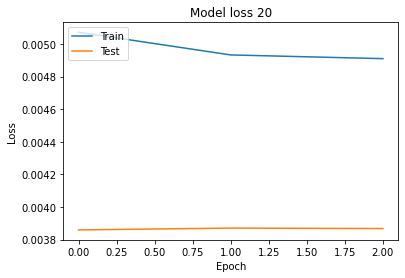

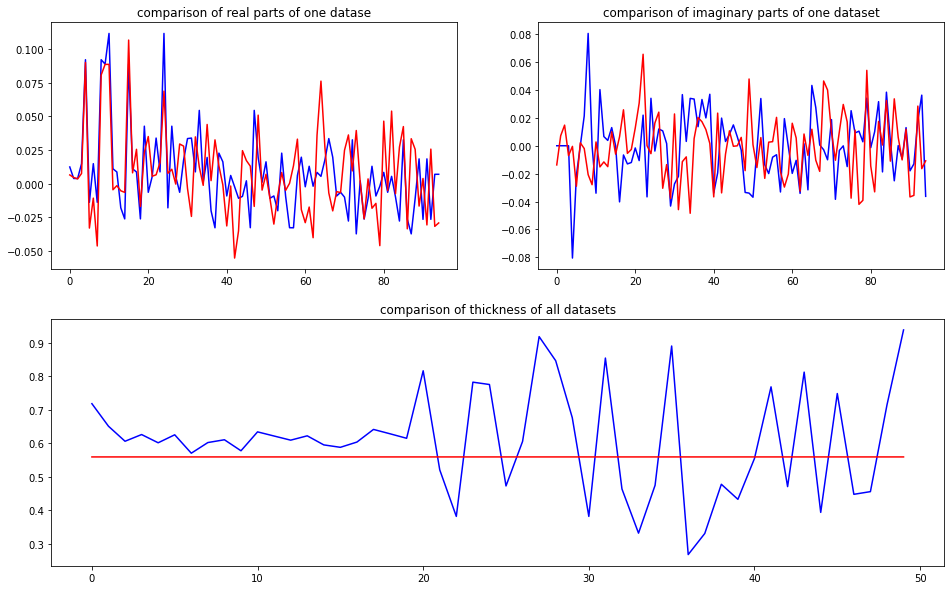

predicted thickness: 0.5586737


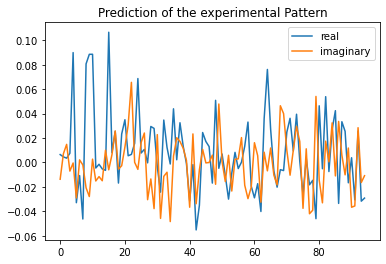

Applied shift of unit cell origin (fractional coordinates): 0.017766808588975787 0.3035348092406064 0.12044651832560876
Ug[ 0 ]: 0.00645 0.0  =>  0.00645 0.0
Ug[ 1 ]: 0.00556 -0.75679  =>  0.00556 0.0
Ug[ 2 ]: 0.00556 0.75679  =>  0.00556 0.0
Ug[ 3 ]: 0.00487 -1.90717  =>  0.00487 0.0
Ug[ 4 ]: 0.08599 0.11831  =>  0.08599 2.78226
Ug[ 5 ]: 0.04184 -2.81285  =>  0.04184 -1.66248
Ug[ 6 ]: 0.00487 1.90717  =>  0.00487 -0.0
Ug[ 7 ]: 0.04184 2.81285  =>  0.04184 1.66248
Ug[ 8 ]: 0.08599 -0.11831  =>  0.08599 -2.78226
Ug[ 9 ]: 0.09828 -0.11163  =>  0.09828 -0.0
Ug[ 10 ]: 0.07881 0.05332  =>  0.07881 0.92174
Ug[ 11 ]: 0.01095 -1.41046  =>  0.01095 -2.05562
Ug[ 12 ]: 0.02221 -1.00003  =>  0.02221 -2.79556
Ug[ 13 ]: 0.01567 -1.49277  =>  0.01567 -2.53152
Ug[ 14 ]: 0.014 2.55611  =>  0.014 0.00379
Ug[ 15 ]: 0.09828 0.11163  =>  0.09828 0.0
Ug[ 16 ]: 0.01095 1.41046  =>  0.01095 2.05562
Ug[ 17 ]: 0.02221 1.00003  =>  0.02221 2.79556
Ug[ 18 ]: 0.014 -2.55611  =>  0.014 -0.00379
Ug[ 19 ]: 0.02165 -0

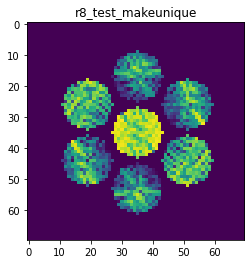

X_sim.max(): 0.9706190816352769
nlogf_X_sim.max(): 6.878963836329236
>>>replaced the 21. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 381ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 284ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 295ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0039 - val_acc: 1.0000


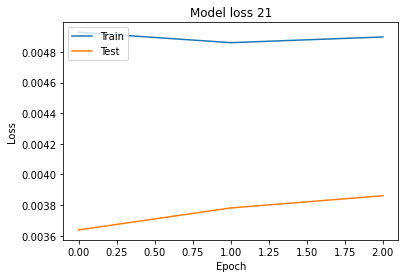

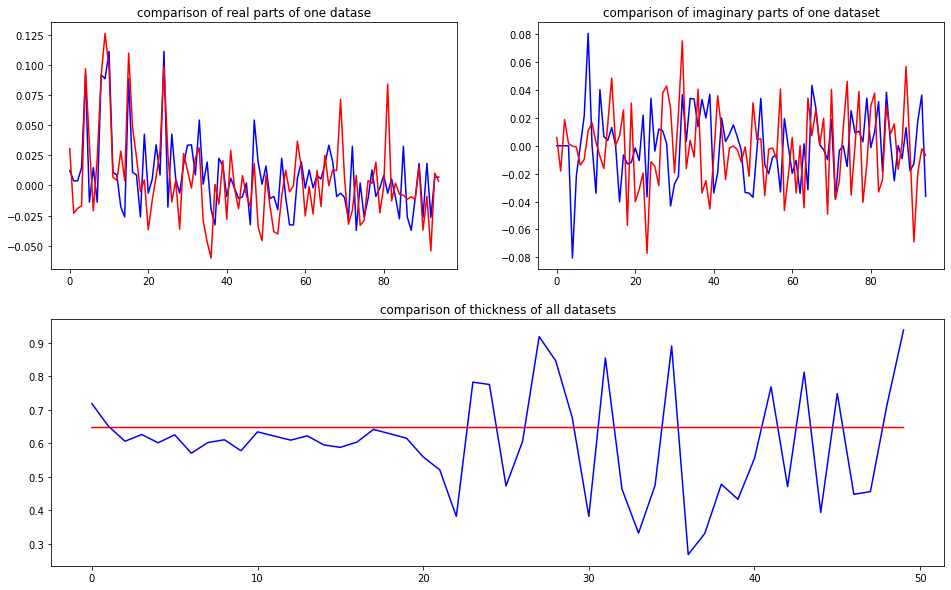

predicted thickness: 0.64644676


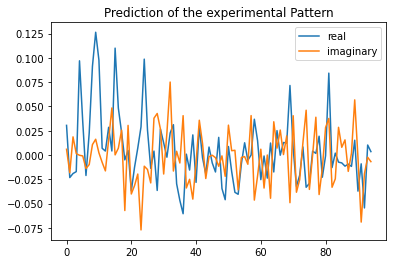

Applied shift of unit cell origin (fractional coordinates): -0.010855858339081028 -0.43898490607527135 0.38551375778131347
Ug[ 0 ]: 0.03059 0.0  =>  0.03059 0.0
Ug[ 1 ]: 0.028 -2.42225  =>  0.028 -0.0
Ug[ 2 ]: 0.028 2.42225  =>  0.028 0.0
Ug[ 3 ]: 0.02052 2.75822  =>  0.02052 0.0
Ug[ 4 ]: 0.09463 -0.05785  =>  0.09463 -0.39382
Ug[ 5 ]: 0.029 0.15455  =>  0.029 1.25726
Ug[ 6 ]: 0.02052 -2.75822  =>  0.02052 0.0
Ug[ 7 ]: 0.029 -0.15455  =>  0.029 -1.25726
Ug[ 8 ]: 0.09463 0.05785  =>  0.09463 0.39382
Ug[ 9 ]: 0.11896 0.06821  =>  0.11896 0.0
Ug[ 10 ]: 0.09873 0.06968  =>  0.09873 2.42373
Ug[ 11 ]: 0.02863 -0.25948  =>  0.02863 -2.74995
Ug[ 12 ]: 0.02508 -0.99259  =>  0.02508 1.69742
Ug[ 13 ]: 0.03122 0.51099  =>  0.03122 -0.65992
Ug[ 14 ]: 0.05277 1.57653  =>  0.05277 1.84429
Ug[ 15 ]: 0.11896 -0.06821  =>  0.11896 0.0
Ug[ 16 ]: 0.02863 0.25948  =>  0.02863 2.74995
Ug[ 17 ]: 0.02508 0.99259  =>  0.02508 -1.69742
Ug[ 18 ]: 0.05277 -1.57653  =>  0.05277 -1.84429
Ug[ 19 ]: 0.02994 1.72027  

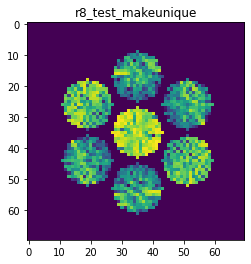

X_sim.max(): 0.8093951687747086
nlogf_X_sim.max(): 6.697521991385002
>>>replaced the 22. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 369ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 287ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 289ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000


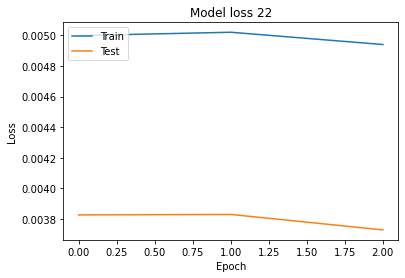

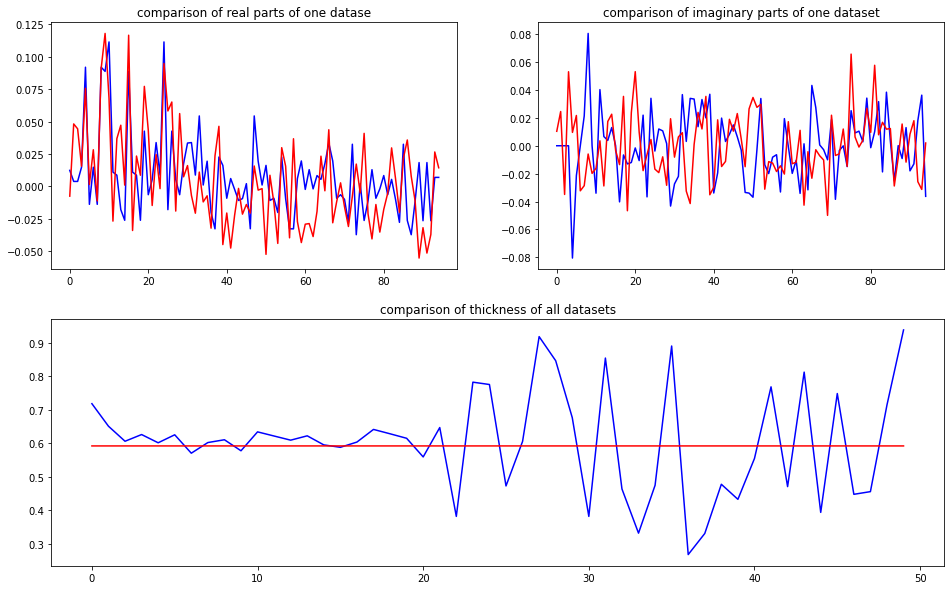

predicted thickness: 0.59153485


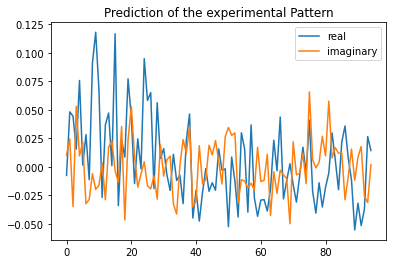

Applied shift of unit cell origin (fractional coordinates): 0.011211109370850698 -0.17481772044149374 -0.0910029403134429
Ug[ 0 ]: 0.00755 3.14159  =>  0.00755 3.14159
Ug[ 1 ]: 0.0549 0.57179  =>  0.0549 0.0
Ug[ 2 ]: 0.0549 -0.57179  =>  0.0549 -0.0
Ug[ 3 ]: 0.04788 1.09841  =>  0.04788 0.0
Ug[ 4 ]: 0.08341 0.09404  =>  0.08341 -1.57616
Ug[ 5 ]: 0.02565 1.76376  =>  0.02565 1.23713
Ug[ 6 ]: 0.04788 -1.09841  =>  0.04788 -0.0
Ug[ 7 ]: 0.02565 -1.76376  =>  0.02565 -1.23713
Ug[ 8 ]: 0.08341 -0.09404  =>  0.08341 1.57616
Ug[ 9 ]: 0.1169 -0.07044  =>  0.1169 0.0
Ug[ 10 ]: 0.0817 -0.12564  =>  0.0817 -0.62699
Ug[ 11 ]: 0.03165 2.86815  =>  0.03165 -2.77281
Ug[ 12 ]: 0.04396 -0.81882  =>  0.04396 0.35004
Ug[ 13 ]: 0.05527 0.31432  =>  0.05527 0.91139
Ug[ 14 ]: 0.03497 1.43465  =>  0.03497 -3.1079
Ug[ 15 ]: 0.1169 0.07044  =>  0.1169 0.0
Ug[ 16 ]: 0.03165 -2.86815  =>  0.03165 2.77281
Ug[ 17 ]: 0.04396 0.81882  =>  0.04396 -0.35004
Ug[ 18 ]: 0.03497 -1.43465  =>  0.03497 3.1079
Ug[ 19 ]: 0.07

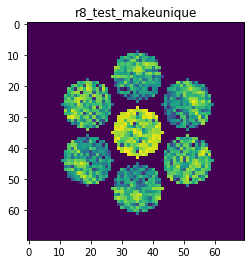

X_sim.max(): 0.878649565816221
nlogf_X_sim.max(): 6.779523607497962
>>>replaced the 23. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 402ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 310ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 310ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000


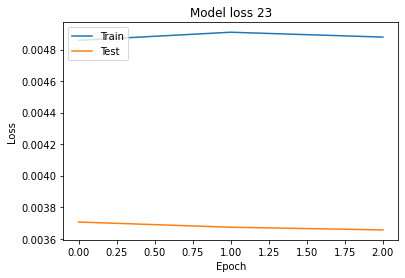

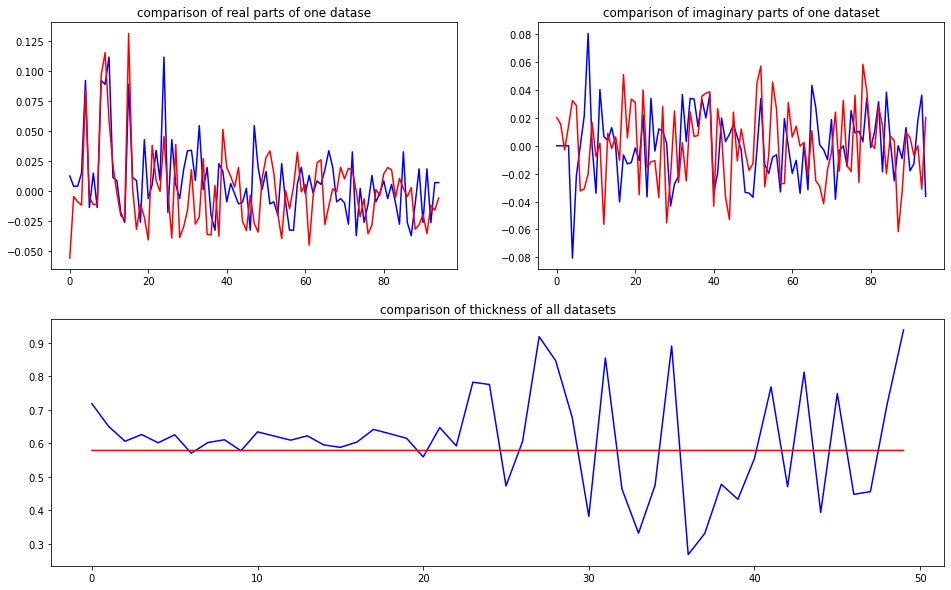

predicted thickness: 0.5780069


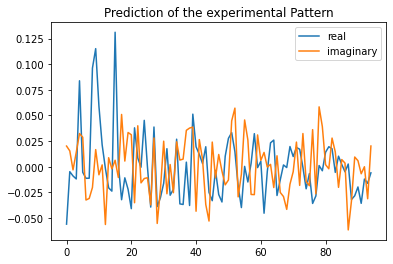

Applied shift of unit cell origin (fractional coordinates): -0.006878175595942104 -0.32351379834820587 -0.35184205811770053
Ug[ 0 ]: 0.05615 3.14159  =>  0.05615 3.14159
Ug[ 1 ]: 0.01154 2.21069  =>  0.01154 0.0
Ug[ 2 ]: 0.01154 -2.21069  =>  0.01154 -0.0
Ug[ 3 ]: 0.02602 2.0327  =>  0.02602 -0.0
Ug[ 4 ]: 0.09334 0.28616  =>  0.09334 2.32596
Ug[ 5 ]: 0.03099 1.84294  =>  0.03099 2.02093
Ug[ 6 ]: 0.02602 -2.0327  =>  0.02602 0.0
Ug[ 7 ]: 0.03099 -1.84294  =>  0.03099 -2.02093
Ug[ 8 ]: 0.09334 -0.28616  =>  0.09334 -2.32596
Ug[ 9 ]: 0.12245 0.04322  =>  0.12245 -0.0
Ug[ 10 ]: 0.05211 0.03435  =>  0.05211 -2.21956
Ug[ 11 ]: 0.01333 0.47716  =>  0.01333 2.64464
Ug[ 12 ]: 0.05629 -1.87905  =>  0.05629 0.11043
Ug[ 13 ]: 0.0144 2.39729  =>  0.0144 2.17608
Ug[ 14 ]: 0.0177 -2.92434  =>  0.0177 1.27583
Ug[ 15 ]: 0.12245 -0.04322  =>  0.12245 0.0
Ug[ 16 ]: 0.01333 -0.47716  =>  0.01333 -2.64464
Ug[ 17 ]: 0.05629 1.87905  =>  0.05629 -0.11043
Ug[ 18 ]: 0.0177 2.92434  =>  0.0177 -1.27583
Ug[ 19 ]


Residual error after kinematic rocking curve fit: 0.05781617750965651



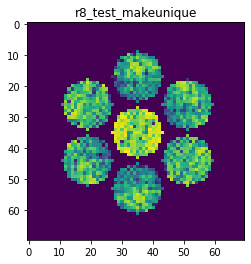

X_sim.max(): 0.8913914138256873
nlogf_X_sim.max(): 6.793904841070683
>>>replaced the 24. dataset and train: 
Epoch 1/3
8/8 [==============================] - 5s 413ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 308ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 305ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000


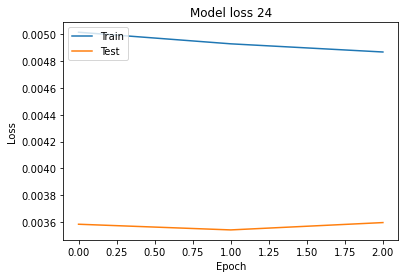

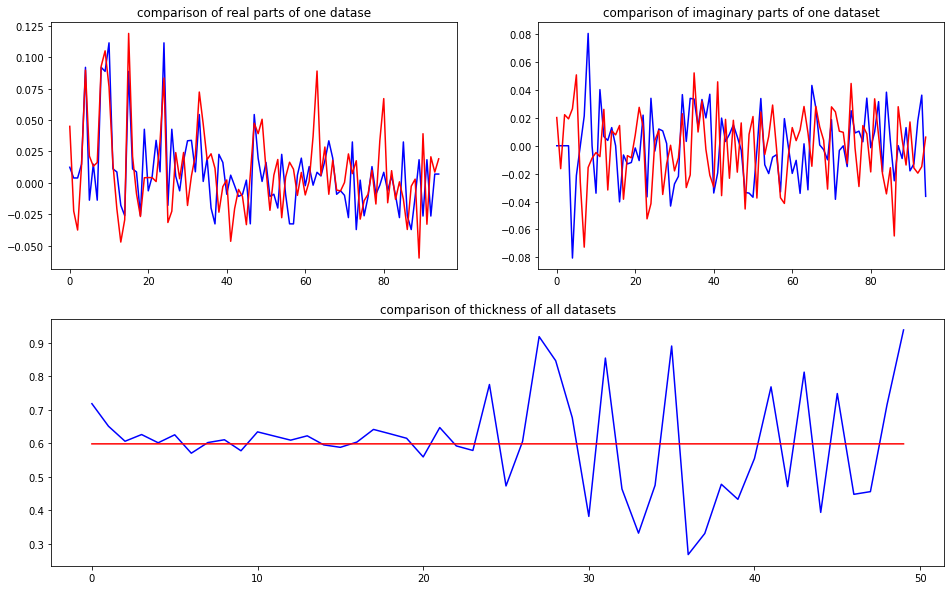

predicted thickness: 0.59770906


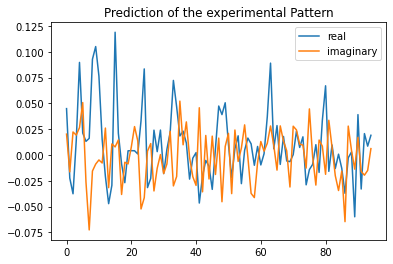

Applied shift of unit cell origin (fractional coordinates): 0.011778096769048806 -0.16446238500791044 0.40923435177499373
Ug[ 0 ]: 0.0448 0.0  =>  0.0448 0.0
Ug[ 1 ]: 0.0358 -2.5713  =>  0.0358 0.0
Ug[ 2 ]: 0.0358 2.5713  =>  0.0358 -0.0
Ug[ 3 ]: 0.02651 1.03335  =>  0.02651 0.0
Ug[ 4 ]: 0.0932 0.22809  =>  0.0932 1.76604
Ug[ 5 ]: 0.06452 1.28066  =>  0.06452 -2.32398
Ug[ 6 ]: 0.02651 -1.03335  =>  0.02651 0.0
Ug[ 7 ]: 0.06452 -1.28066  =>  0.06452 2.32398
Ug[ 8 ]: 0.0932 -0.22809  =>  0.0932 -1.76604
Ug[ 9 ]: 0.11165 -0.074  =>  0.11165 0.0
Ug[ 10 ]: 0.08164 0.22741  =>  0.08164 2.87271
Ug[ 11 ]: 0.0212 -0.55358  =>  0.0212 -3.05087
Ug[ 12 ]: 0.03549 2.00396  =>  0.03549 3.11132
Ug[ 13 ]: 0.04338 -2.719  =>  0.04338 0.95965
Ug[ 14 ]: 0.02957 2.83679  =>  0.02957 1.37284
Ug[ 15 ]: 0.11165 0.074  =>  0.11165 0.0
Ug[ 16 ]: 0.0212 0.55358  =>  0.0212 3.05087
Ug[ 17 ]: 0.03549 -2.00396  =>  0.03549 -3.11132
Ug[ 18 ]: 0.02957 -2.83679  =>  0.02957 -1.37284
Ug[ 19 ]: 0.01358 -2.32945  =>  0.

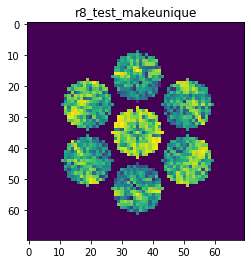

X_sim.max(): 0.8253370994023488
nlogf_X_sim.max(): 6.717002800923071
>>>replaced the 25. dataset and train: 
Epoch 1/3
8/8 [==============================] - 5s 422ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 316ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 308ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000


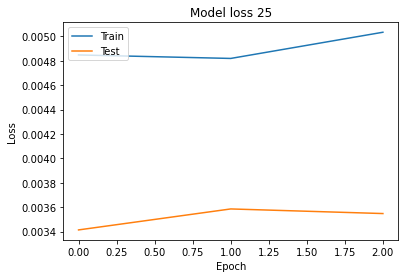

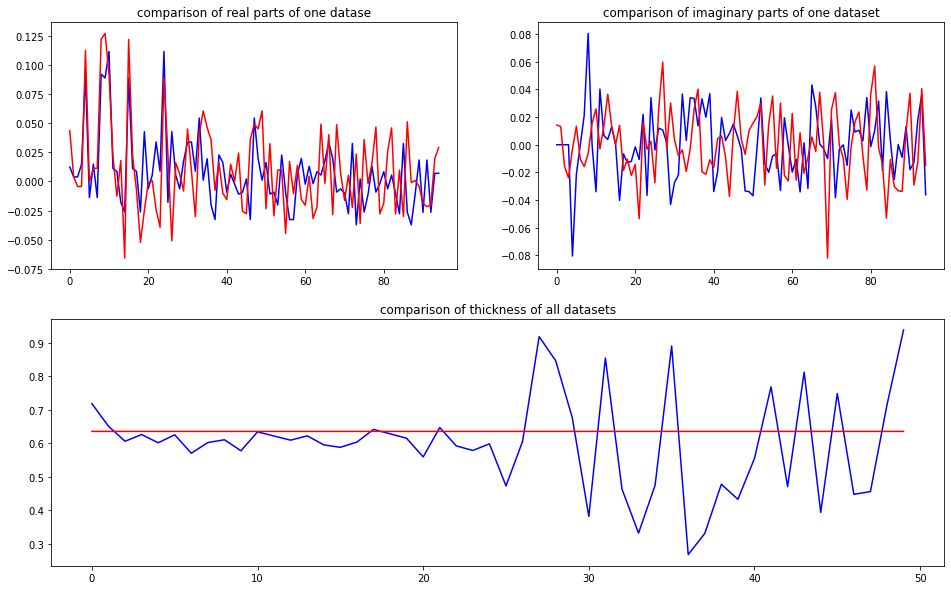

predicted thickness: 0.6349646


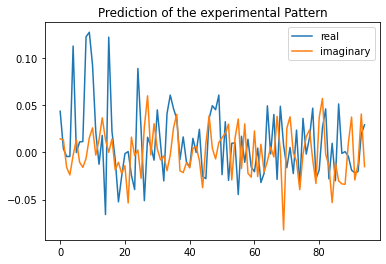

Applied shift of unit cell origin (fractional coordinates): -0.00979336775390426 0.17632584436332155 -0.25242434870141683
Ug[ 0 ]: 0.04359 0.0  =>  0.04359 0.0
Ug[ 1 ]: 0.01446 1.58603  =>  0.01446 0.0
Ug[ 2 ]: 0.01446 -1.58603  =>  0.01446 -0.0
Ug[ 3 ]: 0.00749 -1.10789  =>  0.00749 0.0
Ug[ 4 ]: 0.11819 0.01291  =>  0.11819 -0.46523
Ug[ 5 ]: 0.01566 1.20286  =>  0.01566 -2.38641
Ug[ 6 ]: 0.00749 1.10789  =>  0.00749 -0.0
Ug[ 7 ]: 0.01566 -1.20286  =>  0.01566 2.38641
Ug[ 8 ]: 0.11819 -0.01291  =>  0.11819 0.46523
Ug[ 9 ]: 0.12564 0.06153  =>  0.12564 0.0
Ug[ 10 ]: 0.09166 0.12871  =>  0.09166 -1.51886
Ug[ 11 ]: 0.02345 -0.37035  =>  0.02345 1.15414
Ug[ 12 ]: 0.01877 2.13661  =>  0.01877 0.96719
Ug[ 13 ]: 0.03831 0.99161  =>  0.03831 -1.76384
Ug[ 14 ]: 0.05999 2.94076  =>  0.05999 -2.92582
Ug[ 15 ]: 0.12564 -0.06153  =>  0.12564 -0.0
Ug[ 16 ]: 0.02345 0.37035  =>  0.02345 -1.15414
Ug[ 17 ]: 0.01877 -2.13661  =>  0.01877 -0.96719
Ug[ 18 ]: 0.05999 -2.94076  =>  0.05999 2.92582
Ug[ 19 ]:

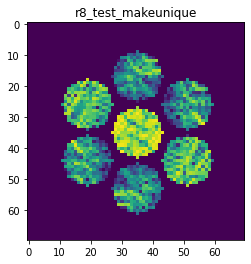

X_sim.max(): 0.9486701706896742
nlogf_X_sim.max(): 6.856114735562908
>>>replaced the 26. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 389ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 270ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 259ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000


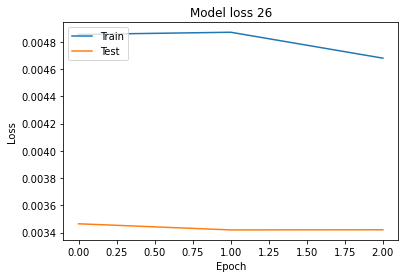

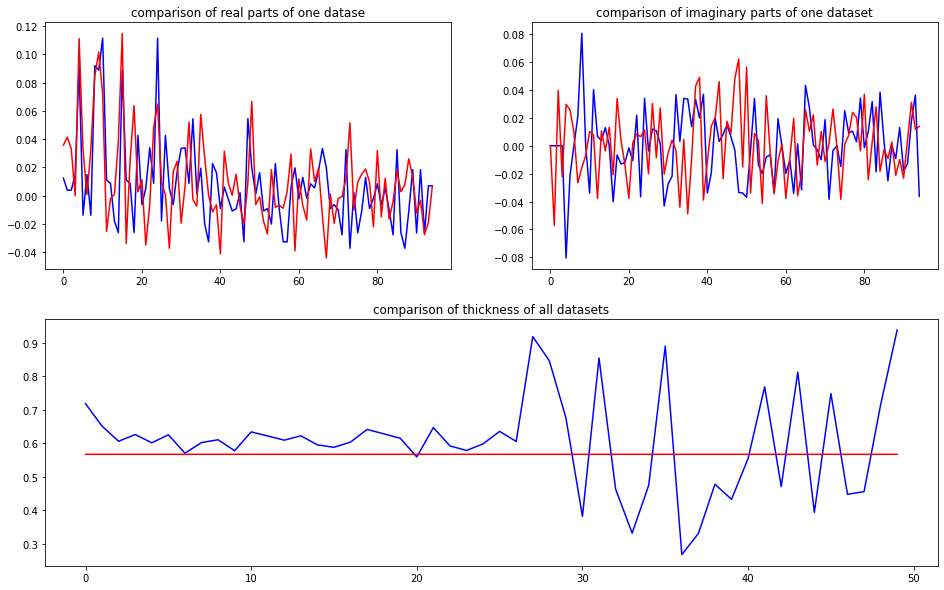

predicted thickness: 0.5665075


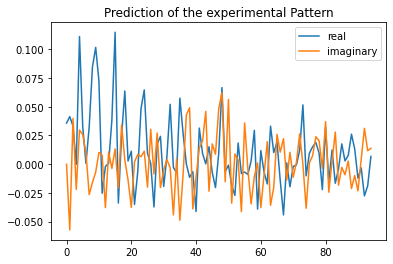

Applied shift of unit cell origin (fractional coordinates): 0.01484298403210665 0.2471733711568345 0.14587136410990725
Ug[ 0 ]: 0.03574 0.0  =>  0.03574 0.0
Ug[ 1 ]: 0.06113 -0.91654  =>  0.06113 0.0
Ug[ 2 ]: 0.06113 0.91654  =>  0.06113 0.0
Ug[ 3 ]: 0.01579 -1.55304  =>  0.01579 0.0
Ug[ 4 ]: 0.10045 0.22852  =>  0.10045 2.69809
Ug[ 5 ]: 0.04182 0.67517  =>  0.04182 1.31167
Ug[ 6 ]: 0.01579 1.55304  =>  0.01579 -0.0
Ug[ 7 ]: 0.04182 -0.67517  =>  0.04182 -1.31167
Ug[ 8 ]: 0.10045 -0.22852  =>  0.10045 -2.69809
Ug[ 9 ]: 0.10869 -0.09326  =>  0.10869 0.0
Ug[ 10 ]: 0.06849 -0.00808  =>  0.06849 1.00171
Ug[ 11 ]: 0.03284 2.69155  =>  0.03284 1.86827
Ug[ 12 ]: 0.03763 -1.26352  =>  0.03763 -2.7233
Ug[ 13 ]: 0.01613 1.25276  =>  0.01613 0.70952
Ug[ 14 ]: 0.05119 -0.07325  =>  0.05119 -2.44956
Ug[ 15 ]: 0.10869 0.09326  =>  0.10869 0.0
Ug[ 16 ]: 0.03284 -2.69155  =>  0.03284 -1.86827
Ug[ 17 ]: 0.03763 1.26352  =>  0.03763 2.7233
Ug[ 18 ]: 0.05119 0.07325  =>  0.05119 2.44956
Ug[ 19 ]: 0.02213

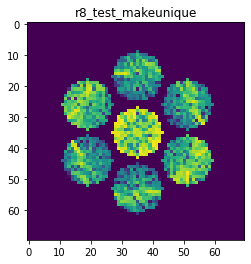

X_sim.max(): 0.8869184932685269
nlogf_X_sim.max(): 6.788879951919731
>>>replaced the 27. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 362ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 272ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 269ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000


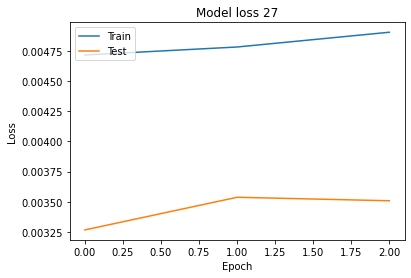

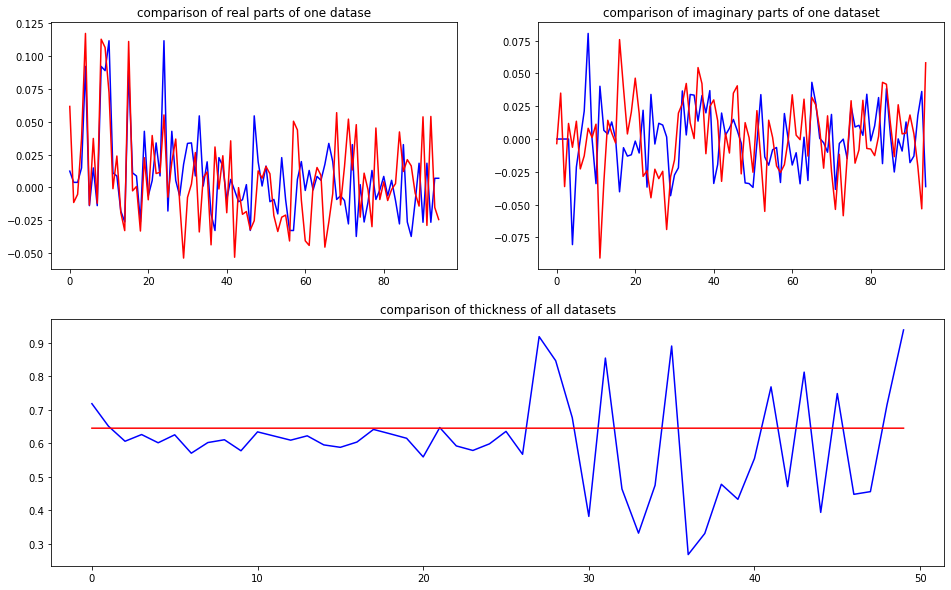

predicted thickness: 0.6445335


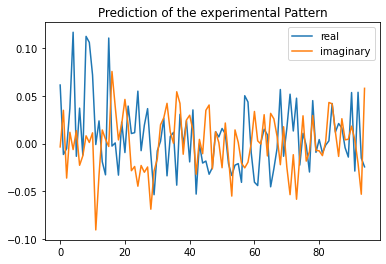

Applied shift of unit cell origin (fractional coordinates): -0.0031530206321223274 -0.06971966375927378 -0.28700916375238666
Ug[ 0 ]: 0.06133 0.0  =>  0.06133 0.0
Ug[ 1 ]: 0.03661 1.80333  =>  0.03661 0.0
Ug[ 2 ]: 0.03661 -1.80333  =>  0.03661 -0.0
Ug[ 3 ]: 0.04088 0.43806  =>  0.04088 -0.0
Ug[ 4 ]: 0.11434 -0.06343  =>  0.11434 -2.30483
Ug[ 5 ]: 0.01835 2.33761  =>  0.01835 -2.58031
Ug[ 6 ]: 0.04088 -0.43806  =>  0.04088 0.0
Ug[ 7 ]: 0.01835 -2.33761  =>  0.01835 2.58031
Ug[ 8 ]: 0.11434 0.06343  =>  0.11434 2.30483
Ug[ 9 ]: 0.10802 0.01981  =>  0.10802 0.0
Ug[ 10 ]: 0.06925 0.41685  =>  0.06925 -1.40629
Ug[ 11 ]: 0.08337 -1.5971  =>  0.08337 0.18642
Ug[ 12 ]: 0.03796 -1.24404  =>  0.03796 -0.82578
Ug[ 13 ]: 0.02291 2.18951  =>  0.02291 0.80443
Ug[ 14 ]: 0.03306 3.12932  =>  0.03306 -0.93229
Ug[ 15 ]: 0.10802 -0.01981  =>  0.10802 0.0
Ug[ 16 ]: 0.08337 1.5971  =>  0.08337 -0.18642
Ug[ 17 ]: 0.03796 1.24404  =>  0.03796 0.82578
Ug[ 18 ]: 0.03306 -3.12932  =>  0.03306 0.93229
Ug[ 19 ]: 

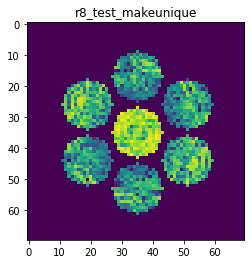

X_sim.max(): 0.9698598710044508
nlogf_X_sim.max(): 6.87818214377246
>>>replaced the 28. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 339ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 246ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 251ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000


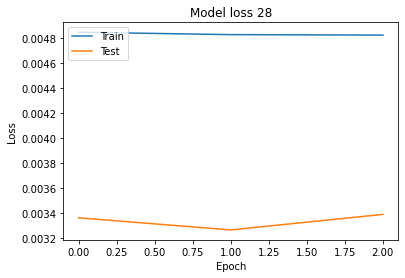

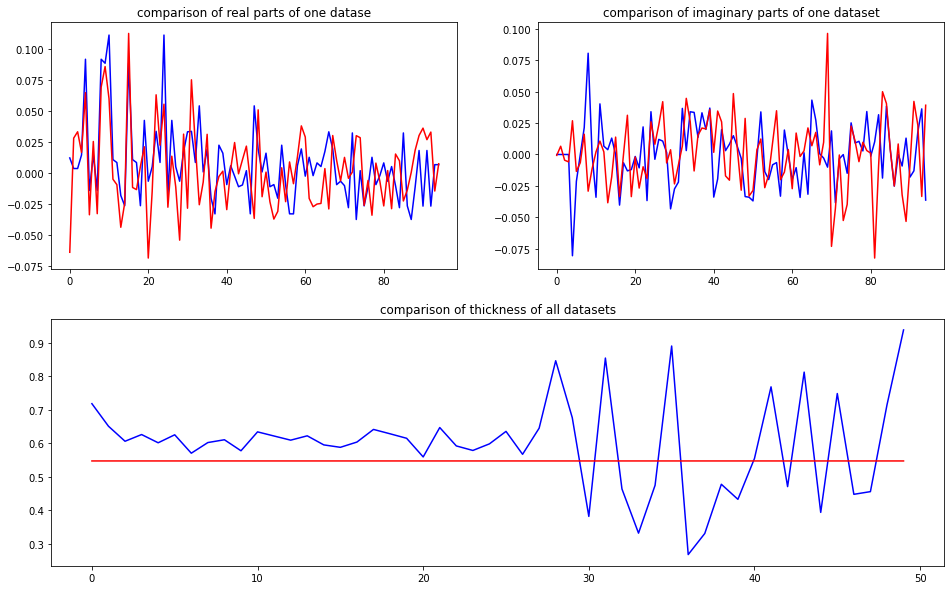

predicted thickness: 0.5466657


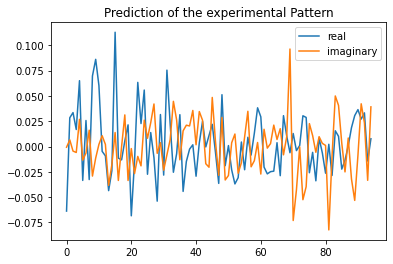

Applied shift of unit cell origin (fractional coordinates): 0.019963215402362636 -0.0024460005484979366 -0.028260471346619506
Ug[ 0 ]: 0.06398 3.14159  =>  0.06398 3.14159
Ug[ 1 ]: 0.03137 0.17757  =>  0.03137 -0.0
Ug[ 2 ]: 0.03137 -0.17757  =>  0.03137 0.0
Ug[ 3 ]: 0.02121 0.01537  =>  0.02121 0.0
Ug[ 4 ]: 0.07265 0.39609  =>  0.07265 0.20316
Ug[ 5 ]: 0.03627 -2.72189  =>  0.03627 -2.55969
Ug[ 6 ]: 0.02121 -0.01537  =>  0.02121 -0.0
Ug[ 7 ]: 0.03627 2.72189  =>  0.03627 2.55969
Ug[ 8 ]: 0.07265 -0.39609  =>  0.07265 -0.20316
Ug[ 9 ]: 0.09968 -0.12543  =>  0.09968 -0.0
Ug[ 10 ]: 0.05899 -0.20425  =>  0.05899 -0.25638
Ug[ 11 ]: 0.02356 1.9243  =>  0.02356 2.22729
Ug[ 12 ]: 0.01125 3.04242  =>  0.01125 -3.09996
Ug[ 13 ]: 0.04255 -2.56121  =>  0.04255 -2.59797
Ug[ 14 ]: 0.0262 -1.93168  =>  0.0262 -1.61331
Ug[ 15 ]: 0.09968 0.12543  =>  0.09968 0.0
Ug[ 16 ]: 0.02356 -1.9243  =>  0.02356 -2.22729
Ug[ 17 ]: 0.01125 -3.04242  =>  0.01125 3.09996
Ug[ 18 ]: 0.0262 1.93168  =>  0.0262 1.61331
U

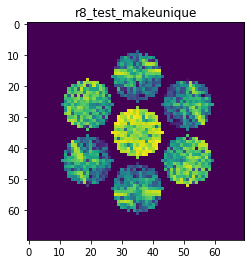

X_sim.max(): 0.9269289365975366
nlogf_X_sim.max(): 6.832955152911727
>>>replaced the 29. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 377ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 289ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 290ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000


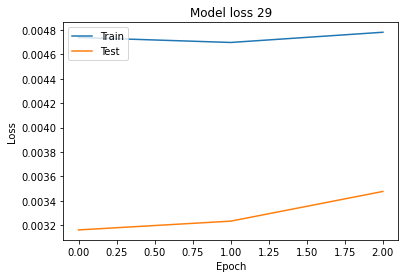

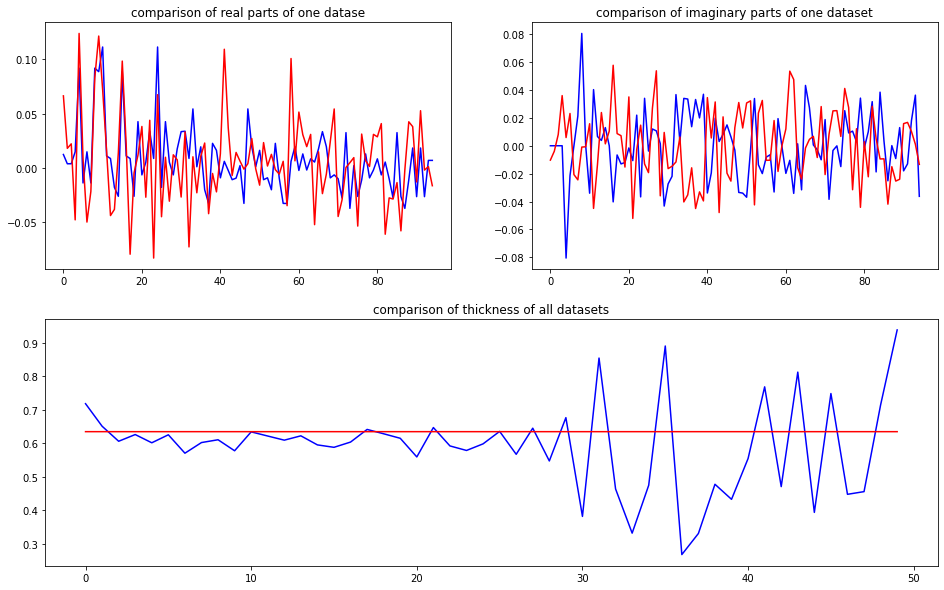

predicted thickness: 0.63413084


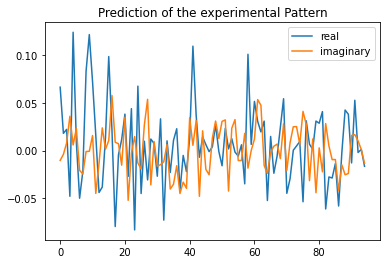

Applied shift of unit cell origin (fractional coordinates): 0.00815297284359294 -0.4165250556597436 0.04607150198105312
Ug[ 0 ]: 0.0664 0.0  =>  0.0664 0.0
Ug[ 1 ]: 0.02101 -0.28948  =>  0.02101 0.0
Ug[ 2 ]: 0.02101 0.28948  =>  0.02101 -0.0
Ug[ 3 ]: 0.05653 2.6171  =>  0.05653 0.0
Ug[ 4 ]: 0.10354 0.03282  =>  0.10354 -2.29481
Ug[ 5 ]: 0.0247 1.84133  =>  0.0247 -1.06525
Ug[ 6 ]: 0.05653 -2.6171  =>  0.05653 0.0
Ug[ 7 ]: 0.0247 -1.84133  =>  0.0247 1.06525
Ug[ 8 ]: 0.10354 -0.03282  =>  0.10354 2.29481
Ug[ 9 ]: 0.11012 -0.05123  =>  0.11012 -0.0
Ug[ 10 ]: 0.07127 0.20351  =>  0.07127 0.54422
Ug[ 11 ]: 0.05458 -1.22171  =>  0.05458 -1.45996
Ug[ 12 ]: 0.06277 -2.96439  =>  0.06277 -0.29606
Ug[ 13 ]: 0.04688 2.66414  =>  0.04688 -0.66124
Ug[ 14 ]: 0.00556 -0.55411  =>  0.00556 1.82475
Ug[ 15 ]: 0.11012 0.05123  =>  0.11012 0.0
Ug[ 16 ]: 0.05458 1.22171  =>  0.05458 1.45996
Ug[ 17 ]: 0.06277 2.96439  =>  0.06277 0.29606
Ug[ 18 ]: 0.00556 0.55411  =>  0.00556 -1.82475
Ug[ 19 ]: 0.02369 -1.

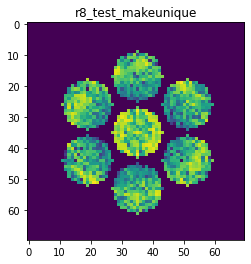

X_sim.max(): 0.8161997794994114
nlogf_X_sim.max(): 6.705883593118922
>>>replaced the 30. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 409ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 324ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 320ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 1.0000


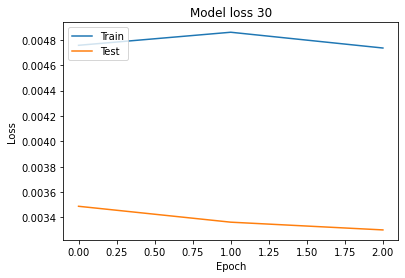

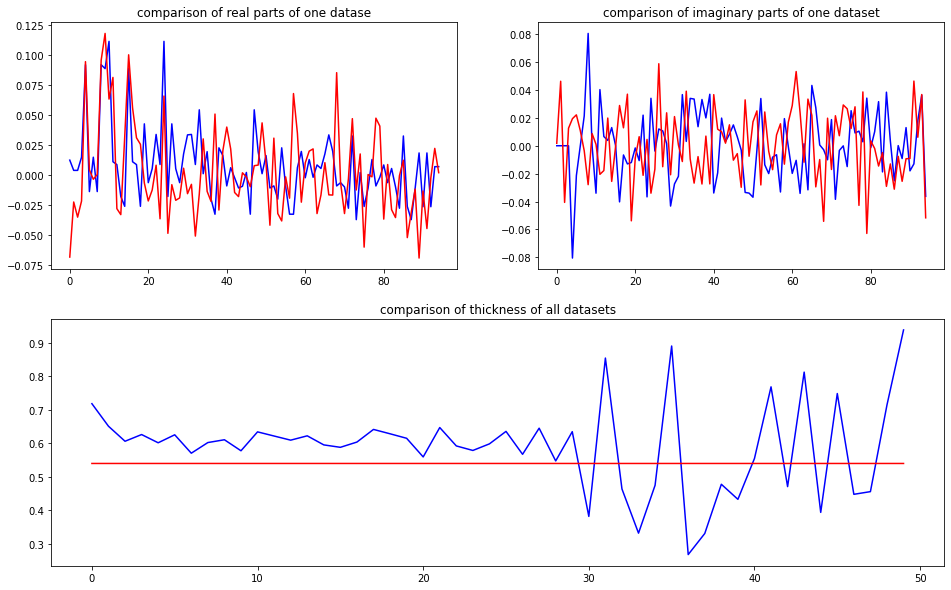

predicted thickness: 0.5391499


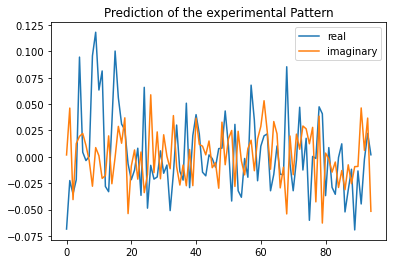

Applied shift of unit cell origin (fractional coordinates): -0.006476373195858569 -0.4893337284765624 -0.3438197200081914
Ug[ 0 ]: 0.0688 3.14159  =>  0.0688 3.14159
Ug[ 1 ]: 0.05222 2.16028  =>  0.05222 0.0
Ug[ 2 ]: 0.05222 -2.16028  =>  0.05222 0.0
Ug[ 3 ]: 0.01272 3.07457  =>  0.01272 -0.0
Ug[ 4 ]: 0.09753 0.24533  =>  0.09753 1.29366
Ug[ 5 ]: 0.01309 1.39023  =>  0.01309 0.47594
Ug[ 6 ]: 0.01272 -3.07457  =>  0.01272 0.0
Ug[ 7 ]: 0.01309 -1.39023  =>  0.01309 -0.47594
Ug[ 8 ]: 0.09753 -0.24533  =>  0.09753 -1.29366
Ug[ 9 ]: 0.10859 0.04069  =>  0.10859 0.0
Ug[ 10 ]: 0.06668 0.26643  =>  0.06668 -1.93454
Ug[ 11 ]: 0.07272 -0.34739  =>  0.07272 1.7722
Ug[ 12 ]: 0.01538 -1.48104  =>  0.01538 1.55284
Ug[ 13 ]: 0.04494 2.72051  =>  0.04494 -2.68908
Ug[ 14 ]: 0.04238 -0.82921  =>  0.04238 -1.91823
Ug[ 15 ]: 0.10859 -0.04069  =>  0.10859 0.0
Ug[ 16 ]: 0.07272 0.34739  =>  0.07272 -1.7722
Ug[ 17 ]: 0.01538 1.48104  =>  0.01538 -1.55284
Ug[ 18 ]: 0.04238 0.82921  =>  0.04238 1.91823
Ug[ 19 

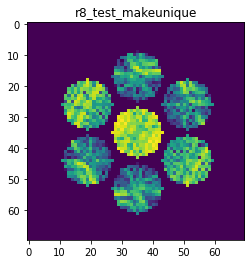

X_sim.max(): 0.950429119738006
nlogf_X_sim.max(): 6.857965190780163
>>>replaced the 31. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 392ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 306ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 313ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 1.0000


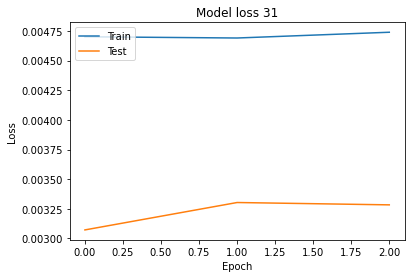

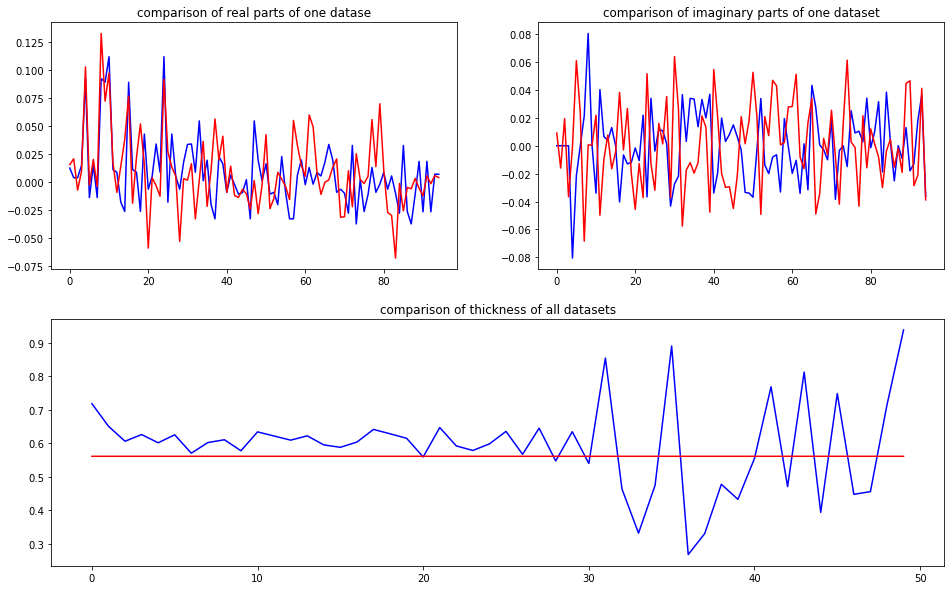

predicted thickness: 0.56058836


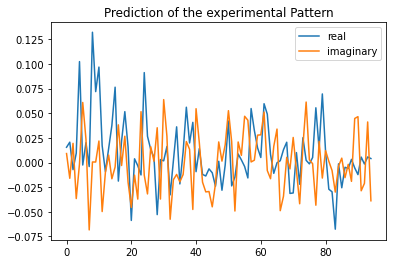

Applied shift of unit cell origin (fractional coordinates): -0.005410831729701595 0.1773317192556299 0.19248574066127502
Ug[ 0 ]: 0.01548 0.0  =>  0.01548 0.0
Ug[ 1 ]: 0.01897 -1.20942  =>  0.01897 0.0
Ug[ 2 ]: 0.01897 1.20942  =>  0.01897 0.0
Ug[ 3 ]: 0.03352 -1.11421  =>  0.03352 -0.0
Ug[ 4 ]: 0.11706 -0.00758  =>  0.11706 2.31605
Ug[ 5 ]: 0.06478 1.62314  =>  0.06478 1.52792
Ug[ 6 ]: 0.03352 1.11421  =>  0.03352 0.0
Ug[ 7 ]: 0.06478 -1.62314  =>  0.06478 -1.52792
Ug[ 8 ]: 0.11706 0.00758  =>  0.11706 -2.31605
Ug[ 9 ]: 0.07415 0.034  =>  0.07415 0.0
Ug[ 10 ]: 0.09547 0.18225  =>  0.09547 1.35768
Ug[ 11 ]: 0.04401 -1.59168  =>  0.04401 -2.8351
Ug[ 12 ]: 0.00726 -0.5049  =>  0.00726 -1.65311
Ug[ 13 ]: 0.02837 0.76979  =>  0.02837 0.83101
Ug[ 14 ]: 0.04955 -0.45063  =>  0.04955 -2.80826
Ug[ 15 ]: 0.07415 -0.034  =>  0.07415 0.0
Ug[ 16 ]: 0.04401 1.59168  =>  0.04401 2.8351
Ug[ 17 ]: 0.00726 0.5049  =>  0.00726 1.65311
Ug[ 18 ]: 0.04955 0.45063  =>  0.04955 2.80826
Ug[ 19 ]: 0.02317 -0.8

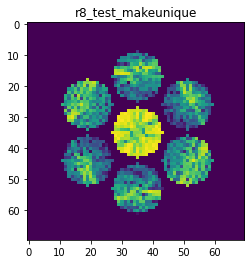

X_sim.max(): 0.9663529296516009
nlogf_X_sim.max(): 6.87456340265312
>>>replaced the 32. dataset and train: 
Epoch 1/3
8/8 [==============================] - 5s 417ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 309ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 298ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000


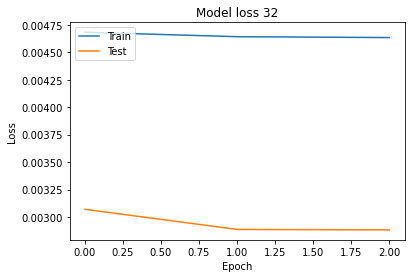

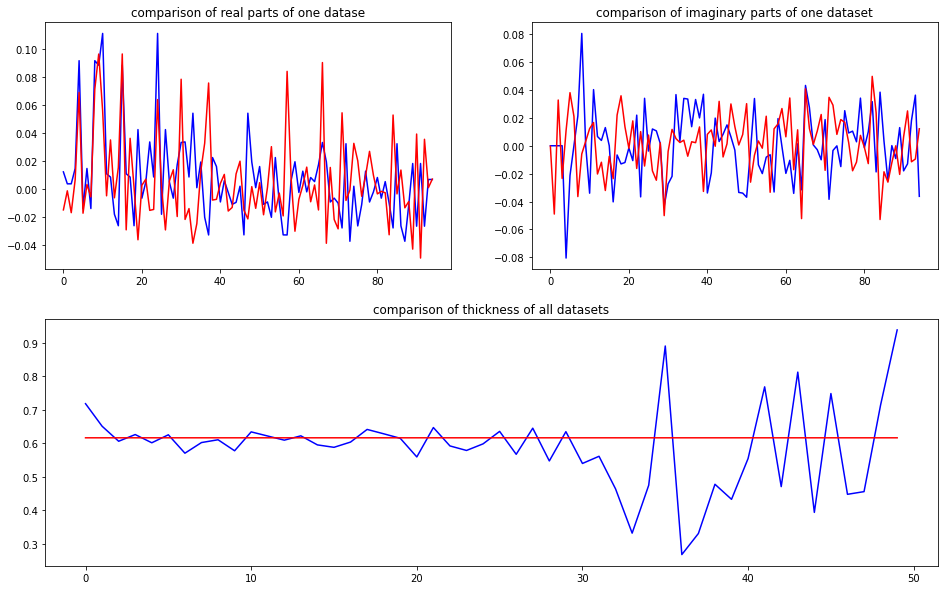

predicted thickness: 0.6157884


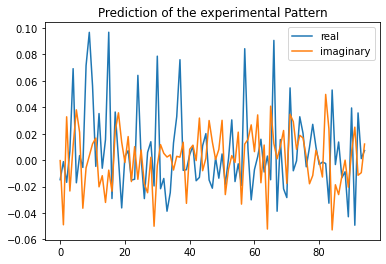

Applied shift of unit cell origin (fractional coordinates): -0.008835406361578977 0.2138576562285185 0.28406029206343725
Ug[ 0 ]: 0.01483 3.14159  =>  0.01483 3.14159
Ug[ 1 ]: 0.0418 -1.7848  =>  0.0418 0.0
Ug[ 2 ]: 0.0418 1.7848  =>  0.0418 -0.0
Ug[ 3 ]: 0.02283 -1.34371  =>  0.02283 0.0
Ug[ 4 ]: 0.07121 0.1182  =>  0.07121 -3.03648
Ug[ 5 ]: 0.03892 1.8645  =>  0.03892 1.4234
Ug[ 6 ]: 0.02283 1.34371  =>  0.02283 -0.0
Ug[ 7 ]: 0.03892 -1.8645  =>  0.03892 -1.4234
Ug[ 8 ]: 0.07121 -0.1182  =>  0.07121 3.03648
Ug[ 9 ]: 0.09749 0.05551  =>  0.09749 0.0
Ug[ 10 ]: 0.06185 0.21799  =>  0.06185 1.94728
Ug[ 11 ]: 0.02625 2.26914  =>  0.02625 0.42882
Ug[ 12 ]: 0.04168 -0.53125  =>  0.04168 -1.93047
Ug[ 13 ]: 0.00999 -1.79553  =>  0.00999 -1.40995
Ug[ 14 ]: 0.035 -1.32498  =>  0.035 1.77418
Ug[ 15 ]: 0.09749 -0.05551  =>  0.09749 0.0
Ug[ 16 ]: 0.02625 -2.26914  =>  0.02625 -0.42882
Ug[ 17 ]: 0.04168 0.53125  =>  0.04168 1.93047
Ug[ 18 ]: 0.035 1.32498  =>  0.035 -1.77418
Ug[ 19 ]: 0.03623 2.690

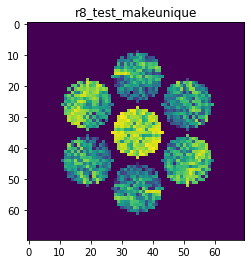

X_sim.max(): 0.9256708296495291
nlogf_X_sim.max(): 6.831598410434031
>>>replaced the 33. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 344ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 281ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 288ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000


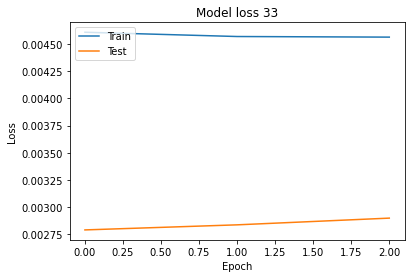

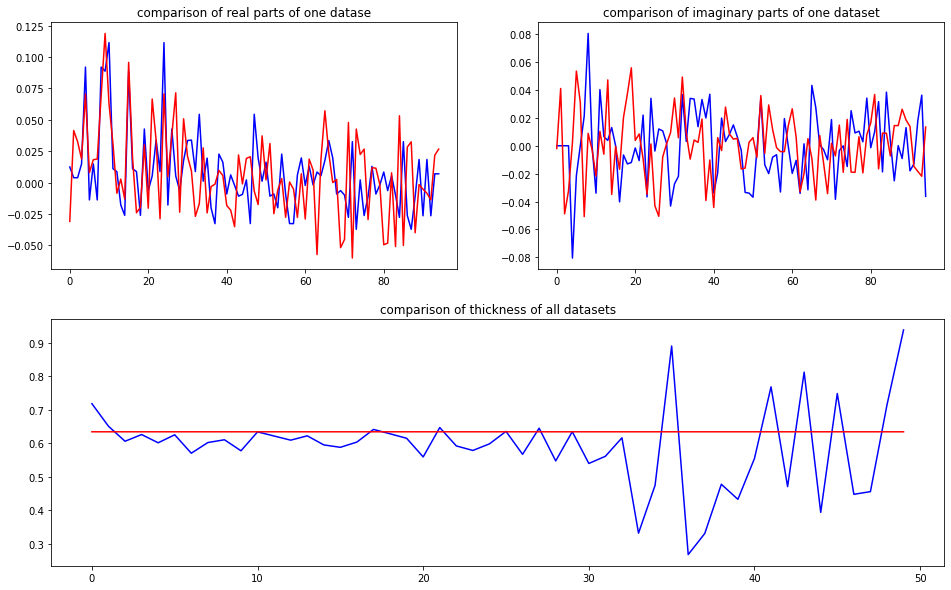

predicted thickness: 0.633757


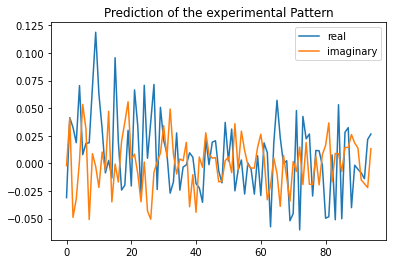

Applied shift of unit cell origin (fractional coordinates): 0.001410704065150376 0.1654084734071331 -0.1399260194151532
Ug[ 0 ]: 0.03093 3.14159  =>  0.03093 3.14159
Ug[ 1 ]: 0.05834 0.87918  =>  0.05834 0.0
Ug[ 2 ]: 0.05834 -0.87918  =>  0.05834 -0.0
Ug[ 3 ]: 0.03665 -1.03929  =>  0.03665 -0.0
Ug[ 4 ]: 0.07028 -0.04536  =>  0.07028 0.11475
Ug[ 5 ]: 0.05388 1.31768  =>  0.05388 -3.04703
Ug[ 6 ]: 0.03665 1.03929  =>  0.03665 0.0
Ug[ 7 ]: 0.05388 -1.31768  =>  0.05388 3.04703
Ug[ 8 ]: 0.07028 0.04536  =>  0.07028 -0.11475
Ug[ 9 ]: 0.10798 -0.00886  =>  0.10798 0.0
Ug[ 10 ]: 0.06797 -0.17073  =>  0.06797 -1.04105
Ug[ 11 ]: 0.02881 0.49202  =>  0.02881 1.38007
Ug[ 12 ]: 0.02096 -2.46238  =>  0.02096 2.79038
Ug[ 13 ]: 0.04528 1.48649  =>  0.04528 -0.42312
Ug[ 14 ]: 0.03964 -1.99652  =>  0.03964 -2.14777
Ug[ 15 ]: 0.10798 0.00886  =>  0.10798 -0.0
Ug[ 16 ]: 0.02881 -0.49202  =>  0.02881 -1.38007
Ug[ 17 ]: 0.02096 2.46238  =>  0.02096 -2.79038
Ug[ 18 ]: 0.03964 1.99652  =>  0.03964 2.14777
Ug

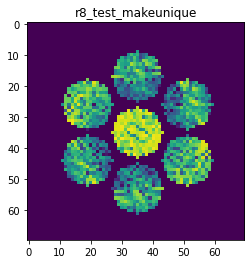

X_sim.max(): 0.9079188825757308
nlogf_X_sim.max(): 6.812255852105018
>>>replaced the 34. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 364ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 265ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 261ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000


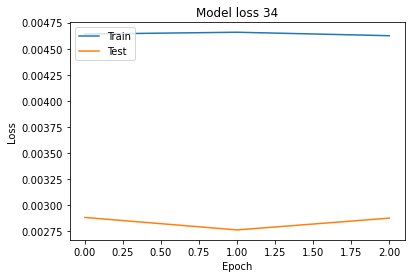

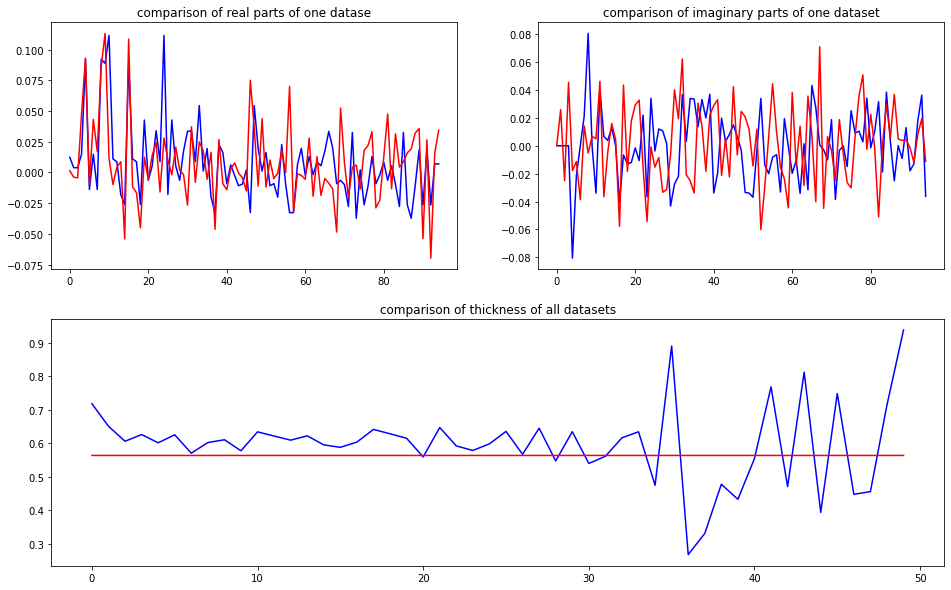

predicted thickness: 0.56309545


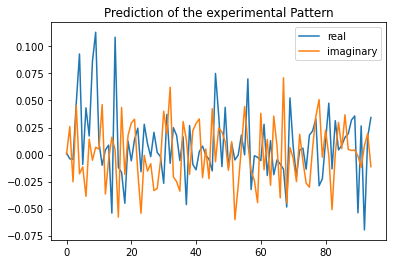

Applied shift of unit cell origin (fractional coordinates): -0.001691490545791952 -0.11881183996369118 -0.27581411359828584
Ug[ 0 ]: 0.00139 0.0  =>  0.00139 0.0
Ug[ 1 ]: 0.02586 1.73299  =>  0.02586 0.0
Ug[ 2 ]: 0.02586 -1.73299  =>  0.02586 -0.0
Ug[ 3 ]: 0.06192 0.74652  =>  0.06192 -0.0
Ug[ 4 ]: 0.08991 -0.06974  =>  0.08991 -2.54925
Ug[ 5 ]: 0.0134 -1.2646  =>  0.0134 -0.27813
Ug[ 6 ]: 0.06192 -0.74652  =>  0.06192 0.0
Ug[ 7 ]: 0.0134 1.2646  =>  0.0134 0.27813
Ug[ 8 ]: 0.08991 0.06974  =>  0.08991 2.54925
Ug[ 9 ]: 0.111 0.01063  =>  0.111 0.0
Ug[ 10 ]: 0.02 0.14371  =>  0.02 -1.59991
Ug[ 11 ]: 0.05311 1.7749  =>  0.05311 -2.78592
Ug[ 12 ]: 0.0405 -1.72316  =>  0.0405 -0.98728
Ug[ 13 ]: 0.01087 0.519  =>  0.01087 -0.4781
Ug[ 14 ]: 0.05248 2.80743  =>  0.05248 -1.00688
Ug[ 15 ]: 0.111 -0.01063  =>  0.111 0.0
Ug[ 16 ]: 0.05311 -1.7749  =>  0.05311 2.78592
Ug[ 17 ]: 0.0405 1.72316  =>  0.0405 0.98728
Ug[ 18 ]: 0.05248 -2.80743  =>  0.05248 1.00688
Ug[ 19 ]: 0.01414 1.18799  =>  0.0141

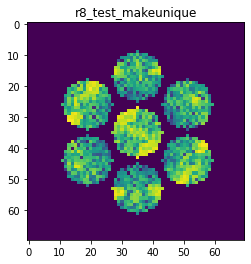

X_sim.max(): 0.8351399010678943
nlogf_X_sim.max(): 6.728795944858953
>>>replaced the 35. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 377ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0030 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 278ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 265ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000


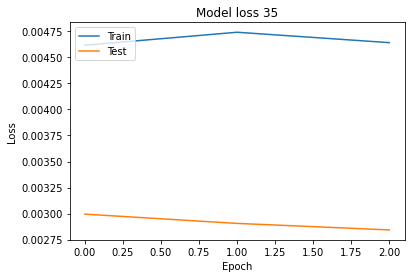

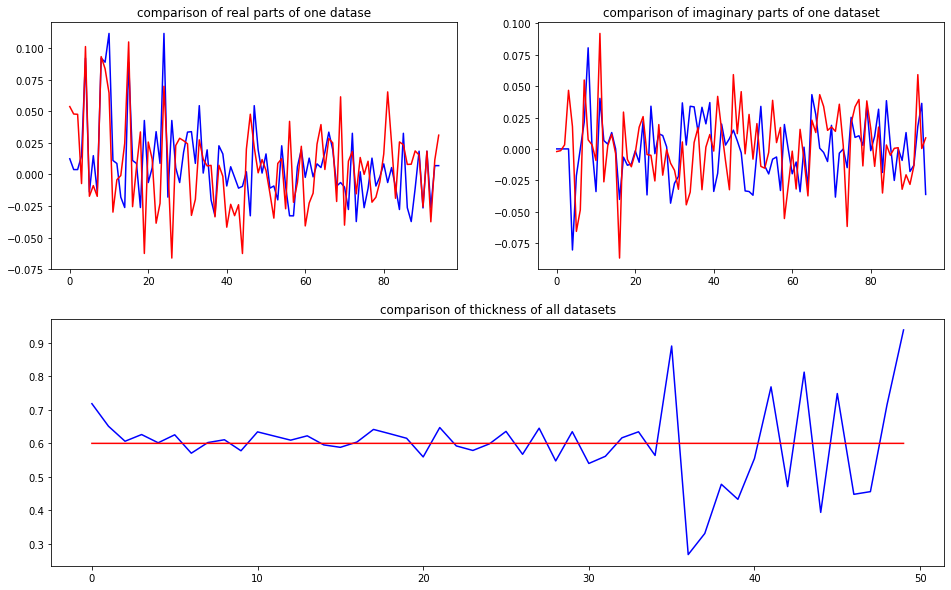

predicted thickness: 0.5991811


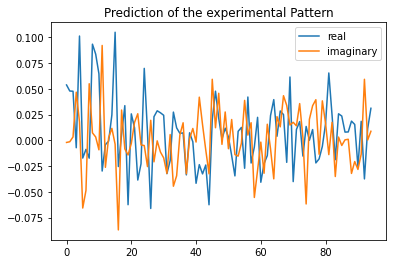

Applied shift of unit cell origin (fractional coordinates): -0.005708993234072501 -0.2761923217122533 0.0077514352459824715
Ug[ 0 ]: 0.0538 0.0  =>  0.0538 0.0
Ug[ 1 ]: 0.04784 -0.0487  =>  0.04784 0.0
Ug[ 2 ]: 0.04784 0.0487  =>  0.04784 0.0
Ug[ 3 ]: 0.04828 1.73537  =>  0.04828 -0.0
Ug[ 4 ]: 0.09781 0.05471  =>  0.09781 -1.63195
Ug[ 5 ]: 0.06262 -1.84727  =>  0.06262 2.65184
Ug[ 6 ]: 0.04828 -1.73537  =>  0.04828 0.0
Ug[ 7 ]: 0.06262 1.84727  =>  0.06262 -2.65184
Ug[ 8 ]: 0.09781 -0.05471  =>  0.09781 1.63195
Ug[ 9 ]: 0.09471 0.03587  =>  0.09471 0.0
Ug[ 10 ]: 0.06738 -0.031  =>  0.06738 -0.01816
Ug[ 11 ]: 0.09352 1.86581  =>  0.09352 1.78123
Ug[ 12 ]: 0.0278 -1.54571  =>  0.0278 0.15379
Ug[ 13 ]: 0.01447 1.32757  =>  0.01447 3.07577
Ug[ 14 ]: 0.0308 0.32943  =>  0.0308 1.98023
Ug[ 15 ]: 0.09471 -0.03587  =>  0.09471 -0.0
Ug[ 16 ]: 0.09352 -1.86581  =>  0.09352 -1.78123
Ug[ 17 ]: 0.0278 1.54571  =>  0.0278 -0.15379
Ug[ 18 ]: 0.0308 -0.32943  =>  0.0308 -1.98023
Ug[ 19 ]: 0.06626 -2.8

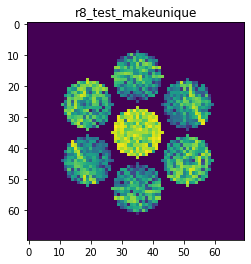

X_sim.max(): 0.9522377710059311
nlogf_X_sim.max(): 6.859864369917835
>>>replaced the 36. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 345ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 268ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0024 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 268ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000


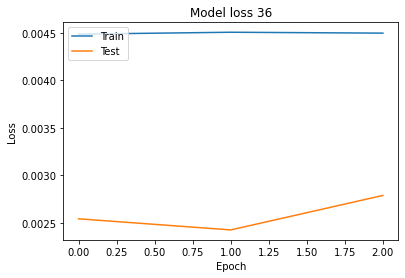

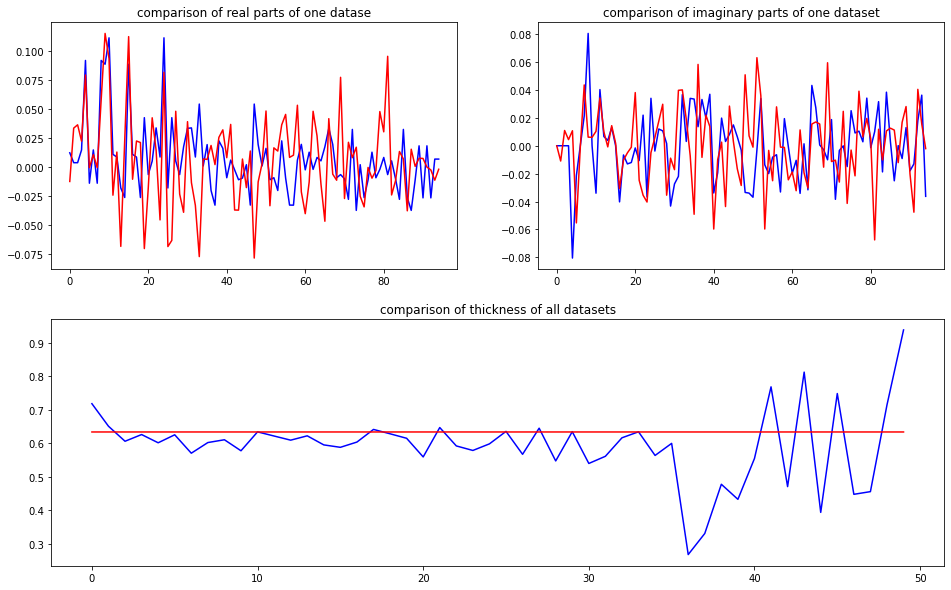

predicted thickness: 0.6332249


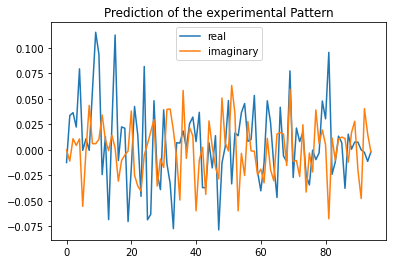

Applied shift of unit cell origin (fractional coordinates): -0.002987692626204446 -0.02567547143652454 0.04812990039138141
Ug[ 0 ]: 0.01235 3.14159  =>  0.01235 3.14159
Ug[ 1 ]: 0.03683 -0.30241  =>  0.03683 0.0
Ug[ 2 ]: 0.03683 0.30241  =>  0.03683 -0.0
Ug[ 3 ]: 0.01684 0.16132  =>  0.01684 0.0
Ug[ 4 ]: 0.06902 0.03449  =>  0.06902 0.17557
Ug[ 5 ]: 0.04941 -1.57687  =>  0.04941 -2.0406
Ug[ 6 ]: 0.01684 -0.16132  =>  0.01684 0.0
Ug[ 7 ]: 0.04941 1.57687  =>  0.04941 2.0406
Ug[ 8 ]: 0.06902 -0.03449  =>  0.06902 -0.17557
Ug[ 9 ]: 0.11463 0.01877  =>  0.11463 -0.0
Ug[ 10 ]: 0.08846 0.08713  =>  0.08846 0.37077
Ug[ 11 ]: 0.03672 2.05946  =>  0.03672 1.73828
Ug[ 12 ]: 0.02049 0.51958  =>  0.02049 0.66213
Ug[ 13 ]: 0.06822 -3.09238  =>  0.06822 -2.64742
Ug[ 14 ]: 0.02427 0.4136  =>  0.02427 0.25374
Ug[ 15 ]: 0.11463 -0.01877  =>  0.11463 0.0
Ug[ 16 ]: 0.03672 -2.05946  =>  0.03672 -1.73828
Ug[ 17 ]: 0.02049 -0.51958  =>  0.02049 -0.66213
Ug[ 18 ]: 0.02427 -0.4136  =>  0.02427 -0.25374
Ug[ 1

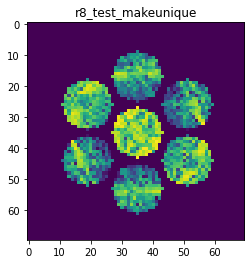

X_sim.max(): 0.9116047350498686
nlogf_X_sim.max(): 6.816302857006982
>>>replaced the 37. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 385ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 293ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 274ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 1.0000


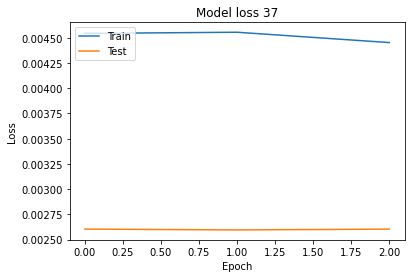

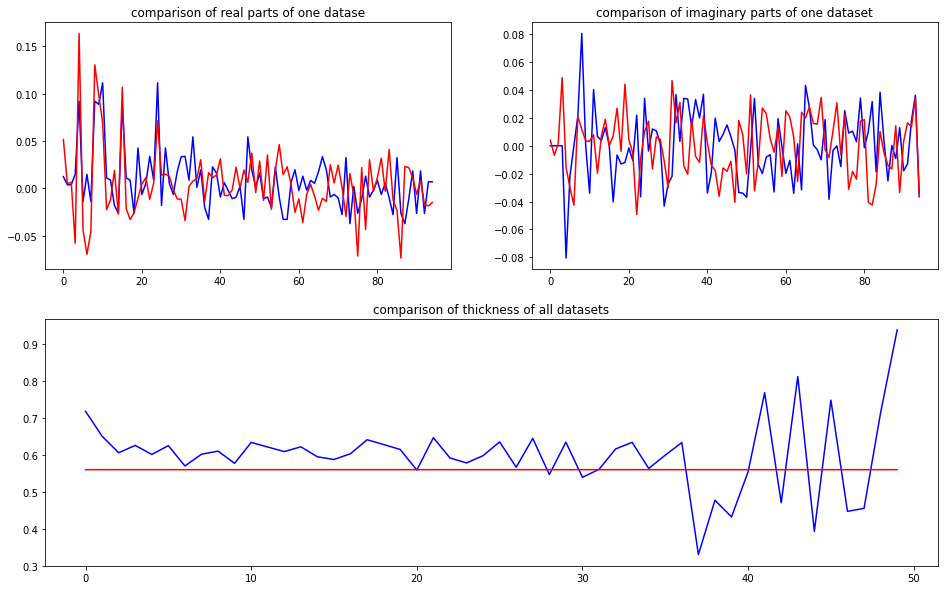

predicted thickness: 0.5597731


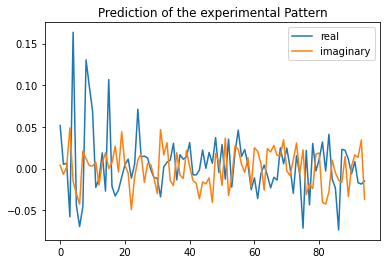

Applied shift of unit cell origin (fractional coordinates): -0.0027572504410412306 -0.4010418618416162 0.10091574918879091
Ug[ 0 ]: 0.05155 0.0  =>  0.05155 0.0
Ug[ 1 ]: 0.00719 -0.63407  =>  0.00719 0.0
Ug[ 2 ]: 0.00719 0.63407  =>  0.00719 -0.0
Ug[ 3 ]: 0.07847 2.51982  =>  0.07847 0.0
Ug[ 4 ]: 0.14754 -0.0927  =>  0.14754 -1.97845
Ug[ 5 ]: 0.05156 -2.62371  =>  0.05156 0.50559
Ug[ 6 ]: 0.07847 -2.51982  =>  0.07847 -0.0
Ug[ 7 ]: 0.05156 2.62371  =>  0.05156 -0.50559
Ug[ 8 ]: 0.14754 0.0927  =>  0.14754 1.97845
Ug[ 9 ]: 0.1027 0.01732  =>  0.1027 0.0
Ug[ 10 ]: 0.07027 -0.05022  =>  0.07027 0.56653
Ug[ 11 ]: 0.02188 3.12243  =>  0.02188 2.47103
Ug[ 12 ]: 0.03247 -2.33842  =>  0.03247 0.16407
Ug[ 13 ]: 0.01722 -0.30354  =>  0.01722 2.83303
Ug[ 14 ]: 0.02882 2.73236  =>  0.02882 -1.6824
Ug[ 15 ]: 0.1027 -0.01732  =>  0.1027 0.0
Ug[ 16 ]: 0.02188 -3.12243  =>  0.02188 -2.47103
Ug[ 17 ]: 0.03247 2.33842  =>  0.03247 -0.16407
Ug[ 18 ]: 0.02882 -2.73236  =>  0.02882 1.6824
Ug[ 19 ]: 0.03048

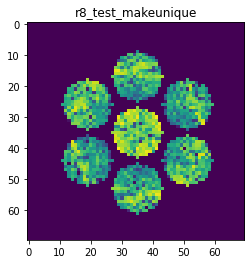

X_sim.max(): 0.9193734880124869
nlogf_X_sim.max(): 6.824779552892461
>>>replaced the 38. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 353ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 254ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 260ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 1.0000


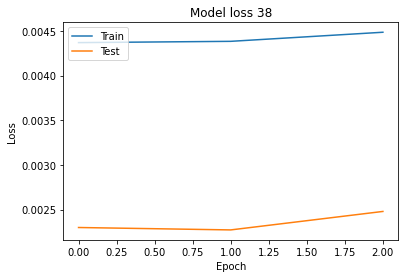

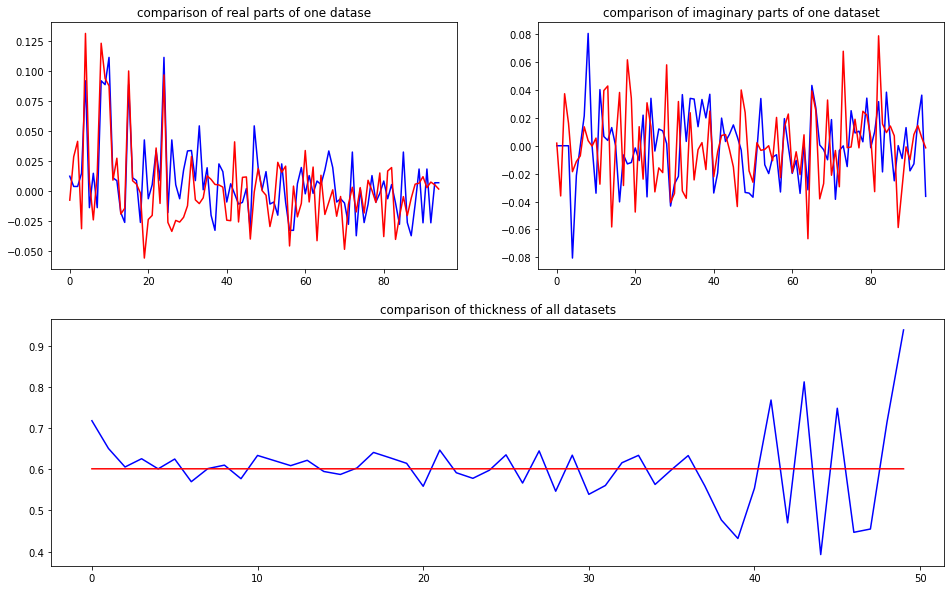

predicted thickness: 0.6010891


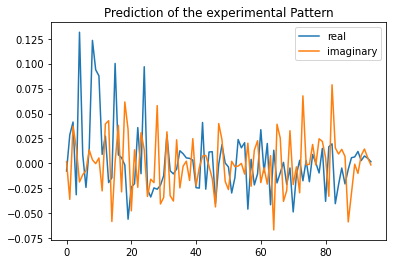

Applied shift of unit cell origin (fractional coordinates): 0.0012629787192101542 -0.4368443245255254 0.12878725309817401
Ug[ 0 ]: 0.00761 3.14159  =>  0.00761 3.14159
Ug[ 1 ]: 0.0506 -0.80919  =>  0.0506 -0.0
Ug[ 2 ]: 0.0506 0.80919  =>  0.0506 0.0
Ug[ 3 ]: 0.03012 2.74477  =>  0.03012 0.0
Ug[ 4 ]: 0.12704 -0.08798  =>  0.12704 -2.02356
Ug[ 5 ]: 0.01704 -0.81549  =>  0.01704 1.91373
Ug[ 6 ]: 0.03012 -2.74477  =>  0.03012 -0.0
Ug[ 7 ]: 0.01704 0.81549  =>  0.01704 -1.91373
Ug[ 8 ]: 0.12704 0.08798  =>  0.12704 2.02356
Ug[ 9 ]: 0.09656 -0.00794  =>  0.09656 0.0
Ug[ 10 ]: 0.09198 -0.04389  =>  0.09198 0.77324
Ug[ 11 ]: 0.03401 -1.30921  =>  0.03401 -2.11047
Ug[ 12 ]: 0.0378 1.11966  =>  0.0378 -2.41082
Ug[ 13 ]: 0.04424 2.11097  =>  0.04424 -0.61031
Ug[ 14 ]: 0.06046 -1.70701  =>  0.06046 0.2365
Ug[ 15 ]: 0.09656 0.00794  =>  0.09656 0.0
Ug[ 16 ]: 0.03401 1.30921  =>  0.03401 2.11047
Ug[ 17 ]: 0.0378 -1.11966  =>  0.0378 2.41082
Ug[ 18 ]: 0.06046 1.70701  =>  0.06046 -0.2365
Ug[ 19 ]: 0.

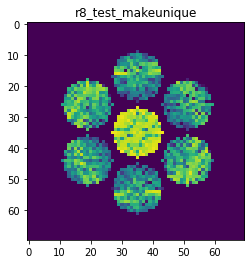

X_sim.max(): 0.9556570260042758
nlogf_X_sim.max(): 6.863444942687334
>>>replaced the 39. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 378ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0024 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 277ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0024 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 266ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000


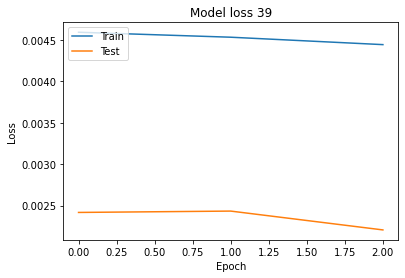

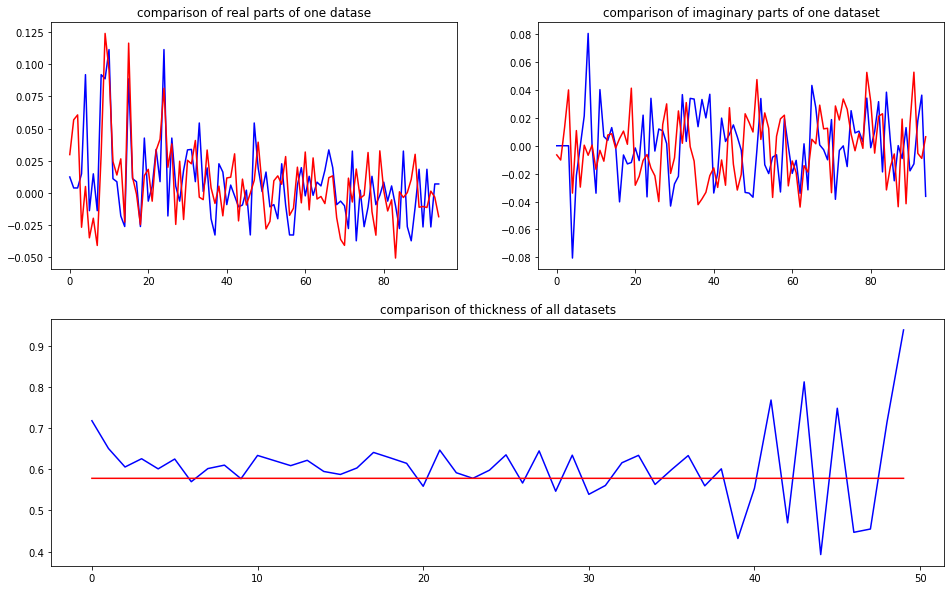

predicted thickness: 0.5779936


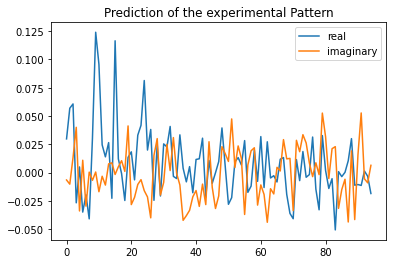

Applied shift of unit cell origin (fractional coordinates): -0.0014351702356333819 -0.3436484039249114 0.031305496241463164
Ug[ 0 ]: 0.02976 0.0  =>  0.02976 0.0
Ug[ 1 ]: 0.0599 -0.1967  =>  0.0599 0.0
Ug[ 2 ]: 0.0599 0.1967  =>  0.0599 -0.0
Ug[ 3 ]: 0.04187 2.15921  =>  0.04187 0.0
Ug[ 4 ]: 0.02218 -0.65707  =>  0.02218 -2.61958
Ug[ 5 ]: 0.03831 3.00404  =>  0.03831 0.64813
Ug[ 6 ]: 0.04187 -2.15921  =>  0.04187 -0.0
Ug[ 7 ]: 0.03831 -3.00404  =>  0.03831 -0.64813
Ug[ 8 ]: 0.02218 0.65707  =>  0.02218 2.61958
Ug[ 9 ]: 0.12016 0.00902  =>  0.12016 0.0
Ug[ 10 ]: 0.08849 -0.0054  =>  0.08849 0.18228
Ug[ 11 ]: 0.01875 -0.22555  =>  0.01875 -0.43126
Ug[ 12 ]: 0.01257 -1.03062  =>  0.01257 1.11956
Ug[ 13 ]: 0.02741 0.56261  =>  0.02741 2.9095
Ug[ 14 ]: 0.02402 2.98422  =>  0.02402 -1.34547
Ug[ 15 ]: 0.12016 -0.00902  =>  0.12016 -0.0
Ug[ 16 ]: 0.01875 0.22555  =>  0.01875 0.43126
Ug[ 17 ]: 0.01257 1.03062  =>  0.01257 -1.11956
Ug[ 18 ]: 0.02402 -2.98422  =>  0.02402 1.34547
Ug[ 19 ]: 0.0481

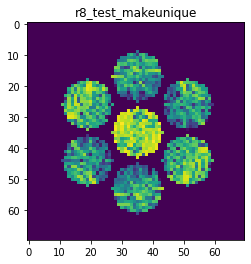

X_sim.max(): 0.9562641166752391
nlogf_X_sim.max(): 6.864079337363045
>>>replaced the 40. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 361ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 291ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 303ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000


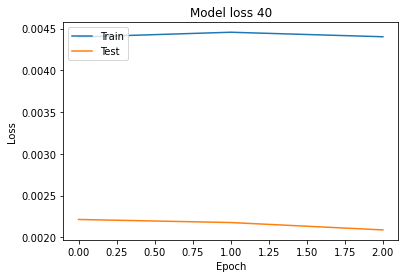

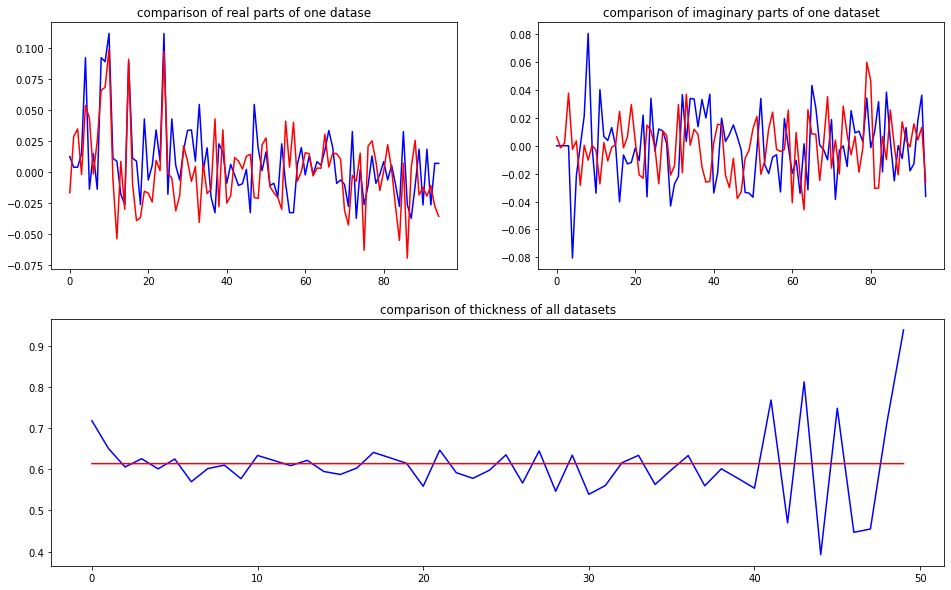

predicted thickness: 0.61361766


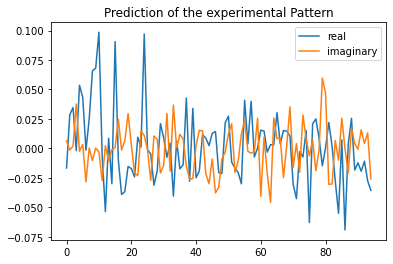

Applied shift of unit cell origin (fractional coordinates): 0.0003164843941418358 -0.25868531680241214 0.008893293089917825
Ug[ 0 ]: 0.01671 3.14159  =>  0.01671 3.14159
Ug[ 1 ]: 0.03163 -0.05588  =>  0.03163 0.0
Ug[ 2 ]: 0.03163 0.05588  =>  0.03163 0.0
Ug[ 3 ]: 0.03309 1.62537  =>  0.03309 0.0
Ug[ 4 ]: 0.05975 0.06561  =>  0.05975 -1.50388
Ug[ 5 ]: 0.03414 0.04564  =>  0.03414 -1.63561
Ug[ 6 ]: 0.03309 -1.62537  =>  0.03309 -0.0
Ug[ 7 ]: 0.03414 -0.04564  =>  0.03414 1.63561
Ug[ 8 ]: 0.05975 -0.06561  =>  0.05975 1.50388
Ug[ 9 ]: 0.07919 -0.00199  =>  0.07919 0.0
Ug[ 10 ]: 0.0978 -0.07095  =>  0.0978 -0.01308
Ug[ 11 ]: 0.02722 -1.87377  =>  0.02722 -1.92766
Ug[ 12 ]: 0.0466 3.10243  =>  0.0466 -1.5534
Ug[ 13 ]: 0.00628 -0.93902  =>  0.00628 0.74421
Ug[ 14 ]: 0.03359 -3.03174  =>  0.03359 -1.46026
Ug[ 15 ]: 0.07919 0.00199  =>  0.07919 0.0
Ug[ 16 ]: 0.02722 1.87377  =>  0.02722 1.92766
Ug[ 17 ]: 0.0466 -3.10243  =>  0.0466 1.5534
Ug[ 18 ]: 0.03359 3.03174  =>  0.03359 1.46026
Ug[ 19 ]

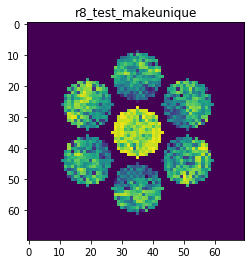

X_sim.max(): 0.9519126597302896
nlogf_X_sim.max(): 6.859523251742111
>>>replaced the 41. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 394ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 298ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 296ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000


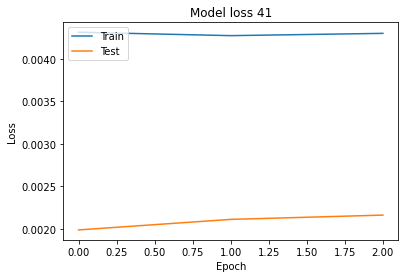

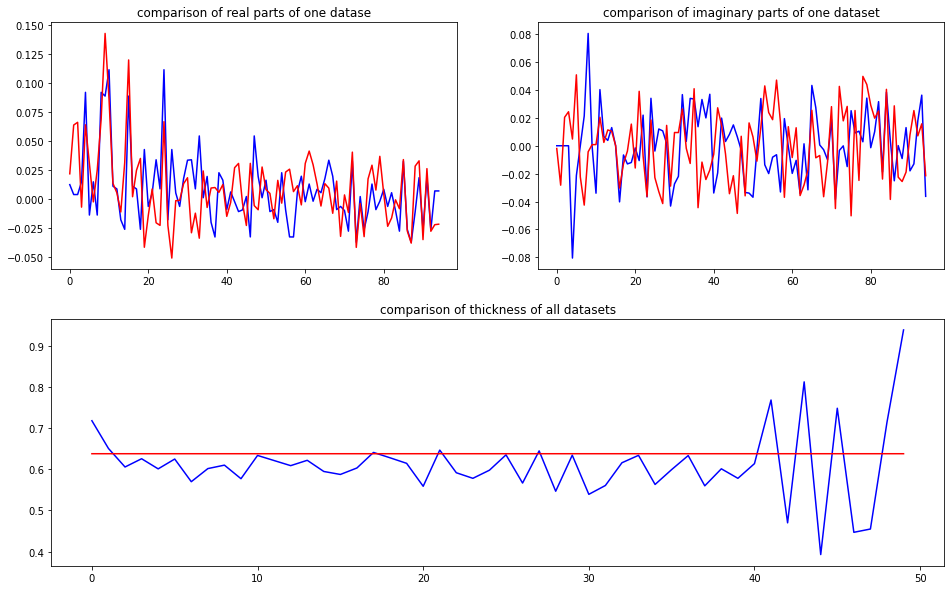

predicted thickness: 0.63768774


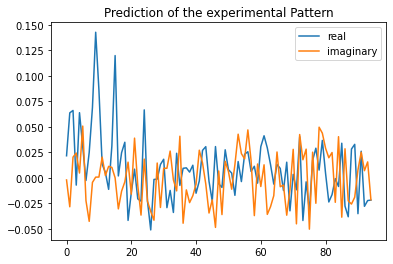

Applied shift of unit cell origin (fractional coordinates): -0.00032209889925806416 -0.28212313457455007 0.05713624697721046
Ug[ 0 ]: 0.02171 0.0  =>  0.02171 0.0
Ug[ 1 ]: 0.06927 -0.359  =>  0.06927 -0.0
Ug[ 2 ]: 0.06927 0.359  =>  0.06927 0.0
Ug[ 3 ]: 0.02382 1.77263  =>  0.02382 -0.0
Ug[ 4 ]: 0.06651 0.06928  =>  0.06651 -1.34435
Ug[ 5 ]: 0.05433 1.03368  =>  0.05433 -1.09795
Ug[ 6 ]: 0.02382 -1.77263  =>  0.02382 0.0
Ug[ 7 ]: 0.05433 -1.03368  =>  0.05433 1.09795
Ug[ 8 ]: 0.06651 -0.06928  =>  0.06651 1.34435
Ug[ 9 ]: 0.13096 0.00202  =>  0.13096 0.0
Ug[ 10 ]: 0.07683 -0.11529  =>  0.07683 0.24168
Ug[ 11 ]: 0.02652 1.27609  =>  0.02652 0.91507
Ug[ 12 ]: 0.01689 0.47267  =>  0.01689 2.24327
Ug[ 13 ]: 0.02416 2.35435  =>  0.02416 -1.79923
Ug[ 14 ]: 0.03391 0.211  =>  0.03391 1.62261
Ug[ 15 ]: 0.13096 -0.00202  =>  0.13096 0.0
Ug[ 16 ]: 0.02652 -1.27609  =>  0.02652 -0.91507
Ug[ 17 ]: 0.01689 -0.47267  =>  0.01689 -2.24327
Ug[ 18 ]: 0.03391 -0.211  =>  0.03391 -1.62261
Ug[ 19 ]: 0.052

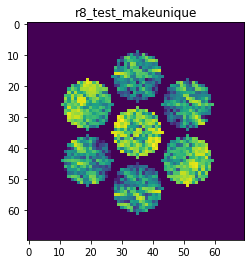

X_sim.max(): 0.9471538515816915
nlogf_X_sim.max(): 6.854516779785298
>>>replaced the 42. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 382ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 265ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 277ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000


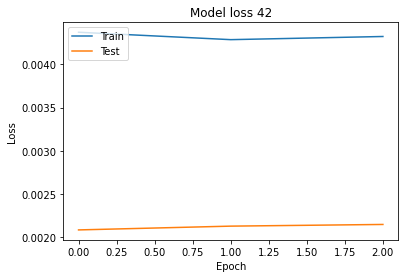

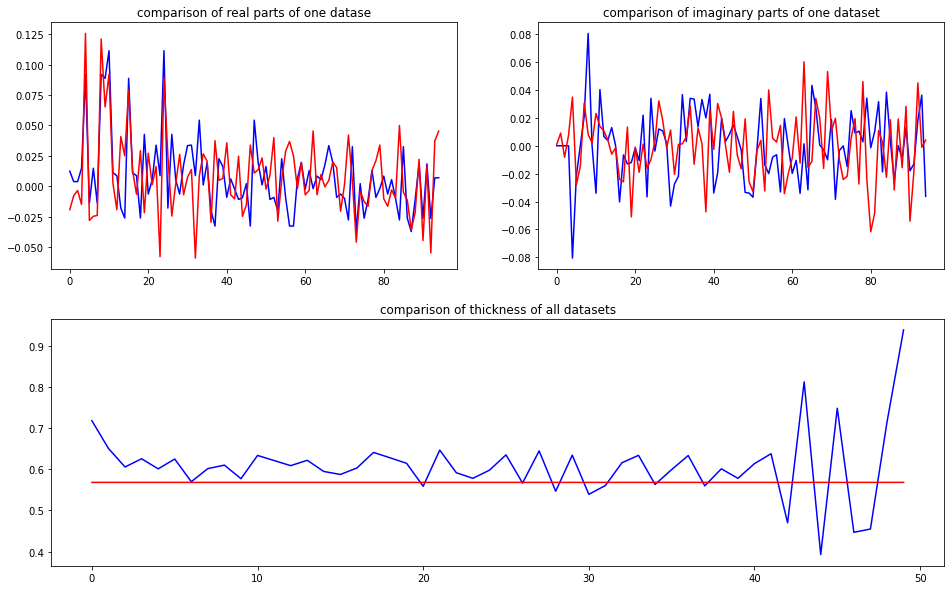

predicted thickness: 0.5681384


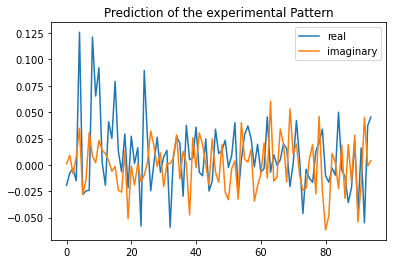

Applied shift of unit cell origin (fractional coordinates): -0.0037149480176325886 -0.4188532700356764 -0.3413799496384833
Ug[ 0 ]: 0.01928 3.14159  =>  0.01928 3.14159
Ug[ 1 ]: 0.01033 2.14495  =>  0.01033 -0.0
Ug[ 2 ]: 0.01033 -2.14495  =>  0.01033 0.0
Ug[ 3 ]: 0.02274 2.63173  =>  0.02274 0.0
Ug[ 4 ]: 0.12459 0.10763  =>  0.12459 1.61413
Ug[ 5 ]: 0.03917 -2.29839  =>  0.03917 -2.78516
Ug[ 6 ]: 0.02274 -2.63173  =>  0.02274 0.0
Ug[ 7 ]: 0.03917 2.29839  =>  0.03917 2.78516
Ug[ 8 ]: 0.12459 -0.10763  =>  0.12459 -1.61413
Ug[ 9 ]: 0.07235 0.02334  =>  0.07235 0.0
Ug[ 10 ]: 0.09248 0.17945  =>  0.09248 -1.98884
Ug[ 11 ]: 0.02041 1.18472  =>  0.02041 -2.97686
Ug[ 12 ]: 0.02242 2.18623  =>  0.02242 -1.48857
Ug[ 13 ]: 0.03299 0.02408  =>  0.03299 0.48751
Ug[ 14 ]: 0.02885 -0.34286  =>  0.02885 -1.8727
Ug[ 15 ]: 0.07235 -0.02334  =>  0.07235 0.0
Ug[ 16 ]: 0.02041 -1.18472  =>  0.02041 2.97686
Ug[ 17 ]: 0.02242 -2.18623  =>  0.02242 1.48857
Ug[ 18 ]: 0.02885 0.34286  =>  0.02885 1.8727
Ug[ 1

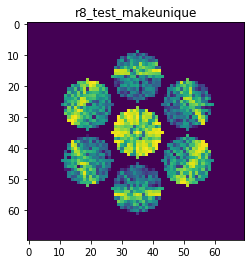

X_sim.max(): 0.9167360800522256
nlogf_X_sim.max(): 6.821909854789539
>>>replaced the 43. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 358ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 263ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 259ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000


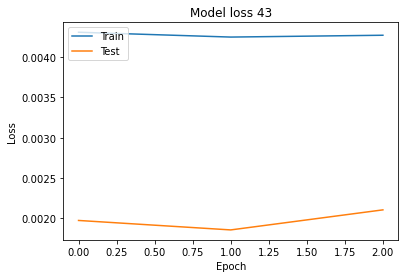

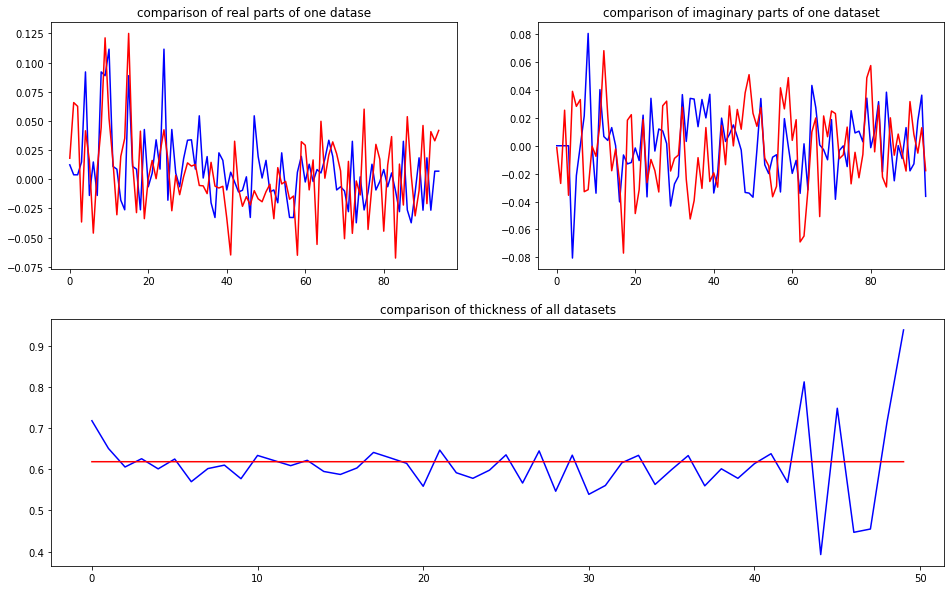

predicted thickness: 0.61830753


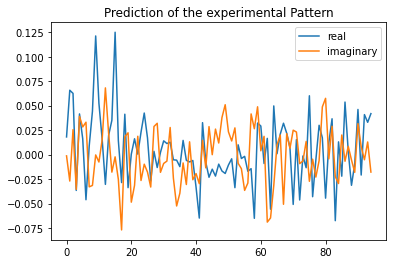

Applied shift of unit cell origin (fractional coordinates): -0.001289106065315074 0.3900168010706748 0.06199259346895937
Ug[ 0 ]: 0.01803 0.0  =>  0.01803 0.0
Ug[ 1 ]: 0.06918 -0.38951  =>  0.06918 0.0
Ug[ 2 ]: 0.06918 0.38951  =>  0.06918 0.0
Ug[ 3 ]: 0.05379 -2.45055  =>  0.05379 -0.0
Ug[ 4 ]: 0.05548 0.68842  =>  0.05548 -2.75471
Ug[ 5 ]: 0.03303 1.18469  =>  0.03303 -3.03746
Ug[ 6 ]: 0.05379 2.45055  =>  0.05379 0.0
Ug[ 7 ]: 0.03303 -1.18469  =>  0.03303 3.03746
Ug[ 8 ]: 0.05548 -0.68842  =>  0.05548 2.75471
Ug[ 9 ]: 0.12266 0.0081  =>  0.12266 0.0
Ug[ 10 ]: 0.04733 0.02323  =>  0.04733 0.40464
Ug[ 11 ]: 0.02519 0.93687  =>  0.02519 0.53926
Ug[ 12 ]: 0.07839 1.95907  =>  0.07839 -0.49958
Ug[ 13 ]: 0.02693 0.82041  =>  0.02693 -1.24873
Ug[ 14 ]: 0.04217 -0.44358  =>  0.04217 2.99145
Ug[ 15 ]: 0.12266 -0.0081  =>  0.12266 0.0
Ug[ 16 ]: 0.02519 -0.93687  =>  0.02519 -0.53926
Ug[ 17 ]: 0.07839 -1.95907  =>  0.07839 0.49958
Ug[ 18 ]: 0.04217 0.44358  =>  0.04217 -2.99145
Ug[ 19 ]: 0.041

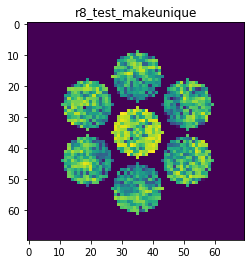

X_sim.max(): 0.8941549305051686
nlogf_X_sim.max(): 6.796996810003304
>>>replaced the 44. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 347ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 263ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 254ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000


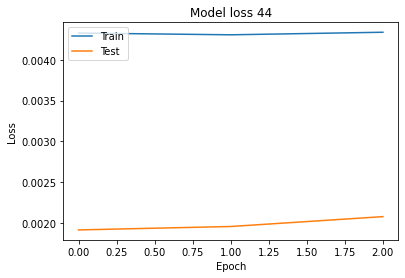

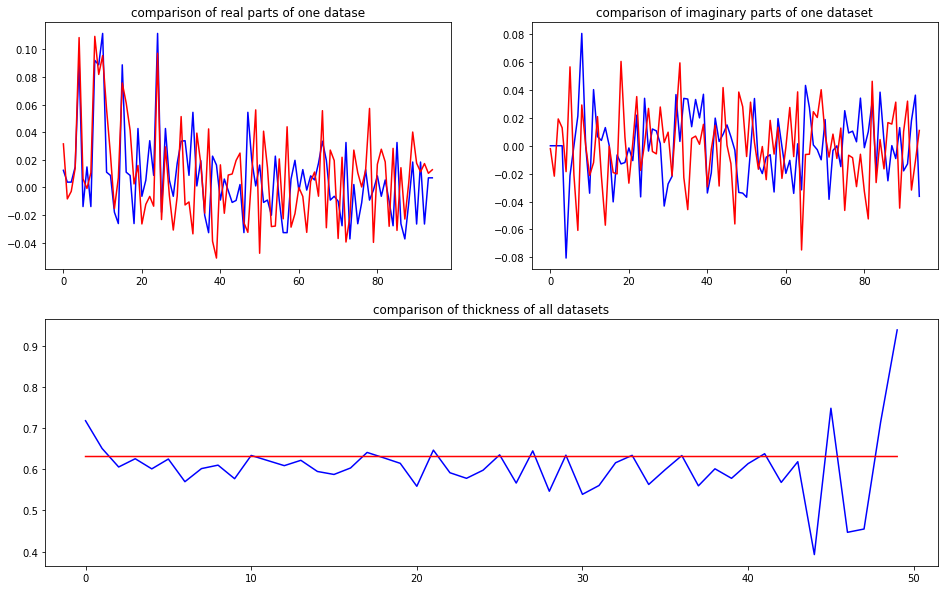

predicted thickness: 0.6309212


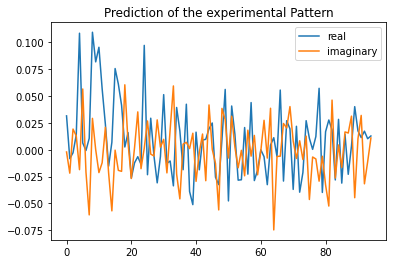

Applied shift of unit cell origin (fractional coordinates): -0.0004872898309849393 -0.19116918790687534 0.29234793130712294
Ug[ 0 ]: 0.03147 0.0  =>  0.03147 0.0
Ug[ 1 ]: 0.02128 -1.83688  =>  0.02128 -0.0
Ug[ 2 ]: 0.02128 1.83688  =>  0.02128 0.0
Ug[ 3 ]: 0.01813 1.20115  =>  0.01813 0.0
Ug[ 4 ]: 0.11101 -0.21671  =>  0.11101 0.41902
Ug[ 5 ]: 0.0592 1.43081  =>  0.0592 -1.60722
Ug[ 6 ]: 0.01813 -1.20115  =>  0.01813 -0.0
Ug[ 7 ]: 0.0592 -1.43081  =>  0.0592 1.60722
Ug[ 8 ]: 0.11101 0.21671  =>  0.11101 -0.41902
Ug[ 9 ]: 0.07844 0.00306  =>  0.07844 -0.0
Ug[ 10 ]: 0.09656 -0.11812  =>  0.09656 1.71569
Ug[ 11 ]: 0.05883 0.06062  =>  0.05883 -1.77932
Ug[ 12 ]: 0.0383 0.56606  =>  0.0383 1.76415
Ug[ 13 ]: 0.03106 -2.24205  =>  0.03106 0.79291
Ug[ 14 ]: 0.05887 -1.49245  =>  0.05887 -2.13124
Ug[ 15 ]: 0.07844 -0.00306  =>  0.07844 0.0
Ug[ 16 ]: 0.05883 -0.06062  =>  0.05883 1.77932
Ug[ 17 ]: 0.0383 -0.56606  =>  0.0383 -1.76415
Ug[ 18 ]: 0.05887 1.49245  =>  0.05887 2.13124
Ug[ 19 ]: 0.023

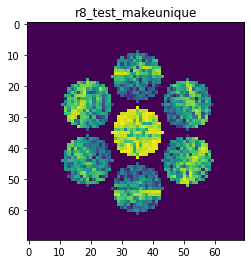

X_sim.max(): 0.9207879386811234
nlogf_X_sim.max(): 6.826315195671756
>>>replaced the 45. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 401ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 304ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 284ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000


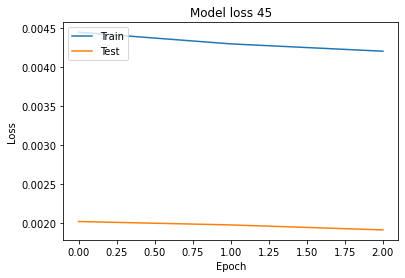

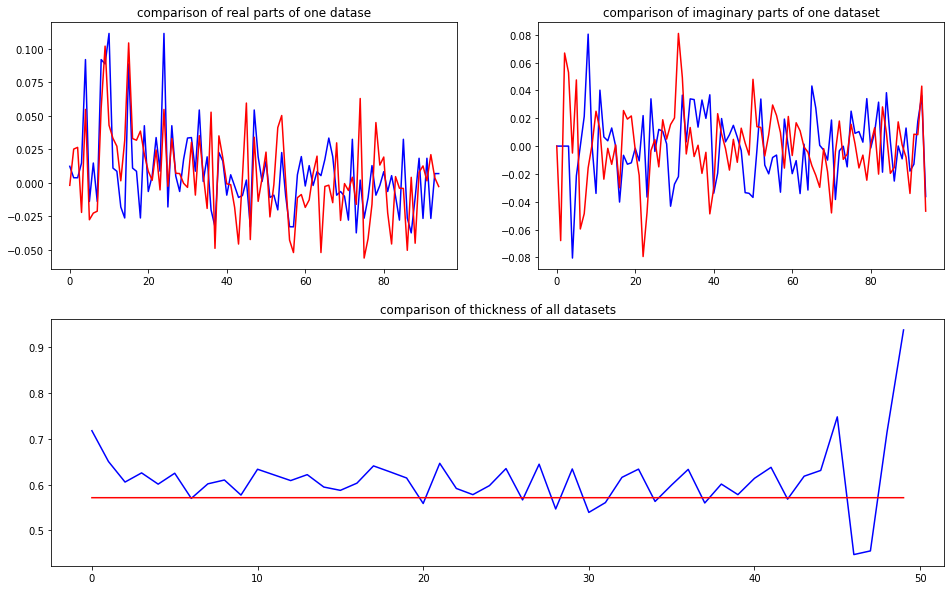

predicted thickness: 0.5713134


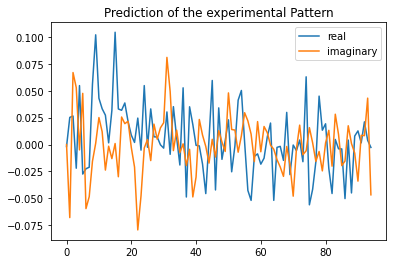

Applied shift of unit cell origin (fractional coordinates): -0.00015281673618700657 -0.3101212596806058 0.19186790943937637
Ug[ 0 ]: 0.00183 3.14159  =>  0.00183 3.14159
Ug[ 1 ]: 0.07222 -1.20554  =>  0.07222 -0.0
Ug[ 2 ]: 0.07222 1.20554  =>  0.07222 0.0
Ug[ 3 ]: 0.06055 1.94855  =>  0.06055 0.0
Ug[ 4 ]: 0.05552 0.09608  =>  0.05552 -0.64693
Ug[ 5 ]: 0.05389 2.03962  =>  0.05389 -1.11447
Ug[ 6 ]: 0.06055 -1.94855  =>  0.06055 -0.0
Ug[ 7 ]: 0.05389 -2.03962  =>  0.05389 1.11447
Ug[ 8 ]: 0.05552 -0.09608  =>  0.05552 0.64693
Ug[ 9 ]: 0.10308 0.00096  =>  0.10308 -0.0
Ug[ 10 ]: 0.0509 0.28193  =>  0.0509 1.48651
Ug[ 11 ]: 0.0392 0.56333  =>  0.0392 -0.64317
Ug[ 12 ]: 0.0385 -0.69566  =>  0.0385 1.25193
Ug[ 13 ]: 0.00317 -1.72813  =>  0.00317 1.425
Ug[ 14 ]: 0.03872 -0.43328  =>  0.03872 0.30877
Ug[ 15 ]: 0.10308 -0.00096  =>  0.10308 0.0
Ug[ 16 ]: 0.0392 -0.56333  =>  0.0392 0.64317
Ug[ 17 ]: 0.0385 0.69566  =>  0.0385 -1.25193
Ug[ 18 ]: 0.03872 0.43328  =>  0.03872 -0.30877
Ug[ 19 ]: 0.

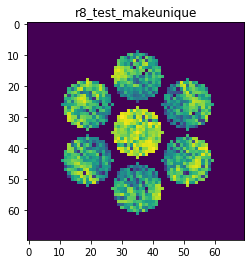

X_sim.max(): 0.8031115581999506
nlogf_X_sim.max(): 6.689738013533561
>>>replaced the 46. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 366ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 268ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 261ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000


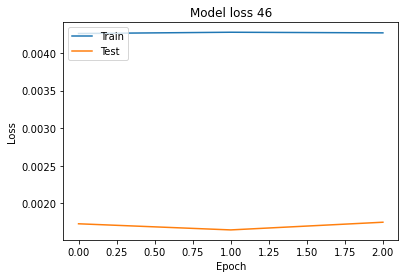

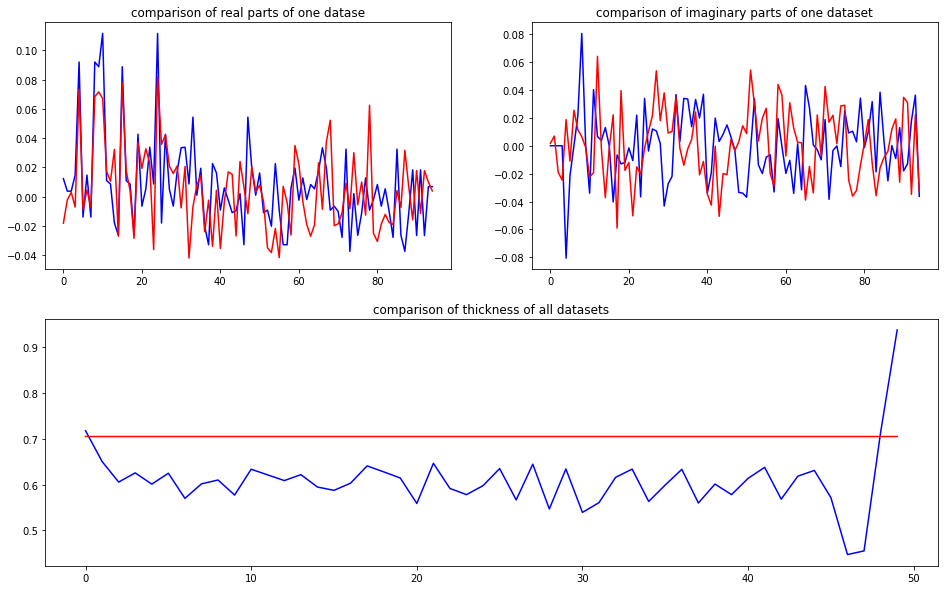

predicted thickness: 0.70501757


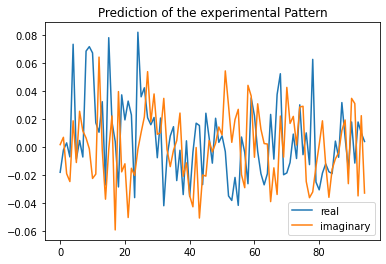

Applied shift of unit cell origin (fractional coordinates): -0.00039121210344697066 0.25733318784151377 -0.24471187241586856
Ug[ 0 ]: 0.01801 3.14159  =>  0.01801 3.14159
Ug[ 1 ]: 0.01297 1.53757  =>  0.01297 -0.0
Ug[ 2 ]: 0.01297 -1.53757  =>  0.01297 0.0
Ug[ 3 ]: 0.02507 -1.61687  =>  0.02507 0.0
Ug[ 4 ]: 0.07137 0.08639  =>  0.07137 0.16569
Ug[ 5 ]: 0.01373 -2.17834  =>  0.01373 0.9761
Ug[ 6 ]: 0.02507 1.61687  =>  0.02507 -0.0
Ug[ 7 ]: 0.01373 2.17834  =>  0.01373 -0.9761
Ug[ 8 ]: 0.07137 -0.08639  =>  0.07137 -0.16569
Ug[ 9 ]: 0.07505 0.00246  =>  0.07505 -0.0
Ug[ 10 ]: 0.0755 -0.13832  =>  0.0755 -1.67835
Ug[ 11 ]: 0.02725 -0.86533  =>  0.02725 0.66978
Ug[ 12 ]: 0.06206 1.45006  =>  0.06206 -0.16927
Ug[ 13 ]: 0.03469 -0.18113  =>  0.03469 2.94515
Ug[ 14 ]: 0.04726 -2.19458  =>  0.04726 -2.27635
Ug[ 15 ]: 0.07505 -0.00246  =>  0.07505 0.0
Ug[ 16 ]: 0.02725 0.86533  =>  0.02725 -0.66978
Ug[ 17 ]: 0.06206 -1.45006  =>  0.06206 0.16927
Ug[ 18 ]: 0.04726 2.19458  =>  0.04726 2.27635
U

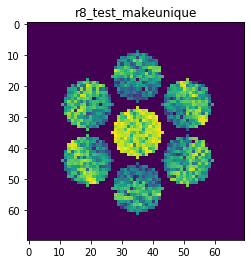

X_sim.max(): 0.918462366660563
nlogf_X_sim.max(): 6.823789115159561
>>>replaced the 47. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 372ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 274ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 273ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000


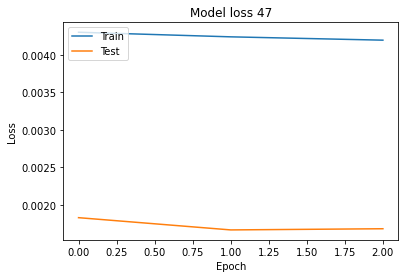

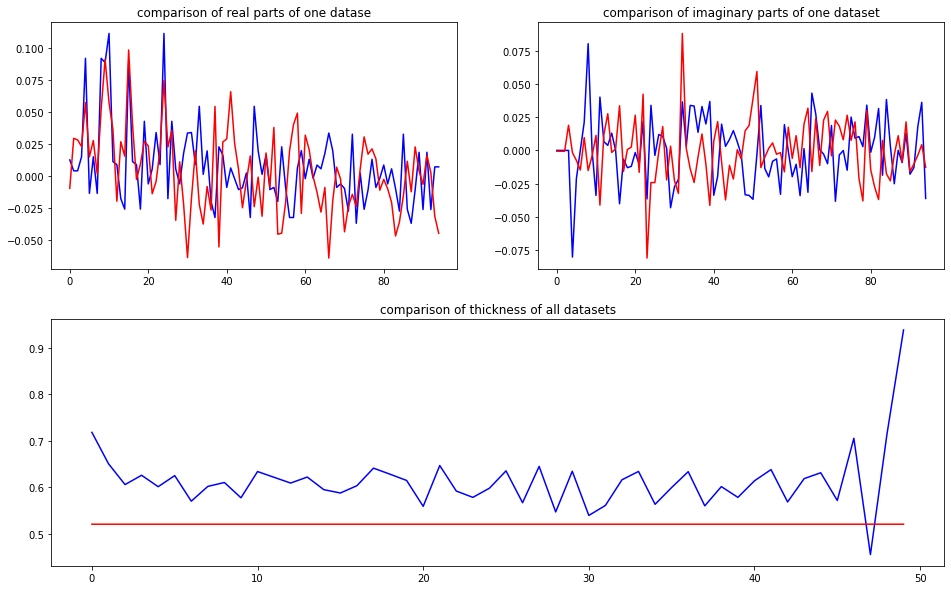

predicted thickness: 0.52029663


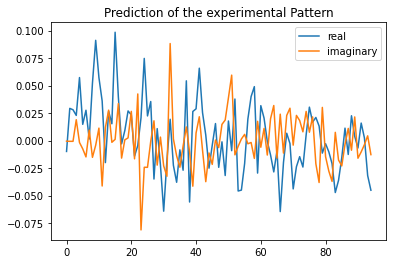

Applied shift of unit cell origin (fractional coordinates): 0.004427811363434999 -0.09407148009778157 8.229886727319837e-06
Ug[ 0 ]: 0.00987 3.14159  =>  0.00987 3.14159
Ug[ 1 ]: 0.02864 -5e-05  =>  0.02864 0.0
Ug[ 2 ]: 0.02864 5e-05  =>  0.02864 -0.0
Ug[ 3 ]: 0.03036 0.59107  =>  0.03036 0.0
Ug[ 4 ]: 0.05498 0.12287  =>  0.05498 -0.46815
Ug[ 5 ]: 0.01178 -0.8143  =>  0.01178 -1.40542
Ug[ 6 ]: 0.03036 -0.59107  =>  0.03036 0.0
Ug[ 7 ]: 0.01178 0.8143  =>  0.01178 1.40542
Ug[ 8 ]: 0.05498 -0.12287  =>  0.05498 0.46815
Ug[ 9 ]: 0.09442 -0.02782  =>  0.09442 0.0
Ug[ 10 ]: 0.06815 0.26532  =>  0.06815 0.29319
Ug[ 11 ]: 0.05319 -0.7822  =>  0.05319 -0.75443
Ug[ 12 ]: 0.01804 2.26294  =>  0.01804 2.88183
Ug[ 13 ]: 0.0357 0.81515  =>  0.0357 1.43409
Ug[ 14 ]: 0.0123 -0.09137  =>  0.0123 0.52746
Ug[ 15 ]: 0.09442 0.02782  =>  0.09442 0.0
Ug[ 16 ]: 0.05319 0.7822  =>  0.05319 0.75443
Ug[ 17 ]: 0.01804 -2.26294  =>  0.01804 -2.88183
Ug[ 18 ]: 0.0123 0.09137  =>  0.0123 -0.52746
Ug[ 19 ]: 0.03124

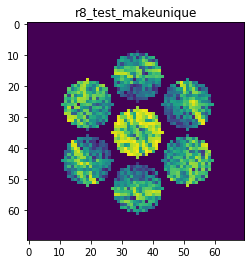

X_sim.max(): 0.9520385843847987
nlogf_X_sim.max(): 6.859655390121916
>>>replaced the 48. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 361ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 266ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 254ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000


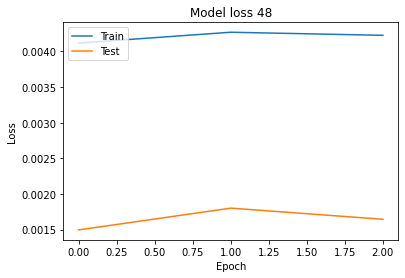

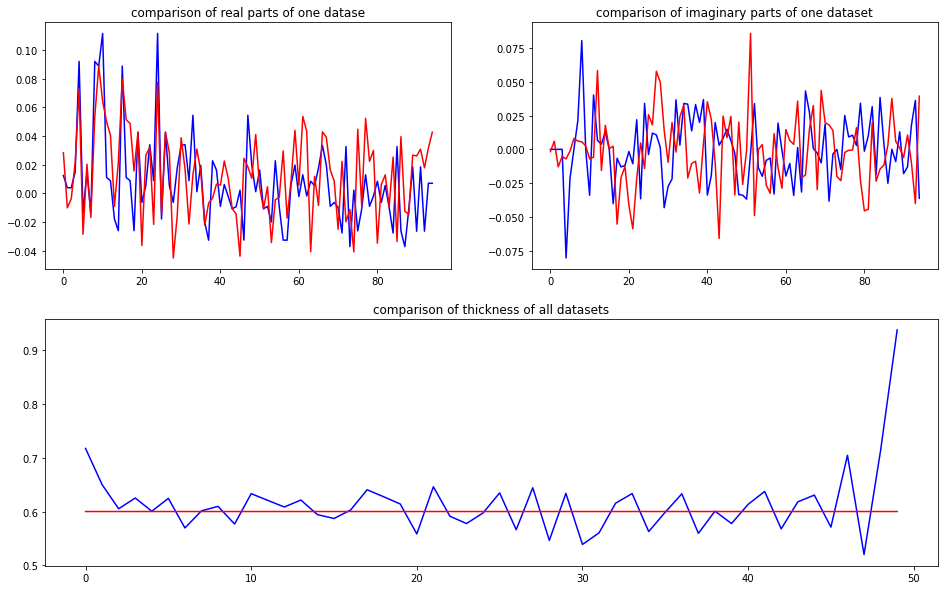

predicted thickness: 0.6003532


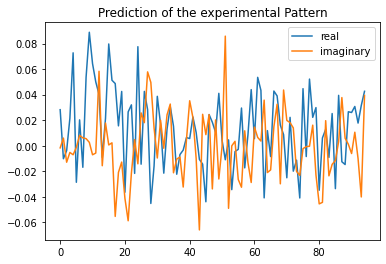

Applied shift of unit cell origin (fractional coordinates): -0.0019491583411317115 0.04931957627873037 -0.3516203361537827
Ug[ 0 ]: 0.02822 0.0  =>  0.02822 0.0
Ug[ 1 ]: 0.01178 2.2093  =>  0.01178 0.0
Ug[ 2 ]: 0.01178 -2.2093  =>  0.01178 -0.0
Ug[ 3 ]: 0.02191 -0.30988  =>  0.02191 0.0
Ug[ 4 ]: 0.06351 -0.09924  =>  0.06351 -1.99865
Ug[ 5 ]: 0.02307 -2.98002  =>  0.02307 -0.46084
Ug[ 6 ]: 0.02191 0.30988  =>  0.02191 -0.0
Ug[ 7 ]: 0.02307 2.98002  =>  0.02307 0.46084
Ug[ 8 ]: 0.06351 0.09924  =>  0.06351 1.99865
Ug[ 9 ]: 0.08441 0.01225  =>  0.08441 0.0
Ug[ 10 ]: 0.07108 0.0496  =>  0.07108 -2.17194
Ug[ 11 ]: 0.0508 -0.07907  =>  0.0508 2.11798
Ug[ 12 ]: 0.07222 0.90595  =>  0.07222 0.58382
Ug[ 13 ]: 0.02381 -2.08885  =>  0.02381 1.66291
Ug[ 14 ]: 0.02672 0.80821  =>  0.02672 2.69538
Ug[ 15 ]: 0.08441 -0.01225  =>  0.08441 -0.0
Ug[ 16 ]: 0.0508 0.07907  =>  0.0508 -2.11798
Ug[ 17 ]: 0.07222 -0.90595  =>  0.07222 -0.58382
Ug[ 18 ]: 0.02672 -0.80821  =>  0.02672 -2.69538
Ug[ 19 ]: 0.045

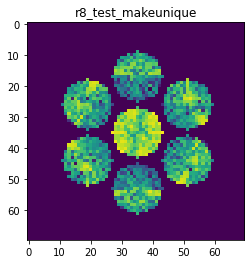

X_sim.max(): 0.9611467083166294
nlogf_X_sim.max(): 6.869166942485878
>>>replaced the 49. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 369ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 289ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 282ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000


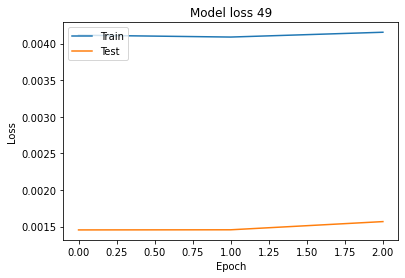

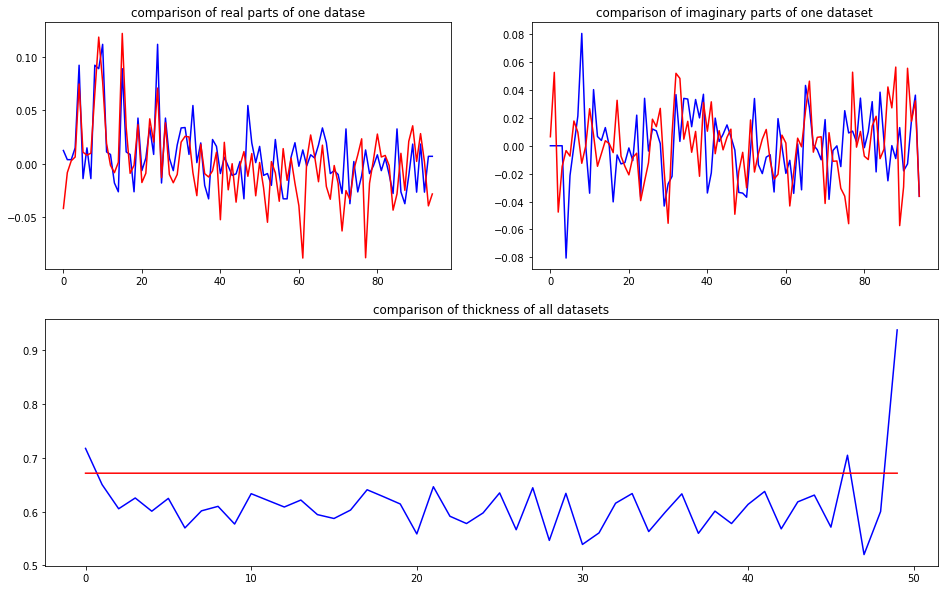

predicted thickness: 0.6716171


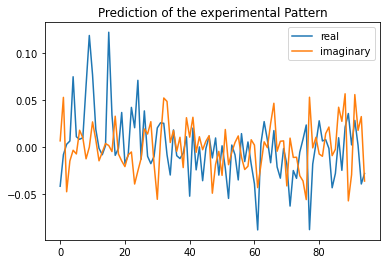

Applied shift of unit cell origin (fractional coordinates): 0.0011589397107765558 0.183912014910573 -0.25889028580548124
Ug[ 0 ]: 0.04178 3.14159  =>  0.04178 3.14159
Ug[ 1 ]: 0.05014 1.62666  =>  0.05014 -0.0
Ug[ 2 ]: 0.05014 -1.62666  =>  0.05014 0.0
Ug[ 3 ]: 0.01779 -1.15555  =>  0.01779 0.0
Ug[ 4 ]: 0.06981 0.06493  =>  0.06981 -0.40617
Ug[ 5 ]: 0.01338 -0.69309  =>  0.01338 2.08912
Ug[ 6 ]: 0.01779 1.15555  =>  0.01779 0.0
Ug[ 7 ]: 0.01338 0.69309  =>  0.01338 -2.08912
Ug[ 8 ]: 0.06981 -0.06493  =>  0.06981 0.40617
Ug[ 9 ]: 0.11951 -0.00728  =>  0.11951 0.0
Ug[ 10 ]: 0.07786 0.34056  =>  0.07786 -1.27881
Ug[ 11 ]: 0.02697 0.23477  =>  0.02697 1.86871
Ug[ 12 ]: 0.02421 -1.78955  =>  0.02421 -2.93782
Ug[ 13 ]: 0.01112 2.84283  =>  0.01112 0.0679
Ug[ 14 ]: 0.00556 1.58252  =>  0.00556 2.0609
Ug[ 15 ]: 0.11951 0.00728  =>  0.11951 -0.0
Ug[ 16 ]: 0.02697 -0.23477  =>  0.02697 -1.86871
Ug[ 17 ]: 0.02421 1.78955  =>  0.02421 2.93782
Ug[ 18 ]: 0.00556 -1.58252  =>  0.00556 -2.0609
Ug[ 19 

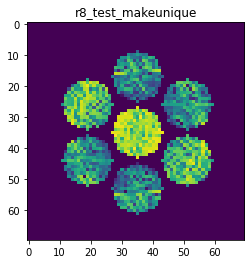

X_sim.max(): 0.9281894727647535
nlogf_X_sim.max(): 6.834312671478604
>>>replaced the 50. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 389ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 301ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 281ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000


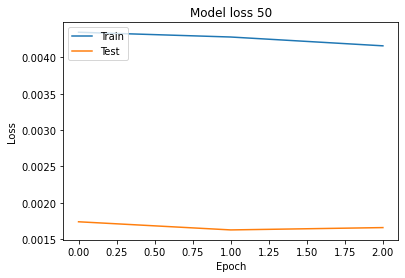

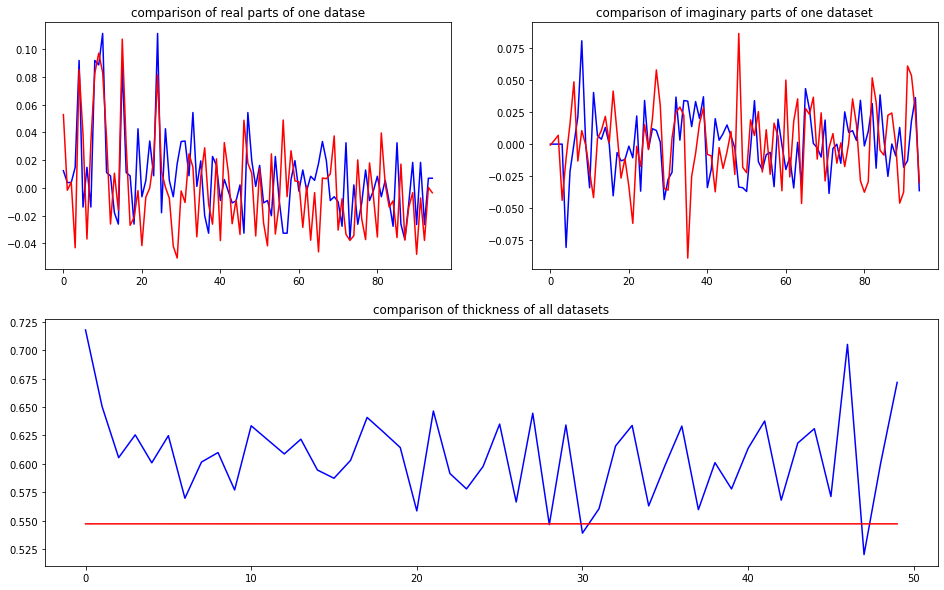

predicted thickness: 0.54728884


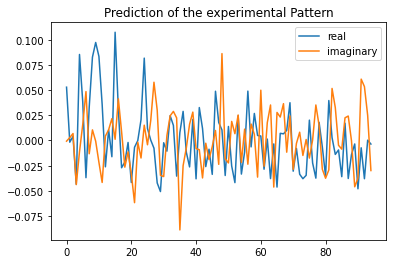

Applied shift of unit cell origin (fractional coordinates): 0.0014380355012062764 0.3640178634881469 0.1645451959236938
Ug[ 0 ]: 0.05282 0.0  =>  0.05282 0.0
Ug[ 1 ]: 0.00233 -1.03387  =>  0.00233 0.0
Ug[ 2 ]: 0.00233 1.03387  =>  0.00233 0.0
Ug[ 3 ]: 0.06122 -2.28719  =>  0.06122 0.0
Ug[ 4 ]: 0.08457 -0.12877  =>  0.08457 -3.0909
Ug[ 5 ]: 0.03855 0.38489  =>  0.03855 1.63821
Ug[ 6 ]: 0.06122 2.28719  =>  0.06122 0.0
Ug[ 7 ]: 0.03855 -0.38489  =>  0.03855 -1.63821
Ug[ 8 ]: 0.08457 0.12877  =>  0.08457 3.0909
Ug[ 9 ]: 0.10209 -0.00904  =>  0.10209 0.0
Ug[ 10 ]: 0.08445 -0.22005  =>  0.08445 0.82285
Ug[ 11 ]: 0.05315 -0.89614  =>  0.05315 -1.92098
Ug[ 12 ]: 0.02671 -3.0602  =>  0.02671 0.94482
Ug[ 13 ]: 0.01348 0.58605  =>  0.01348 -0.65824
Ug[ 14 ]: 0.03056 2.23464  =>  0.03056 -1.07738
Ug[ 15 ]: 0.10209 0.00904  =>  0.10209 0.0
Ug[ 16 ]: 0.05315 0.89614  =>  0.05315 1.92098
Ug[ 17 ]: 0.02671 3.0602  =>  0.02671 -0.94482
Ug[ 18 ]: 0.03056 -2.23464  =>  0.03056 1.07738
Ug[ 19 ]: 0.01557 

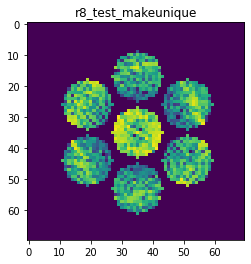

X_sim.max(): 0.9329798768092709
nlogf_X_sim.max(): 6.839454892824655
>>>replaced the 51. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 393ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 280ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 266ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


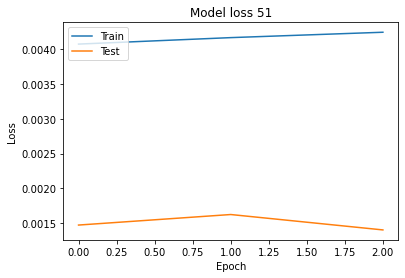

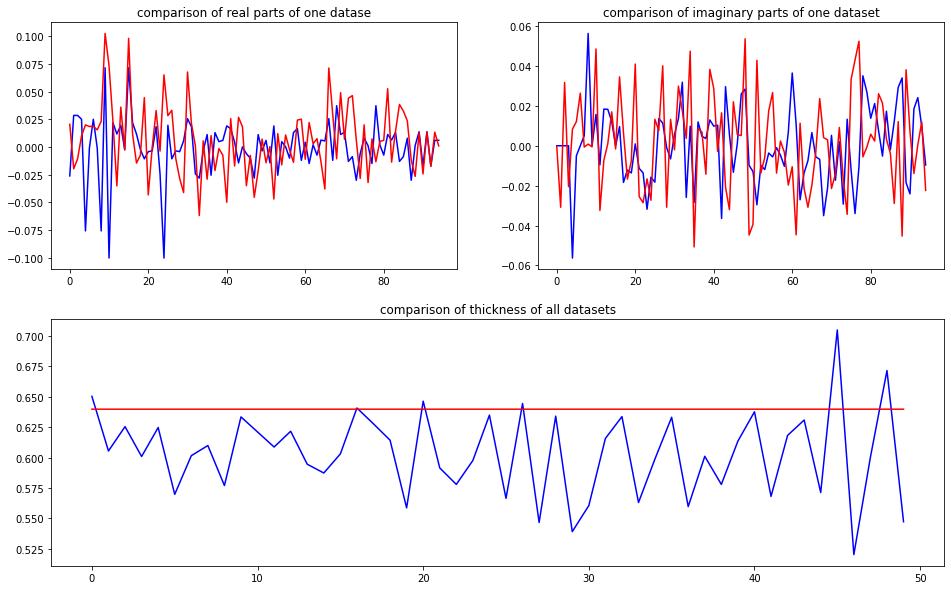

predicted thickness: 0.63985646


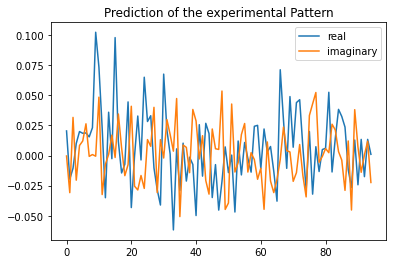

Applied shift of unit cell origin (fractional coordinates): -0.000837907866888761 0.1621919512122776 0.32169555517777654
Ug[ 0 ]: 0.02044 0.0  =>  0.02044 0.0
Ug[ 1 ]: 0.03473 -2.02127  =>  0.03473 0.0
Ug[ 2 ]: 0.03473 2.02127  =>  0.03473 0.0
Ug[ 3 ]: 0.02749 -1.01908  =>  0.02749 0.0
Ug[ 4 ]: 0.02185 0.17307  =>  0.02185 -3.06976
Ug[ 5 ]: 0.01814 0.35983  =>  0.01814 -0.64236
Ug[ 6 ]: 0.02749 1.01908  =>  0.02749 -0.0
Ug[ 7 ]: 0.01814 -0.35983  =>  0.01814 0.64236
Ug[ 8 ]: 0.02185 -0.17307  =>  0.02185 3.06976
Ug[ 9 ]: 0.10007 0.00526  =>  0.10007 0.0
Ug[ 10 ]: 0.07885 0.50111  =>  0.07885 2.51712
Ug[ 11 ]: 0.03771 -1.09156  =>  0.03771 -3.1181
Ug[ 12 ]: 0.02571 -2.8704  =>  0.02571 2.38843
Ug[ 13 ]: 0.03269 -0.18955  =>  0.03269 0.80738
Ug[ 14 ]: 0.01755 1.85532  =>  0.01755 -1.1903
Ug[ 15 ]: 0.10007 -0.00526  =>  0.10007 -0.0
Ug[ 16 ]: 0.03771 1.09156  =>  0.03771 3.1181
Ug[ 17 ]: 0.02571 2.8704  =>  0.02571 -2.38843
Ug[ 18 ]: 0.01755 -1.85532  =>  0.01755 1.1903
Ug[ 19 ]: 0.03954 

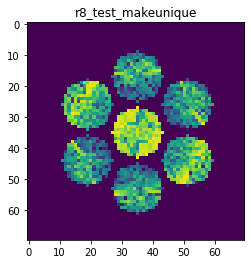

X_sim.max(): 0.9545974365393387
nlogf_X_sim.max(): 6.862336732881437
>>>replaced the 52. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 347ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 239ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 261ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000


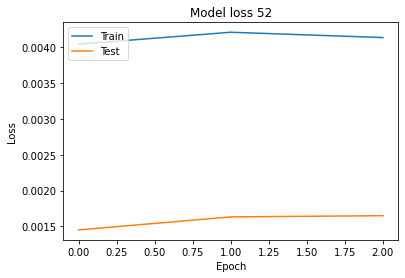

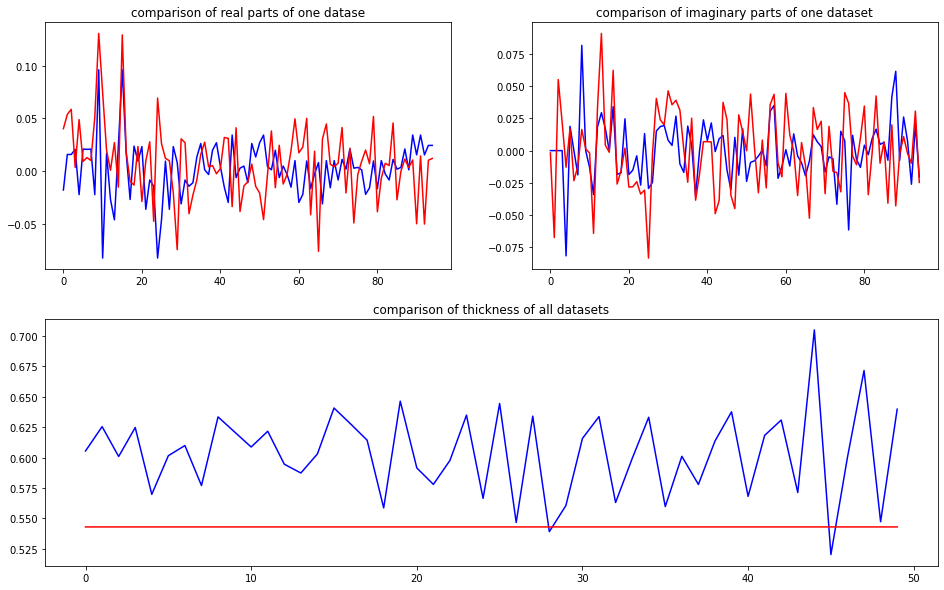

predicted thickness: 0.54302317


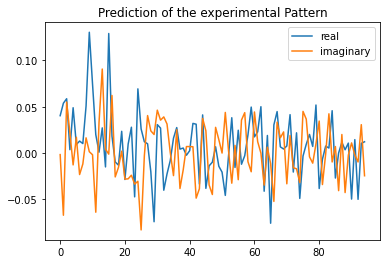

Applied shift of unit cell origin (fractional coordinates): -0.001602834347250616 -0.19463673090101147 0.13201774925840803
Ug[ 0 ]: 0.04026 0.0  =>  0.04026 0.0
Ug[ 1 ]: 0.08297 -0.82949  =>  0.08297 0.0
Ug[ 2 ]: 0.08297 0.82949  =>  0.08297 0.0
Ug[ 3 ]: 0.02406 1.22294  =>  0.02406 -0.0
Ug[ 4 ]: 0.0519 -0.28566  =>  0.0519 -0.67911
Ug[ 5 ]: 0.01739 0.98188  =>  0.01739 -1.07056
Ug[ 6 ]: 0.02406 -1.22294  =>  0.02406 0.0
Ug[ 7 ]: 0.01739 -0.98188  =>  0.01739 1.07056
Ug[ 8 ]: 0.0519 0.28566  =>  0.0519 0.67911
Ug[ 9 ]: 0.12935 0.01007  =>  0.12935 -0.0
Ug[ 10 ]: 0.07303 0.19746  =>  0.07303 1.01688
Ug[ 11 ]: 0.06588 -1.28053  =>  0.06588 -2.12009
Ug[ 12 ]: 0.0298 1.72051  =>  0.0298 2.93338
Ug[ 13 ]: 0.09084 1.2772  =>  0.09084 -2.96363
Ug[ 14 ]: 0.01725 2.53045  =>  0.01725 2.91382
Ug[ 15 ]: 0.12935 -0.01007  =>  0.12935 0.0
Ug[ 16 ]: 0.06588 1.28053  =>  0.06588 2.12009
Ug[ 17 ]: 0.0298 -1.72051  =>  0.0298 -2.93338
Ug[ 18 ]: 0.01725 -2.53045  =>  0.01725 -2.91382
Ug[ 19 ]: 0.01794 0

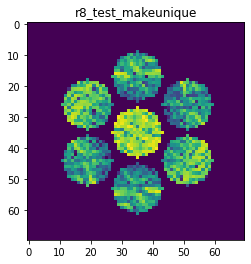

X_sim.max(): 0.8970971801973143
nlogf_X_sim.max(): 6.800278280929534
>>>replaced the 53. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 355ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 274ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 267ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000


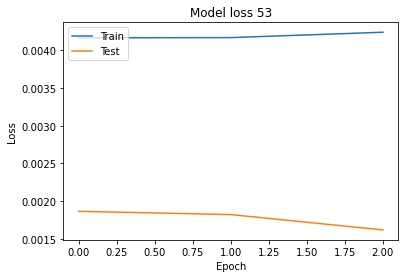

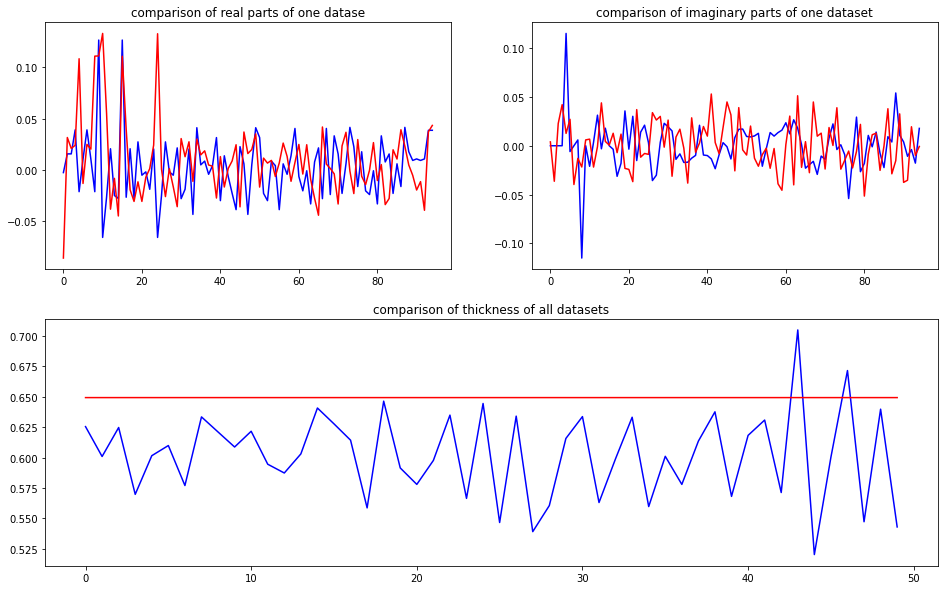

predicted thickness: 0.64938253


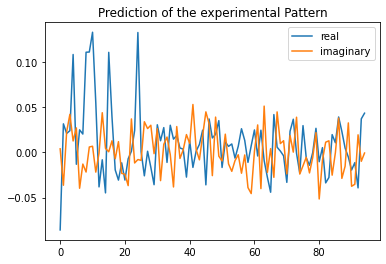

Applied shift of unit cell origin (fractional coordinates): -0.0038054586484402297 -0.16386659361323092 0.13408150646415837
Ug[ 0 ]: 0.08556 3.14159  =>  0.08556 3.14159
Ug[ 1 ]: 0.03963 -0.84246  =>  0.03963 -0.0
Ug[ 2 ]: 0.03963 0.84246  =>  0.03963 0.0
Ug[ 3 ]: 0.04774 1.0296  =>  0.04774 -0.0
Ug[ 4 ]: 0.11154 0.15476  =>  0.11154 -0.03239
Ug[ 5 ]: 0.02036 1.39252  =>  0.02036 -0.47954
Ug[ 6 ]: 0.04774 -1.0296  =>  0.04774 0.0
Ug[ 7 ]: 0.02036 -1.39252  =>  0.02036 0.47954
Ug[ 8 ]: 0.11154 -0.15476  =>  0.11154 0.03239
Ug[ 9 ]: 0.11155 0.02391  =>  0.11155 -0.0
Ug[ 10 ]: 0.13389 0.05495  =>  0.13389 0.8735
Ug[ 11 ]: 0.05054 -0.34915  =>  0.05054 -1.21552
Ug[ 12 ]: 0.02893 3.03324  =>  0.02893 -2.24425
Ug[ 13 ]: 0.02669 1.70961  =>  0.02669 -2.72543
Ug[ 14 ]: 0.03788 -3.04311  =>  0.03788 -2.87988
Ug[ 15 ]: 0.11155 -0.02391  =>  0.11155 0.0
Ug[ 16 ]: 0.05054 0.34915  =>  0.05054 1.21552
Ug[ 17 ]: 0.02893 -3.03324  =>  0.02893 2.24425
Ug[ 18 ]: 0.03788 3.04311  =>  0.03788 2.87988
Ug[

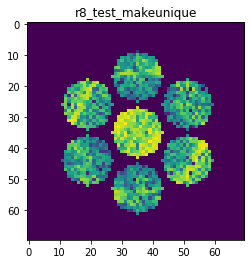

X_sim.max(): 0.909509357020739
nlogf_X_sim.max(): 6.814004175908639
>>>replaced the 54. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 360ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 263ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 255ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


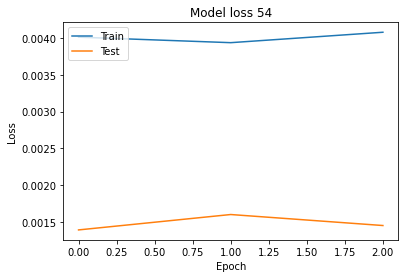

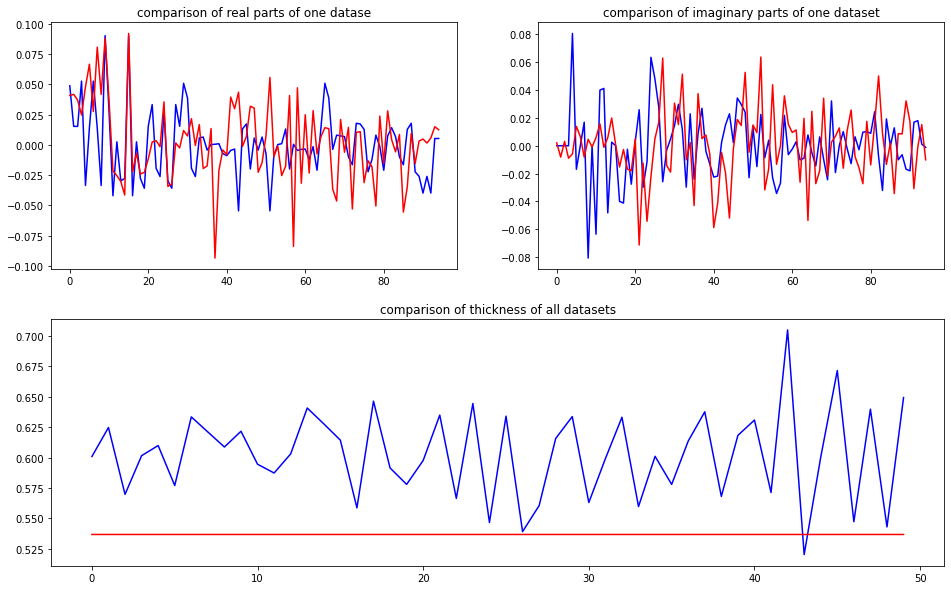

predicted thickness: 0.53682303


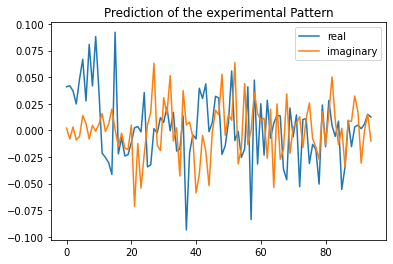

Applied shift of unit cell origin (fractional coordinates): 0.001482221550073464 0.0458908856139363 0.022628643998462306
Ug[ 0 ]: 0.04096 0.0  =>  0.04096 0.0
Ug[ 1 ]: 0.03986 -0.14218  =>  0.03986 0.0
Ug[ 2 ]: 0.03986 0.14218  =>  0.03986 -0.0
Ug[ 3 ]: 0.0273 -0.28834  =>  0.0273 0.0
Ug[ 4 ]: 0.04518 -0.11656  =>  0.04518 0.31397
Ug[ 5 ]: 0.07465 0.14852  =>  0.07465 0.29468
Ug[ 6 ]: 0.0273 0.28834  =>  0.0273 -0.0
Ug[ 7 ]: 0.07465 -0.14852  =>  0.07465 -0.29468
Ug[ 8 ]: 0.04518 0.11656  =>  0.04518 -0.31397
Ug[ 9 ]: 0.09025 -0.00931  =>  0.09025 0.0
Ug[ 10 ]: 0.03886 0.36819  =>  0.03886 0.51968
Ug[ 11 ]: 0.02676 2.52483  =>  0.02676 2.39196
Ug[ 12 ]: 0.01621 3.09179  =>  0.01621 2.81276
Ug[ 13 ]: 0.03234 3.12585  =>  0.03234 2.98901
Ug[ 14 ]: 0.03756 2.63048  =>  0.03756 2.20927
Ug[ 15 ]: 0.09025 0.00931  =>  0.09025 0.0
Ug[ 16 ]: 0.02676 -2.52483  =>  0.02676 -2.39196
Ug[ 17 ]: 0.01621 -3.09179  =>  0.01621 -2.81276
Ug[ 18 ]: 0.03756 -2.63048  =>  0.03756 -2.20927
Ug[ 19 ]: 0.03263

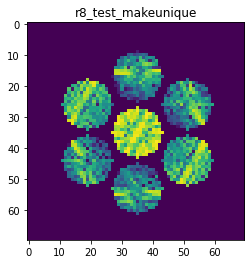

X_sim.max(): 0.9267074476477359
nlogf_X_sim.max(): 6.832716432704759
>>>replaced the 55. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 366ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 269ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 261ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


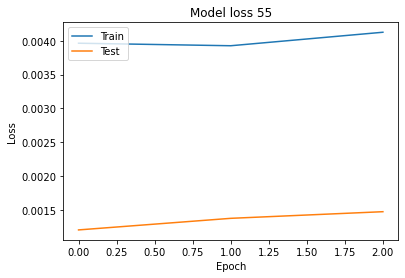

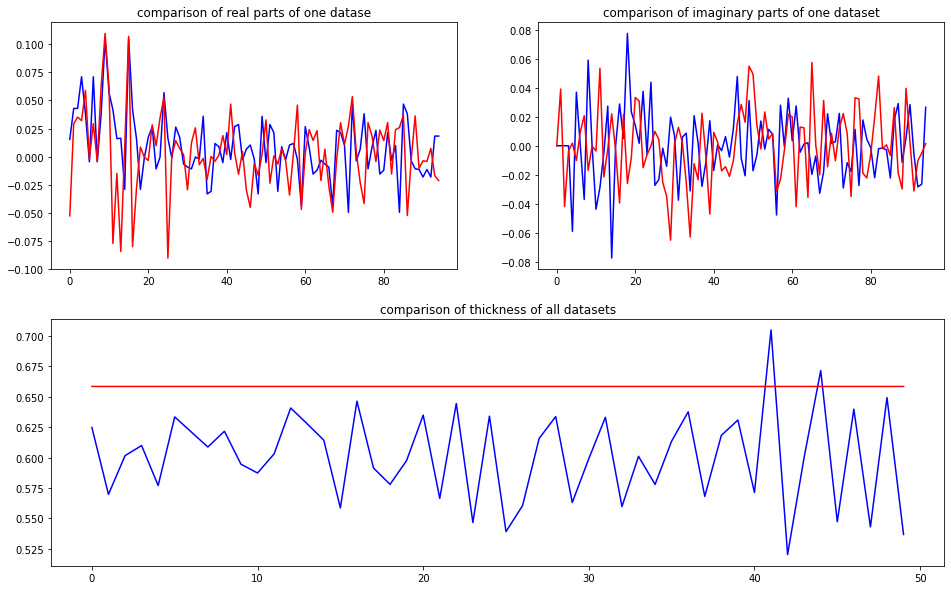

predicted thickness: 0.65855235


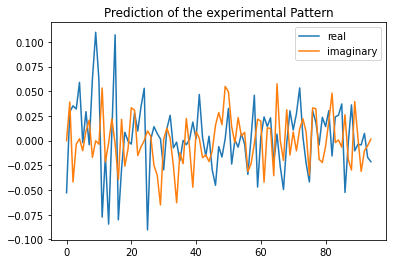

Applied shift of unit cell origin (fractional coordinates): -0.00220270559465256 0.03331253309344975 -0.14319759189471037
Ug[ 0 ]: 0.05279 3.14159  =>  0.05279 3.14159
Ug[ 1 ]: 0.05171 0.89974  =>  0.05171 0.0
Ug[ 2 ]: 0.05171 -0.89974  =>  0.05171 -0.0
Ug[ 3 ]: 0.03132 -0.20931  =>  0.03132 0.0
Ug[ 4 ]: 0.06154 0.15328  =>  0.06154 -0.53714
Ug[ 5 ]: 0.01575 -1.7695  =>  0.01575 -0.66045
Ug[ 6 ]: 0.03132 0.20931  =>  0.03132 0.0
Ug[ 7 ]: 0.01575 1.7695  =>  0.01575 0.66045
Ug[ 8 ]: 0.06154 -0.15328  =>  0.06154 0.53714
Ug[ 9 ]: 0.10826 0.01384  =>  0.10826 -0.0
Ug[ 10 ]: 0.05722 -0.03182  =>  0.05722 -0.94539
Ug[ 11 ]: 0.09154 2.6103  =>  0.09154 -2.78698
Ug[ 12 ]: 0.03048 -2.35614  =>  0.03048 -2.57929
Ug[ 13 ]: 0.08777 -3.07271  =>  0.08777 2.08759
Ug[ 14 ]: 0.02553 1.22105  =>  0.02553 1.89763
Ug[ 15 ]: 0.10826 -0.01384  =>  0.10826 0.0
Ug[ 16 ]: 0.09154 -2.6103  =>  0.09154 2.78698
Ug[ 17 ]: 0.03048 2.35614  =>  0.03048 2.57929
Ug[ 18 ]: 0.02553 -1.22105  =>  0.02553 -1.89763
Ug[ 1

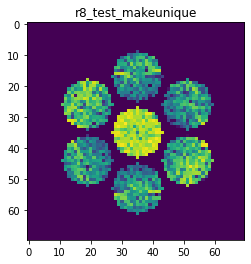

X_sim.max(): 0.9546877250296097
nlogf_X_sim.max(): 6.862431212231932
>>>replaced the 56. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 391ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 307ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 3s 318ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000


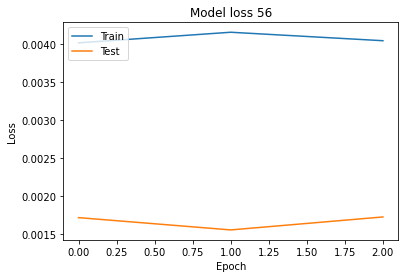

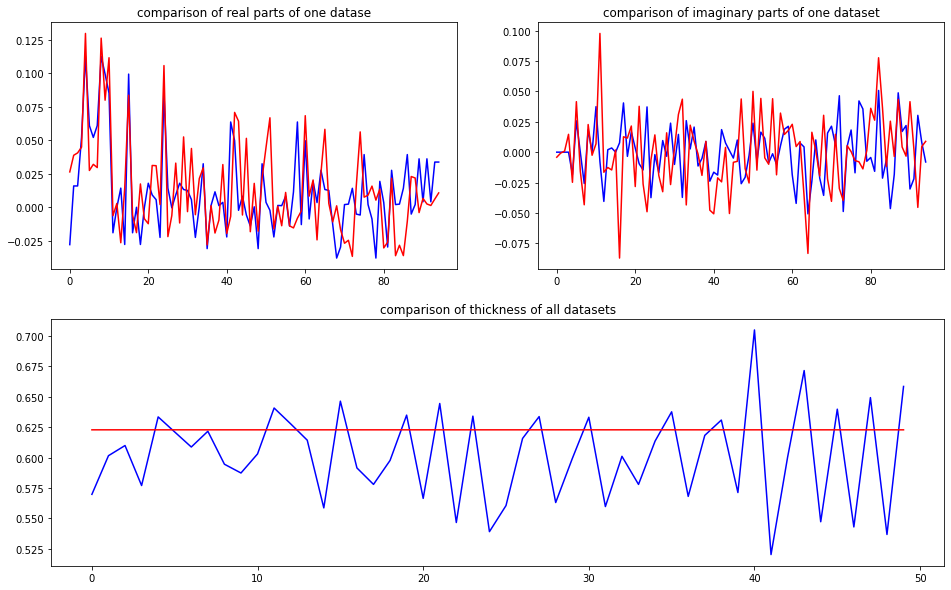

predicted thickness: 0.6228802


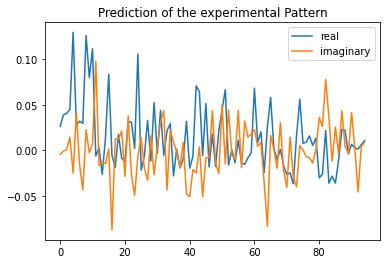

Applied shift of unit cell origin (fractional coordinates): 0.004223517933030605 -0.05978414431926956 0.0033503902369885065
Ug[ 0 ]: 0.0265 0.0  =>  0.0265 0.0
Ug[ 1 ]: 0.03981 -0.02105  =>  0.03981 0.0
Ug[ 2 ]: 0.03981 0.02105  =>  0.03981 0.0
Ug[ 3 ]: 0.04148 0.37563  =>  0.04148 0.0
Ug[ 4 ]: 0.13057 -0.18309  =>  0.13057 -0.53768
Ug[ 5 ]: 0.05123 0.97613  =>  0.05123 0.57944
Ug[ 6 ]: 0.04148 -0.37563  =>  0.04148 0.0
Ug[ 7 ]: 0.05123 -0.97613  =>  0.05123 -0.57944
Ug[ 8 ]: 0.13057 0.18309  =>  0.13057 0.53768
Ug[ 9 ]: 0.08199 -0.02654  =>  0.08199 -0.0
Ug[ 10 ]: 0.10917 0.06144  =>  0.10917 0.10903
Ug[ 11 ]: 0.09266 1.63171  =>  0.09266 1.63719
Ug[ 12 ]: 0.0166 -2.06526  =>  0.0166 -1.66309
Ug[ 13 ]: 0.02747 -2.63168  =>  0.02747 -2.20846
Ug[ 14 ]: 0.0207 -0.68661  =>  0.0207 -0.30549
Ug[ 15 ]: 0.08199 0.02654  =>  0.08199 0.0
Ug[ 16 ]: 0.09266 -1.63171  =>  0.09266 -1.63719
Ug[ 17 ]: 0.0166 2.06526  =>  0.0166 1.66309
Ug[ 18 ]: 0.0207 0.68661  =>  0.0207 0.30549
Ug[ 19 ]: 0.02162 1

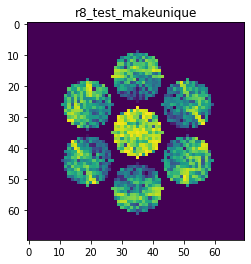

X_sim.max(): 0.9073896836975528
nlogf_X_sim.max(): 6.811673453603237
>>>replaced the 57. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 401ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 279ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 284ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


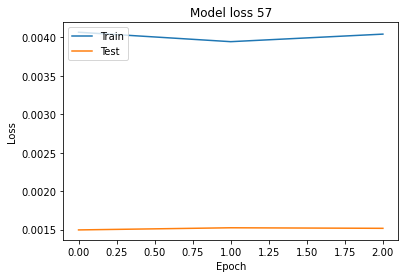

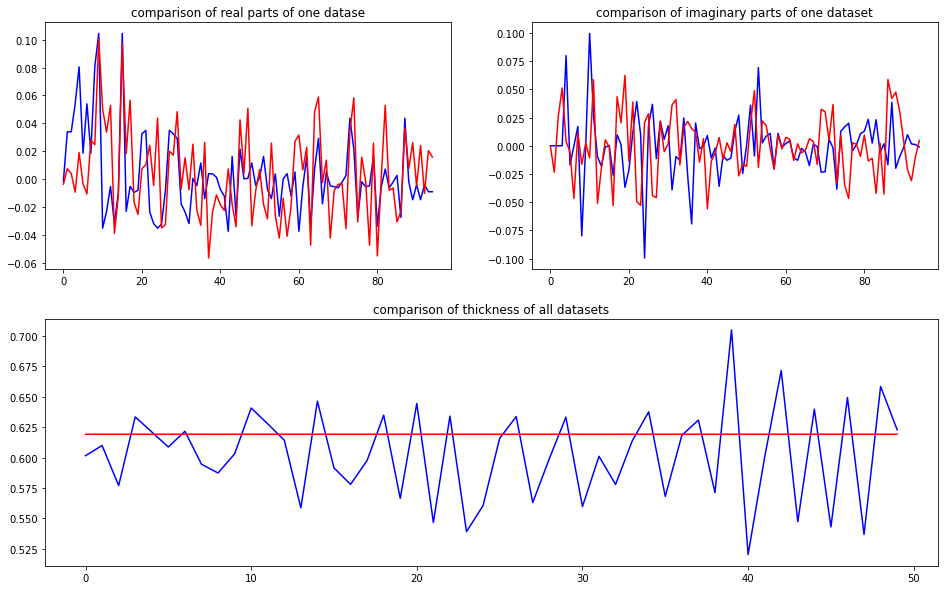

predicted thickness: 0.6192708


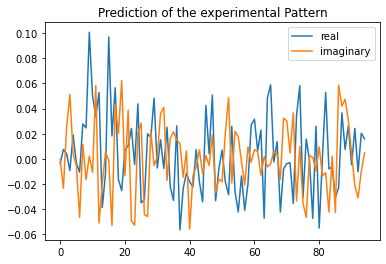

Applied shift of unit cell origin (fractional coordinates): -0.002702746543692662 -0.28199607906094076 0.21347339294610618
Ug[ 0 ]: 0.00365 3.14159  =>  0.00365 3.14159
Ug[ 1 ]: 0.02518 -1.34129  =>  0.02518 0.0
Ug[ 2 ]: 0.02518 1.34129  =>  0.02518 -0.0
Ug[ 3 ]: 0.04993 1.77183  =>  0.04993 0.0
Ug[ 4 ]: 0.02414 0.43671  =>  0.02414 0.00616
Ug[ 5 ]: 0.01483 -0.60689  =>  0.01483 2.56317
Ug[ 6 ]: 0.04993 -1.77183  =>  0.04993 -0.0
Ug[ 7 ]: 0.01483 0.60689  =>  0.01483 -2.56317
Ug[ 8 ]: 0.02414 -0.43671  =>  0.02414 -0.00616
Ug[ 9 ]: 0.09905 0.01698  =>  0.09905 0.0
Ug[ 10 ]: 0.04962 -0.32359  =>  0.04962 1.00072
Ug[ 11 ]: 0.06147 1.13515  =>  0.06147 -0.22312
Ug[ 12 ]: 0.07232 -0.71179  =>  0.07232 1.04306
Ug[ 13 ]: 0.04404 -2.56331  =>  0.04404 0.53283
Ug[ 14 ]: 0.01596 -2.65267  =>  0.01596 -2.23912
Ug[ 15 ]: 0.09905 -0.01698  =>  0.09905 0.0
Ug[ 16 ]: 0.06147 -1.13515  =>  0.06147 0.22312
Ug[ 17 ]: 0.07232 0.71179  =>  0.07232 -1.04306
Ug[ 18 ]: 0.01596 2.65267  =>  0.01596 2.23912
U

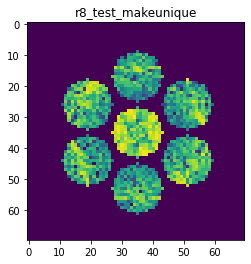

X_sim.max(): 0.8445069999539975
nlogf_X_sim.max(): 6.739936447374733
>>>replaced the 58. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 364ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 292ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 278ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


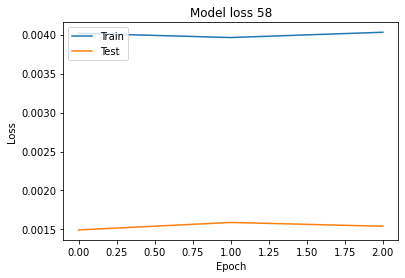

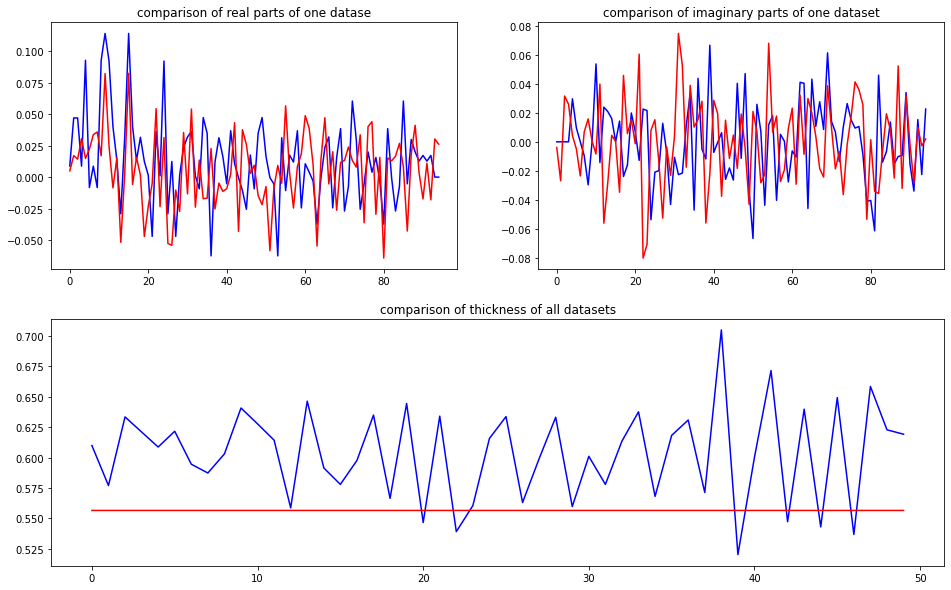

predicted thickness: 0.5565973


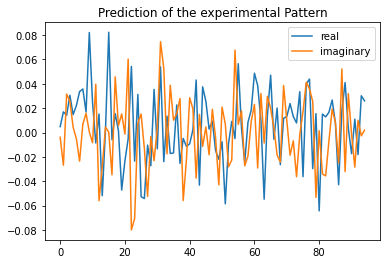

Applied shift of unit cell origin (fractional coordinates): -0.0002215413133238655 -0.10443962401701071 0.17202479194364578
Ug[ 0 ]: 0.00485 0.0  =>  0.00485 0.0
Ug[ 1 ]: 0.03307 -1.08086  =>  0.03307 -0.0
Ug[ 2 ]: 0.03307 1.08086  =>  0.03307 0.0
Ug[ 3 ]: 0.04047 0.65621  =>  0.04047 0.0
Ug[ 4 ]: 0.01676 -0.34759  =>  0.01676 0.07706
Ug[ 5 ]: 0.0295 -0.20046  =>  0.0295 -1.93753
Ug[ 6 ]: 0.04047 -0.65621  =>  0.04047 0.0
Ug[ 7 ]: 0.0295 0.20046  =>  0.0295 1.93753
Ug[ 8 ]: 0.01676 0.34759  =>  0.01676 -0.07706
Ug[ 9 ]: 0.08213 0.00139  =>  0.08213 0.0
Ug[ 10 ]: 0.02907 -0.28286  =>  0.02907 0.79662
Ug[ 11 ]: 0.0379 1.76433  =>  0.0379 0.68208
Ug[ 12 ]: 0.0531 -1.27804  =>  0.0531 -0.62322
Ug[ 13 ]: 0.05664 -2.74986  =>  0.05664 -1.01417
Ug[ 14 ]: 0.00207 -0.29386  =>  0.00207 -0.7199
Ug[ 15 ]: 0.08213 -0.00139  =>  0.08213 -0.0
Ug[ 16 ]: 0.0379 -1.76433  =>  0.0379 -0.68208
Ug[ 17 ]: 0.0531 1.27804  =>  0.0531 0.62322
Ug[ 18 ]: 0.00207 0.29386  =>  0.00207 0.7199
Ug[ 19 ]: 0.05271 2.8

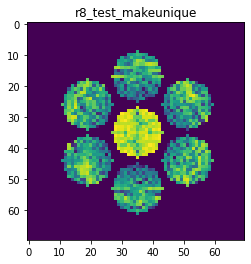

X_sim.max(): 0.8716790824086394
nlogf_X_sim.max(): 6.771567885059549
>>>replaced the 59. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 370ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 279ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 290ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


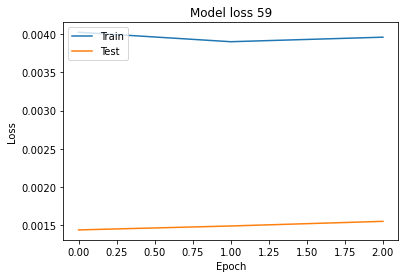

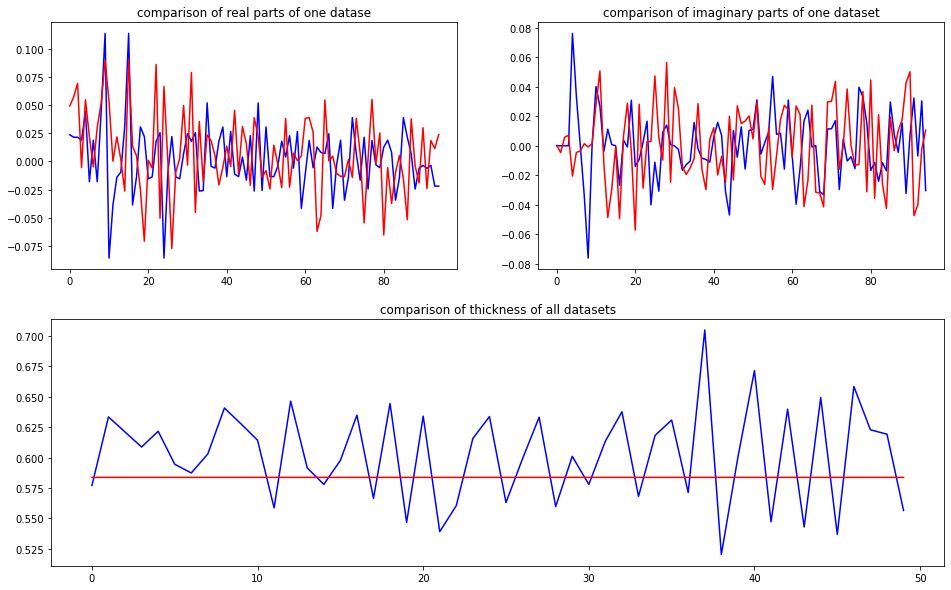

predicted thickness: 0.5837885


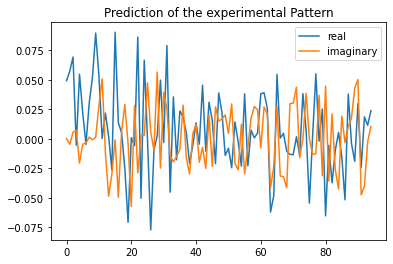

Applied shift of unit cell origin (fractional coordinates): -0.0020724788405182127 -0.37101337160765946 0.013041514418788688
Ug[ 0 ]: 0.04911 0.0  =>  0.04911 0.0
Ug[ 1 ]: 0.06333 -0.08194  =>  0.06333 0.0
Ug[ 2 ]: 0.06333 0.08194  =>  0.06333 0.0
Ug[ 3 ]: 0.00733 2.33115  =>  0.00733 0.0
Ug[ 4 ]: 0.05409 -0.18372  =>  0.05409 -2.43292
Ug[ 5 ]: 0.02631 -0.11307  =>  0.02631 -2.52616
Ug[ 6 ]: 0.00733 -2.33115  =>  0.00733 -0.0
Ug[ 7 ]: 0.02631 0.11307  =>  0.02631 2.52616
Ug[ 8 ]: 0.05409 0.18372  =>  0.05409 2.43292
Ug[ 9 ]: 0.08958 0.01302  =>  0.08958 0.0
Ug[ 10 ]: 0.06105 0.20829  =>  0.06105 0.27721
Ug[ 11 ]: 0.05053 1.4352  =>  0.05053 1.34024
Ug[ 12 ]: 0.01624 -0.59495  =>  0.01624 1.72318
Ug[ 13 ]: 0.048 -1.55747  =>  0.048 0.8426
Ug[ 14 ]: 0.03904 -2.29037  =>  0.03904 -0.05419
Ug[ 15 ]: 0.08958 -0.01302  =>  0.08958 -0.0
Ug[ 16 ]: 0.05053 -1.4352  =>  0.05053 -1.34024
Ug[ 17 ]: 0.01624 0.59495  =>  0.01624 -1.72318
Ug[ 18 ]: 0.03904 2.29037  =>  0.03904 0.05419
Ug[ 19 ]: 0.074

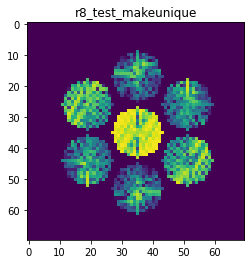

X_sim.max(): 0.9693899519723782
nlogf_X_sim.max(): 6.877698003054775
>>>replaced the 60. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 376ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 292ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 278ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


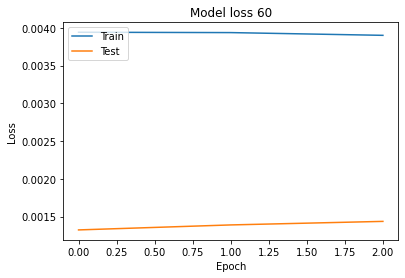

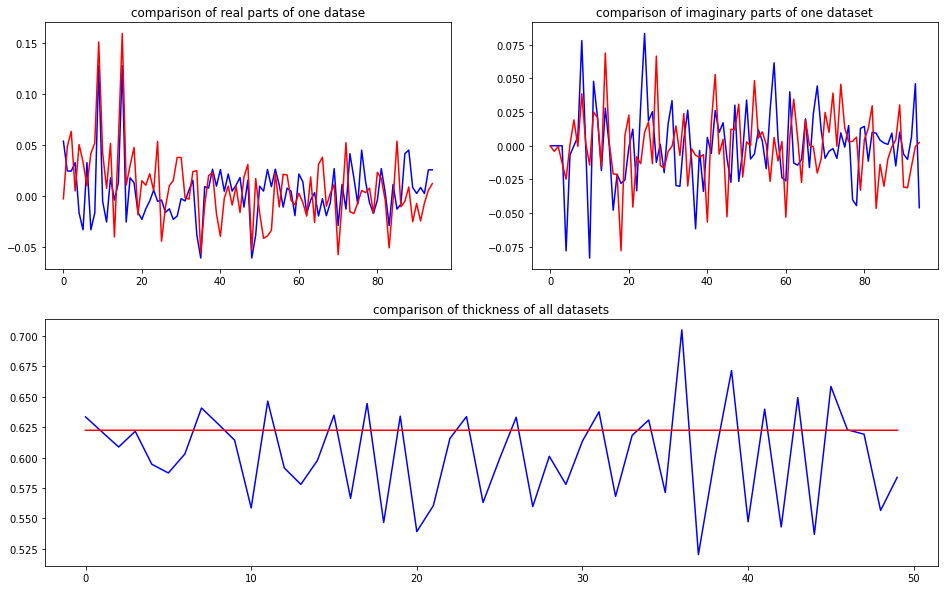

predicted thickness: 0.6225347


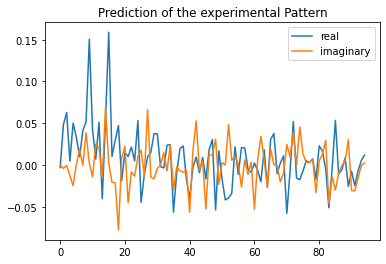

Applied shift of unit cell origin (fractional coordinates): -5.1699430596840696e-05 0.18305960163414706 0.005034658229208602
Ug[ 0 ]: 0.00313 3.14159  =>  0.00313 3.14159
Ug[ 1 ]: 0.05558 -0.03163  =>  0.05558 -0.0
Ug[ 2 ]: 0.05558 0.03163  =>  0.05558 0.0
Ug[ 3 ]: 0.01755 -1.1502  =>  0.01755 0.0
Ug[ 4 ]: 0.05987 -0.55702  =>  0.05987 0.62481
Ug[ 5 ]: 0.03718 0.01818  =>  0.03718 1.13674
Ug[ 6 ]: 0.01755 1.1502  =>  0.01755 -0.0
Ug[ 7 ]: 0.03718 -0.01818  =>  0.03718 -1.13674
Ug[ 8 ]: 0.05987 0.55702  =>  0.05987 -0.62481
Ug[ 9 ]: 0.15447 0.00032  =>  0.15447 0.0
Ug[ 10 ]: 0.04897 -0.24915  =>  0.04897 -0.21784
Ug[ 11 ]: 0.02457 1.20943  =>  0.02457 1.17747
Ug[ 12 ]: 0.04547 0.47975  =>  0.04547 -0.67077
Ug[ 13 ]: 0.04572 -2.77173  =>  0.04572 2.39257
Ug[ 14 ]: 0.08865 0.97226  =>  0.08865 -0.2099
Ug[ 15 ]: 0.15447 -0.00032  =>  0.15447 0.0
Ug[ 16 ]: 0.02457 -1.20943  =>  0.02457 -1.17747
Ug[ 17 ]: 0.04547 -0.47975  =>  0.04547 0.67077
Ug[ 18 ]: 0.08865 -0.97226  =>  0.08865 0.2099
Ug

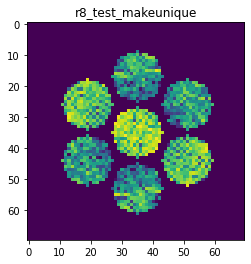

X_sim.max(): 0.9044228524051217
nlogf_X_sim.max(): 6.808402074803855
>>>replaced the 61. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 353ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 264ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 285ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


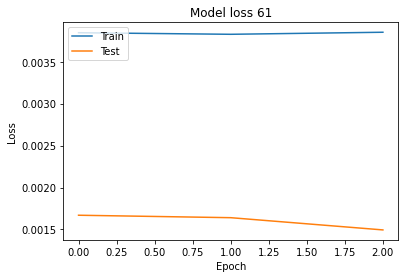

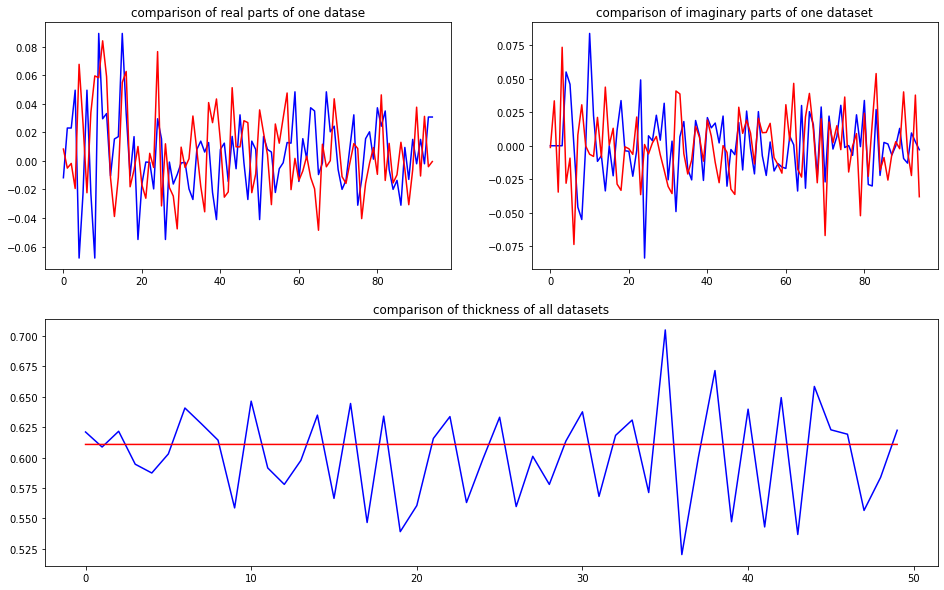

predicted thickness: 0.6108654


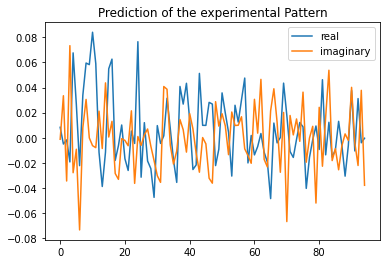

Applied shift of unit cell origin (fractional coordinates): 0.0009787696818006454 -0.29379452925630517 -0.26588031221692976
Ug[ 0 ]: 0.00828 0.0  =>  0.00828 0.0
Ug[ 1 ]: 0.03418 1.67058  =>  0.03418 -0.0
Ug[ 2 ]: 0.03418 -1.67058  =>  0.03418 0.0
Ug[ 3 ]: 0.07638 1.84597  =>  0.07638 0.0
Ug[ 4 ]: 0.07006 -0.43045  =>  0.07006 2.3362
Ug[ 5 ]: 0.03127 -0.27926  =>  0.03127 -0.45465
Ug[ 6 ]: 0.07638 -1.84597  =>  0.07638 -0.0
Ug[ 7 ]: 0.03127 0.27926  =>  0.03127 0.45465
Ug[ 8 ]: 0.07006 0.43045  =>  0.07006 -2.3362
Ug[ 9 ]: 0.05667 -0.00615  =>  0.05667 -0.0
Ug[ 10 ]: 0.08051 -0.04531  =>  0.08051 -1.70973
Ug[ 11 ]: 0.0618 -0.17082  =>  0.0618 1.5059
Ug[ 12 ]: 0.02897 2.10995  =>  0.02897 -2.32112
Ug[ 13 ]: 0.03525 -3.10613  =>  0.03525 -2.92459
Ug[ 14 ]: 0.03949 1.79655  =>  0.03949 -0.96394
Ug[ 15 ]: 0.05667 0.00615  =>  0.05667 0.0
Ug[ 16 ]: 0.0618 0.17082  =>  0.0618 -1.5059
Ug[ 17 ]: 0.02897 -2.10995  =>  0.02897 2.32112
Ug[ 18 ]: 0.03949 -1.79655  =>  0.03949 0.96394
Ug[ 19 ]: 0.0

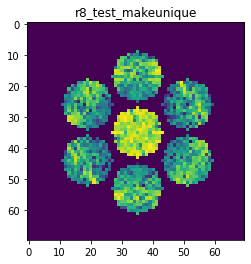

X_sim.max(): 0.867353744579479
nlogf_X_sim.max(): 6.766599171476655
>>>replaced the 62. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 379ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 295ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 283ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000


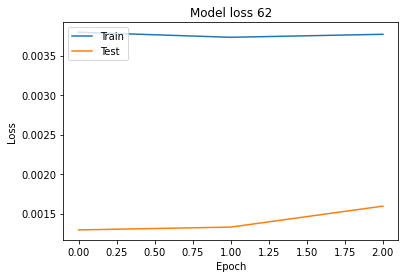

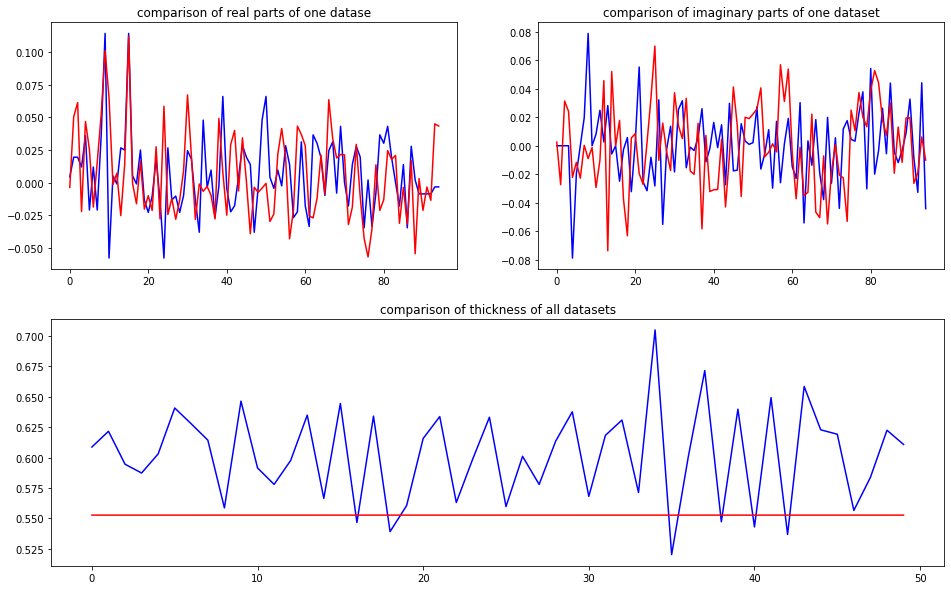

predicted thickness: 0.5527452


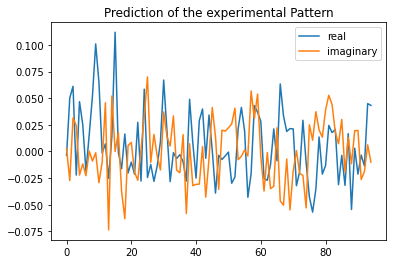

Applied shift of unit cell origin (fractional coordinates): 0.0008641075612010983 -0.364171486484721 0.07721498009493949
Ug[ 0 ]: 0.00376 3.14159  =>  0.00376 3.14159
Ug[ 1 ]: 0.06301 -0.48516  =>  0.06301 -0.0
Ug[ 2 ]: 0.06301 0.48516  =>  0.06301 0.0
Ug[ 3 ]: 0.03115 2.28816  =>  0.03115 0.0
Ug[ 4 ]: 0.04975 -0.13279  =>  0.04975 -1.93579
Ug[ 5 ]: 0.02132 -0.28471  =>  0.02132 -3.05803
Ug[ 6 ]: 0.03115 -2.28816  =>  0.03115 0.0
Ug[ 7 ]: 0.02132 0.28471  =>  0.02132 3.05803
Ug[ 8 ]: 0.04975 0.13279  =>  0.04975 1.93579
Ug[ 9 ]: 0.10649 -0.00543  =>  0.10649 0.0
Ug[ 10 ]: 0.06929 -0.46978  =>  0.06929 0.02081
Ug[ 11 ]: 0.01403 -1.64938  =>  0.01403 -2.1291
Ug[ 12 ]: 0.04183 1.68054  =>  0.04183 -2.30906
Ug[ 13 ]: 0.07602 -1.90433  =>  0.07602 0.87441
Ug[ 14 ]: 0.05964 1.31149  =>  0.05964 3.11992
Ug[ 15 ]: 0.10649 0.00543  =>  0.10649 0.0
Ug[ 16 ]: 0.01403 1.64938  =>  0.01403 2.1291
Ug[ 17 ]: 0.04183 -1.68054  =>  0.04183 2.30906
Ug[ 18 ]: 0.05964 -1.31149  =>  0.05964 -3.11992
Ug[ 19

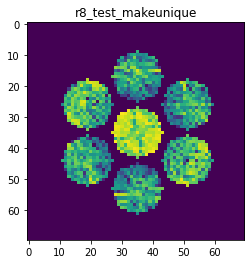

X_sim.max(): 0.8588467668574804
nlogf_X_sim.max(): 6.756754195299258
>>>replaced the 63. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 371ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 263ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 271ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000


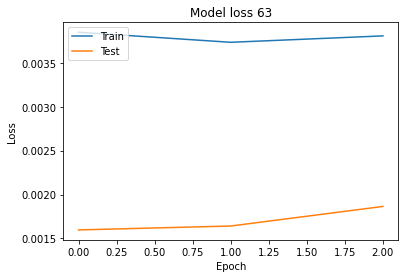

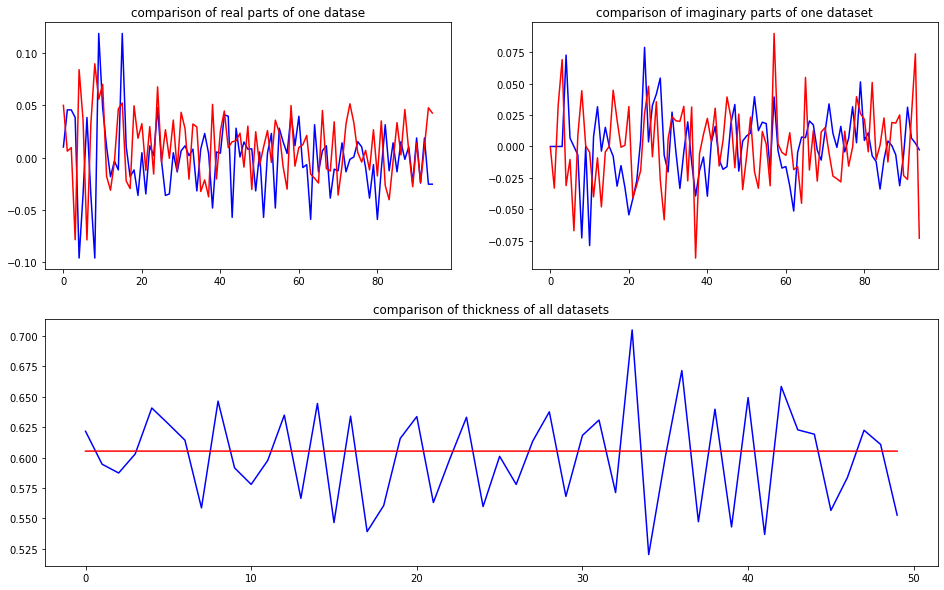

predicted thickness: 0.60538125


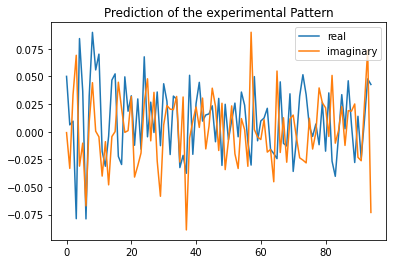

Applied shift of unit cell origin (fractional coordinates): -0.000556037323647235 -0.38636517248031194 0.21282911757735612
Ug[ 0 ]: 0.05015 0.0  =>  0.05015 0.0
Ug[ 1 ]: 0.03422 -1.33724  =>  0.03422 0.0
Ug[ 2 ]: 0.03422 1.33724  =>  0.03422 -0.0
Ug[ 3 ]: 0.10409 2.4276  =>  0.10409 -0.0
Ug[ 4 ]: 0.09512 -0.40862  =>  0.09512 -1.49898
Ug[ 5 ]: 0.03586 -0.27163  =>  0.03586 2.2467
Ug[ 6 ]: 0.10409 -2.4276  =>  0.10409 0.0
Ug[ 7 ]: 0.03586 0.27163  =>  0.03586 -2.2467
Ug[ 8 ]: 0.09512 0.40862  =>  0.09512 1.49898
Ug[ 9 ]: 0.05422 0.00349  =>  0.05422 0.0
Ug[ 10 ]: 0.07084 -0.22104  =>  0.07084 1.11271
Ug[ 11 ]: 0.04699 -2.01164  =>  0.04699 2.93081
Ug[ 12 ]: 0.03393 -2.68385  =>  0.03393 -0.25974
Ug[ 13 ]: 0.0482 -1.65898  =>  0.0482 2.10238
Ug[ 14 ]: 0.04829 -0.03936  =>  0.04829 1.0475
Ug[ 15 ]: 0.05422 -0.00349  =>  0.05422 0.0
Ug[ 16 ]: 0.04699 2.01164  =>  0.04699 -2.93081
Ug[ 17 ]: 0.03393 2.68385  =>  0.03393 0.25974
Ug[ 18 ]: 0.04829 0.03936  =>  0.04829 -1.0475
Ug[ 19 ]: 0.02314

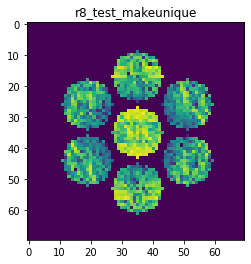

X_sim.max(): 0.9291189899917353
nlogf_X_sim.max(): 6.835312524190553
>>>replaced the 64. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 405ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 295ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 298ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


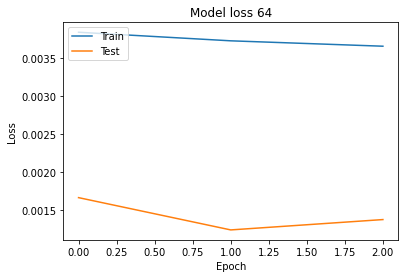

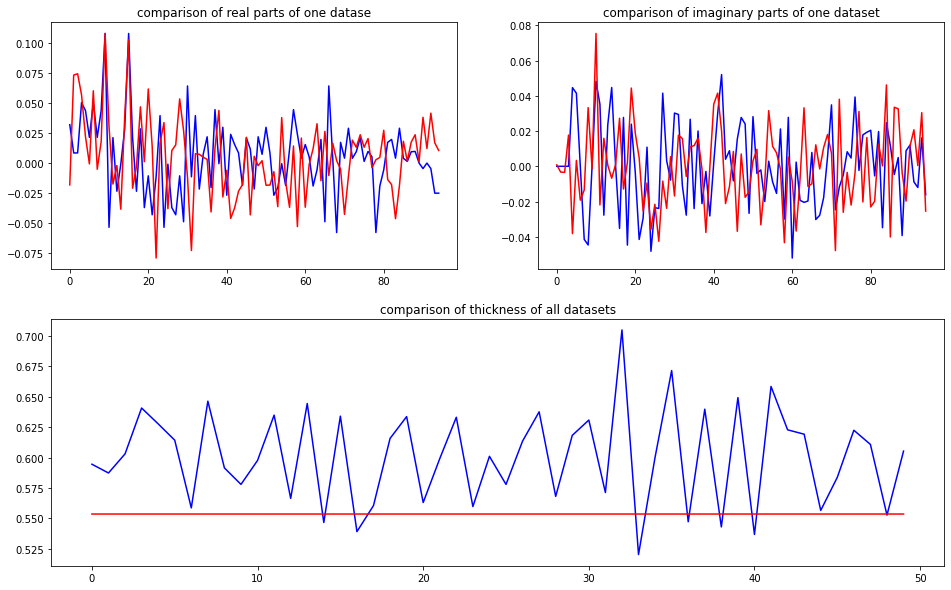

predicted thickness: 0.55363625


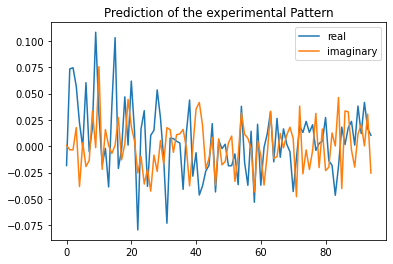

Applied shift of unit cell origin (fractional coordinates): 0.001795993070756169 -0.04857002410041305 -0.00017308140960167994
Ug[ 0 ]: 0.01826 3.14159  =>  0.01826 3.14159
Ug[ 1 ]: 0.07397 0.00109  =>  0.07397 0.0
Ug[ 2 ]: 0.07397 -0.00109  =>  0.07397 0.0
Ug[ 3 ]: 0.06141 0.30517  =>  0.06141 0.0
Ug[ 4 ]: 0.04093 -1.06131  =>  0.04093 -1.36757
Ug[ 5 ]: 0.00892 1.91206  =>  0.00892 1.60797
Ug[ 6 ]: 0.06141 -0.30517  =>  0.06141 0.0
Ug[ 7 ]: 0.00892 -1.91206  =>  0.00892 -1.60797
Ug[ 8 ]: 0.04093 1.06131  =>  0.04093 1.36757
Ug[ 9 ]: 0.10569 -0.01128  =>  0.10569 -0.0
Ug[ 10 ]: 0.06426 1.04689  =>  0.06426 1.05709
Ug[ 11 ]: 0.03126 -2.23597  =>  0.03126 -2.2236
Ug[ 12 ]: 0.0146 1.74323  =>  0.0146 2.05969
Ug[ 13 ]: 0.03986 2.85911  =>  0.03986 -3.1087
Ug[ 14 ]: 0.04304 -0.1044  =>  0.04304 0.21315
Ug[ 15 ]: 0.10569 0.01128  =>  0.10569 0.0
Ug[ 16 ]: 0.03126 2.23597  =>  0.03126 2.2236
Ug[ 17 ]: 0.0146 -1.74323  =>  0.0146 -2.05969
Ug[ 18 ]: 0.04304 0.1044  =>  0.04304 -0.21315
Ug[ 19 ]:

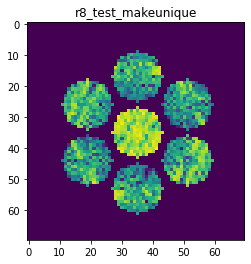

X_sim.max(): 0.9305734348829795
nlogf_X_sim.max(): 6.836875022020719
>>>replaced the 65. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 404ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 296ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 287ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000


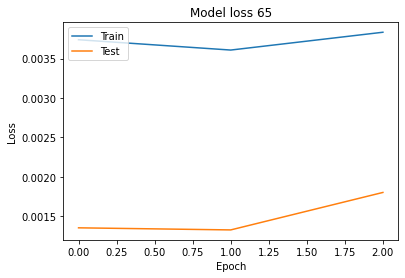

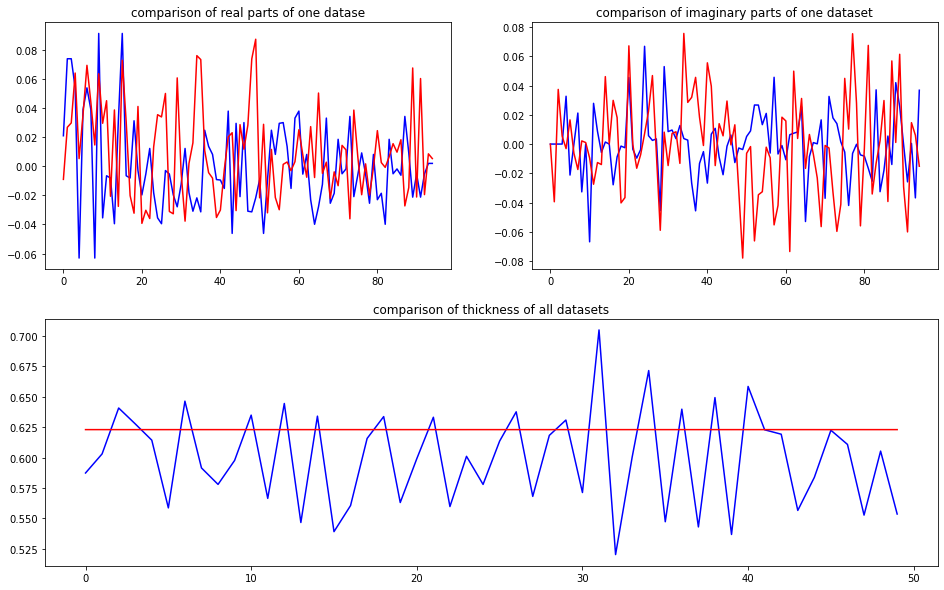

predicted thickness: 0.6230464


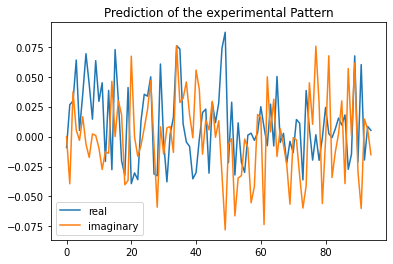

Applied shift of unit cell origin (fractional coordinates): -0.0012590754171131224 -0.013975154857740625 0.14940860348846005
Ug[ 0 ]: 0.00912 3.14159  =>  0.00912 3.14159
Ug[ 1 ]: 0.0476 -0.93876  =>  0.0476 -0.0
Ug[ 2 ]: 0.0476 0.93876  =>  0.0476 0.0
Ug[ 3 ]: 0.06674 0.08781  =>  0.06674 -0.0
Ug[ 4 ]: 0.01017 -0.26219  =>  0.01017 0.58876
Ug[ 5 ]: 0.04296 0.40566  =>  0.04296 -0.62091
Ug[ 6 ]: 0.06674 -0.08781  =>  0.06674 0.0
Ug[ 7 ]: 0.04296 -0.40566  =>  0.04296 0.62091
Ug[ 8 ]: 0.01017 0.26219  =>  0.01017 -0.58876
Ug[ 9 ]: 0.06795 0.00791  =>  0.06795 0.0
Ug[ 10 ]: 0.03338 -0.2508  =>  0.03338 0.68005
Ug[ 11 ]: 0.04725 -0.65191  =>  0.04725 -1.59858
Ug[ 12 ]: 0.02563 -2.49741  =>  0.02563 -2.41751
Ug[ 13 ]: 0.04044 -0.46582  =>  0.04044 0.55284
Ug[ 14 ]: 0.05256 2.1783  =>  0.05256 1.31943
Ug[ 15 ]: 0.06795 -0.00791  =>  0.06795 0.0
Ug[ 16 ]: 0.04725 0.65191  =>  0.04725 1.59858
Ug[ 17 ]: 0.02563 2.49741  =>  0.02563 2.41751
Ug[ 18 ]: 0.05256 -2.1783  =>  0.05256 -1.31943
Ug[ 19

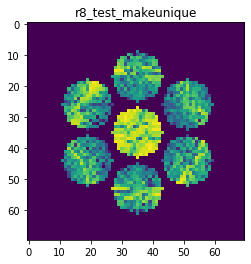

X_sim.max(): 0.8852303654322196
nlogf_X_sim.max(): 6.786976922940518
>>>replaced the 66. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 375ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 282ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 282ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


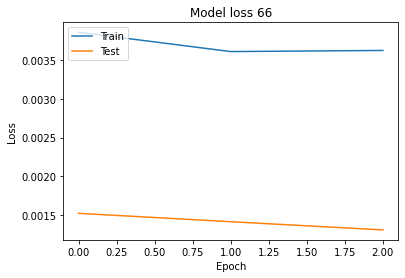

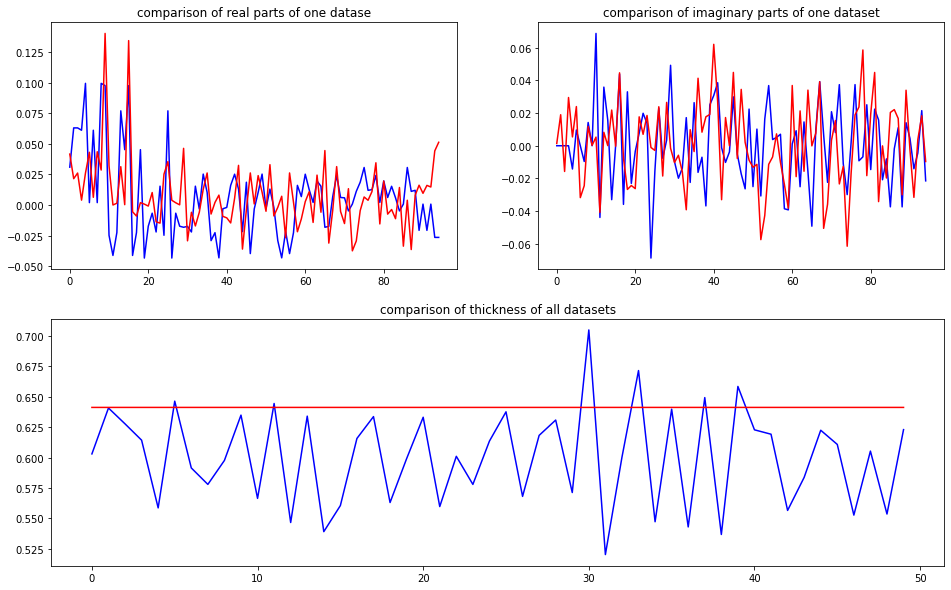

predicted thickness: 0.64131266


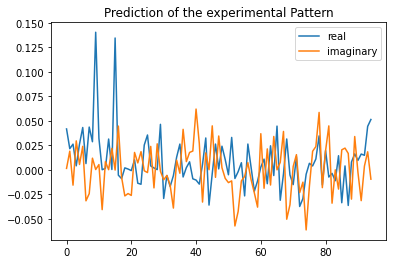

Applied shift of unit cell origin (fractional coordinates): -0.0003410911282125666 -0.22320048415581561 -0.09994670392539952
Ug[ 0 ]: 0.0418 0.0  =>  0.0418 0.0
Ug[ 1 ]: 0.02955 0.62798  =>  0.02955 0.0
Ug[ 2 ]: 0.02955 -0.62798  =>  0.02955 -0.0
Ug[ 3 ]: 0.03106 1.40241  =>  0.03106 -0.0
Ug[ 4 ]: 0.02764 -0.1167  =>  0.02764 -2.14709
Ug[ 5 ]: 0.0498 0.50778  =>  0.0498 -0.26665
Ug[ 6 ]: 0.03106 -1.40241  =>  0.03106 0.0
Ug[ 7 ]: 0.0498 -0.50778  =>  0.0498 0.26665
Ug[ 8 ]: 0.02764 0.1167  =>  0.02764 2.14709
Ug[ 9 ]: 0.13842 0.00214  =>  0.13842 -0.0
Ug[ 10 ]: 0.0289 0.11066  =>  0.0289 -0.51946
Ug[ 11 ]: 0.04279 -1.63334  =>  0.04279 -1.0075
Ug[ 12 ]: 0.00881 2.01612  =>  0.00881 -2.8668
Ug[ 13 ]: 0.03354 0.04376  =>  0.03354 0.81604
Ug[ 14 ]: 0.02432 1.52464  =>  0.02432 -2.7303
Ug[ 15 ]: 0.13842 -0.00214  =>  0.13842 0.0
Ug[ 16 ]: 0.04279 1.63334  =>  0.04279 1.0075
Ug[ 17 ]: 0.00881 -2.01612  =>  0.00881 2.8668
Ug[ 18 ]: 0.02432 -1.52464  =>  0.02432 2.7303
Ug[ 19 ]: 0.02421 -1.47

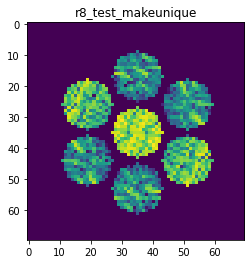

X_sim.max(): 0.9196075172193848
nlogf_X_sim.max(): 6.82503379691507
>>>replaced the 67. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 405ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 305ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 300ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000


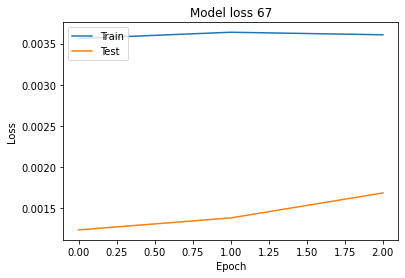

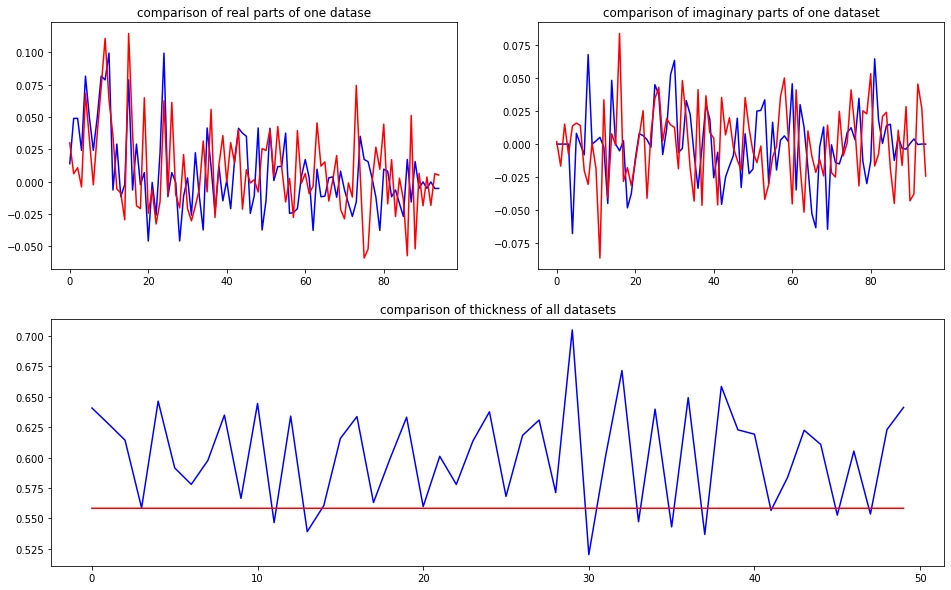

predicted thickness: 0.55837095


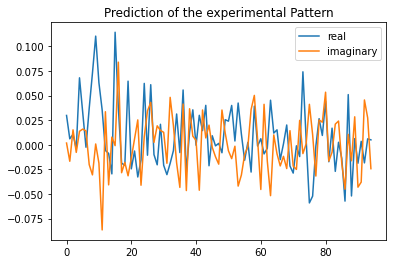

Applied shift of unit cell origin (fractional coordinates): -0.001158260653142468 0.29672266937461045 0.17292451297604652
Ug[ 0 ]: 0.02989 0.0  =>  0.02989 0.0
Ug[ 1 ]: 0.01806 -1.08652  =>  0.01806 0.0
Ug[ 2 ]: 0.01806 1.08652  =>  0.01806 0.0
Ug[ 3 ]: 0.01142 -1.86436  =>  0.01142 -0.0
Ug[ 4 ]: 0.07411 0.30338  =>  0.07411 -3.02892
Ug[ 5 ]: 0.03942 0.47581  =>  0.03942 1.25366
Ug[ 6 ]: 0.01142 1.86436  =>  0.01142 0.0
Ug[ 7 ]: 0.03942 -0.47581  =>  0.03942 -1.25366
Ug[ 8 ]: 0.07411 -0.30338  =>  0.07411 3.02892
Ug[ 9 ]: 0.11309 0.00728  =>  0.11309 0.0
Ug[ 10 ]: 0.06439 -0.21029  =>  0.06439 0.86895
Ug[ 11 ]: 0.09299 -1.16195  =>  0.09299 -2.25574
Ug[ 12 ]: 0.03331 1.9444  =>  0.03331 0.07276
Ug[ 13 ]: 0.03885 -1.82168  =>  0.03885 -2.60681
Ug[ 14 ]: 0.0283 2.67012  =>  0.0283 -0.28804
Ug[ 15 ]: 0.11309 -0.00728  =>  0.11309 0.0
Ug[ 16 ]: 0.09299 1.16195  =>  0.09299 2.25574
Ug[ 17 ]: 0.03331 -1.9444  =>  0.03331 -0.07276
Ug[ 18 ]: 0.0283 -2.67012  =>  0.0283 0.28804
Ug[ 19 ]: 0.0733

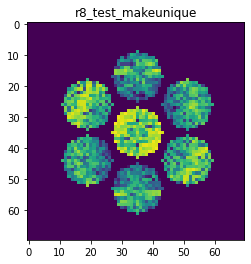

X_sim.max(): 0.9777727876915333
nlogf_X_sim.max(): 6.886299529477438
>>>replaced the 68. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 353ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 272ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 271ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000


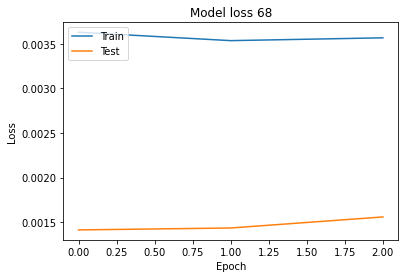

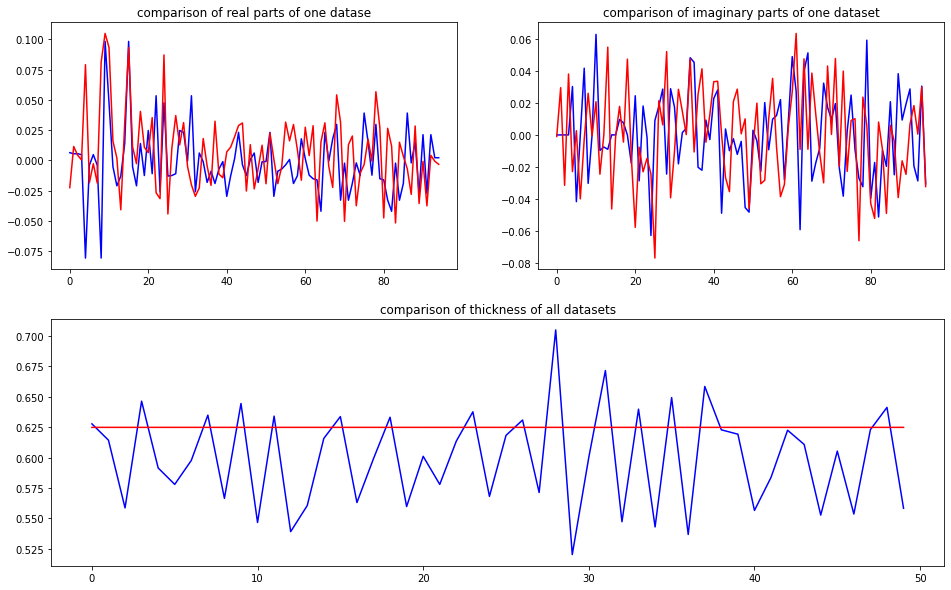

predicted thickness: 0.62490517


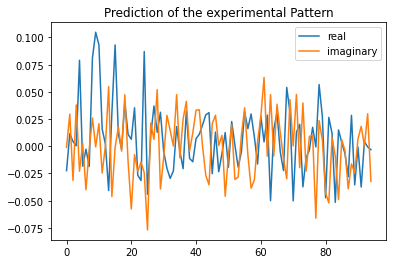

Applied shift of unit cell origin (fractional coordinates): -0.0006015155301763117 -0.2541564751690794 -0.20902999763694674
Ug[ 0 ]: 0.02239 3.14159  =>  0.02239 3.14159
Ug[ 1 ]: 0.03151 1.31337  =>  0.03151 0.0
Ug[ 2 ]: 0.03151 -1.31337  =>  0.03151 -0.0
Ug[ 3 ]: 0.03898 1.59691  =>  0.03898 -0.0
Ug[ 4 ]: 0.08412 -0.29489  =>  0.08412 3.07801
Ug[ 5 ]: 0.01863 2.99851  =>  0.01863 2.71497
Ug[ 6 ]: 0.03898 -1.59691  =>  0.03898 0.0
Ug[ 7 ]: 0.01863 -2.99851  =>  0.01863 -2.71497
Ug[ 8 ]: 0.08412 0.29489  =>  0.08412 -3.07801
Ug[ 9 ]: 0.09947 0.00378  =>  0.09947 0.0
Ug[ 10 ]: 0.09333 0.24438  =>  0.09333 -1.07277
Ug[ 11 ]: 0.02518 -0.99668  =>  0.02518 0.31291
Ug[ 12 ]: 0.00231 1.70268  =>  0.00231 -2.98738
Ug[ 13 ]: 0.07808 2.14024  =>  0.07808 2.42
Ug[ 14 ]: 0.0589 -0.91812  =>  0.0589 1.98838
Ug[ 15 ]: 0.09947 -0.00378  =>  0.09947 -0.0
Ug[ 16 ]: 0.02518 0.99668  =>  0.02518 -0.31291
Ug[ 17 ]: 0.00231 -1.70268  =>  0.00231 2.98738
Ug[ 18 ]: 0.0589 0.91812  =>  0.0589 -1.98838
Ug[ 19 

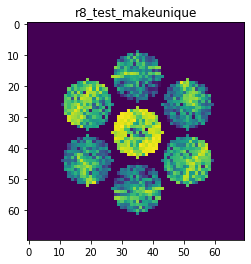

X_sim.max(): 0.9085244356788174
nlogf_X_sim.max(): 6.81292186475374
>>>replaced the 69. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 365ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 294ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 287ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


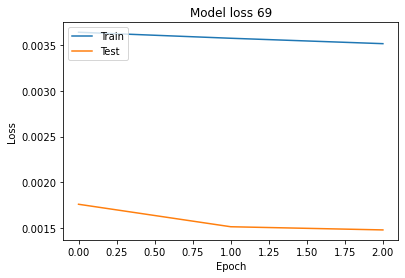

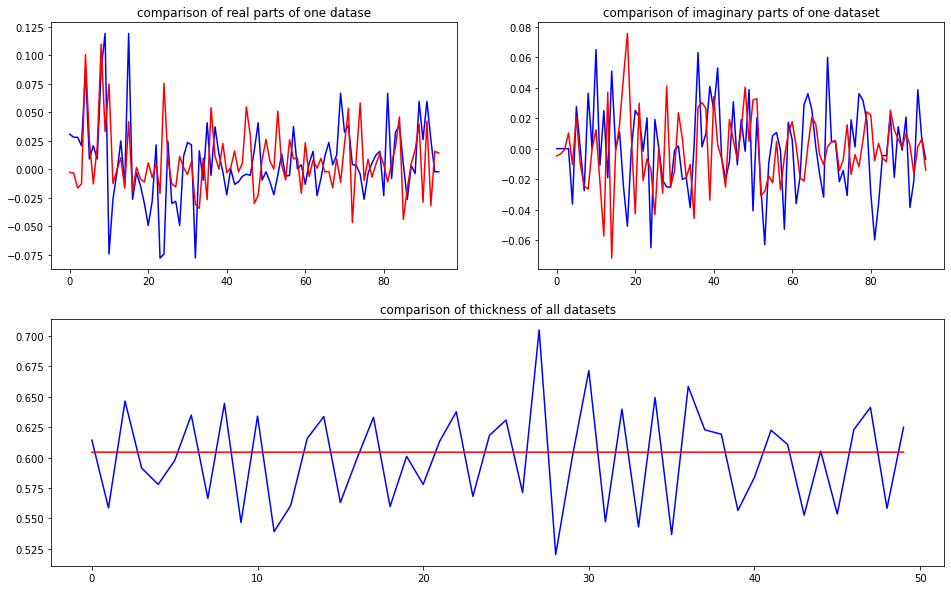

predicted thickness: 0.6045289


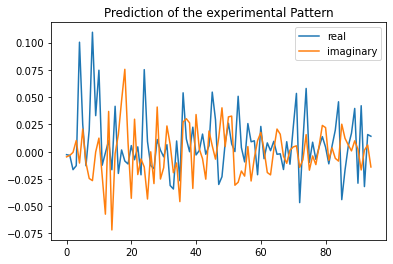

Applied shift of unit cell origin (fractional coordinates): -0.0032431990302313565 -0.39299687852378096 0.4779585131524158
Ug[ 0 ]: 0.00274 3.14159  =>  0.00274 3.14159
Ug[ 1 ]: 0.01005 -3.0031  =>  0.01005 0.0
Ug[ 2 ]: 0.01005 3.0031  =>  0.01005 -0.0
Ug[ 3 ]: 0.01646 2.46927  =>  0.01646 -0.0
Ug[ 4 ]: 0.10511 0.07692  =>  0.10511 0.61075
Ug[ 5 ]: 0.0319 0.78697  =>  0.0319 1.59778
Ug[ 6 ]: 0.01646 -2.46927  =>  0.01646 0.0
Ug[ 7 ]: 0.0319 -0.78697  =>  0.0319 -1.59778
Ug[ 8 ]: 0.10511 -0.07692  =>  0.10511 -0.61075
Ug[ 9 ]: 0.03732 0.02038  =>  0.03732 0.0
Ug[ 10 ]: 0.07605 0.17518  =>  0.07605 -3.12528
Ug[ 11 ]: 0.02481 -2.28283  =>  0.02481 0.97688
Ug[ 12 ]: 0.05208 -1.56625  =>  0.05208 0.88264
Ug[ 13 ]: 0.04131 1.33328  =>  0.04131 0.50209
Ug[ 14 ]: 0.07469 -1.74064  =>  0.07469 -2.29484
Ug[ 15 ]: 0.03732 -0.02038  =>  0.03732 0.0
Ug[ 16 ]: 0.02481 2.28283  =>  0.02481 -0.97688
Ug[ 17 ]: 0.05208 1.56625  =>  0.05208 -0.88264
Ug[ 18 ]: 0.07469 1.74064  =>  0.07469 2.29484
Ug[ 19 ]

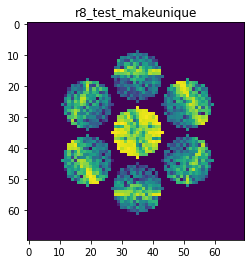

X_sim.max(): 0.957934854017163
nlogf_X_sim.max(): 6.865823141415598
>>>replaced the 70. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 378ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 300ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 283ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


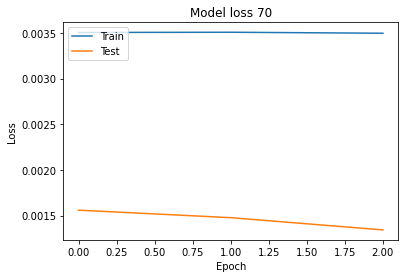

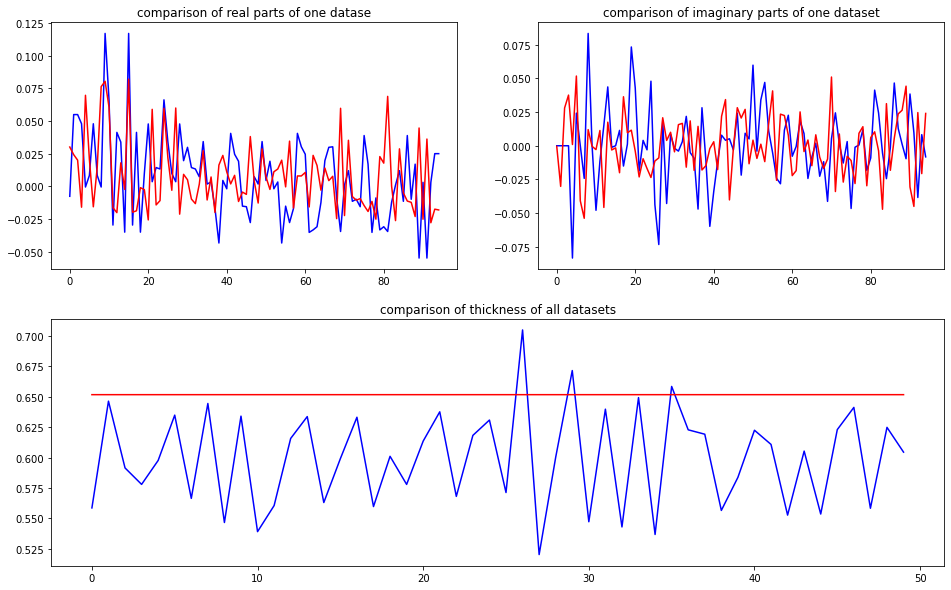

predicted thickness: 0.6517898


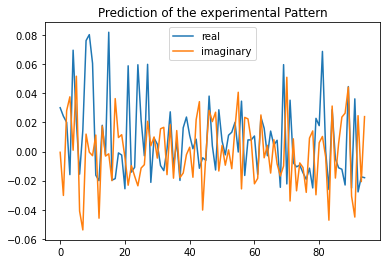

Applied shift of unit cell origin (fractional coordinates): -0.001108132542521787 -0.31066025209505005 0.14648245532667772
Ug[ 0 ]: 0.0301 0.0  =>  0.0301 0.0
Ug[ 1 ]: 0.0366 -0.92038  =>  0.0366 -0.0
Ug[ 2 ]: 0.0366 0.92038  =>  0.0366 0.0
Ug[ 3 ]: 0.04229 1.95194  =>  0.04229 -0.0
Ug[ 4 ]: 0.07311 -0.07566  =>  0.07311 -1.10722
Ug[ 5 ]: 0.05568 1.24859  =>  0.05568 -1.62372
Ug[ 6 ]: 0.04229 -1.95194  =>  0.04229 0.0
Ug[ 7 ]: 0.05568 -1.24859  =>  0.05568 1.62372
Ug[ 8 ]: 0.07311 0.07566  =>  0.07311 1.10722
Ug[ 9 ]: 0.08111 0.00696  =>  0.08111 0.0
Ug[ 10 ]: 0.06099 0.17058  =>  0.06099 1.08399
Ug[ 11 ]: 0.02386 2.42428  =>  0.02386 1.49695
Ug[ 12 ]: 0.04542 -2.01044  =>  0.04542 -0.06546
Ug[ 13 ]: 0.02456 0.62771  =>  0.02456 -2.79012
Ug[ 14 ]: 0.00658 -1.81957  =>  0.00658 -0.79497
Ug[ 15 ]: 0.08111 -0.00696  =>  0.08111 0.0
Ug[ 16 ]: 0.02386 -2.42428  =>  0.02386 -1.49695
Ug[ 17 ]: 0.04542 2.01044  =>  0.04542 0.06546
Ug[ 18 ]: 0.00658 1.81957  =>  0.00658 0.79497
Ug[ 19 ]: 0.0106

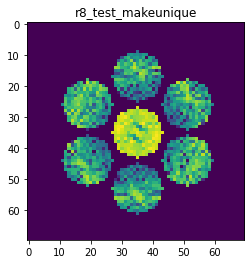

X_sim.max(): 0.9585629987393649
nlogf_X_sim.max(): 6.866477971176023
>>>replaced the 71. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 396ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 296ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 277ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


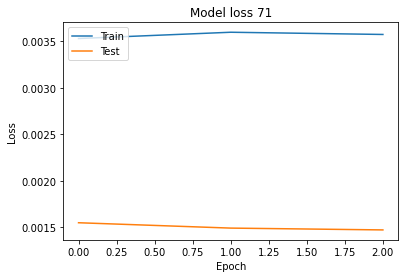

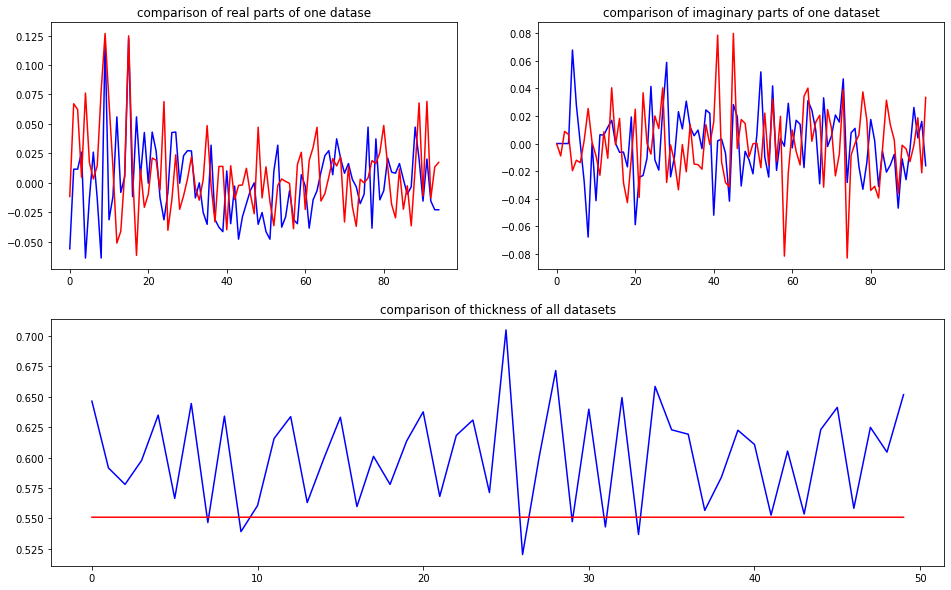

predicted thickness: 0.5510088


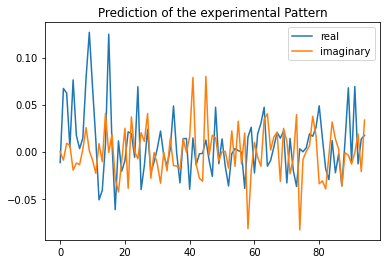

Applied shift of unit cell origin (fractional coordinates): -0.0011319183926235684 -0.19163517480113712 0.021746476626113776
Ug[ 0 ]: 0.01163 3.14159  =>  0.01163 3.14159
Ug[ 1 ]: 0.06536 -0.13664  =>  0.06536 -0.0
Ug[ 2 ]: 0.06536 0.13664  =>  0.06536 0.0
Ug[ 3 ]: 0.011 1.20408  =>  0.011 -0.0
Ug[ 4 ]: 0.08067 -0.28375  =>  0.08067 -1.35119
Ug[ 5 ]: 0.01745 -0.43166  =>  0.01745 -1.77237
Ug[ 6 ]: 0.011 -1.20408  =>  0.011 0.0
Ug[ 7 ]: 0.01745 0.43166  =>  0.01745 1.77237
Ug[ 8 ]: 0.08067 0.28375  =>  0.08067 1.35119
Ug[ 9 ]: 0.12613 0.00711  =>  0.12613 -0.0
Ug[ 10 ]: 0.06874 -0.00943  =>  0.06874 0.1201
Ug[ 11 ]: 0.02353 -1.06965  =>  0.02353 -1.21339
Ug[ 12 ]: 0.05936 2.82568  =>  0.05936 -2.26054
Ug[ 13 ]: 0.04356 -2.78102  =>  0.04356 -1.44742
Ug[ 14 ]: 0.04291 1.33483  =>  0.04291 2.39516
Ug[ 15 ]: 0.12613 -0.00711  =>  0.12613 0.0
Ug[ 16 ]: 0.02353 1.06965  =>  0.02353 1.21339
Ug[ 17 ]: 0.05936 -2.82568  =>  0.05936 2.26054
Ug[ 18 ]: 0.04291 -1.33483  =>  0.04291 -2.39516
Ug[ 19

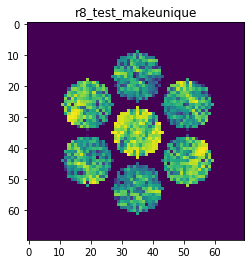

X_sim.max(): 0.8710045877859643
nlogf_X_sim.max(): 6.7707946851175755
>>>replaced the 72. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 404ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 307ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 287ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


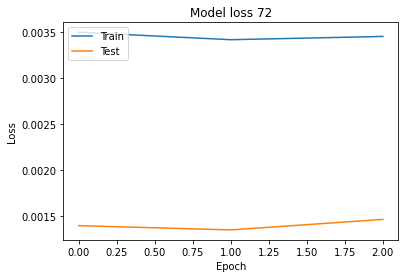

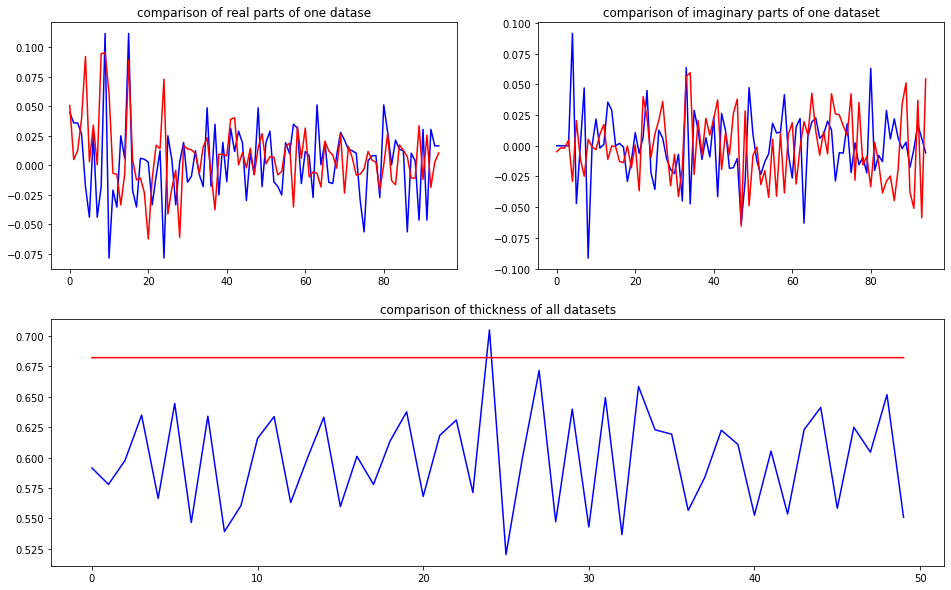

predicted thickness: 0.6822389


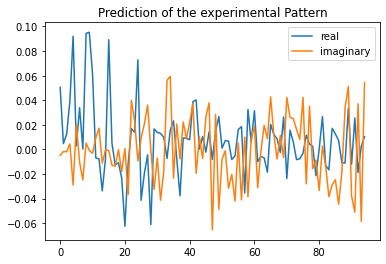

Applied shift of unit cell origin (fractional coordinates): 8.737318580911105e-05 -0.031879827607539775 -0.0009569204995549925
Ug[ 0 ]: 0.05062 0.0  =>  0.05062 0.0
Ug[ 1 ]: 0.00851 0.00601  =>  0.00851 0.0
Ug[ 2 ]: 0.00851 -0.00601  =>  0.00851 0.0
Ug[ 3 ]: 0.03745 0.20031  =>  0.03745 0.0
Ug[ 4 ]: 0.09523 -0.18043  =>  0.09523 -0.38675
Ug[ 5 ]: 0.02264 1.49954  =>  0.02264 1.30525
Ug[ 6 ]: 0.03745 -0.20031  =>  0.03745 0.0
Ug[ 7 ]: 0.02264 -1.49954  =>  0.02264 -1.30525
Ug[ 8 ]: 0.09523 0.18043  =>  0.09523 0.38675
Ug[ 9 ]: 0.09269 -0.00055  =>  0.09269 0.0
Ug[ 10 ]: 0.06728 0.04559  =>  0.06728 0.04012
Ug[ 11 ]: 0.01118 1.66034  =>  0.01118 1.6669
Ug[ 12 ]: 0.01847 2.1486  =>  0.01847 2.34945
Ug[ 13 ]: 0.03884 -2.87419  =>  0.03884 -2.67935
Ug[ 14 ]: 0.00922 -3.13881  =>  0.00922 -2.93194
Ug[ 15 ]: 0.09269 0.00055  =>  0.09269 0.0
Ug[ 16 ]: 0.01118 -1.66034  =>  0.01118 -1.6669
Ug[ 17 ]: 0.01847 -2.1486  =>  0.01847 -2.34945
Ug[ 18 ]: 0.00922 3.13881  =>  0.00922 2.93194
Ug[ 19 ]: 0

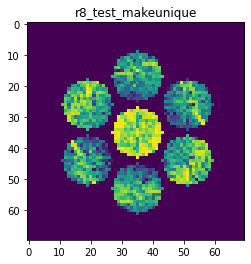

X_sim.max(): 0.8345439978598174
nlogf_X_sim.max(): 6.7280830071633755
>>>replaced the 73. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 355ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 271ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 270ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


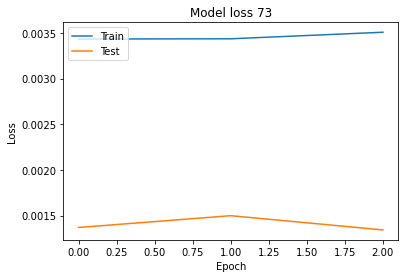

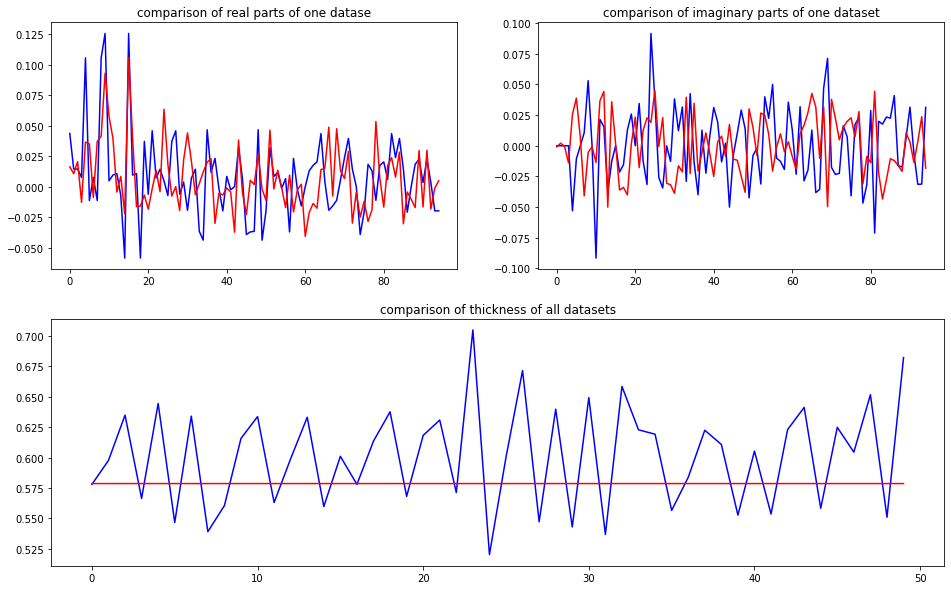

predicted thickness: 0.57868856


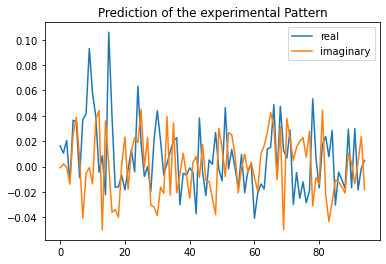

Applied shift of unit cell origin (fractional coordinates): 0.0019619743311064244 0.37889431771233734 -0.013670061753910128
Ug[ 0 ]: 0.01627 0.0  =>  0.01627 0.0
Ug[ 1 ]: 0.01562 0.08589  =>  0.01562 0.0
Ug[ 2 ]: 0.01562 -0.08589  =>  0.01562 0.0
Ug[ 3 ]: 0.01503 -2.38066  =>  0.01503 0.0
Ug[ 4 ]: 0.04195 0.37948  =>  0.04195 2.67425
Ug[ 5 ]: 0.05372 0.83544  =>  0.05372 -2.98119
Ug[ 6 ]: 0.01503 2.38066  =>  0.01503 -0.0
Ug[ 7 ]: 0.05372 -0.83544  =>  0.05372 2.98119
Ug[ 8 ]: 0.04195 -0.37948  =>  0.04195 -2.67425
Ug[ 9 ]: 0.09962 -0.01233  =>  0.09962 0.0
Ug[ 10 ]: 0.06265 -0.26447  =>  0.06265 -0.33804
Ug[ 11 ]: 0.05405 0.73756  =>  0.05405 0.83578
Ug[ 12 ]: 0.04047 1.83133  =>  0.04047 -0.53701
Ug[ 13 ]: 0.04927 -1.2972  =>  0.04927 2.53176
Ug[ 14 ]: 0.04247 2.03626  =>  0.04247 -0.24618
Ug[ 15 ]: 0.09962 0.01233  =>  0.09962 -0.0
Ug[ 16 ]: 0.05405 -0.73756  =>  0.05405 -0.83578
Ug[ 17 ]: 0.04047 -1.83133  =>  0.04047 0.53701
Ug[ 18 ]: 0.04247 -2.03626  =>  0.04247 0.24618
Ug[ 19 ]

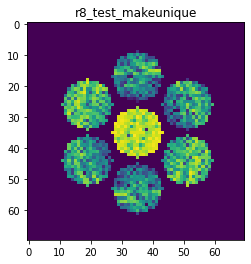

X_sim.max(): 0.8873094575488519
nlogf_X_sim.max(): 6.789320170514939
>>>replaced the 74. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 365ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 267ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 267ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000


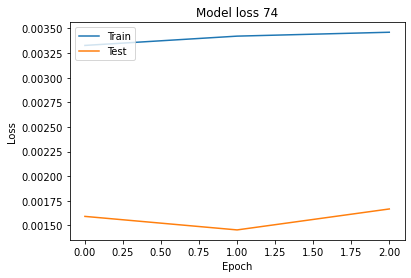

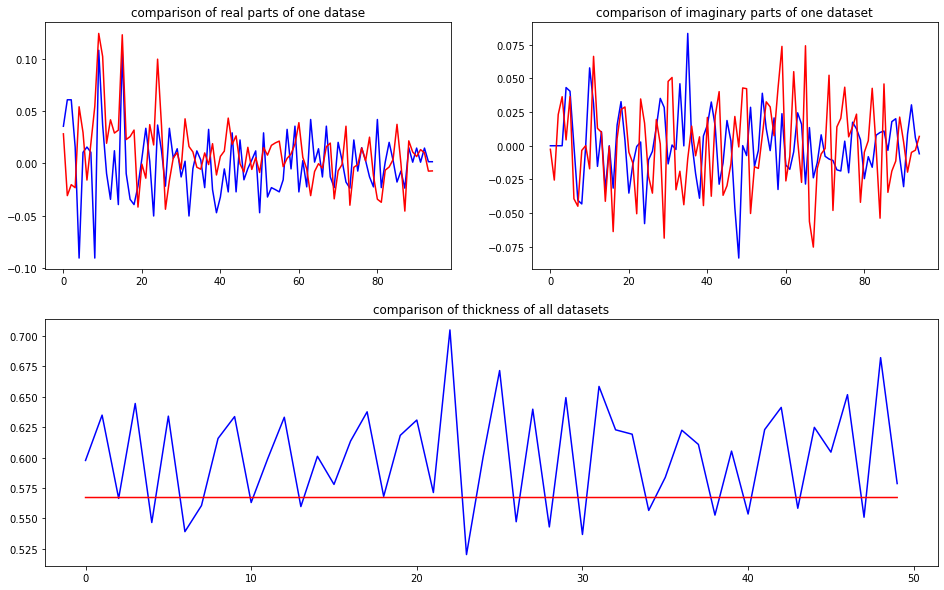

predicted thickness: 0.5672186


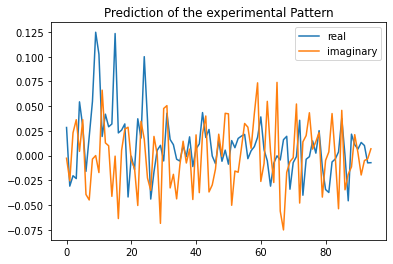

Applied shift of unit cell origin (fractional coordinates): -0.00037123128066616796 -0.32570916014709894 0.3790030021950635
Ug[ 0 ]: 0.02849 0.0  =>  0.02849 0.0
Ug[ 1 ]: 0.03522 -2.38135  =>  0.03522 -0.0
Ug[ 2 ]: 0.03522 2.38135  =>  0.03522 0.0
Ug[ 3 ]: 0.04253 2.04649  =>  0.04253 -0.0
Ug[ 4 ]: 0.05483 0.07107  =>  0.05483 0.40592
Ug[ 5 ]: 0.04744 1.02734  =>  0.04744 2.88268
Ug[ 6 ]: 0.04253 -2.04649  =>  0.04253 0.0
Ug[ 7 ]: 0.04744 -1.02734  =>  0.04744 -2.88268
Ug[ 8 ]: 0.05483 -0.07107  =>  0.05483 -0.40592
Ug[ 9 ]: 0.12468 0.00233  =>  0.12468 0.0
Ug[ 10 ]: 0.10314 -0.16481  =>  0.10314 2.21421
Ug[ 11 ]: 0.06834 1.25289  =>  0.06834 -1.13079
Ug[ 12 ]: 0.03415 0.11256  =>  0.03415 2.15672
Ug[ 13 ]: 0.0366 0.46176  =>  0.0366 -1.39592
Ug[ 14 ]: 0.04675 -0.81331  =>  0.04675 -1.1505
Ug[ 15 ]: 0.12468 -0.00233  =>  0.12468 0.0
Ug[ 16 ]: 0.06834 -1.25289  =>  0.06834 1.13079
Ug[ 17 ]: 0.03415 -0.11256  =>  0.03415 -2.15672
Ug[ 18 ]: 0.04675 0.81331  =>  0.04675 1.1505
Ug[ 19 ]: 0.

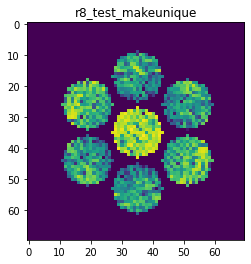

X_sim.max(): 0.9642819268487727
nlogf_X_sim.max(): 6.8724202108457435
>>>replaced the 75. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 384ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 292ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 292ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


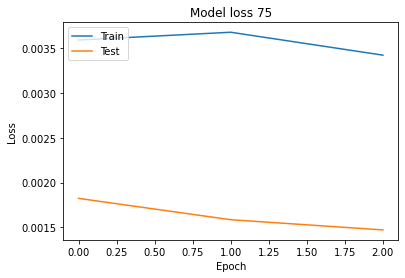

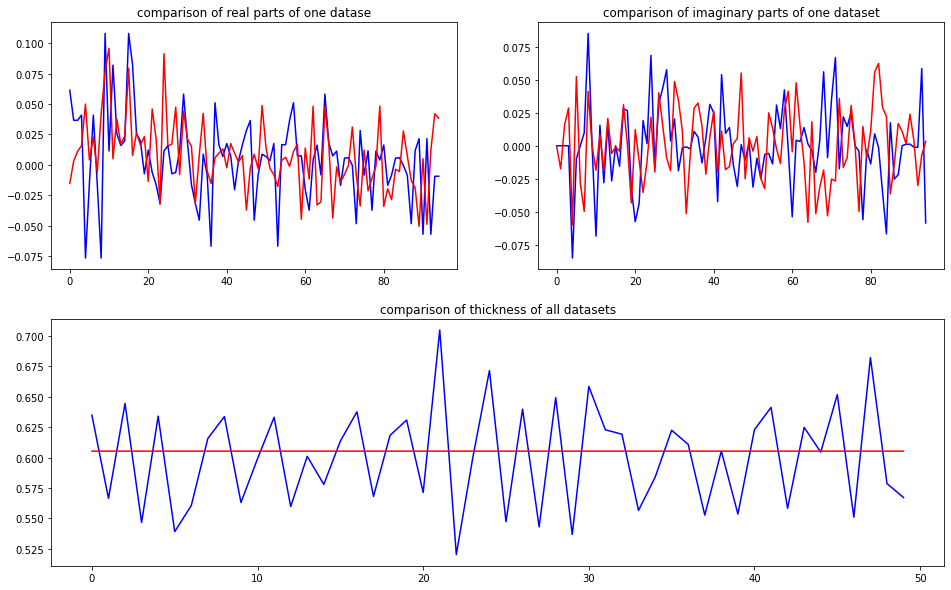

predicted thickness: 0.6053496


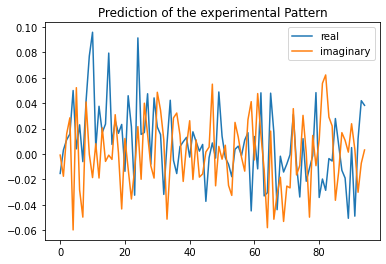

Applied shift of unit cell origin (fractional coordinates): -0.0007033270661734497 -0.15428034865592982 0.18507084024891482
Ug[ 0 ]: 0.01527 3.14159  =>  0.01527 3.14159
Ug[ 1 ]: 0.01813 -1.16283  =>  0.01813 -0.0
Ug[ 2 ]: 0.01813 1.16283  =>  0.01813 0.0
Ug[ 3 ]: 0.03433 0.96937  =>  0.03433 0.0
Ug[ 4 ]: 0.06821 -0.8287  =>  0.06821 -0.63524
Ug[ 5 ]: 0.05093 1.5871  =>  0.05093 -0.5451
Ug[ 6 ]: 0.03433 -0.96937  =>  0.03433 0.0
Ug[ 7 ]: 0.05093 -1.5871  =>  0.05093 0.5451
Ug[ 8 ]: 0.06821 0.8287  =>  0.06821 0.63524
Ug[ 9 ]: 0.07853 0.00442  =>  0.07853 0.0
Ug[ 10 ]: 0.09611 -0.20995  =>  0.09611 0.94847
Ug[ 11 ]: 0.00878 0.77746  =>  0.00878 -0.38979
Ug[ 12 ]: 0.04058 -0.66079  =>  0.04058 0.30416
Ug[ 13 ]: 0.02595 0.89493  =>  0.02595 3.02272
Ug[ 14 ]: 0.02025 -0.16682  =>  0.02025 -0.3647
Ug[ 15 ]: 0.07853 -0.00442  =>  0.07853 0.0
Ug[ 16 ]: 0.00878 -0.77746  =>  0.00878 0.38979
Ug[ 17 ]: 0.04058 0.66079  =>  0.04058 -0.30416
Ug[ 18 ]: 0.02025 0.16682  =>  0.02025 0.3647
Ug[ 19 ]: 

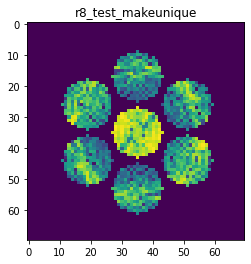

X_sim.max(): 0.9309814377709524
nlogf_X_sim.max(): 6.837312897932482
>>>replaced the 76. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 366ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 280ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 271ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


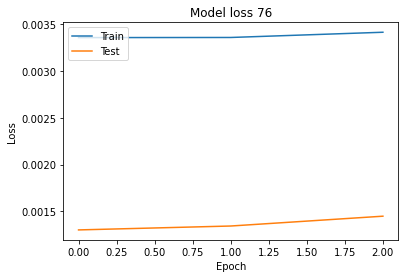

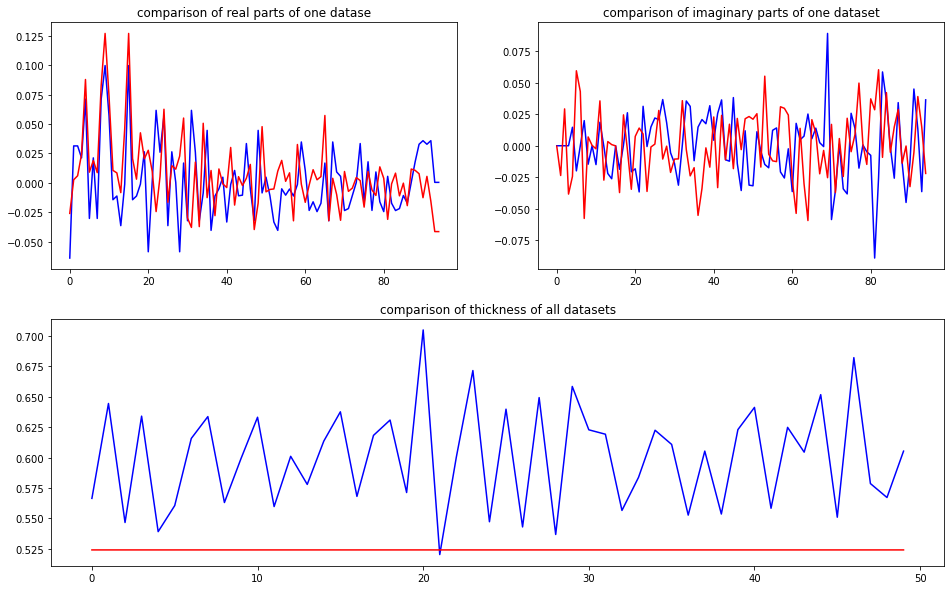

predicted thickness: 0.52412176


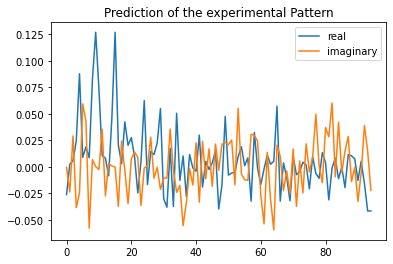

Applied shift of unit cell origin (fractional coordinates): -0.000262844925322731 0.17236708874069762 0.22451800167184055
Ug[ 0 ]: 0.02604 3.14159  =>  0.02604 3.14159
Ug[ 1 ]: 0.02676 -1.41069  =>  0.02676 -0.0
Ug[ 2 ]: 0.02676 1.41069  =>  0.02676 0.0
Ug[ 3 ]: 0.04604 -1.08301  =>  0.04604 0.0
Ug[ 4 ]: 0.08646 -0.18231  =>  0.08646 2.31139
Ug[ 5 ]: 0.05921 1.42294  =>  0.05921 1.09527
Ug[ 6 ]: 0.04604 1.08301  =>  0.04604 0.0
Ug[ 7 ]: 0.05921 -1.42294  =>  0.05921 -1.09527
Ug[ 8 ]: 0.08646 0.18231  =>  0.08646 -2.31139
Ug[ 9 ]: 0.12642 0.00165  =>  0.12642 0.0
Ug[ 10 ]: 0.06797 -0.01132  =>  0.06797 1.39771
Ug[ 11 ]: 0.03955 1.168  =>  0.03955 -0.24434
Ug[ 12 ]: 0.02652 -1.35294  =>  0.02652 -2.43761
Ug[ 13 ]: 0.0125 3.05995  =>  0.0125 -2.89721
Ug[ 14 ]: 0.04429 0.04552  =>  0.04429 -2.44984
Ug[ 15 ]: 0.12642 -0.00165  =>  0.12642 0.0
Ug[ 16 ]: 0.03955 -1.168  =>  0.03955 0.24434
Ug[ 17 ]: 0.02652 1.35294  =>  0.02652 2.43761
Ug[ 18 ]: 0.04429 -0.04552  =>  0.04429 2.44984
Ug[ 19 ]:

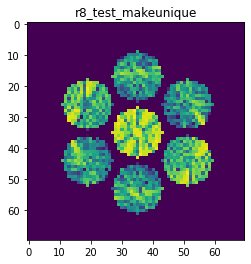

X_sim.max(): 0.8761247306739941
nlogf_X_sim.max(): 6.776649206516963
>>>replaced the 77. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 403ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 311ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 3s 325ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


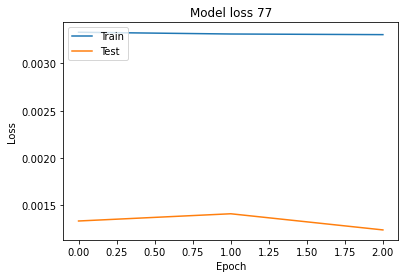

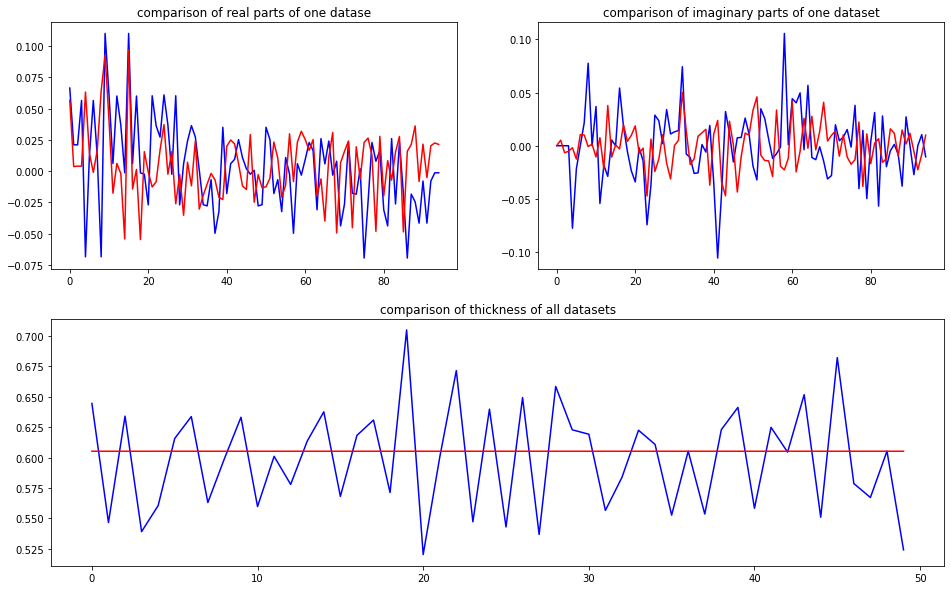

predicted thickness: 0.60527587


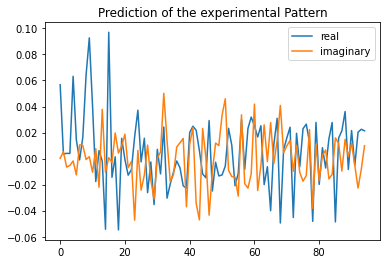

Applied shift of unit cell origin (fractional coordinates): -0.0006570847755101651 0.22141744630589927 -0.15938017859582518
Ug[ 0 ]: 0.05655 0.0  =>  0.05655 0.0
Ug[ 1 ]: 0.00702 1.00142  =>  0.00702 0.0
Ug[ 2 ]: 0.00702 -1.00142  =>  0.00702 0.0
Ug[ 3 ]: 0.00801 -1.39121  =>  0.00801 0.0
Ug[ 4 ]: 0.06353 -0.00899  =>  0.06353 0.3808
Ug[ 5 ]: 0.0191 -0.63363  =>  0.0191 1.75899
Ug[ 6 ]: 0.00801 1.39121  =>  0.00801 -0.0
Ug[ 7 ]: 0.0191 0.63363  =>  0.0191 -1.75899
Ug[ 8 ]: 0.06353 0.00899  =>  0.06353 -0.3808
Ug[ 9 ]: 0.09453 0.00413  =>  0.09453 0.0
Ug[ 10 ]: 0.03963 -0.21365  =>  0.03963 -1.2192
Ug[ 11 ]: 0.0169 2.82263  =>  0.0169 -2.46327
Ug[ 12 ]: 0.02117 -1.39489  =>  0.02117 -2.79022
Ug[ 13 ]: 0.0311 1.64484  =>  0.0311 -0.75191
Ug[ 14 ]: 0.05517 -3.00691  =>  0.05517 2.88235
Ug[ 15 ]: 0.09453 -0.00413  =>  0.09453 -0.0
Ug[ 16 ]: 0.0169 -2.82263  =>  0.0169 2.46327
Ug[ 17 ]: 0.02117 1.39489  =>  0.02117 2.79022
Ug[ 18 ]: 0.05517 3.00691  =>  0.05517 -2.88235
Ug[ 19 ]: 0.01918 0.

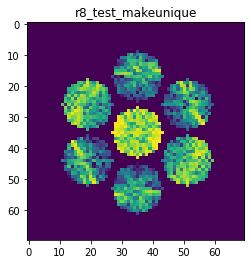

X_sim.max(): 0.8981604310726597
nlogf_X_sim.max(): 6.801461473581183
>>>replaced the 78. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 371ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 258ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 286ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


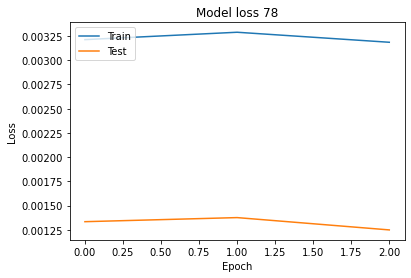

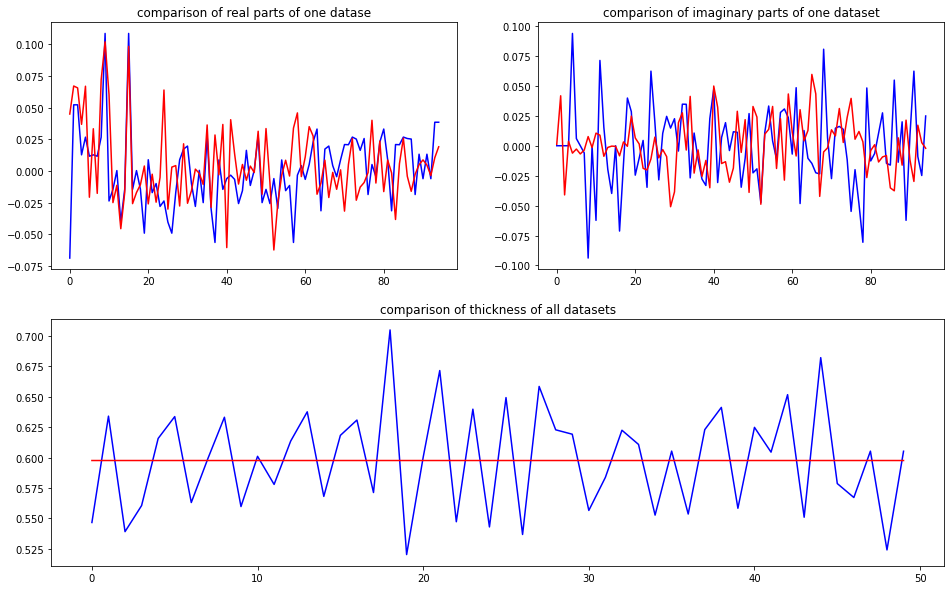

predicted thickness: 0.5976432


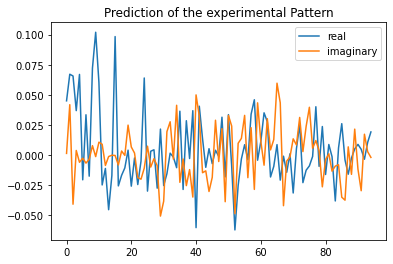

Applied shift of unit cell origin (fractional coordinates): 0.0007803828163272877 -0.023715264911551213 -0.08898127609796991
Ug[ 0 ]: 0.04487 0.0  =>  0.04487 0.0
Ug[ 1 ]: 0.07801 0.55909  =>  0.07801 0.0
Ug[ 2 ]: 0.07801 -0.55909  =>  0.07801 0.0
Ug[ 3 ]: 0.03541 0.14901  =>  0.03541 -0.0
Ug[ 4 ]: 0.06967 -0.09922  =>  0.06967 -0.80731
Ug[ 5 ]: 0.01925 3.11912  =>  0.01925 -2.75398
Ug[ 6 ]: 0.03541 -0.14901  =>  0.03541 0.0
Ug[ 7 ]: 0.01925 -3.11912  =>  0.01925 2.75398
Ug[ 8 ]: 0.06967 0.09922  =>  0.06967 0.80731
Ug[ 9 ]: 0.09986 -0.0049  =>  0.09986 0.0
Ug[ 10 ]: 0.06291 0.17217  =>  0.06291 -0.38201
Ug[ 11 ]: 0.02686 2.81446  =>  0.02686 -2.90473
Ug[ 12 ]: 0.01541 -2.74181  =>  0.01541 -2.58789
Ug[ 13 ]: 0.03817 -3.02803  =>  0.03817 2.84998
Ug[ 14 ]: 0.01401 3.13712  =>  0.01401 -2.43306
Ug[ 15 ]: 0.09986 0.0049  =>  0.09986 -0.0
Ug[ 16 ]: 0.02686 -2.81446  =>  0.02686 2.90473
Ug[ 17 ]: 0.01541 2.74181  =>  0.01541 2.58789
Ug[ 18 ]: 0.01401 -3.13712  =>  0.01401 2.43306
Ug[ 19 ]:

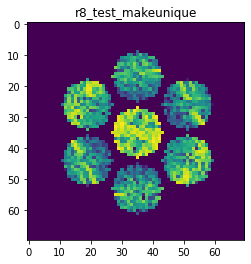

X_sim.max(): 0.9622996219239919
nlogf_X_sim.max(): 6.870364497283476
>>>replaced the 79. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 378ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 296ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 268ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


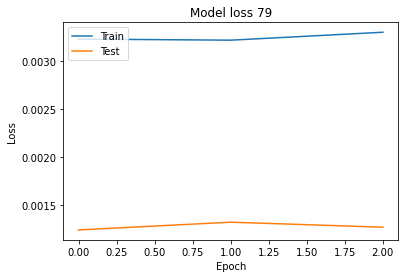

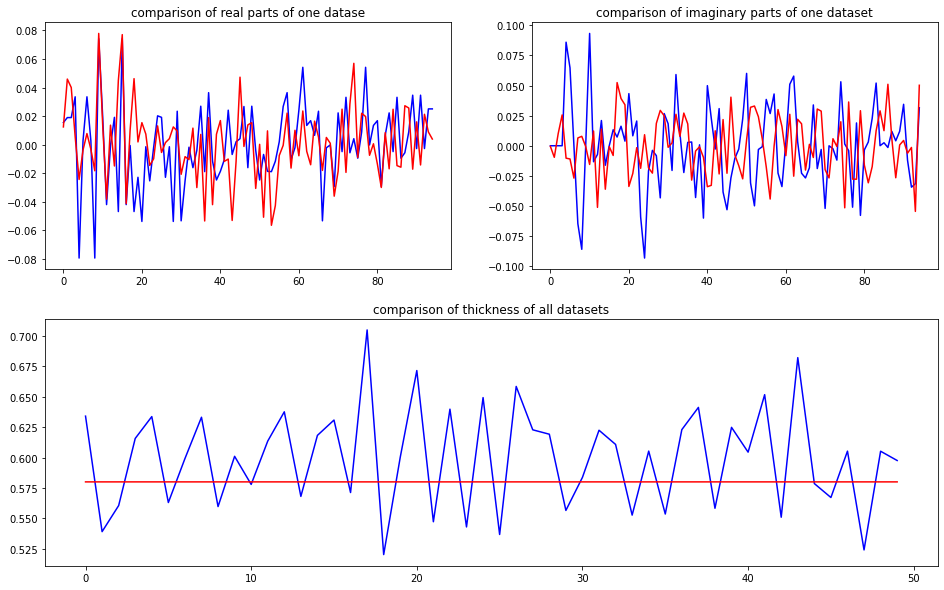

predicted thickness: 0.5800693


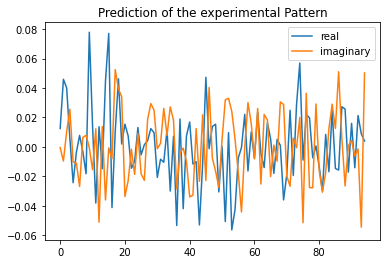

Applied shift of unit cell origin (fractional coordinates): -0.00010855784886547455 -0.21035998319371135 0.03614971913971624
Ug[ 0 ]: 0.01243 0.0  =>  0.01243 0.0
Ug[ 1 ]: 0.04414 -0.22714  =>  0.04414 -0.0
Ug[ 2 ]: 0.04414 0.22714  =>  0.04414 0.0
Ug[ 3 ]: 0.02707 1.32173  =>  0.02707 -0.0
Ug[ 4 ]: 0.02317 -2.73894  =>  0.02317 2.44965
Ug[ 5 ]: 0.00939 -1.94985  =>  0.00939 2.78447
Ug[ 6 ]: 0.02707 -1.32173  =>  0.02707 0.0
Ug[ 7 ]: 0.00939 1.94985  =>  0.00939 -2.78447
Ug[ 8 ]: 0.02317 2.73894  =>  0.02317 -2.44965
Ug[ 9 ]: 0.07756 0.00068  =>  0.07756 0.0
Ug[ 10 ]: 0.01854 -0.72926  =>  0.01854 -0.50281
Ug[ 11 ]: 0.04097 2.89098  =>  0.04097 2.66316
Ug[ 12 ]: 0.05319 -1.3442  =>  0.05319 -0.02315
Ug[ 13 ]: 0.01903 2.1353  =>  0.01903 -2.5997
Ug[ 14 ]: 0.05917 -0.69035  =>  0.05917 0.40356
Ug[ 15 ]: 0.07756 -0.00068  =>  0.07756 0.0
Ug[ 16 ]: 0.04097 -2.89098  =>  0.04097 -2.66316
Ug[ 17 ]: 0.05319 1.3442  =>  0.05319 0.02315
Ug[ 18 ]: 0.05917 0.69035  =>  0.05917 -0.40356
Ug[ 19 ]: 

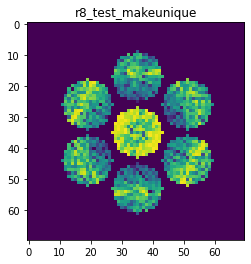

X_sim.max(): 0.8749203304780379
nlogf_X_sim.max(): 6.775275139857588
>>>replaced the 80. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 389ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 273ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 284ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000


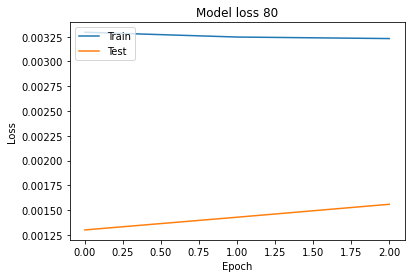

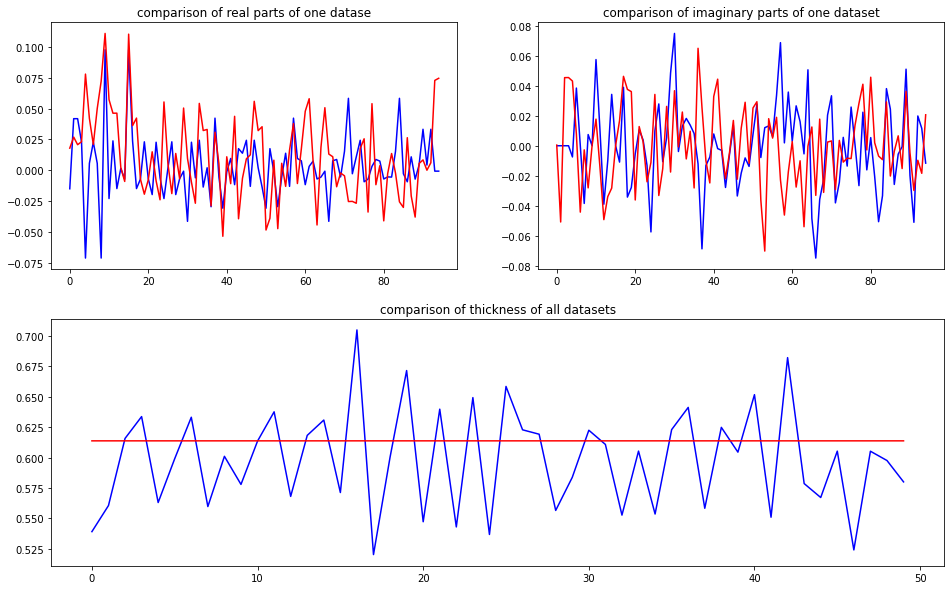

predicted thickness: 0.6138157


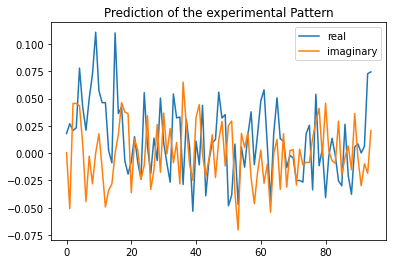

Applied shift of unit cell origin (fractional coordinates): 0.00011223514019286762 -0.17725411111158018 0.17686458611278866
Ug[ 0 ]: 0.01797 0.0  =>  0.01797 0.0
Ug[ 1 ]: 0.05375 -1.11127  =>  0.05375 0.0
Ug[ 2 ]: 0.05375 1.11127  =>  0.05375 0.0
Ug[ 3 ]: 0.05005 1.11372  =>  0.05005 -0.0
Ug[ 4 ]: 0.083 0.4439  =>  0.083 0.44145
Ug[ 5 ]: 0.04634 0.11481  =>  0.04634 -2.11019
Ug[ 6 ]: 0.05005 -1.11372  =>  0.05005 0.0
Ug[ 7 ]: 0.04634 -0.11481  =>  0.04634 2.11019
Ug[ 8 ]: 0.083 -0.4439  =>  0.083 -0.44145
Ug[ 9 ]: 0.11036 -0.00071  =>  0.11036 0.0
Ug[ 10 ]: 0.05808 0.2512  =>  0.05808 1.36318
Ug[ 11 ]: 0.044 -0.35886  =>  0.044 -1.46942
Ug[ 12 ]: 0.06516 -0.824  =>  0.06516 0.29043
Ug[ 13 ]: 0.03434 -1.45132  =>  0.03434 0.77438
Ug[ 14 ]: 0.0339 -1.80771  =>  0.0339 -1.80456
Ug[ 15 ]: 0.11036 0.00071  =>  0.11036 0.0
Ug[ 16 ]: 0.044 0.35886  =>  0.044 1.46942
Ug[ 17 ]: 0.06516 0.824  =>  0.06516 -0.29043
Ug[ 18 ]: 0.0339 1.80771  =>  0.0339 1.80456
Ug[ 19 ]: 0.03952 2.07186  =>  0.0395

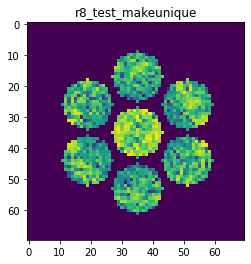

X_sim.max(): 0.8675651463281455
nlogf_X_sim.max(): 6.766842593032857
>>>replaced the 81. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 370ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 275ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 268ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


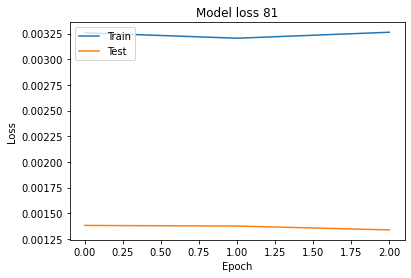

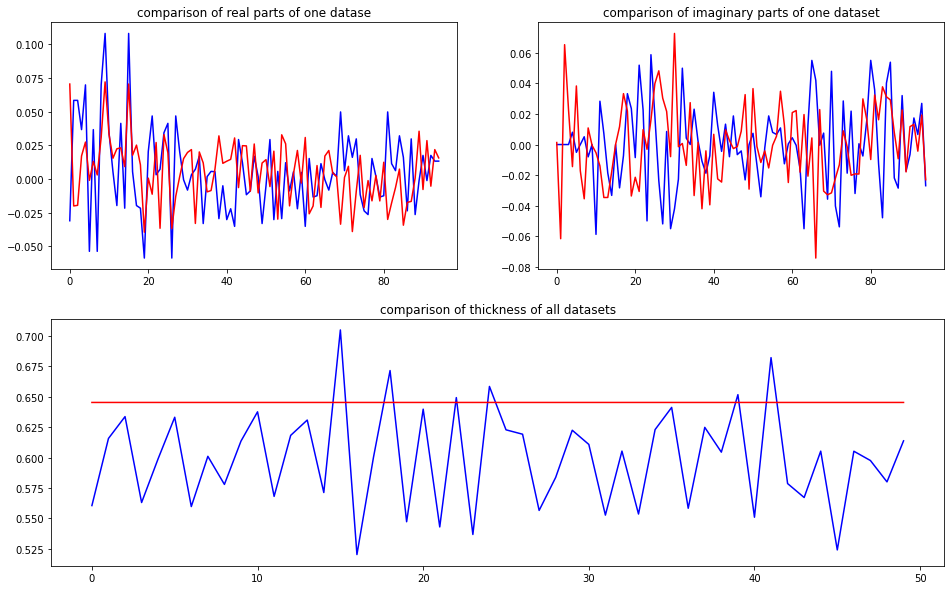

predicted thickness: 0.64539355


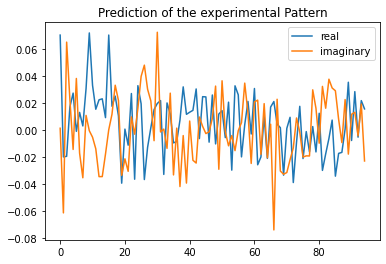

Applied shift of unit cell origin (fractional coordinates): 0.0007967893442233247 -0.14702731041125483 0.2983951436227603
Ug[ 0 ]: 0.07026 0.0  =>  0.07026 0.0
Ug[ 1 ]: 0.06639 -1.87487  =>  0.06639 0.0
Ug[ 2 ]: 0.06639 1.87487  =>  0.06639 -0.0
Ug[ 3 ]: 0.02498 0.9238  =>  0.02498 0.0
Ug[ 4 ]: 0.03172 -0.4094  =>  0.03172 0.54167
Ug[ 5 ]: 0.03685 1.54448  =>  0.03685 -1.25419
Ug[ 6 ]: 0.02498 -0.9238  =>  0.02498 -0.0
Ug[ 7 ]: 0.03685 -1.54448  =>  0.03685 1.25419
Ug[ 8 ]: 0.03172 0.4094  =>  0.03172 -0.54167
Ug[ 9 ]: 0.07108 -0.00501  =>  0.07108 0.0
Ug[ 10 ]: 0.03467 -0.31351  =>  0.03467 1.56637
Ug[ 11 ]: 0.02091 -0.65924  =>  0.02091 -2.52911
Ug[ 12 ]: 0.04138 -0.96026  =>  0.04138 -0.03146
Ug[ 13 ]: 0.04282 -1.05121  =>  0.04282 1.75247
Ug[ 14 ]: 0.02217 -1.11033  =>  0.02217 -2.05639
Ug[ 15 ]: 0.07108 0.00501  =>  0.07108 0.0
Ug[ 16 ]: 0.02091 0.65924  =>  0.02091 2.52911
Ug[ 17 ]: 0.04138 0.96026  =>  0.04138 0.03146
Ug[ 18 ]: 0.02217 1.11033  =>  0.02217 2.05639
Ug[ 19 ]: 0.05

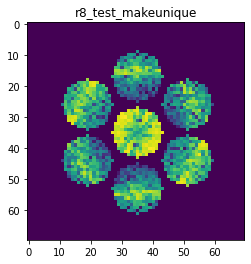

X_sim.max(): 0.96275570728826
nlogf_X_sim.max(): 6.870837846819288
>>>replaced the 82. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 381ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 291ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 275ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


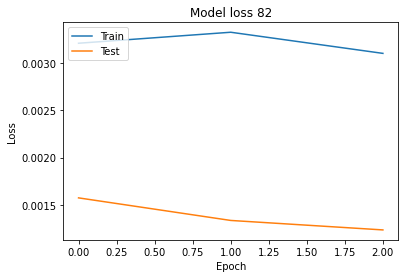

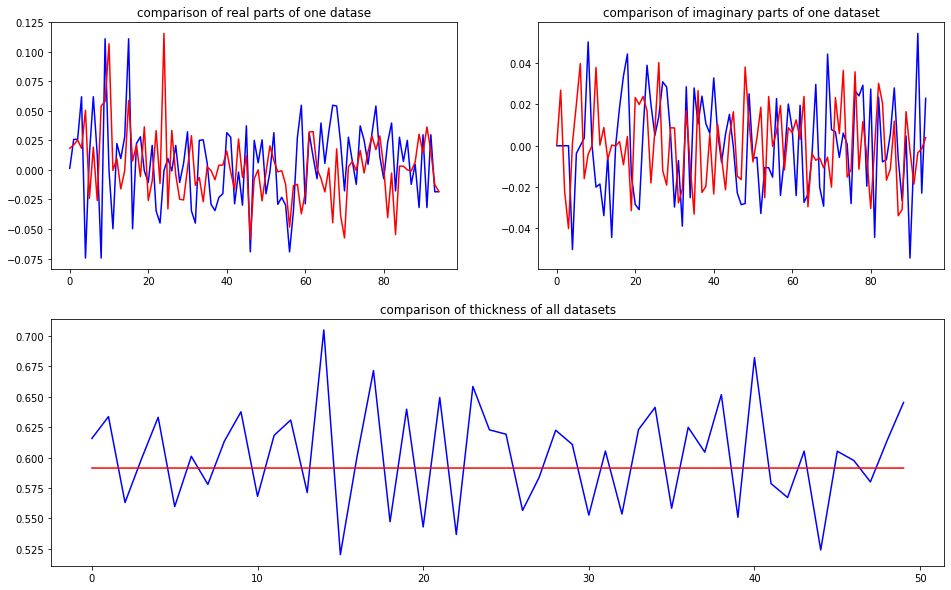

predicted thickness: 0.5914515


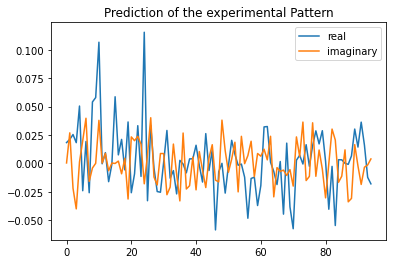

Applied shift of unit cell origin (fractional coordinates): -0.0001498992619428999 0.18013419578244708 -0.1288923638586186
Ug[ 0 ]: 0.01831 0.0  =>  0.01831 0.0
Ug[ 1 ]: 0.03371 0.80985  =>  0.03371 0.0
Ug[ 2 ]: 0.03371 -0.80985  =>  0.03371 0.0
Ug[ 3 ]: 0.0441 -1.13182  =>  0.0441 0.0
Ug[ 4 ]: 0.05234 0.05067  =>  0.05234 0.37263
Ug[ 5 ]: 0.03078 2.51796  =>  0.03078 -1.82355
Ug[ 6 ]: 0.0441 1.13182  =>  0.0441 0.0
Ug[ 7 ]: 0.03078 -2.51796  =>  0.03078 1.82355
Ug[ 8 ]: 0.05234 -0.05067  =>  0.05234 -0.37263
Ug[ 9 ]: 0.05829 0.00094  =>  0.05829 0.0
Ug[ 10 ]: 0.11447 0.24667  =>  0.11447 -0.56413
Ug[ 11 ]: 0.00366 -0.2374  =>  0.00366 0.57152
Ug[ 12 ]: 0.01773 0.53235  =>  0.01773 -0.60041
Ug[ 13 ]: 0.02547 -2.86731  =>  0.02547 1.47326
Ug[ 14 ]: 0.00384 -2.56993  =>  0.00384 -2.89283
Ug[ 15 ]: 0.05829 -0.00094  =>  0.05829 -0.0
Ug[ 16 ]: 0.00366 0.2374  =>  0.00366 -0.57152
Ug[ 17 ]: 0.01773 -0.53235  =>  0.01773 0.60041
Ug[ 18 ]: 0.00384 2.56993  =>  0.00384 2.89283
Ug[ 19 ]: 0.0500

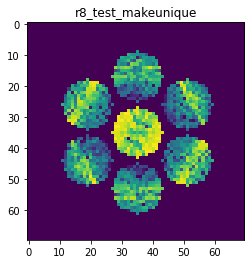

X_sim.max(): 0.9179081961793031
nlogf_X_sim.max(): 6.823186222022293
>>>replaced the 83. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 385ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 303ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 314ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


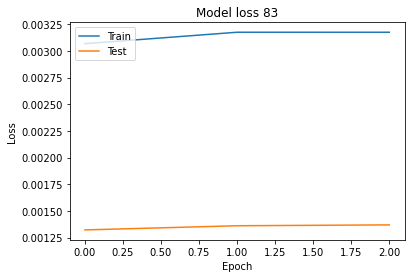

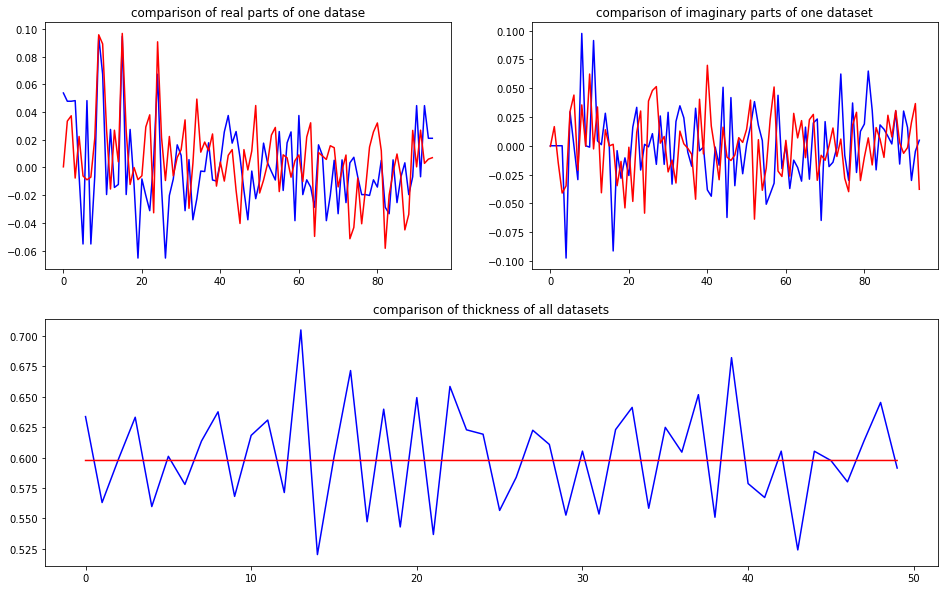

predicted thickness: 0.59767


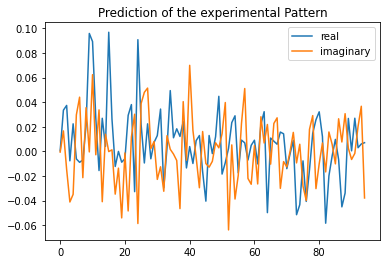

Applied shift of unit cell origin (fractional coordinates): 0.00021811551451426332 0.28066979318160706 -0.06641216411988188
Ug[ 0 ]: 0.00048 0.0  =>  0.00048 0.0
Ug[ 1 ]: 0.0387 0.41728  =>  0.0387 0.0
Ug[ 2 ]: 0.0387 -0.41728  =>  0.0387 0.0
Ug[ 3 ]: 0.04339 -1.7635  =>  0.04339 0.0
Ug[ 4 ]: 0.04138 -1.01744  =>  0.04138 0.32878
Ug[ 5 ]: 0.02634 1.82249  =>  0.02634 -2.27992
Ug[ 6 ]: 0.04339 1.7635  =>  0.04339 -0.0
Ug[ 7 ]: 0.02634 -1.82249  =>  0.02634 2.27992
Ug[ 8 ]: 0.04138 1.01744  =>  0.04138 -0.32878
Ug[ 9 ]: 0.09612 -0.00137  =>  0.09612 0.0
Ug[ 10 ]: 0.10821 0.59293  =>  0.10821 0.17702
Ug[ 11 ]: 0.02673 -0.07528  =>  0.02673 0.34337
Ug[ 12 ]: 0.03696 1.9576  =>  0.03696 0.19547
Ug[ 13 ]: 0.04672 -1.02318  =>  0.04672 3.08059
Ug[ 14 ]: 0.01391 1.42541  =>  0.01391 0.08056
Ug[ 15 ]: 0.09612 0.00137  =>  0.09612 0.0
Ug[ 16 ]: 0.02673 0.07528  =>  0.02673 -0.34337
Ug[ 17 ]: 0.03696 -1.9576  =>  0.03696 -0.19547
Ug[ 18 ]: 0.01391 -1.42541  =>  0.01391 -0.08056
Ug[ 19 ]: 0.05185 

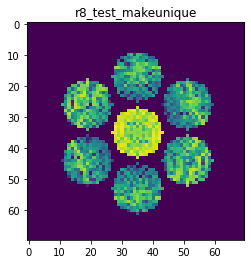

X_sim.max(): 0.9491245672890554
nlogf_X_sim.max(): 6.85659309946082
>>>replaced the 84. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 399ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 285ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 291ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


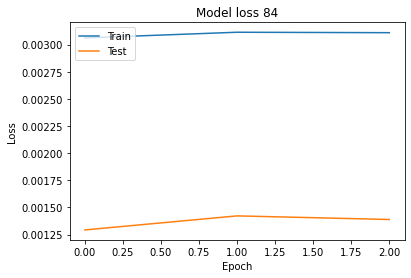

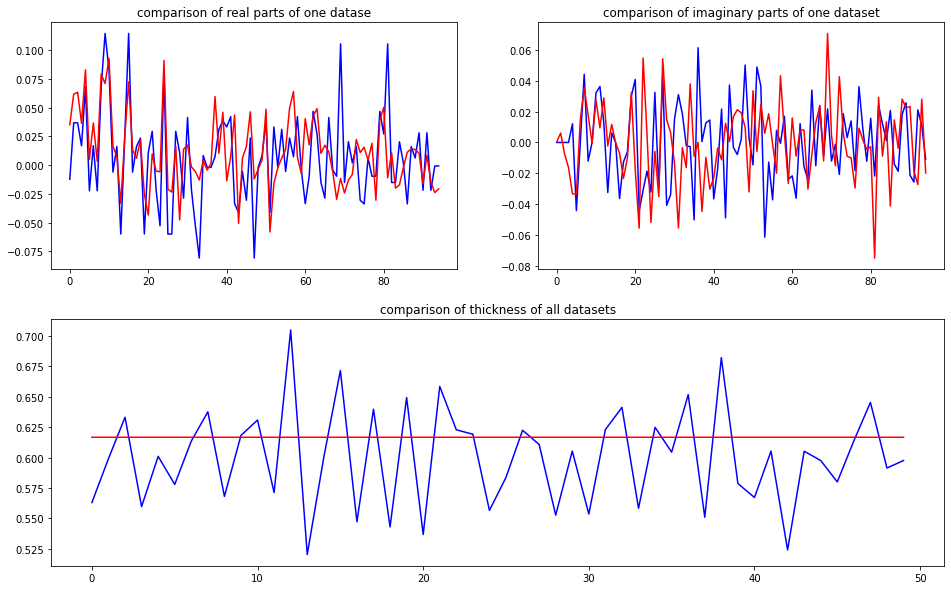

predicted thickness: 0.6167607


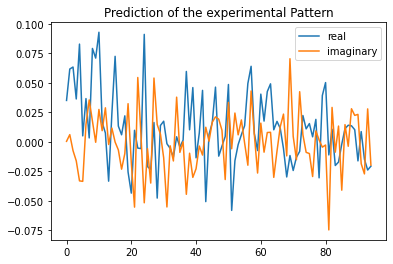

Applied shift of unit cell origin (fractional coordinates): 0.0002038112338982292 0.06372930016323436 -0.017206785340790308
Ug[ 0 ]: 0.03506 0.0  =>  0.03506 0.0
Ug[ 1 ]: 0.06284 0.10811  =>  0.06284 0.0
Ug[ 2 ]: 0.06284 -0.10811  =>  0.06284 0.0
Ug[ 3 ]: 0.03959 -0.40042  =>  0.03959 0.0
Ug[ 4 ]: 0.08471 -0.30377  =>  0.08471 -0.01146
Ug[ 5 ]: 0.03477 -1.45161  =>  0.03477 -0.94307
Ug[ 6 ]: 0.03959 0.40042  =>  0.03959 -0.0
Ug[ 7 ]: 0.03477 1.45161  =>  0.03477 0.94307
Ug[ 8 ]: 0.08471 0.30377  =>  0.08471 0.01146
Ug[ 9 ]: 0.07161 -0.00128  =>  0.07161 -0.0
Ug[ 10 ]: 0.09993 0.40751  =>  0.09993 0.30068
Ug[ 11 ]: 0.01699 0.50118  =>  0.01699 0.61057
Ug[ 12 ]: 0.02687 1.319  =>  0.02687 0.91985
Ug[ 13 ]: 0.02726 3.07765  =>  0.02726 2.57039
Ug[ 14 ]: 0.02539 0.44023  =>  0.02539 0.1492
Ug[ 15 ]: 0.07161 0.00128  =>  0.07161 0.0
Ug[ 16 ]: 0.01699 -0.50118  =>  0.01699 -0.61057
Ug[ 17 ]: 0.02687 -1.319  =>  0.02687 -0.91985
Ug[ 18 ]: 0.02539 -0.44023  =>  0.02539 -0.1492
Ug[ 19 ]: 0.0416

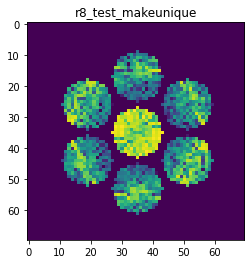

X_sim.max(): 0.9750664429976856
nlogf_X_sim.max(): 6.88353066093786
>>>replaced the 85. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 402ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 310ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 278ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


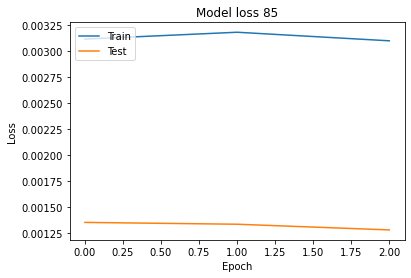

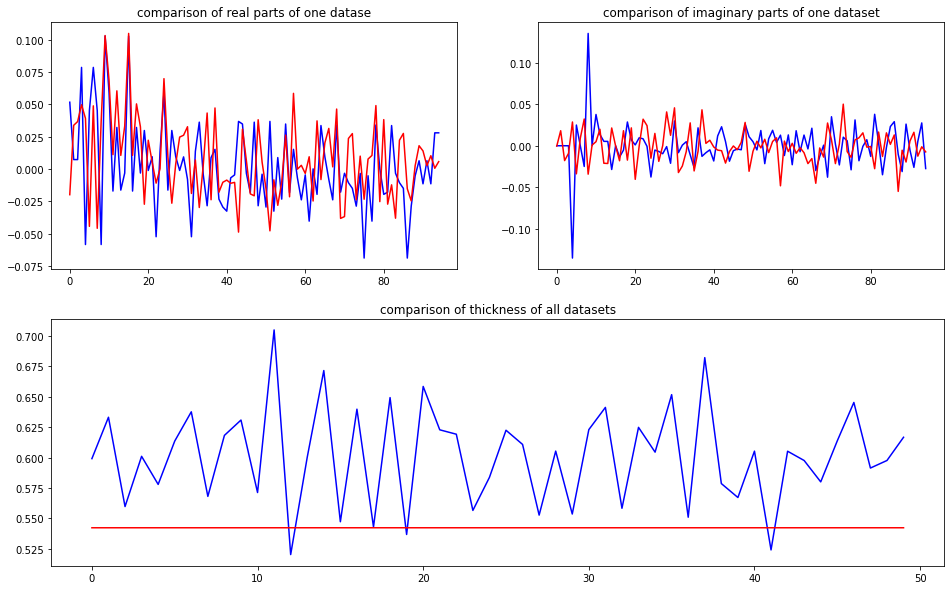

predicted thickness: 0.5423414


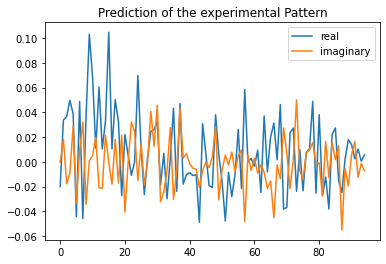

Applied shift of unit cell origin (fractional coordinates): -0.0008226123837651858 0.029274053475462414 -0.07538201097339273
Ug[ 0 ]: 0.01995 3.14159  =>  0.01995 3.14159
Ug[ 1 ]: 0.03949 0.47364  =>  0.03949 0.0
Ug[ 2 ]: 0.03949 -0.47364  =>  0.03949 -0.0
Ug[ 3 ]: 0.05001 -0.18393  =>  0.05001 0.0
Ug[ 4 ]: 0.04928 0.69251  =>  0.04928 0.40281
Ug[ 5 ]: 0.05598 -2.5101  =>  0.05598 -1.85253
Ug[ 6 ]: 0.05001 0.18393  =>  0.05001 0.0
Ug[ 7 ]: 0.05598 2.5101  =>  0.05598 1.85253
Ug[ 8 ]: 0.04928 -0.69251  =>  0.04928 -0.40281
Ug[ 9 ]: 0.10394 0.00517  =>  0.10394 0.0
Ug[ 10 ]: 0.07 0.14275  =>  0.07 -0.33606
Ug[ 11 ]: 0.02181 1.05629  =>  0.02181 1.52476
Ug[ 12 ]: 0.05868 -0.34077  =>  0.05868 -0.52987
Ug[ 13 ]: 0.0207 -1.06839  =>  0.0207 -1.73113
Ug[ 14 ]: 0.03809 0.53356  =>  0.03809 0.81809
Ug[ 15 ]: 0.10394 -0.00517  =>  0.10394 0.0
Ug[ 16 ]: 0.02181 -1.05629  =>  0.02181 -1.52476
Ug[ 17 ]: 0.05868 0.34077  =>  0.05868 0.52987
Ug[ 18 ]: 0.03809 -0.53356  =>  0.03809 -0.81809
Ug[ 19 ]:

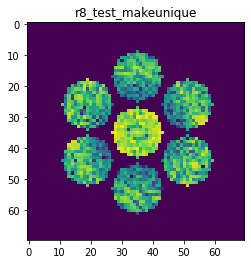

X_sim.max(): 0.8921014541792074
nlogf_X_sim.max(): 6.794700184926346
>>>replaced the 86. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 379ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 283ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 269ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


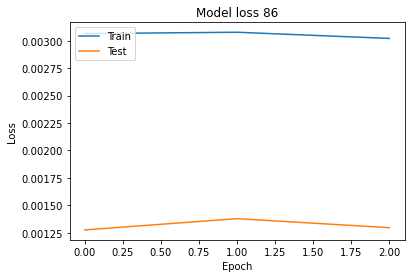

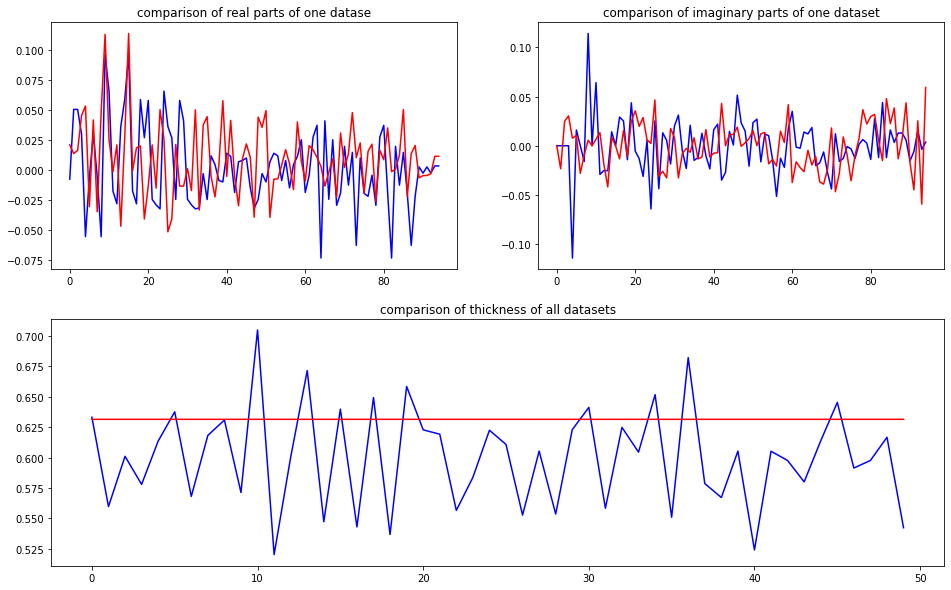

predicted thickness: 0.63151604


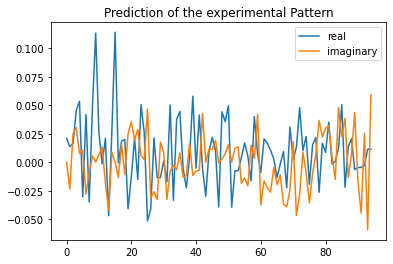

Applied shift of unit cell origin (fractional coordinates): -8.695244135586489e-05 -0.09387917455718563 0.16146464575563788
Ug[ 0 ]: 0.021 0.0  =>  0.021 0.0
Ug[ 1 ]: 0.02848 -1.01451  =>  0.02848 -0.0
Ug[ 2 ]: 0.02848 1.01451  =>  0.02848 0.0
Ug[ 3 ]: 0.05253 0.58986  =>  0.05253 0.0
Ug[ 4 ]: 0.05104 0.02059  =>  0.05104 0.44524
Ug[ 5 ]: 0.03412 2.84737  =>  0.03412 1.243
Ug[ 6 ]: 0.05253 -0.58986  =>  0.05253 0.0
Ug[ 7 ]: 0.03412 -2.84737  =>  0.03412 -1.243
Ug[ 8 ]: 0.05104 -0.02059  =>  0.05104 -0.44524
Ug[ 9 ]: 0.11378 0.00055  =>  0.11378 0.0
Ug[ 10 ]: 0.02575 0.08288  =>  0.02575 1.09685
Ug[ 11 ]: 0.01339 1.64845  =>  0.01339 0.63339
Ug[ 12 ]: 0.0262 -0.71501  =>  0.0262 -0.1257
Ug[ 13 ]: 0.06613 -2.40852  =>  0.06613 -0.8047
Ug[ 14 ]: 0.02562 0.39322  =>  0.02562 -0.03198
Ug[ 15 ]: 0.11378 -0.00055  =>  0.11378 -0.0
Ug[ 16 ]: 0.01339 -1.64845  =>  0.01339 -0.63339
Ug[ 17 ]: 0.0262 0.71501  =>  0.0262 0.1257
Ug[ 18 ]: 0.02562 -0.39322  =>  0.02562 0.03198
Ug[ 19 ]: 0.04949 2.541

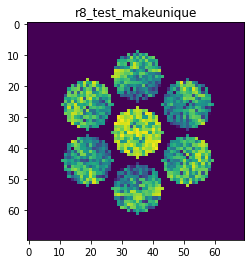

X_sim.max(): 0.9564074948007988
nlogf_X_sim.max(): 6.86422910521354
>>>replaced the 87. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 381ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 264ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 275ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


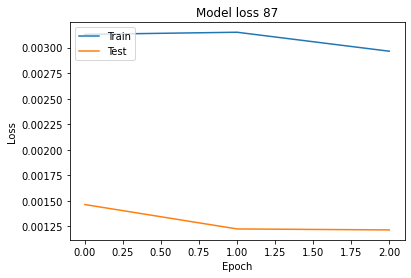

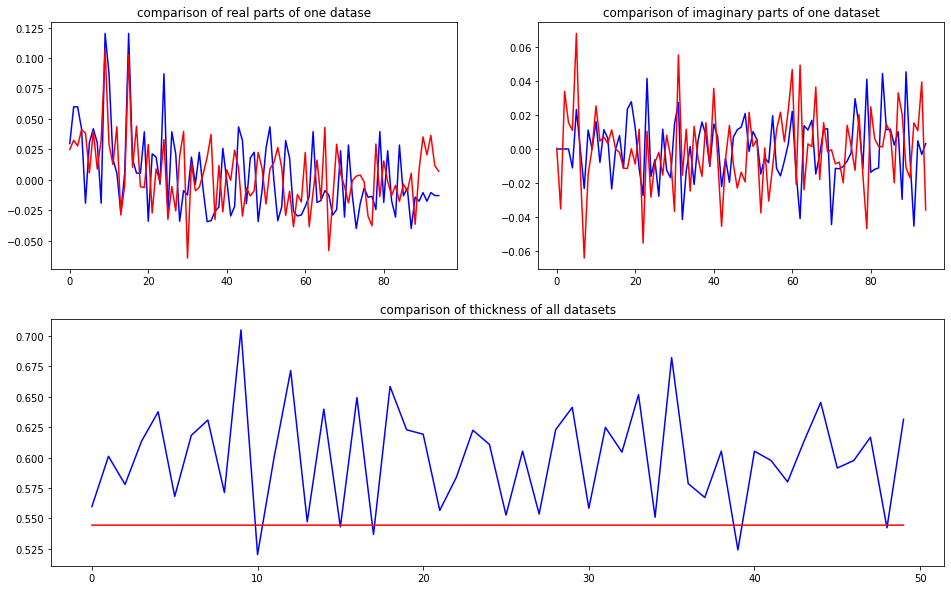

predicted thickness: 0.5445093


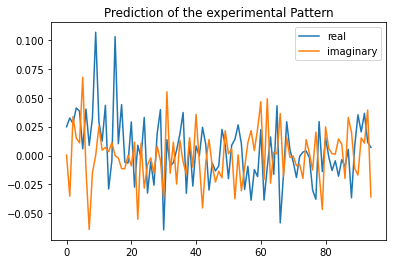

Applied shift of unit cell origin (fractional coordinates): -0.00019462380308552898 -0.051544605035494157 0.13563063289145133
Ug[ 0 ]: 0.02488 0.0  =>  0.02488 0.0
Ug[ 1 ]: 0.04567 -0.85219  =>  0.04567 -0.0
Ug[ 2 ]: 0.04567 0.85219  =>  0.04567 0.0
Ug[ 3 ]: 0.04286 0.32386  =>  0.04286 0.0
Ug[ 4 ]: 0.03783 0.34754  =>  0.03783 0.87587
Ug[ 5 ]: 0.06615 1.46123  =>  0.06615 0.28517
Ug[ 6 ]: 0.04286 -0.32386  =>  0.04286 -0.0
Ug[ 7 ]: 0.06615 -1.46123  =>  0.06615 -0.28517
Ug[ 8 ]: 0.03783 -0.34754  =>  0.03783 -0.87587
Ug[ 9 ]: 0.10456 0.00122  =>  0.10456 0.0
Ug[ 10 ]: 0.04089 0.71268  =>  0.04089 1.56365
Ug[ 11 ]: 0.01188 0.2877  =>  0.01188 -0.56571
Ug[ 12 ]: 0.04464 0.2063  =>  0.04464 0.52894
Ug[ 13 ]: 0.03121 2.96029  =>  0.03121 -2.14806
Ug[ 14 ]: 0.01235 1.98782  =>  0.01235 1.45827
Ug[ 15 ]: 0.10456 -0.00122  =>  0.10456 -0.0
Ug[ 16 ]: 0.01188 -0.2877  =>  0.01188 0.56571
Ug[ 17 ]: 0.04464 -0.2063  =>  0.04464 -0.52894
Ug[ 18 ]: 0.01235 -1.98782  =>  0.01235 -1.45827
Ug[ 19 ]: 

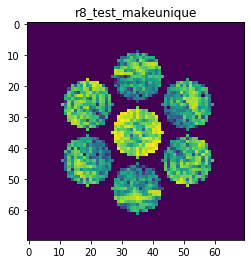

X_sim.max(): 0.866437806477391
nlogf_X_sim.max(): 6.76554381642951
>>>replaced the 88. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 402ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 284ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 299ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


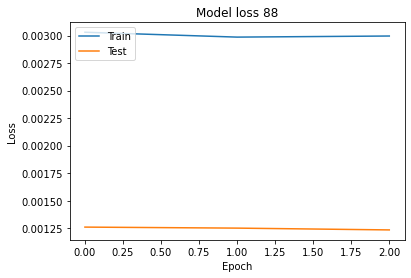

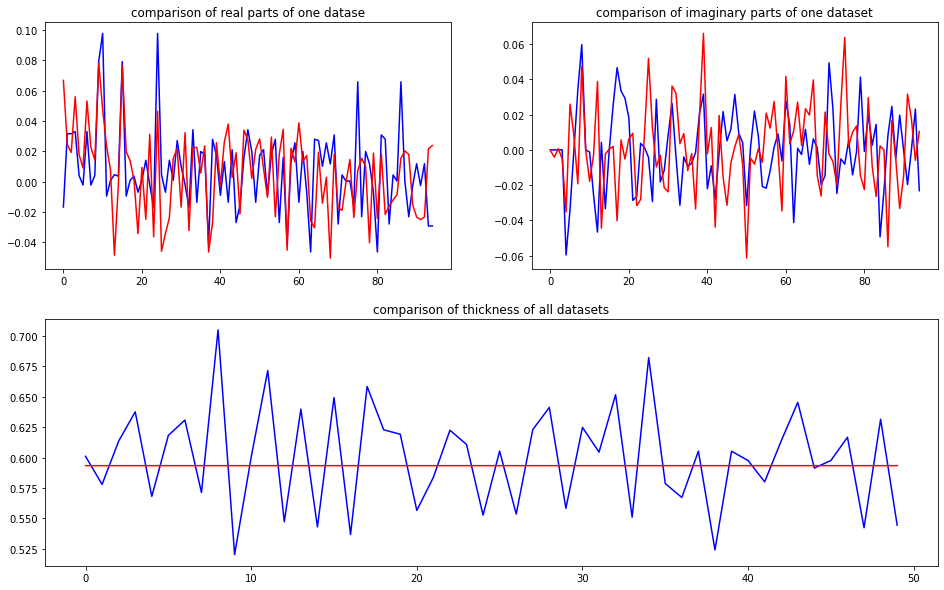

predicted thickness: 0.5934226


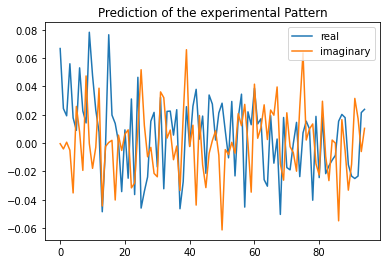

Applied shift of unit cell origin (fractional coordinates): 0.0007398564528267311 0.01878301797655933 0.017338861398633092
Ug[ 0 ]: 0.06681 0.0  =>  0.06681 0.0
Ug[ 1 ]: 0.02199 -0.10894  =>  0.02199 0.0
Ug[ 2 ]: 0.02199 0.10894  =>  0.02199 -0.0
Ug[ 3 ]: 0.05499 -0.11802  =>  0.05499 0.0
Ug[ 4 ]: 0.04433 -1.20029  =>  0.04433 -0.97333
Ug[ 5 ]: 0.02761 0.95798  =>  0.02761 0.96706
Ug[ 6 ]: 0.05499 0.11802  =>  0.05499 0.0
Ug[ 7 ]: 0.02761 -0.95798  =>  0.02761 -0.96706
Ug[ 8 ]: 0.04433 1.20029  =>  0.04433 0.97333
Ug[ 9 ]: 0.07743 -0.00465  =>  0.07743 0.0
Ug[ 10 ]: 0.04913 -0.28694  =>  0.04913 -0.17335
Ug[ 11 ]: 0.02173 -0.11219  =>  0.02173 -0.21649
Ug[ 12 ]: 0.04096 1.30287  =>  0.04096 1.1895
Ug[ 13 ]: 0.06741 -2.34661  =>  0.06741 -2.35104
Ug[ 14 ]: 0.00409 -1.76103  =>  0.00409 -1.98334
Ug[ 15 ]: 0.07743 0.00465  =>  0.07743 0.0
Ug[ 16 ]: 0.02173 0.11219  =>  0.02173 0.21649
Ug[ 17 ]: 0.04096 -1.30287  =>  0.04096 -1.1895
Ug[ 18 ]: 0.00409 1.76103  =>  0.00409 1.98334
Ug[ 19 ]: 

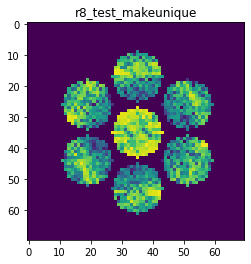

X_sim.max(): 0.878278689089712
nlogf_X_sim.max(): 6.779101899868932
>>>replaced the 89. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 366ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 282ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 274ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


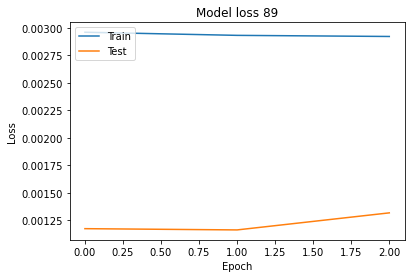

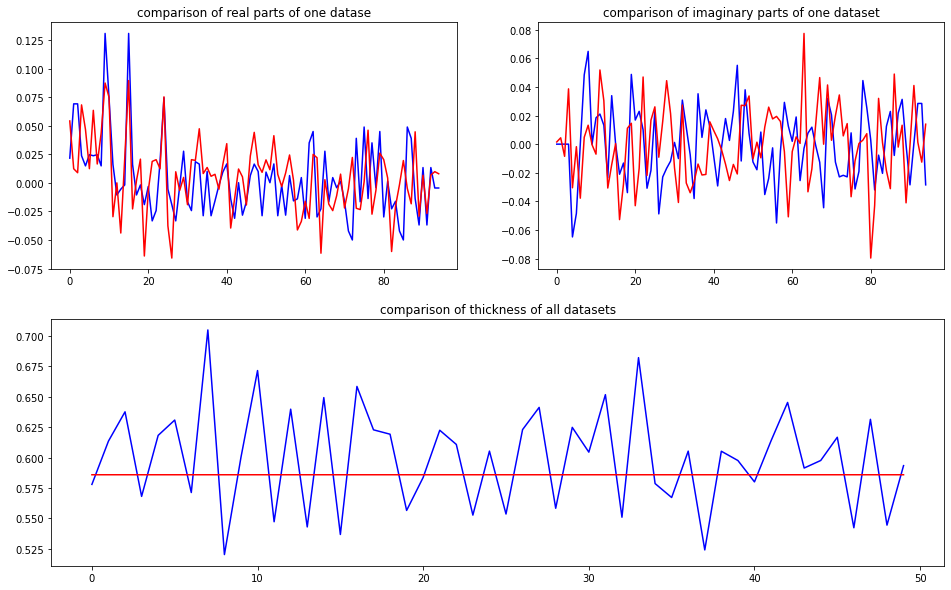

predicted thickness: 0.5859318


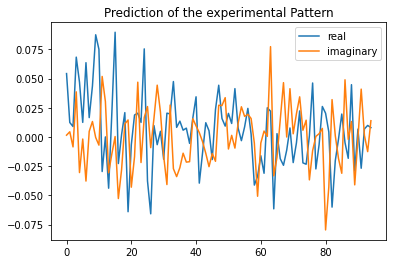

Applied shift of unit cell origin (fractional coordinates): 0.0007530272078253014 -0.08336240618681362 -0.08662252417134389
Ug[ 0 ]: 0.05435 0.0  =>  0.05435 0.0
Ug[ 1 ]: 0.01248 0.54427  =>  0.01248 0.0
Ug[ 2 ]: 0.01248 -0.54427  =>  0.01248 0.0
Ug[ 3 ]: 0.07636 0.52378  =>  0.07636 0.0
Ug[ 4 ]: 0.05032 -0.44902  =>  0.05032 -1.51706
Ug[ 5 ]: 0.0149 -0.22194  =>  0.0149 -0.20146
Ug[ 6 ]: 0.07636 -0.52378  =>  0.07636 0.0
Ug[ 7 ]: 0.0149 0.22194  =>  0.0149 0.20146
Ug[ 8 ]: 0.05032 0.44902  =>  0.05032 1.51706
Ug[ 9 ]: 0.08879 -0.00473  =>  0.08879 -0.0
Ug[ 10 ]: 0.07631 -0.15615  =>  0.07631 -0.69569
Ug[ 11 ]: 0.05842 2.03367  =>  0.05842 2.58266
Ug[ 12 ]: 0.02917 1.53323  =>  0.02917 2.06174
Ug[ 13 ]: 0.04958 -2.53291  =>  0.04958 -2.54867
Ug[ 14 ]: 0.0246 -0.54366  =>  0.0246 0.52912
Ug[ 15 ]: 0.08879 0.00473  =>  0.08879 0.0
Ug[ 16 ]: 0.05842 -2.03367  =>  0.05842 -2.58266
Ug[ 17 ]: 0.02917 -1.53323  =>  0.02917 -2.06174
Ug[ 18 ]: 0.0246 0.54366  =>  0.0246 -0.52912
Ug[ 19 ]: 0.065

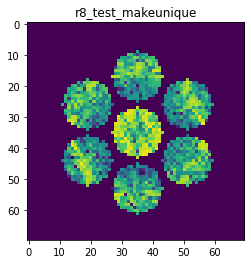

X_sim.max(): 0.9207879488737539
nlogf_X_sim.max(): 6.826315206729213
>>>replaced the 90. dataset and train: 
Epoch 1/3
8/8 [==============================] - 5s 393ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 322ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 3s 331ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


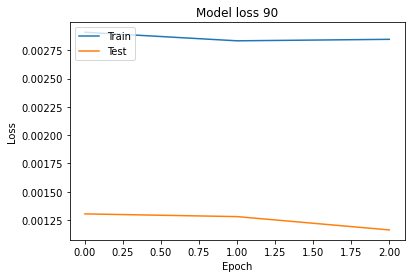

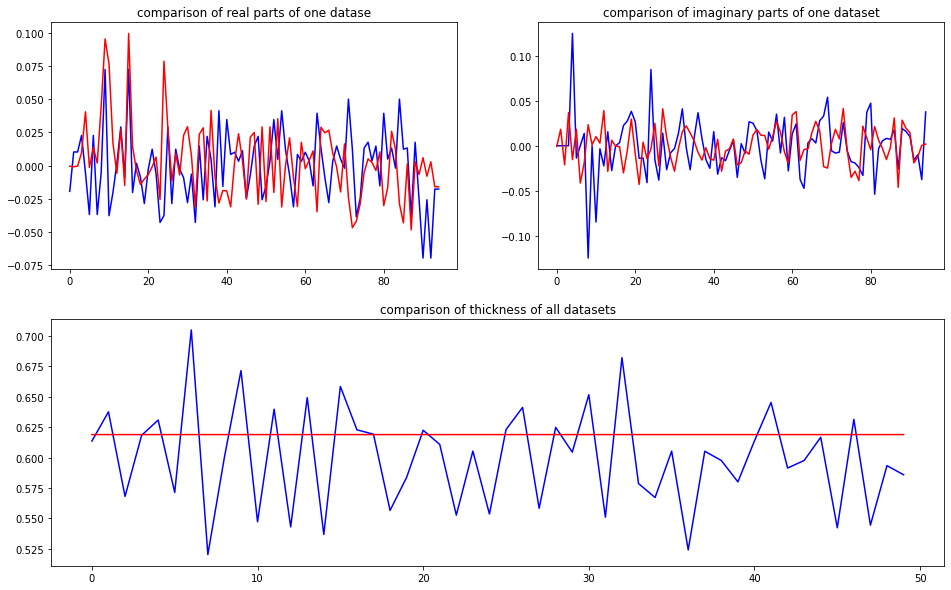

predicted thickness: 0.6189572


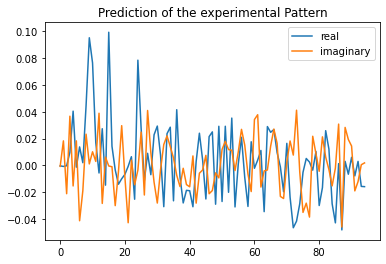

Applied shift of unit cell origin (fractional coordinates): -0.001289725163497472 -0.20377089971117665 -0.2546933498940141
Ug[ 0 ]: 0.00038 3.14159  =>  0.00038 3.14159
Ug[ 1 ]: 0.01974 1.60029  =>  0.01974 -0.0
Ug[ 2 ]: 0.01974 -1.60029  =>  0.01974 0.0
Ug[ 3 ]: 0.04076 1.28033  =>  0.04076 -0.0
Ug[ 4 ]: 0.04664 -0.42733  =>  0.04664 2.97524
Ug[ 5 ]: 0.01862 1.55507  =>  0.01862 1.87503
Ug[ 6 ]: 0.04076 -1.28033  =>  0.04076 0.0
Ug[ 7 ]: 0.01862 -1.55507  =>  0.01862 -1.87503
Ug[ 8 ]: 0.04664 0.42733  =>  0.04664 -2.97524
Ug[ 9 ]: 0.09699 0.0081  =>  0.09699 -0.0
Ug[ 10 ]: 0.07759 0.08844  =>  0.07759 -1.51995
Ug[ 11 ]: 0.01578 0.12626  =>  0.01578 1.71845
Ug[ 12 ]: 0.0348 1.70402  =>  0.0348 2.97624
Ug[ 13 ]: 0.03827 -0.76965  =>  0.03827 -1.09771
Ug[ 14 ]: 0.01544 2.78189  =>  0.01544 -0.62879
Ug[ 15 ]: 0.09699 -0.0081  =>  0.09699 0.0
Ug[ 16 ]: 0.01578 -0.12626  =>  0.01578 -1.71845
Ug[ 17 ]: 0.0348 -1.70402  =>  0.0348 -2.97624
Ug[ 18 ]: 0.01544 -2.78189  =>  0.01544 0.62879
Ug[ 1

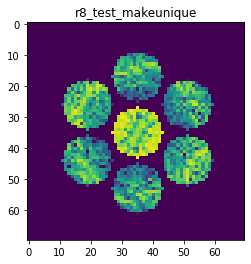

X_sim.max(): 0.937804676352116
nlogf_X_sim.max(): 6.84460744516612
>>>replaced the 91. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 396ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 286ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 262ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


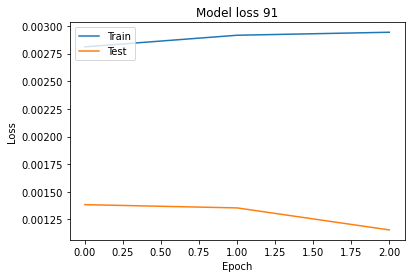

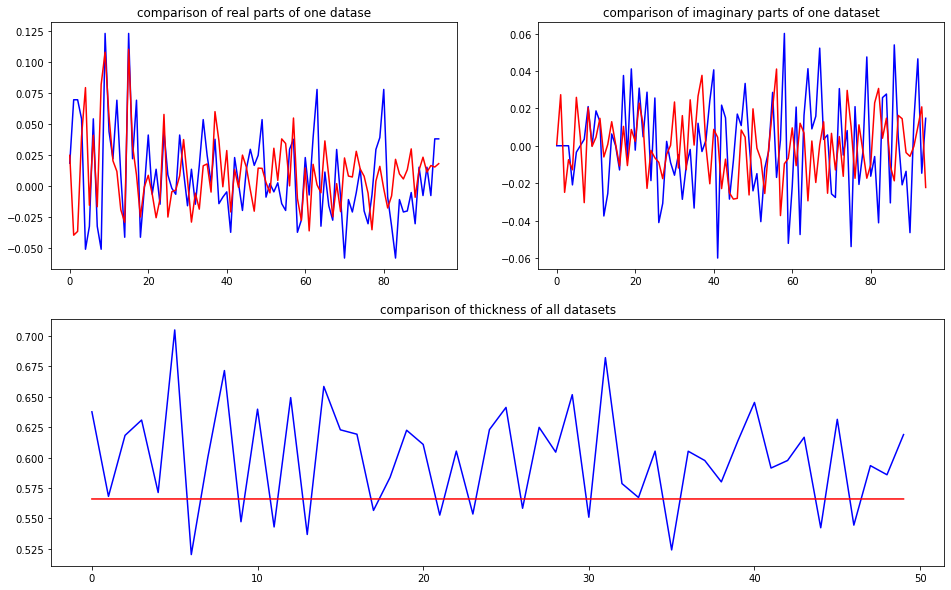

predicted thickness: 0.56602234


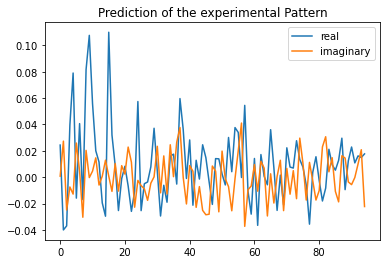

Applied shift of unit cell origin (fractional coordinates): 0.0008411961394298885 0.023773128541474363 -0.4052716575860666
Ug[ 0 ]: 0.02431 0.0  =>  0.02431 0.0
Ug[ 1 ]: 0.04655 2.5464  =>  0.04655 -0.0
Ug[ 2 ]: 0.04655 -2.5464  =>  0.04655 0.0
Ug[ 3 ]: 0.04046 -0.14937  =>  0.04046 0.0
Ug[ 4 ]: 0.08183 -0.20392  =>  0.08183 -2.60094
Ug[ 5 ]: 0.03264 2.10146  =>  0.03264 -1.48596
Ug[ 6 ]: 0.04046 0.14937  =>  0.04046 -0.0
Ug[ 7 ]: 0.03264 -2.10146  =>  0.03264 1.48596
Ug[ 8 ]: 0.08183 0.20392  =>  0.08183 2.60094
Ug[ 9 ]: 0.10848 -0.00529  =>  0.10848 0.0
Ug[ 10 ]: 0.05653 0.06246  =>  0.05653 -2.47865
Ug[ 11 ]: 0.02889 0.45614  =>  0.02889 3.00782
Ug[ 12 ]: 0.01289 -0.68645  =>  0.01289 -0.83053
Ug[ 13 ]: 0.02276 2.9829  =>  0.02276 0.29242
Ug[ 14 ]: 0.0299 2.73858  =>  0.0299 -1.14229
Ug[ 15 ]: 0.10848 0.00529  =>  0.10848 0.0
Ug[ 16 ]: 0.02889 -0.45614  =>  0.02889 -3.00782
Ug[ 17 ]: 0.01289 0.68645  =>  0.01289 0.83053
Ug[ 18 ]: 0.0299 -2.73858  =>  0.0299 1.14229
Ug[ 19 ]: 0.0093 

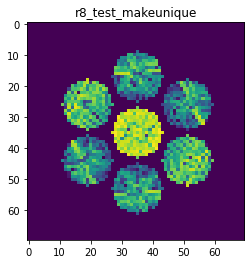

X_sim.max(): 0.9103279187436841
nlogf_X_sim.max(): 6.814902787204957
>>>replaced the 92. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 391ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 294ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 291ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


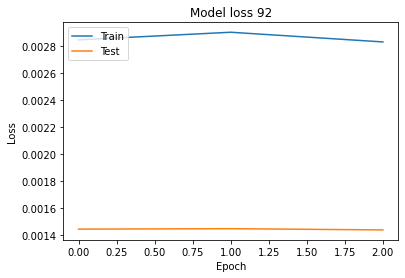

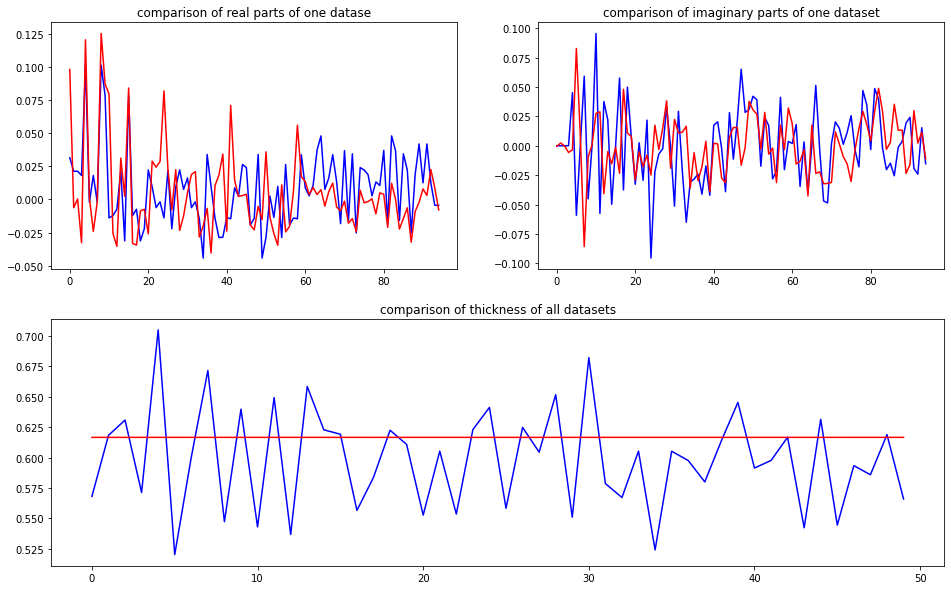

predicted thickness: 0.61667633


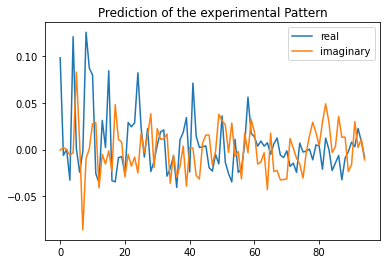

Applied shift of unit cell origin (fractional coordinates): -0.0021374940016783773 0.4602525586974816 -0.4347032092584071
Ug[ 0 ]: 0.09823 0.0  =>  0.09823 0.0
Ug[ 1 ]: 0.00318 2.73132  =>  0.00318 0.0
Ug[ 2 ]: 0.00318 -2.73132  =>  0.00318 -0.0
Ug[ 3 ]: 0.02931 -2.89185  =>  0.02931 -0.0
Ug[ 4 ]: 0.12322 0.02432  =>  0.12322 0.18485
Ug[ 5 ]: 0.08426 1.57205  =>  0.08426 0.91204
Ug[ 6 ]: 0.02931 2.89185  =>  0.02931 0.0
Ug[ 7 ]: 0.08426 -1.57205  =>  0.08426 -0.91204
Ug[ 8 ]: 0.12322 -0.02432  =>  0.12322 -0.18485
Ug[ 9 ]: 0.08572 0.01343  =>  0.08572 0.0
Ug[ 10 ]: 0.08504 0.31341  =>  0.08504 -2.43134
Ug[ 11 ]: 0.03933 2.41456  =>  0.03933 -1.15074
Ug[ 12 ]: 0.05646 -2.23585  =>  0.05646 1.14205
Ug[ 13 ]: 0.02952 -0.39008  =>  0.02952 0.25651
Ug[ 14 ]: 0.01347 -1.80871  =>  0.01347 -1.98267
Ug[ 15 ]: 0.08572 -0.01343  =>  0.08572 0.0
Ug[ 16 ]: 0.03933 -2.41456  =>  0.03933 1.15074
Ug[ 17 ]: 0.05646 2.23585  =>  0.05646 -1.14205
Ug[ 18 ]: 0.01347 1.80871  =>  0.01347 1.98267
Ug[ 19 ]: 

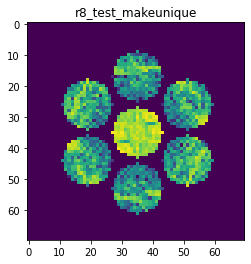

X_sim.max(): 0.9352571025881181
nlogf_X_sim.max(): 6.841890121011592
>>>replaced the 93. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 360ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 271ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 271ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


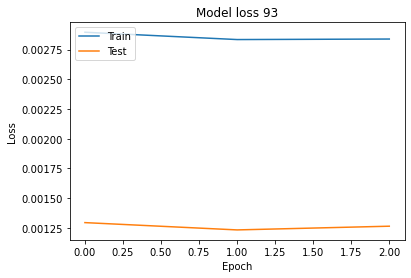

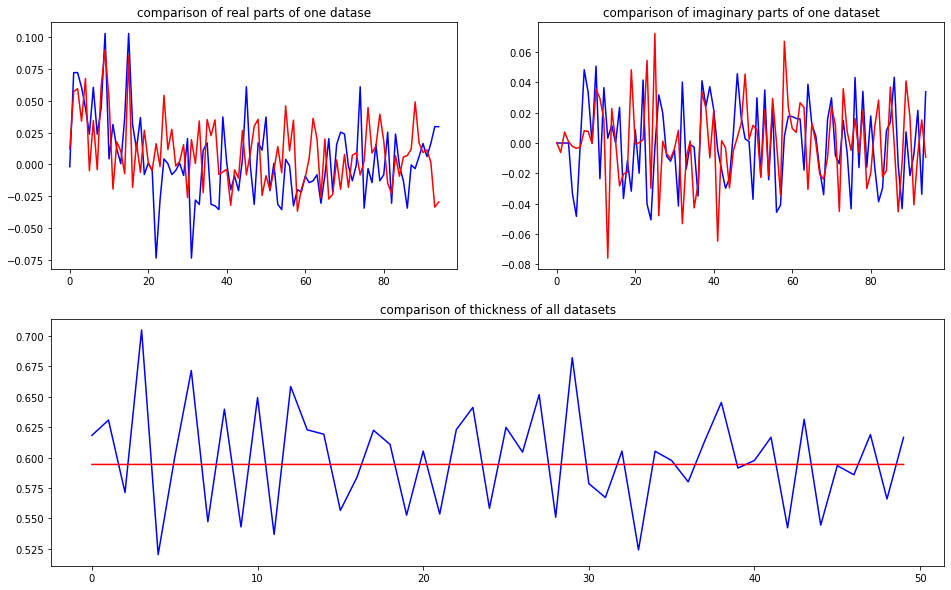

predicted thickness: 0.5944048


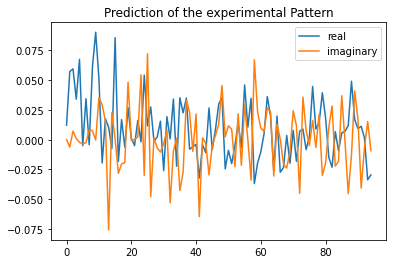

Applied shift of unit cell origin (fractional coordinates): 0.0009384460217344357 -0.0080476175152791 0.01833092634495647
Ug[ 0 ]: 0.01217 0.0  =>  0.01217 0.0
Ug[ 1 ]: 0.05872 -0.11518  =>  0.05872 0.0
Ug[ 2 ]: 0.05872 0.11518  =>  0.05872 0.0
Ug[ 3 ]: 0.03426 0.05056  =>  0.03426 0.0
Ug[ 4 ]: 0.06452 -0.07682  =>  0.06452 -0.01221
Ug[ 5 ]: 0.00747 -2.24965  =>  0.00747 -2.41539
Ug[ 6 ]: 0.03426 -0.05056  =>  0.03426 0.0
Ug[ 7 ]: 0.00747 2.24965  =>  0.00747 2.41539
Ug[ 8 ]: 0.06452 0.07682  =>  0.06452 0.01221
Ug[ 9 ]: 0.08787 -0.0059  =>  0.08787 0.0
Ug[ 10 ]: 0.06207 0.556  =>  0.06207 0.67707
Ug[ 11 ]: 0.03453 2.15058  =>  0.03453 2.0413
Ug[ 12 ]: 0.02493 0.80823  =>  0.02493 0.86469
Ug[ 13 ]: 0.07491 -1.42582  =>  0.07491 -1.25418
Ug[ 14 ]: 0.0221 1.88833  =>  0.0221 1.82961
Ug[ 15 ]: 0.08787 0.0059  =>  0.08787 -0.0
Ug[ 16 ]: 0.03453 -2.15058  =>  0.03453 -2.0413
Ug[ 17 ]: 0.02493 -0.80823  =>  0.02493 -0.86469
Ug[ 18 ]: 0.0221 -1.88833  =>  0.0221 -1.82961
Ug[ 19 ]: 0.05522 1.0

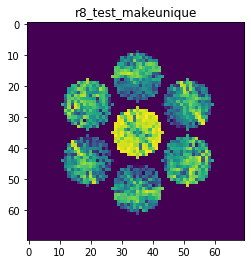

X_sim.max(): 0.9485842057171544
nlogf_X_sim.max(): 6.856024210593061
>>>replaced the 94. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 366ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 271ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 271ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


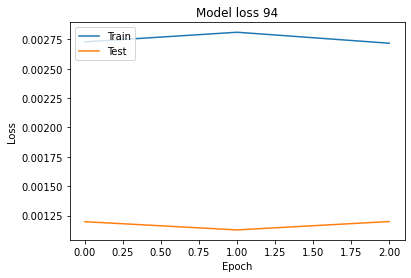

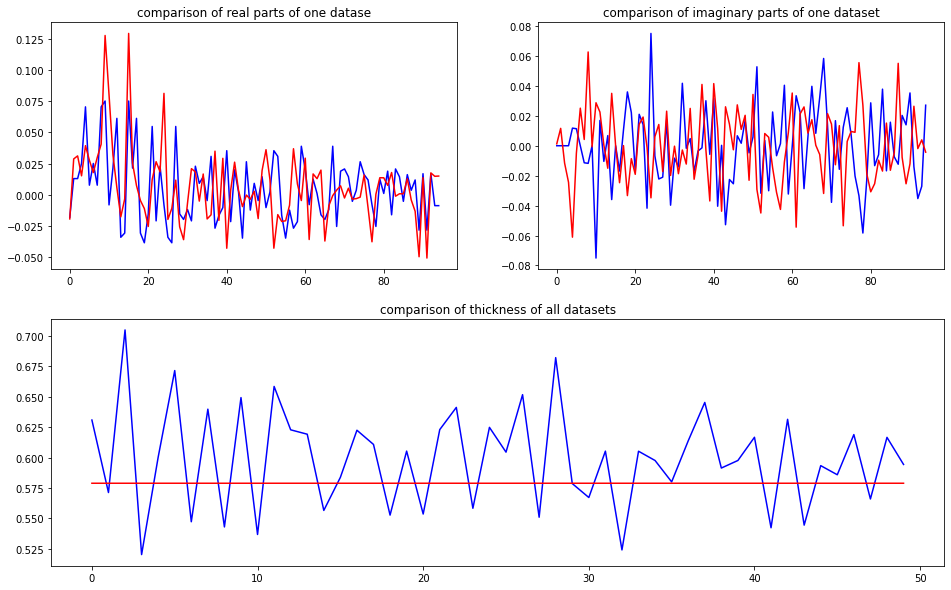

predicted thickness: 0.5789546


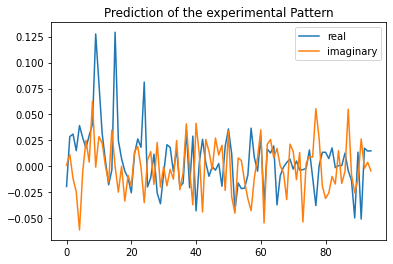

Applied shift of unit cell origin (fractional coordinates): 0.0004201083132375072 0.15659528412634008 -0.05901077606979337
Ug[ 0 ]: 0.0193 3.14159  =>  0.0193 3.14159
Ug[ 1 ]: 0.03208 0.37078  =>  0.03208 0.0
Ug[ 2 ]: 0.03208 -0.37078  =>  0.03208 -0.0
Ug[ 3 ]: 0.02975 -0.98392  =>  0.02975 -0.0
Ug[ 4 ]: 0.07362 -0.99834  =>  0.07362 -0.38519
Ug[ 5 ]: 0.02911 -0.15902  =>  0.02911 1.19568
Ug[ 6 ]: 0.02975 0.98392  =>  0.02975 0.0
Ug[ 7 ]: 0.02911 0.15902  =>  0.02911 -1.19568
Ug[ 8 ]: 0.07362 0.99834  =>  0.07362 0.38519
Ug[ 9 ]: 0.1282 -0.00264  =>  0.1282 0.0
Ug[ 10 ]: 0.08668 0.37541  =>  0.08668 0.00728
Ug[ 11 ]: 0.03701 0.69192  =>  0.03701 1.06533
Ug[ 12 ]: 0.00656 0.03392  =>  0.00656 -0.94736
Ug[ 13 ]: 0.02147 -2.6286  =>  0.02147 2.30253
Ug[ 14 ]: 0.03439 1.68535  =>  0.03439 1.07485
Ug[ 15 ]: 0.1282 0.00264  =>  0.1282 -0.0
Ug[ 16 ]: 0.03701 -0.69192  =>  0.03701 -1.06533
Ug[ 17 ]: 0.00656 -0.03392  =>  0.00656 0.94736
Ug[ 18 ]: 0.03439 -1.68535  =>  0.03439 -1.07485
Ug[ 19 ]

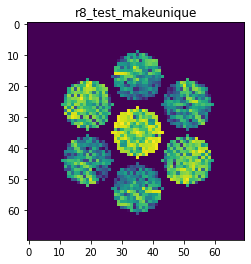

X_sim.max(): 0.8888650409186131
nlogf_X_sim.max(): 6.791069811810478
>>>replaced the 95. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 383ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 290ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 289ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


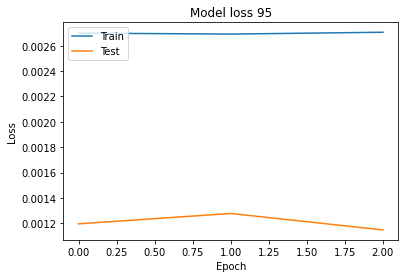

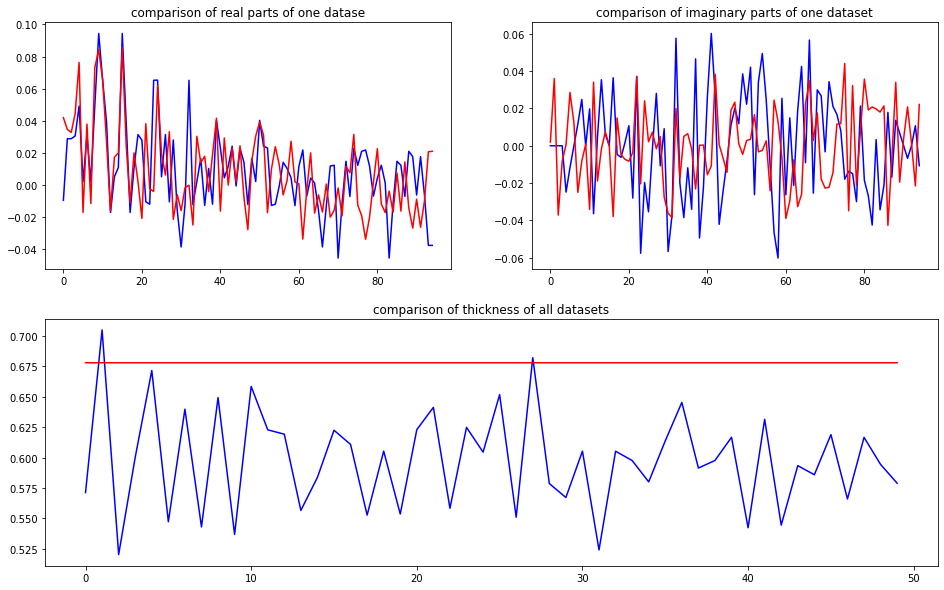

predicted thickness: 0.6780379


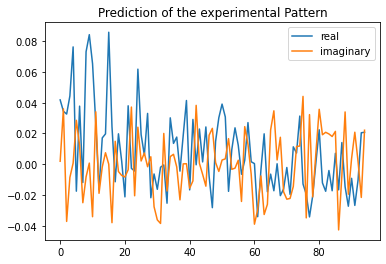

Applied shift of unit cell origin (fractional coordinates): -0.0006462904817511553 0.0394769137127084 -0.13170559788100616
Ug[ 0 ]: 0.04187 0.0  =>  0.04187 0.0
Ug[ 1 ]: 0.04966 0.82753  =>  0.04966 -0.0
Ug[ 2 ]: 0.04966 -0.82753  =>  0.04966 0.0
Ug[ 3 ]: 0.04243 -0.24804  =>  0.04243 -0.0
Ug[ 4 ]: 0.075 0.0596  =>  0.075 -0.51989
Ug[ 5 ]: 0.03052 2.07109  =>  0.03052 -3.13652
Ug[ 6 ]: 0.04243 0.24804  =>  0.04243 0.0
Ug[ 7 ]: 0.03052 -2.07109  =>  0.03052 3.13652
Ug[ 8 ]: 0.075 -0.0596  =>  0.075 0.51989
Ug[ 9 ]: 0.08524 0.00406  =>  0.08524 0.0
Ug[ 10 ]: 0.07005 -0.42762  =>  0.07005 -1.25921
Ug[ 11 ]: 0.0441 0.95549  =>  0.0441 1.77895
Ug[ 12 ]: 0.02188 -2.26057  =>  0.02188 -2.51267
Ug[ 13 ]: 0.01831 -0.10497  =>  0.01831 -1.18461
Ug[ 14 ]: 0.02069 0.29958  =>  0.02069 0.87501
Ug[ 15 ]: 0.08524 -0.00406  =>  0.08524 -0.0
Ug[ 16 ]: 0.0441 -0.95549  =>  0.0441 -1.77895
Ug[ 17 ]: 0.02188 2.26057  =>  0.02188 2.51267
Ug[ 18 ]: 0.02069 -0.29958  =>  0.02069 -0.87501
Ug[ 19 ]: 0.0083 -1.

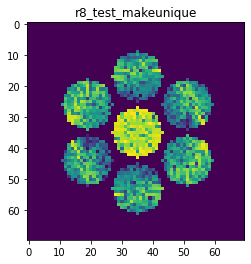

X_sim.max(): 0.9442486494391099
nlogf_X_sim.max(): 6.8514480139830445
>>>replaced the 96. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 348ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 250ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 249ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


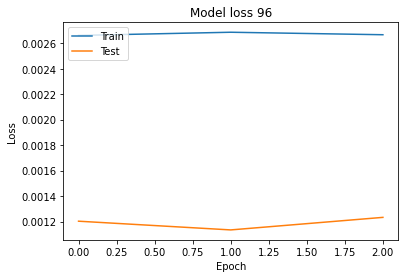

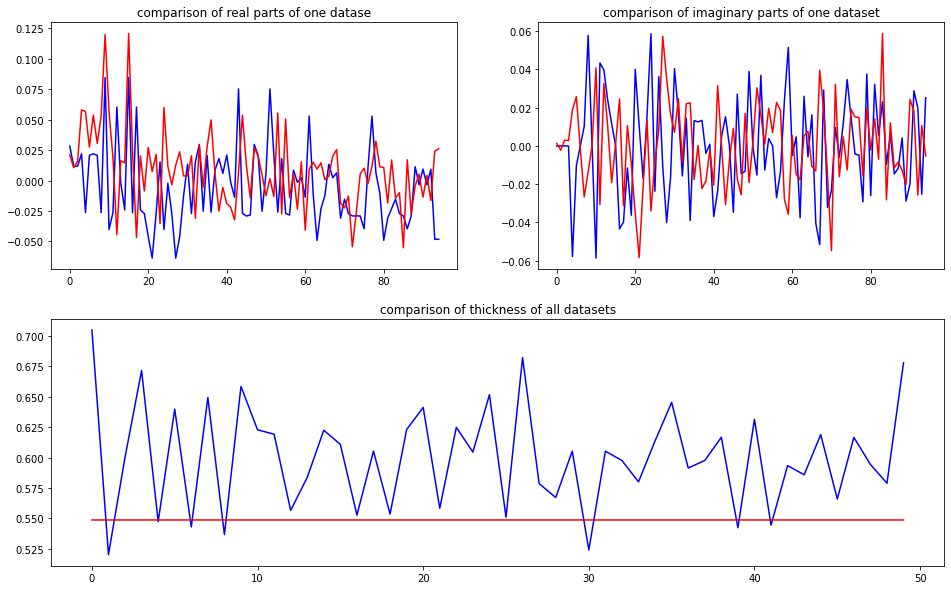

predicted thickness: 0.5487547


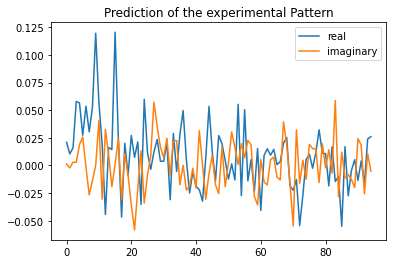

Applied shift of unit cell origin (fractional coordinates): 0.0005692947311174237 -0.006080207991998046 0.031101269699607817
Ug[ 0 ]: 0.02096 0.0  =>  0.02096 0.0
Ug[ 1 ]: 0.01342 -0.19542  =>  0.01342 0.0
Ug[ 2 ]: 0.01342 0.19542  =>  0.01342 0.0
Ug[ 3 ]: 0.05596 0.0382  =>  0.05596 0.0
Ug[ 4 ]: 0.05714 0.2881  =>  0.05714 0.44532
Ug[ 5 ]: 0.03908 0.73562  =>  0.03908 0.50201
Ug[ 6 ]: 0.05596 -0.0382  =>  0.05596 0.0
Ug[ 7 ]: 0.03908 -0.73562  =>  0.03908 -0.50201
Ug[ 8 ]: 0.05714 -0.2881  =>  0.05714 -0.44532
Ug[ 9 ]: 0.12061 -0.00358  =>  0.12061 0.0
Ug[ 10 ]: 0.06935 0.56931  =>  0.06935 0.7683
Ug[ 11 ]: 0.03501 -0.9078  =>  0.03501 -1.09964
Ug[ 12 ]: 0.05559 2.5298  =>  0.05559 2.57158
Ug[ 13 ]: 0.0167 0.58215  =>  0.0167 0.81934
Ug[ 14 ]: 0.02282 -0.71184  =>  0.02282 -0.86547
Ug[ 15 ]: 0.12061 0.00358  =>  0.12061 0.0
Ug[ 16 ]: 0.03501 0.9078  =>  0.03501 1.09964
Ug[ 17 ]: 0.05559 -2.5298  =>  0.05559 -2.57158
Ug[ 18 ]: 0.02282 0.71184  =>  0.02282 0.86547
Ug[ 19 ]: 0.01079 -2.1

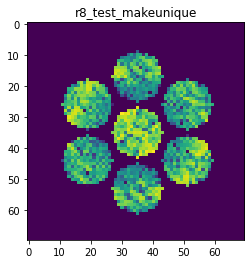

X_sim.max(): 0.9176214235247063
nlogf_X_sim.max(): 6.822874093549532
>>>replaced the 97. dataset and train: 
Epoch 1/3
8/8 [==============================] - 5s 425ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 291ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 299ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


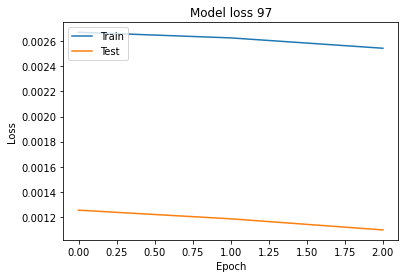

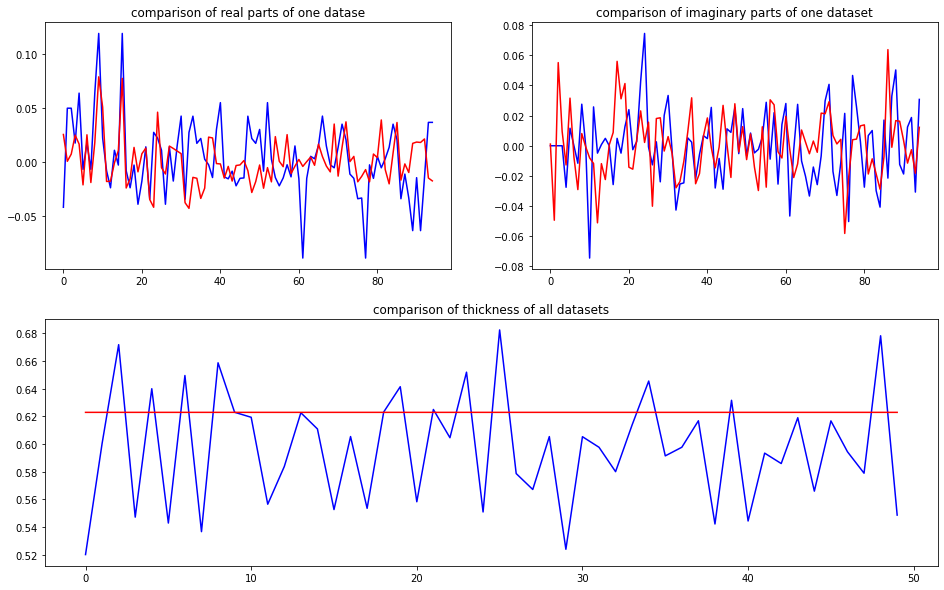

predicted thickness: 0.62282634


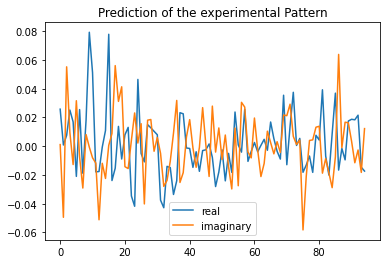

Applied shift of unit cell origin (fractional coordinates): 0.0012490480795366544 -0.051481671207189744 0.2371637071093909
Ug[ 0 ]: 0.02575 0.0  =>  0.02575 0.0
Ug[ 1 ]: 0.0525 -1.49014  =>  0.0525 -0.0
Ug[ 2 ]: 0.0525 1.49014  =>  0.0525 0.0
Ug[ 3 ]: 0.02669 0.32347  =>  0.02669 0.0
Ug[ 4 ]: 0.02041 -0.53648  =>  0.02041 0.63019
Ug[ 5 ]: 0.0363 2.15089  =>  0.0363 0.33728
Ug[ 6 ]: 0.02669 -0.32347  =>  0.02669 0.0
Ug[ 7 ]: 0.0363 -2.15089  =>  0.0363 -0.33728
Ug[ 8 ]: 0.02041 0.53648  =>  0.02041 -0.63019
Ug[ 9 ]: 0.07861 -0.00785  =>  0.07861 0.0
Ug[ 10 ]: 0.04909 -0.10471  =>  0.04909 1.39328
Ug[ 11 ]: 0.02326 -2.68403  =>  0.02326 2.11686
Ug[ 12 ]: 0.05607 -1.86834  =>  0.05607 -1.53702
Ug[ 13 ]: 0.01406 -1.77657  =>  0.01406 0.04489
Ug[ 14 ]: 0.0295 -1.13923  =>  0.0295 -2.29806
Ug[ 15 ]: 0.07861 0.00785  =>  0.07861 0.0
Ug[ 16 ]: 0.02326 2.68403  =>  0.02326 -2.11686
Ug[ 17 ]: 0.05607 1.86834  =>  0.05607 1.53702
Ug[ 18 ]: 0.0295 1.13923  =>  0.0295 2.29806
Ug[ 19 ]: 0.04191 1.80

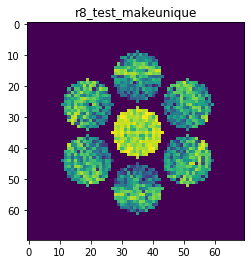

X_sim.max(): 0.9385672158784094
nlogf_X_sim.max(): 6.845419360603459
>>>replaced the 98. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 407ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 307ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 3s 332ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


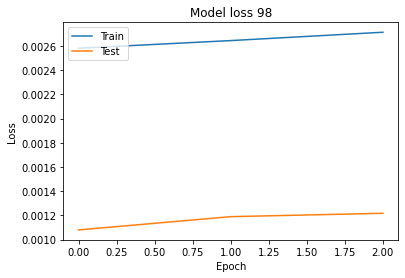

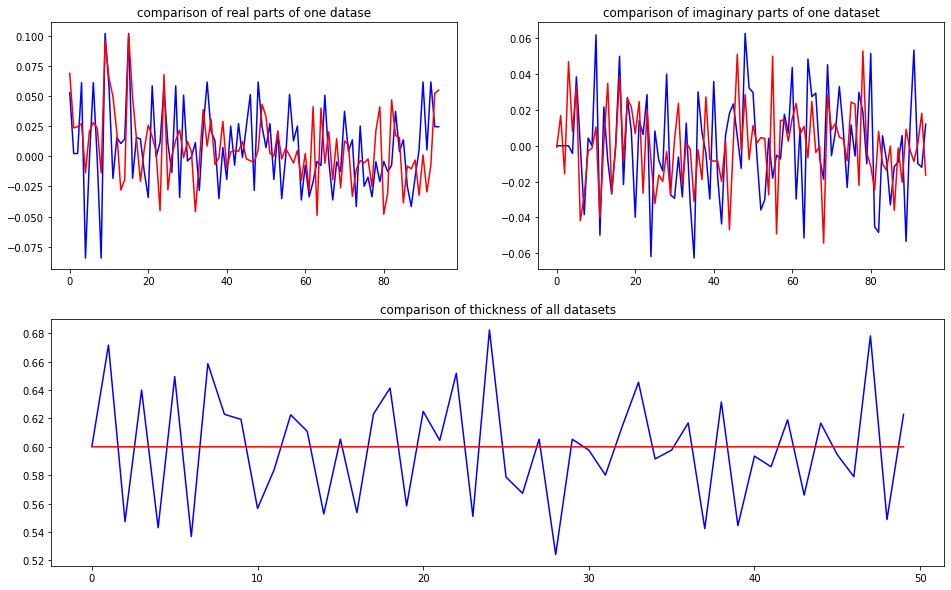

predicted thickness: 0.59995663


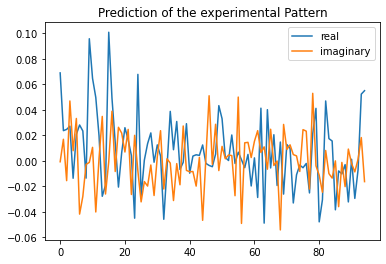

Applied shift of unit cell origin (fractional coordinates): 0.00043399185577879006 -0.16163086661584877 -0.09439872926233396
Ug[ 0 ]: 0.06886 0.0  =>  0.06886 0.0
Ug[ 1 ]: 0.02906 0.59312  =>  0.02906 -0.0
Ug[ 2 ]: 0.02906 -0.59312  =>  0.02906 0.0
Ug[ 3 ]: 0.05226 1.01556  =>  0.05226 -0.0
Ug[ 4 ]: 0.01473 2.76702  =>  0.01473 1.15834
Ug[ 5 ]: 0.0377 0.94614  =>  0.0377 0.52371
Ug[ 6 ]: 0.05226 -1.01556  =>  0.05226 0.0
Ug[ 7 ]: 0.0377 -0.94614  =>  0.0377 -0.52371
Ug[ 8 ]: 0.01473 -2.76702  =>  0.01473 -1.15834
Ug[ 9 ]: 0.09814 -0.00273  =>  0.09814 0.0
Ug[ 10 ]: 0.06679 0.1389  =>  0.06679 -0.4515
Ug[ 11 ]: 0.06325 -0.67575  =>  0.06325 -0.07989
Ug[ 12 ]: 0.01779 0.29533  =>  0.01779 1.31361
Ug[ 13 ]: 0.04366 2.26526  =>  0.04366 2.69042
Ug[ 14 ]: 0.03293 -2.22164  =>  0.03293 -0.61023
Ug[ 15 ]: 0.09814 0.00273  =>  0.09814 0.0
Ug[ 16 ]: 0.06325 0.67575  =>  0.06325 0.07989
Ug[ 17 ]: 0.01779 -0.29533  =>  0.01779 -1.31361
Ug[ 18 ]: 0.03293 2.22164  =>  0.03293 0.61023
Ug[ 19 ]: 0.01

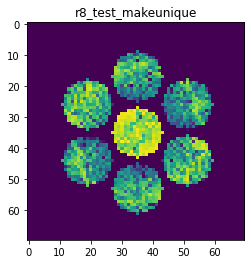

X_sim.max(): 0.8588268486931159
nlogf_X_sim.max(): 6.756731030247256
>>>replaced the 99. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 408ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 329ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 3s 336ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


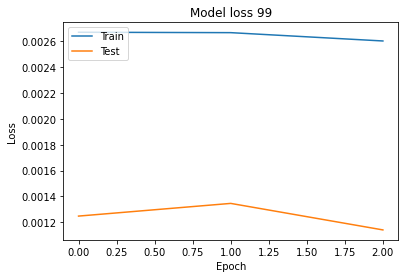

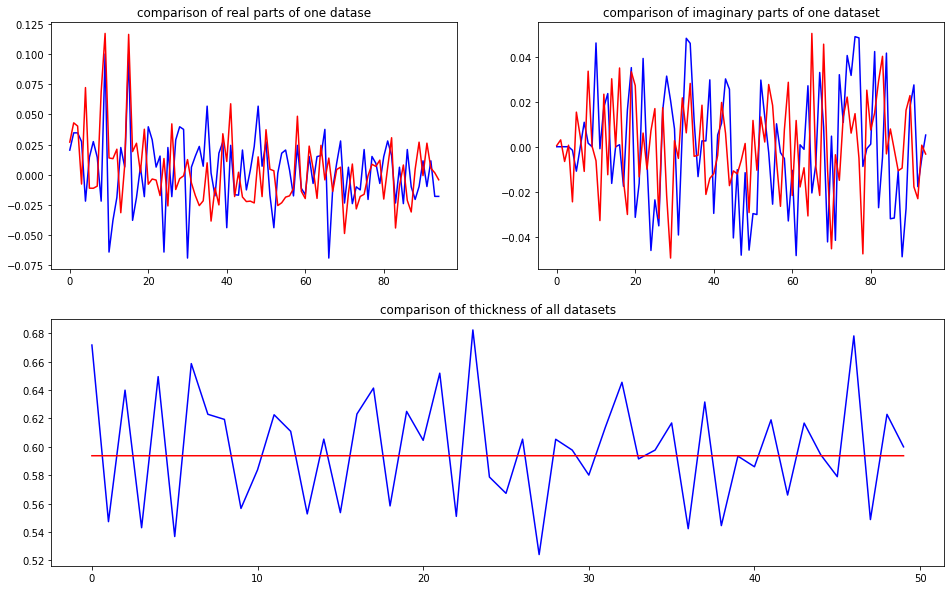

predicted thickness: 0.59368944


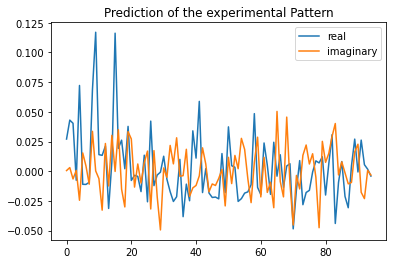

Applied shift of unit cell origin (fractional coordinates): -0.0002960485906213571 0.4688874248201738 -0.01823597653219406
Ug[ 0 ]: 0.02707 0.0  =>  0.02707 0.0
Ug[ 1 ]: 0.04197 0.11458  =>  0.04197 0.0
Ug[ 2 ]: 0.04197 -0.11458  =>  0.04197 -0.0
Ug[ 3 ]: 0.00958 -2.94611  =>  0.00958 -0.0
Ug[ 4 ]: 0.07615 -0.39112  =>  0.07615 2.44041
Ug[ 5 ]: 0.01667 2.23125  =>  0.01667 -0.99125
Ug[ 6 ]: 0.00958 2.94611  =>  0.00958 0.0
Ug[ 7 ]: 0.01667 -2.23125  =>  0.01667 0.99125
Ug[ 8 ]: 0.07615 0.39112  =>  0.07615 -2.44041
Ug[ 9 ]: 0.11664 0.00186  =>  0.11664 0.0
Ug[ 10 ]: 0.01526 -0.45282  =>  0.01526 -0.56926
Ug[ 11 ]: 0.03761 -1.12301  =>  0.03761 -1.01029
Ug[ 12 ]: 0.0305 0.68274  =>  0.0305 -2.26523
Ug[ 13 ]: 0.03214 -2.66674  =>  0.03214 0.5539
Ug[ 14 ]: 0.03057 1.40641  =>  0.03057 -1.42697
Ug[ 15 ]: 0.11664 -0.00186  =>  0.11664 -0.0
Ug[ 16 ]: 0.03761 1.12301  =>  0.03761 1.01029
Ug[ 17 ]: 0.0305 -0.68274  =>  0.0305 2.26523
Ug[ 18 ]: 0.03057 -1.40641  =>  0.03057 1.42697
Ug[ 19 ]: 0.

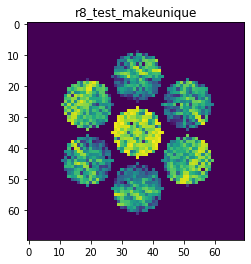

X_sim.max(): 0.9220156572717499
nlogf_X_sim.max(): 6.827646197816992
>>>replaced the 100. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 383ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 321ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 3s 334ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


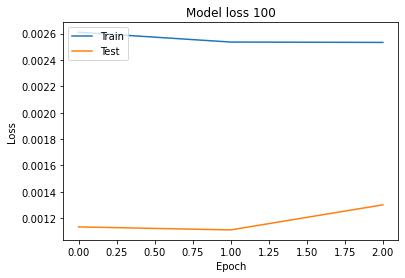

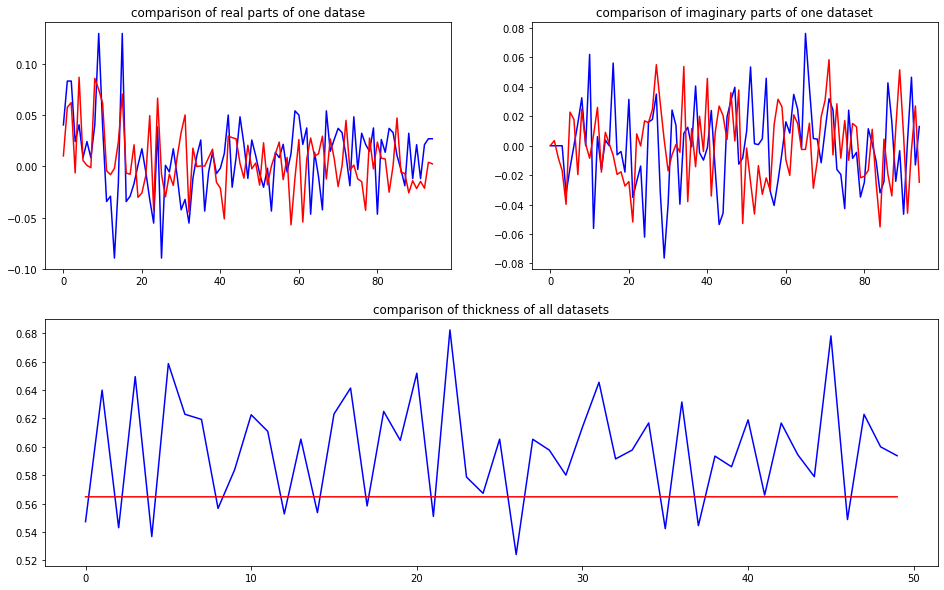

predicted thickness: 0.56477636


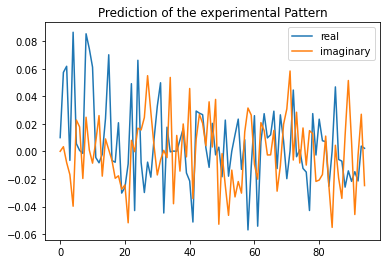

Applied shift of unit cell origin (fractional coordinates): 0.00027090359365906203 0.27593739586624916 -0.015377354464840134
Ug[ 0 ]: 0.01008 0.0  =>  0.01008 0.0
Ug[ 1 ]: 0.05995 0.09662  =>  0.05995 -0.0
Ug[ 2 ]: 0.05995 -0.09662  =>  0.05995 0.0
Ug[ 3 ]: 0.0176 -1.73377  =>  0.0176 0.0
Ug[ 4 ]: 0.09188 -0.35989  =>  0.09188 1.27726
Ug[ 5 ]: 0.02135 1.46928  =>  0.02135 -2.98352
Ug[ 6 ]: 0.0176 1.73377  =>  0.0176 -0.0
Ug[ 7 ]: 0.02135 -1.46928  =>  0.02135 2.98352
Ug[ 8 ]: 0.09188 0.35989  =>  0.09188 -1.27726
Ug[ 9 ]: 0.07242 -0.0017  =>  0.07242 0.0
Ug[ 10 ]: 0.06499 -0.19675  =>  0.06499 -0.29167
Ug[ 11 ]: 0.00881 2.24411  =>  0.00881 2.34243
Ug[ 12 ]: 0.02415 1.90901  =>  0.02415 0.17694
Ug[ 13 ]: 0.01753 -1.86155  =>  0.01753 2.59296
Ug[ 14 ]: 0.02609 0.53997  =>  0.02609 -1.09548
Ug[ 15 ]: 0.07242 0.0017  =>  0.07242 0.0
Ug[ 16 ]: 0.00881 -2.24411  =>  0.00881 -2.34243
Ug[ 17 ]: 0.02415 -1.90901  =>  0.02415 -0.17694
Ug[ 18 ]: 0.02609 -0.53997  =>  0.02609 1.09548
Ug[ 19 ]: 0.

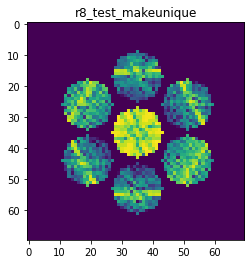

X_sim.max(): 0.9118846528939003
nlogf_X_sim.max(): 6.816609534052683
>>>replaced the 101. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 422ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 329ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 318ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


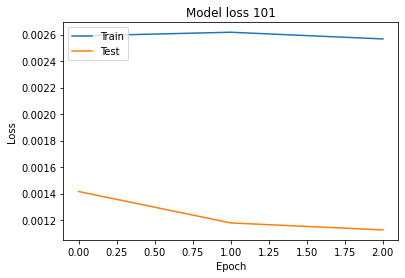

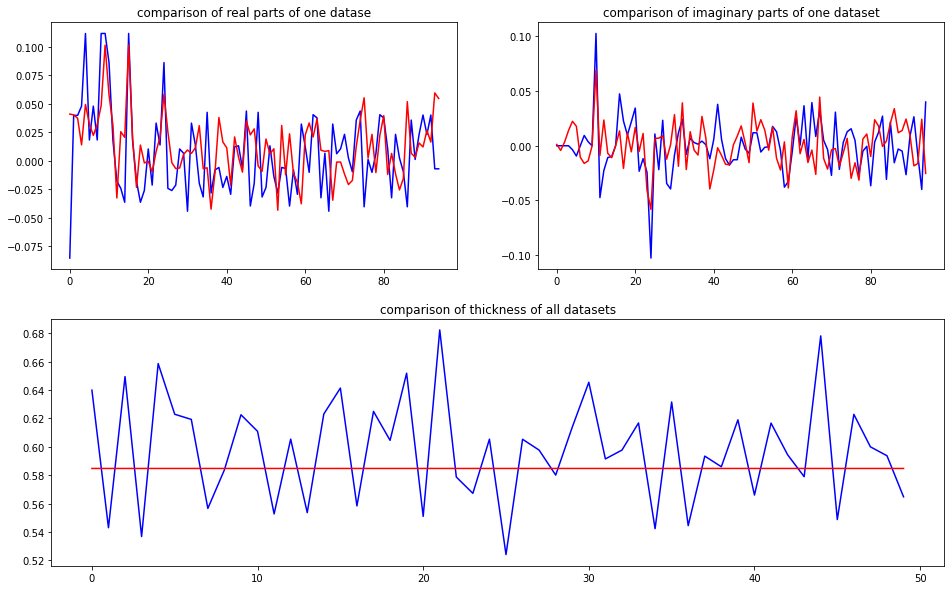

predicted thickness: 0.58473843


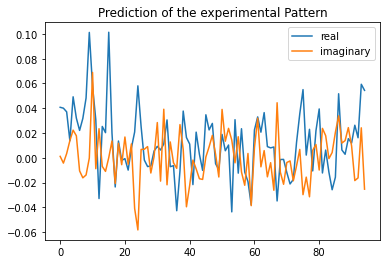

Applied shift of unit cell origin (fractional coordinates): 0.00022082813990998215 -0.09519394891720237 0.01577631396368689
Ug[ 0 ]: 0.04073 0.0  =>  0.04073 0.0
Ug[ 1 ]: 0.03874 -0.09913  =>  0.03874 -0.0
Ug[ 2 ]: 0.03874 0.09913  =>  0.03874 0.0
Ug[ 3 ]: 0.0217 0.59812  =>  0.0217 -0.0
Ug[ 4 ]: 0.05194 0.35569  =>  0.05194 -0.14331
Ug[ 5 ]: 0.03611 0.48898  =>  0.03611 -0.20827
Ug[ 6 ]: 0.0217 -0.59812  =>  0.0217 0.0
Ug[ 7 ]: 0.03611 -0.48898  =>  0.03611 0.20827
Ug[ 8 ]: 0.05194 -0.35569  =>  0.05194 0.14331
Ug[ 9 ]: 0.10096 -0.00139  =>  0.10096 -0.0
Ug[ 10 ]: 0.08577 0.83395  =>  0.08577 0.93446
Ug[ 11 ]: 0.02778 -0.41365  =>  0.02778 -0.51139
Ug[ 12 ]: 0.03584 2.47738  =>  0.03584 3.07689
Ug[ 13 ]: 0.02613 -0.26504  =>  0.02613 0.43359
Ug[ 14 ]: 0.02038 -0.59017  =>  0.02038 -0.08978
Ug[ 15 ]: 0.10096 0.00139  =>  0.10096 0.0
Ug[ 16 ]: 0.02778 0.41365  =>  0.02778 0.51139
Ug[ 17 ]: 0.03584 -2.47738  =>  0.03584 -3.07689
Ug[ 18 ]: 0.02038 0.59017  =>  0.02038 0.08978
Ug[ 19 ]: 0.

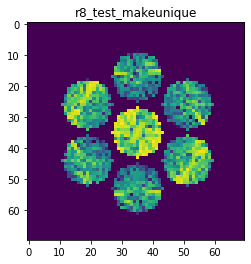

X_sim.max(): 0.9295494451715237
nlogf_X_sim.max(): 6.835775212952649
>>>replaced the 102. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 415ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 331ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 3s 322ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


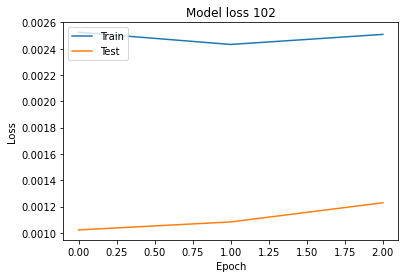

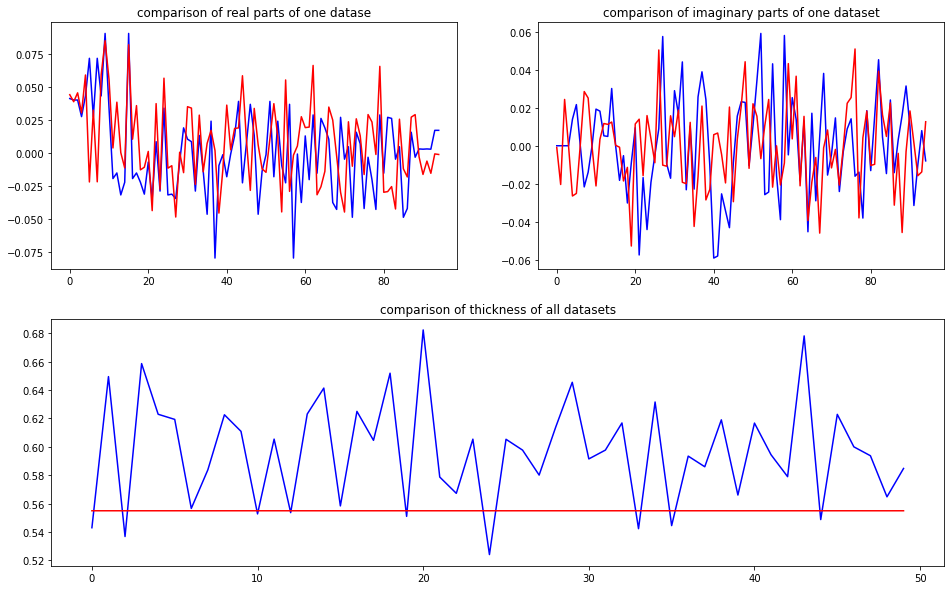

predicted thickness: 0.5549545


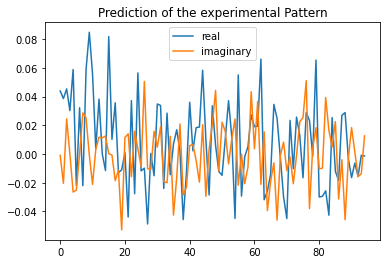

Applied shift of unit cell origin (fractional coordinates): 0.0008960124061874588 0.001353319680317343 0.07803397235377052
Ug[ 0 ]: 0.04393 0.0  =>  0.04393 0.0
Ug[ 1 ]: 0.04762 -0.4903  =>  0.04762 0.0
Ug[ 2 ]: 0.04762 0.4903  =>  0.04762 0.0
Ug[ 3 ]: 0.03122 -0.0085  =>  0.03122 -0.0
Ug[ 4 ]: 0.0644 -0.41236  =>  0.0644 0.08645
Ug[ 5 ]: 0.03475 -2.25894  =>  0.03475 -2.74074
Ug[ 6 ]: 0.03122 0.0085  =>  0.03122 0.0
Ug[ 7 ]: 0.03475 2.25894  =>  0.03475 2.74074
Ug[ 8 ]: 0.0644 0.41236  =>  0.0644 -0.08645
Ug[ 9 ]: 0.08343 -0.00563  =>  0.08343 -0.0
Ug[ 10 ]: 0.05746 -0.21807  =>  0.05746 0.27786
Ug[ 11 ]: 0.00718 0.29262  =>  0.00718 -0.19205
Ug[ 12 ]: 0.03996 0.38835  =>  0.03996 0.38547
Ug[ 13 ]: 0.01167 2.09363  =>  0.01167 2.58106
Ug[ 14 ]: 0.0171 2.3688  =>  0.0171 1.87562
Ug[ 15 ]: 0.08343 0.00563  =>  0.08343 0.0
Ug[ 16 ]: 0.00718 -0.29262  =>  0.00718 0.19205
Ug[ 17 ]: 0.03996 -0.38835  =>  0.03996 -0.38547
Ug[ 18 ]: 0.0171 -2.3688  =>  0.0171 -1.87562
Ug[ 19 ]: 0.05267 -1.768

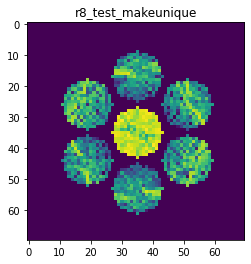

X_sim.max(): 0.9270854809091922
nlogf_X_sim.max(): 6.833123841592752
>>>replaced the 103. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 419ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 321ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 3s 340ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


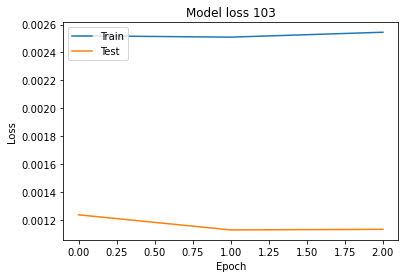

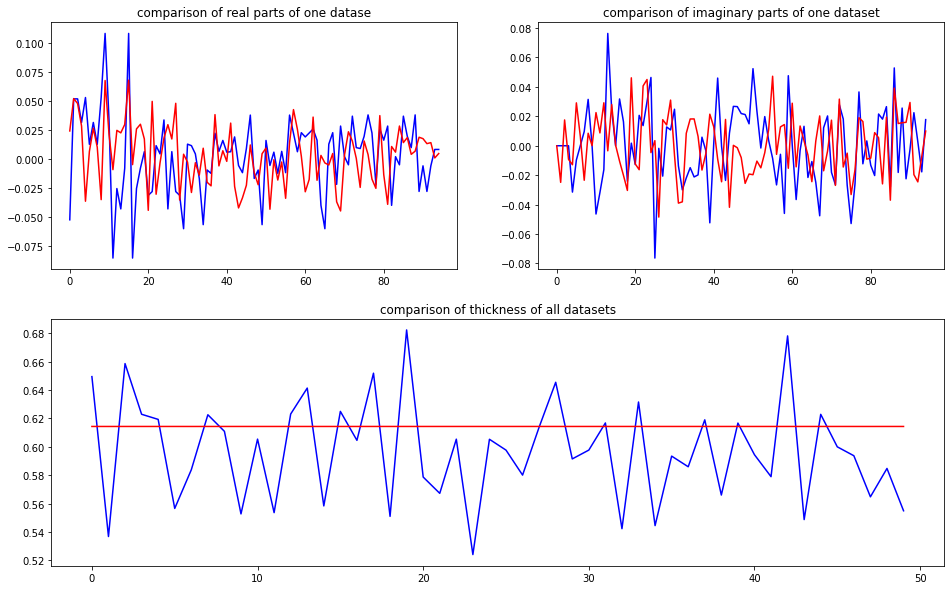

predicted thickness: 0.6143


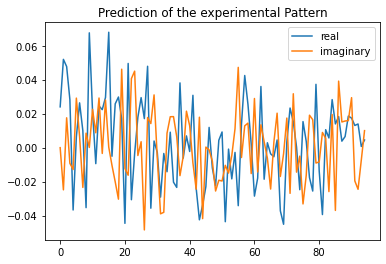

Applied shift of unit cell origin (fractional coordinates): 0.00027950787868281045 0.044739732176421104 0.06402494991355152
Ug[ 0 ]: 0.02399 0.0  =>  0.02399 0.0
Ug[ 1 ]: 0.05416 -0.40228  =>  0.05416 0.0
Ug[ 2 ]: 0.05416 0.40228  =>  0.05416 -0.0
Ug[ 3 ]: 0.02841 -0.28111  =>  0.02841 0.0
Ug[ 4 ]: 0.0376 -2.85325  =>  0.0376 -2.16986
Ug[ 5 ]: 0.02754 1.26907  =>  0.02754 1.1479
Ug[ 6 ]: 0.02841 0.28111  =>  0.02841 -0.0
Ug[ 7 ]: 0.02754 -1.26907  =>  0.02754 -1.1479
Ug[ 8 ]: 0.0376 2.85325  =>  0.0376 2.16986
Ug[ 9 ]: 0.06775 -0.00176  =>  0.06775 -0.0
Ug[ 10 ]: 0.0238 0.60814  =>  0.0238 1.01218
Ug[ 11 ]: 0.01203 2.22091  =>  0.01203 1.82039
Ug[ 12 ]: 0.03522 0.77604  =>  0.03522 0.49669
Ug[ 13 ]: 0.0261 -0.13245  =>  0.0261 -0.00953
Ug[ 14 ]: 0.0416 0.77713  =>  0.0416 0.0955
Ug[ 15 ]: 0.06775 0.00176  =>  0.06775 0.0
Ug[ 16 ]: 0.01203 -2.22091  =>  0.01203 -1.82039
Ug[ 17 ]: 0.03522 -0.77604  =>  0.03522 -0.49669
Ug[ 18 ]: 0.0416 -0.77713  =>  0.0416 -0.0955
Ug[ 19 ]: 0.05029 1.224

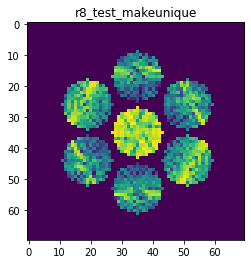

X_sim.max(): 0.9387842412756985
nlogf_X_sim.max(): 6.845650318360112
>>>replaced the 104. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 395ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 308ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 298ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


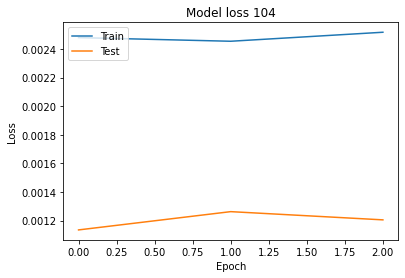

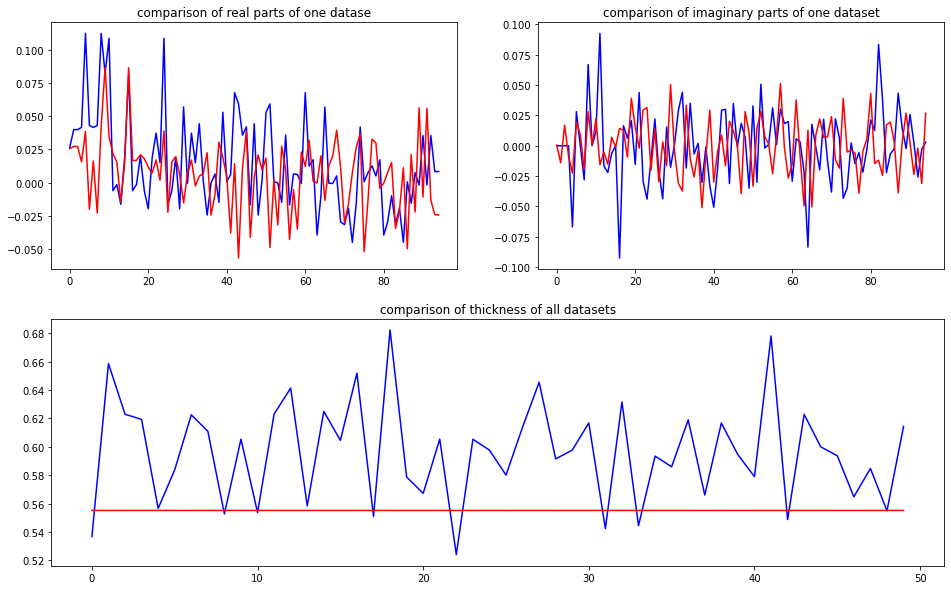

predicted thickness: 0.5551918


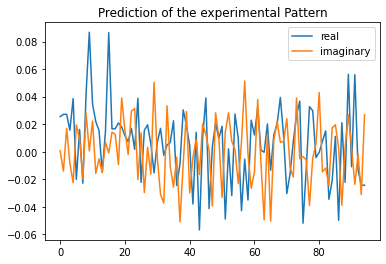

Applied shift of unit cell origin (fractional coordinates): -0.001382268172293601 0.08078375340365818 0.0827263634012605
Ug[ 0 ]: 0.02548 0.0  =>  0.02548 0.0
Ug[ 1 ]: 0.03123 -0.51979  =>  0.03123 0.0
Ug[ 2 ]: 0.03123 0.51979  =>  0.03123 0.0
Ug[ 3 ]: 0.01815 -0.50758  =>  0.01815 0.0
Ug[ 4 ]: 0.04753 -0.56036  =>  0.04753 0.467
Ug[ 5 ]: 0.02913 2.40394  =>  0.02913 2.39173
Ug[ 6 ]: 0.01815 0.50758  =>  0.01815 -0.0
Ug[ 7 ]: 0.02913 -2.40394  =>  0.02913 -2.39173
Ug[ 8 ]: 0.04753 0.56036  =>  0.04753 -0.467
Ug[ 9 ]: 0.0864 0.00869  =>  0.0864 0.0
Ug[ 10 ]: 0.04237 0.5254  =>  0.04237 1.0365
Ug[ 11 ]: 0.02433 -0.66212  =>  0.02433 -1.19059
Ug[ 12 ]: 0.01835 -0.51162  =>  0.01835 -1.02788
Ug[ 13 ]: 0.02356 -2.48352  =>  0.02356 -2.48
Ug[ 14 ]: 0.01982 0.42316  =>  0.01982 -0.61289
Ug[ 15 ]: 0.0864 -0.00869  =>  0.0864 0.0
Ug[ 16 ]: 0.02433 0.66212  =>  0.02433 1.19059
Ug[ 17 ]: 0.01835 0.51162  =>  0.01835 1.02788
Ug[ 18 ]: 0.01982 -0.42316  =>  0.01982 0.61289
Ug[ 19 ]: 0.03811 1.11832

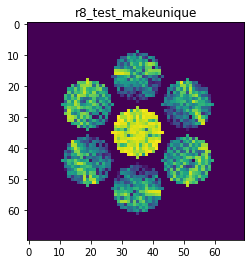

X_sim.max(): 0.9225179314893018
nlogf_X_sim.max(): 6.828190216331463
>>>replaced the 105. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 383ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 279ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 300ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


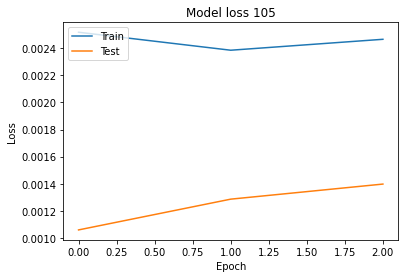

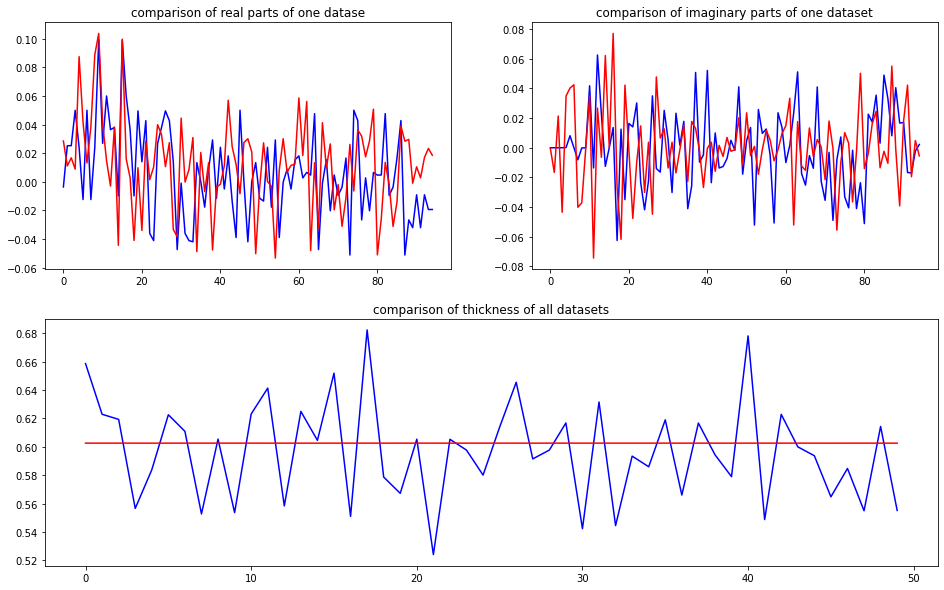

predicted thickness: 0.6025585


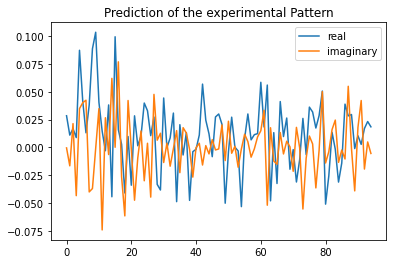

Applied shift of unit cell origin (fractional coordinates): 0.0007372224869241066 0.2101929607727872 0.14945616874917314
Ug[ 0 ]: 0.02848 0.0  =>  0.02848 0.0
Ug[ 1 ]: 0.02353 -0.93906  =>  0.02353 -0.0
Ug[ 2 ]: 0.02353 0.93906  =>  0.02353 0.0
Ug[ 3 ]: 0.04433 -1.32068  =>  0.04433 0.0
Ug[ 4 ]: 0.09516 0.3876  =>  0.09516 2.64735
Ug[ 5 ]: 0.05668 0.78778  =>  0.05668 1.1694
Ug[ 6 ]: 0.04433 1.32068  =>  0.04433 -0.0
Ug[ 7 ]: 0.05668 -0.78778  =>  0.05668 -1.1694
Ug[ 8 ]: 0.09516 -0.3876  =>  0.09516 -2.64735
Ug[ 9 ]: 0.10162 -0.00463  =>  0.10162 0.0
Ug[ 10 ]: 0.05173 0.67823  =>  0.05173 1.62192
Ug[ 11 ]: 0.0772 -1.37126  =>  0.0772 -2.30568
Ug[ 12 ]: 0.02657 1.57623  =>  0.02657 0.26018
Ug[ 13 ]: 0.03596 -0.1416  =>  0.03596 -0.51859
Ug[ 14 ]: 0.07525 2.17541  =>  0.07525 -0.0797
Ug[ 15 ]: 0.10162 0.00463  =>  0.10162 -0.0
Ug[ 16 ]: 0.0772 1.37126  =>  0.0772 2.30568
Ug[ 17 ]: 0.02657 -1.57623  =>  0.02657 -0.26018
Ug[ 18 ]: 0.07525 -2.17541  =>  0.07525 0.0797
Ug[ 19 ]: 0.04466 1.3

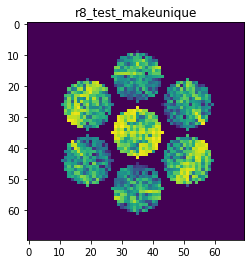

X_sim.max(): 0.8745854301507904
nlogf_X_sim.max(): 6.774892725664205
>>>replaced the 106. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 385ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 285ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 280ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000


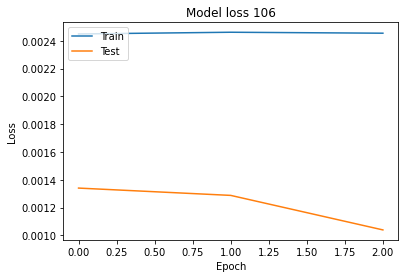

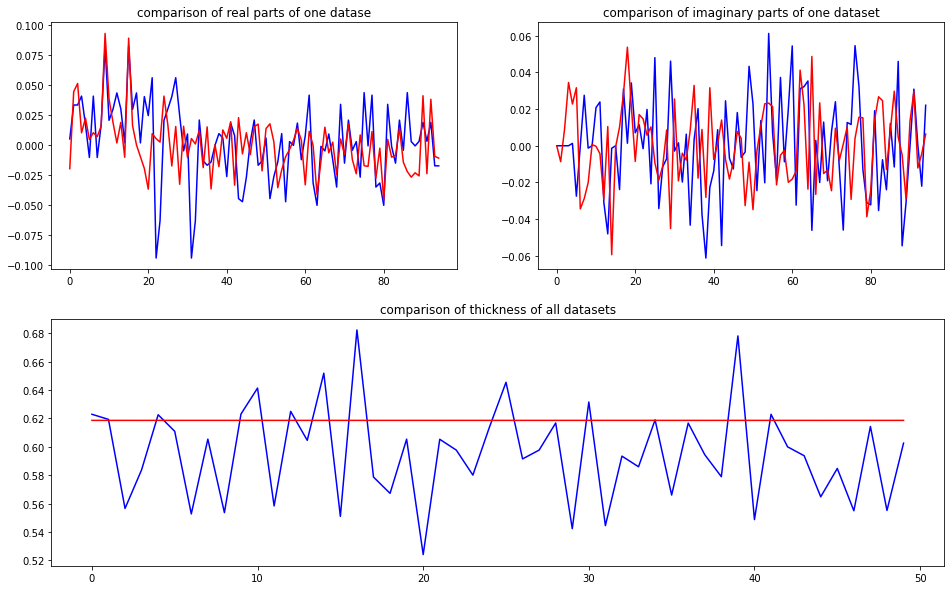

predicted thickness: 0.6185814


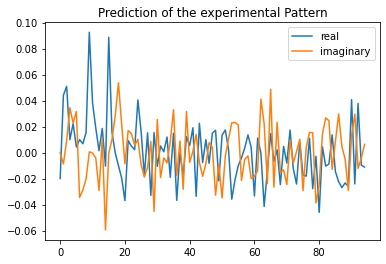

Applied shift of unit cell origin (fractional coordinates): -0.0010888104703266083 -0.20505594682473674 0.029742268733923754
Ug[ 0 ]: 0.01988 3.14159  =>  0.01988 3.14159
Ug[ 1 ]: 0.04841 -0.18688  =>  0.04841 0.0
Ug[ 2 ]: 0.04841 0.18688  =>  0.04841 0.0
Ug[ 3 ]: 0.03591 1.2884  =>  0.03591 0.0
Ug[ 4 ]: 0.02856 0.85219  =>  0.02856 -0.24934
Ug[ 5 ]: 0.03077 1.38744  =>  0.03077 -0.08784
Ug[ 6 ]: 0.03591 -1.2884  =>  0.03591 -0.0
Ug[ 7 ]: 0.03077 -1.38744  =>  0.03077 0.08784
Ug[ 8 ]: 0.02856 -0.85219  =>  0.02856 0.24934
Ug[ 9 ]: 0.09064 0.00684  =>  0.09064 -0.0
Ug[ 10 ]: 0.03966 -0.13332  =>  0.03966 0.04671
Ug[ 11 ]: 0.01877 -0.39519  =>  0.01877 -0.5889
Ug[ 12 ]: 0.02875 -1.54716  =>  0.02875 -0.2656
Ug[ 13 ]: 0.01999 0.51627  =>  0.01999 1.98471
Ug[ 14 ]: 0.05753 -1.74876  =>  0.05753 -0.65407
Ug[ 15 ]: 0.09064 -0.00684  =>  0.09064 0.0
Ug[ 16 ]: 0.01877 0.39519  =>  0.01877 0.5889
Ug[ 17 ]: 0.02875 1.54716  =>  0.02875 0.2656
Ug[ 18 ]: 0.05753 1.74876  =>  0.05753 0.65407
Ug[ 19

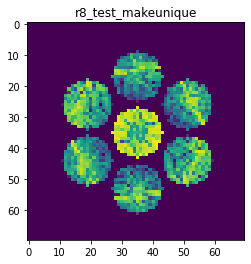

X_sim.max(): 0.9211214058552208
nlogf_X_sim.max(): 6.826676891520547
>>>replaced the 107. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 349ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 266ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 290ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


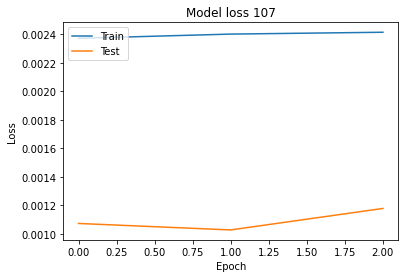

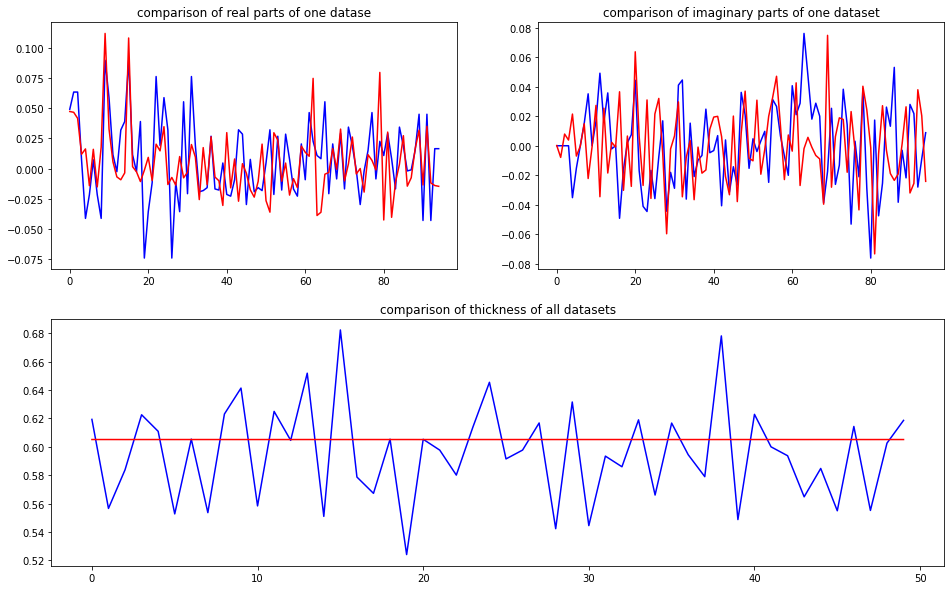

predicted thickness: 0.6050959


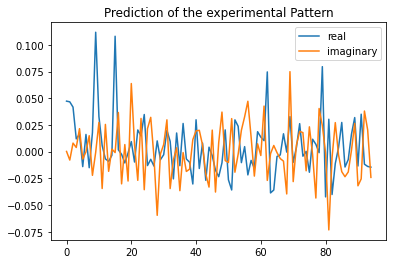

Applied shift of unit cell origin (fractional coordinates): -0.00018591045128514222 -0.023145226447505465 0.028291021440481488
Ug[ 0 ]: 0.04728 0.0  =>  0.04728 0.0
Ug[ 1 ]: 0.04485 -0.17776  =>  0.04485 0.0
Ug[ 2 ]: 0.04485 0.17776  =>  0.04485 -0.0
Ug[ 3 ]: 0.01413 0.14543  =>  0.01413 0.0
Ug[ 4 ]: 0.02773 0.90751  =>  0.02773 0.93984
Ug[ 5 ]: 0.01823 -2.49685  =>  0.01823 -2.82004
Ug[ 6 ]: 0.01413 -0.14543  =>  0.01413 0.0
Ug[ 7 ]: 0.01823 2.49685  =>  0.01823 2.82004
Ug[ 8 ]: 0.02773 -0.90751  =>  0.02773 -0.93984
Ug[ 9 ]: 0.11007 0.00117  =>  0.11007 0.0
Ug[ 10 ]: 0.04621 0.75041  =>  0.04621 0.927
Ug[ 11 ]: 0.03578 -1.46677  =>  0.03578 -1.6457
Ug[ 12 ]: 0.02822 1.73692  =>  0.02822 1.88118
Ug[ 13 ]: 0.02288 -2.0771  =>  0.02288 -1.75509
Ug[ 14 ]: 0.00737 -2.84781  =>  0.00737 -2.88131
Ug[ 15 ]: 0.11007 -0.00117  =>  0.11007 -0.0
Ug[ 16 ]: 0.03578 1.46677  =>  0.03578 1.6457
Ug[ 17 ]: 0.02822 -1.73692  =>  0.02822 -1.88118
Ug[ 18 ]: 0.00737 2.84781  =>  0.00737 2.88131
Ug[ 19 ]: 

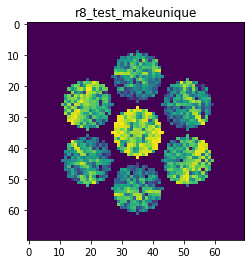

X_sim.max(): 0.8489160537293627
nlogf_X_sim.max(): 6.745137584288844
>>>replaced the 108. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 364ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 274ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 9.5243e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 275ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


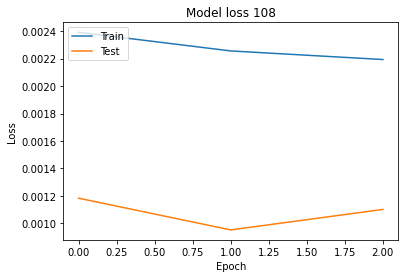

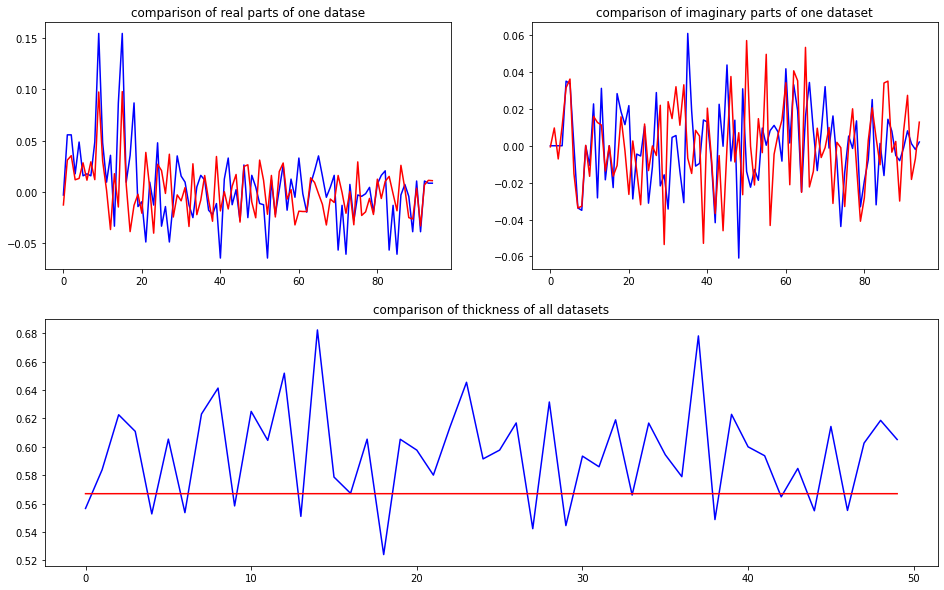

predicted thickness: 0.5669827


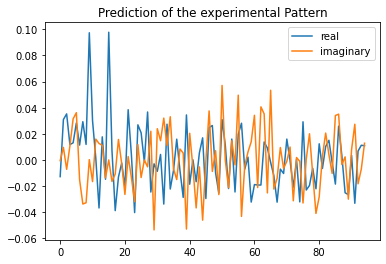

Applied shift of unit cell origin (fractional coordinates): -0.00018795658002587683 -0.13356623862127778 -0.03953625370865459
Ug[ 0 ]: 0.01278 3.14159  =>  0.01278 3.14159
Ug[ 1 ]: 0.03417 0.24841  =>  0.03417 0.0
Ug[ 2 ]: 0.03417 -0.24841  =>  0.03417 -0.0
Ug[ 3 ]: 0.01732 0.83922  =>  0.01732 0.0
Ug[ 4 ]: 0.03446 1.19911  =>  0.03446 0.11147
Ug[ 5 ]: 0.0453 0.88119  =>  0.0453 0.29038
Ug[ 6 ]: 0.01732 -0.83922  =>  0.01732 -0.0
Ug[ 7 ]: 0.0453 -0.88119  =>  0.0453 -0.29038
Ug[ 8 ]: 0.03446 -1.19911  =>  0.03446 -0.11147
Ug[ 9 ]: 0.09775 0.00118  =>  0.09775 -0.0
Ug[ 10 ]: 0.03179 -0.46219  =>  0.03179 -0.71179
Ug[ 11 ]: 0.01681 1.30709  =>  0.01681 1.55432
Ug[ 12 ]: 0.03951 2.84166  =>  0.03951 -2.60349
Ug[ 13 ]: 0.02286 0.57071  =>  0.02286 1.16034
Ug[ 14 ]: 0.02025 -2.3293  =>  0.02025 -1.24285
Ug[ 15 ]: 0.09775 -0.00118  =>  0.09775 0.0
Ug[ 16 ]: 0.01681 -1.30709  =>  0.01681 -1.55432
Ug[ 17 ]: 0.03951 -2.84166  =>  0.03951 2.60349
Ug[ 18 ]: 0.02025 2.3293  =>  0.02025 1.24285
Ug[

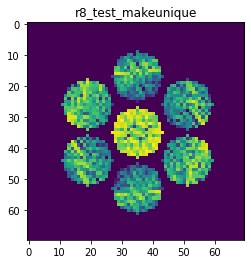

X_sim.max(): 0.8758364438178439
nlogf_X_sim.max(): 6.776320479903239
>>>replaced the 109. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 328ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 9.7511e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 241ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 237ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


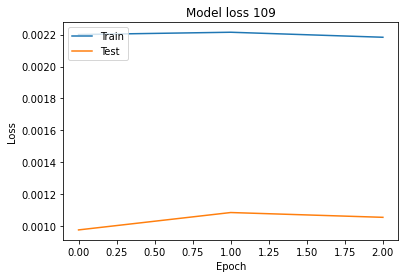

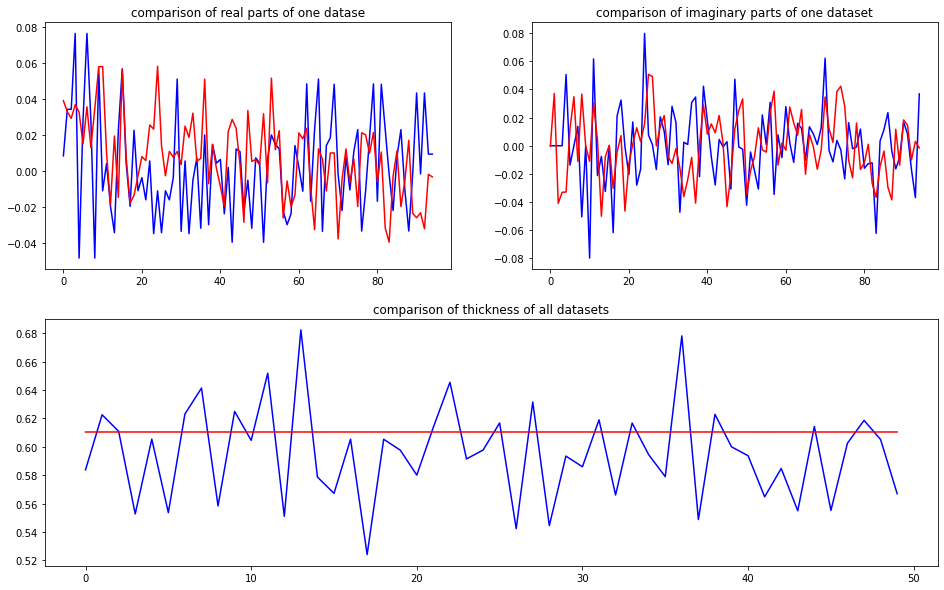

predicted thickness: 0.6104111


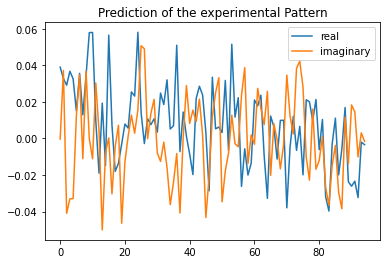

Applied shift of unit cell origin (fractional coordinates): 0.0006718248895455341 0.11989644444847757 -0.14325748647276887
Ug[ 0 ]: 0.03899 0.0  =>  0.03899 0.0
Ug[ 1 ]: 0.04984 0.90011  =>  0.04984 0.0
Ug[ 2 ]: 0.04984 -0.90011  =>  0.04984 0.0
Ug[ 3 ]: 0.04957 -0.75333  =>  0.04957 0.0
Ug[ 4 ]: 0.04831 -0.80303  =>  0.04831 -0.94981
Ug[ 5 ]: 0.0182 0.69441  =>  0.0182 2.34785
Ug[ 6 ]: 0.04957 0.75333  =>  0.04957 0.0
Ug[ 7 ]: 0.0182 -0.69441  =>  0.0182 -2.34785
Ug[ 8 ]: 0.04831 0.80303  =>  0.04831 0.94981
Ug[ 9 ]: 0.05719 -0.00422  =>  0.05719 0.0
Ug[ 10 ]: 0.05953 -0.22623  =>  0.05953 -1.12212
Ug[ 11 ]: 0.03147 1.29625  =>  0.03147 2.20059
Ug[ 12 ]: 0.01895 2.91801  =>  0.01895 2.16889
Ug[ 13 ]: 0.05305 -1.2504  =>  0.05305 -2.89962
Ug[ 14 ]: 0.01605 -2.6556  =>  0.01605 -2.5046
Ug[ 15 ]: 0.05719 0.00422  =>  0.05719 0.0
Ug[ 16 ]: 0.03147 -1.29625  =>  0.03147 -2.20059
Ug[ 17 ]: 0.01895 -2.91801  =>  0.01895 -2.16889
Ug[ 18 ]: 0.01605 2.6556  =>  0.01605 2.5046
Ug[ 19 ]: 0.04778 

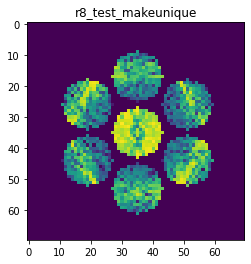

X_sim.max(): 0.9405105707285055
nlogf_X_sim.max(): 6.847485575573749
>>>replaced the 110. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 392ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 9.9578e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 284ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 269ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


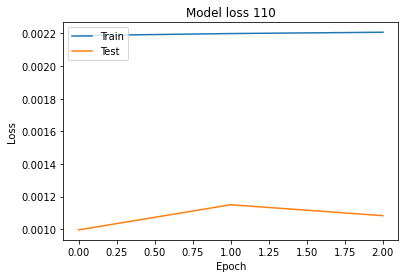

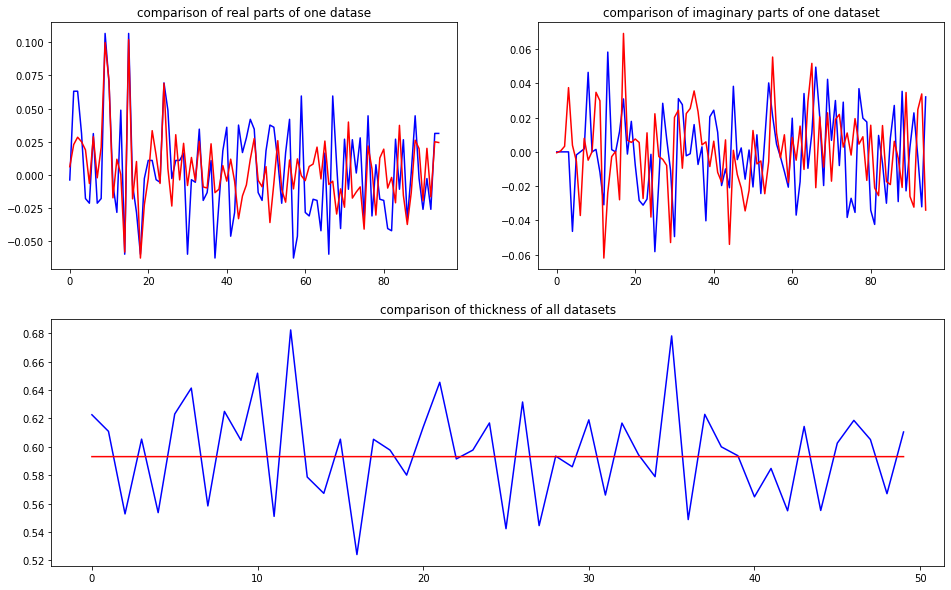

predicted thickness: 0.5930589


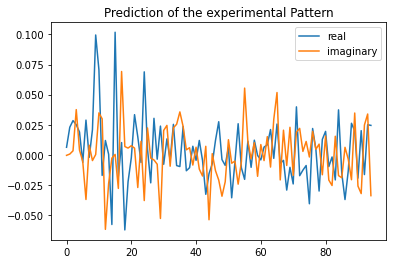

Applied shift of unit cell origin (fractional coordinates): 7.92669850616414e-05 -0.15071620160838242 0.008370170555540051
Ug[ 0 ]: 0.0062 0.0  =>  0.0062 0.0
Ug[ 1 ]: 0.02566 -0.05259  =>  0.02566 0.0
Ug[ 2 ]: 0.02566 0.05259  =>  0.02566 0.0
Ug[ 3 ]: 0.04603 0.94698  =>  0.04603 0.0
Ug[ 4 ]: 0.02031 0.2162  =>  0.02031 -0.67818
Ug[ 5 ]: 0.00794 -2.14022  =>  0.00794 -3.13978
Ug[ 6 ]: 0.04603 -0.94698  =>  0.04603 0.0
Ug[ 7 ]: 0.00794 2.14022  =>  0.00794 3.13978
Ug[ 8 ]: 0.02031 -0.2162  =>  0.02031 0.67818
Ug[ 9 ]: 0.10074 -0.0005  =>  0.10074 0.0
Ug[ 10 ]: 0.07873 0.48142  =>  0.07873 0.53451
Ug[ 11 ]: 0.03387 2.11728  =>  0.03387 2.06519
Ug[ 12 ]: 0.06655 -1.40499  =>  0.06655 -0.45752
Ug[ 13 ]: 0.02319 -1.45839  =>  0.02319 -0.45833
Ug[ 14 ]: 0.06046 -3.06195  =>  0.06046 -2.16707
Ug[ 15 ]: 0.10074 0.0005  =>  0.10074 0.0
Ug[ 16 ]: 0.03387 -2.11728  =>  0.03387 -2.06519
Ug[ 17 ]: 0.06655 1.40499  =>  0.06655 0.45752
Ug[ 18 ]: 0.06046 3.06195  =>  0.06046 2.16707
Ug[ 19 ]: 0.02328

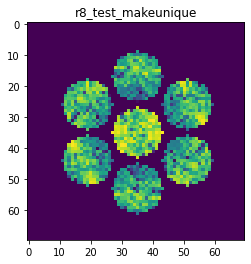

X_sim.max(): 0.8798934757767702
nlogf_X_sim.max(): 6.78093670577293
>>>replaced the 111. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 370ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 237ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 265ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


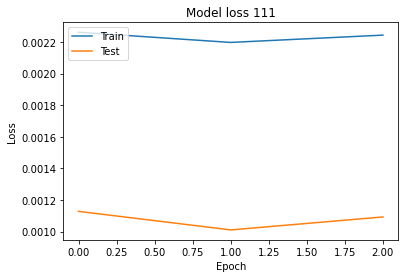

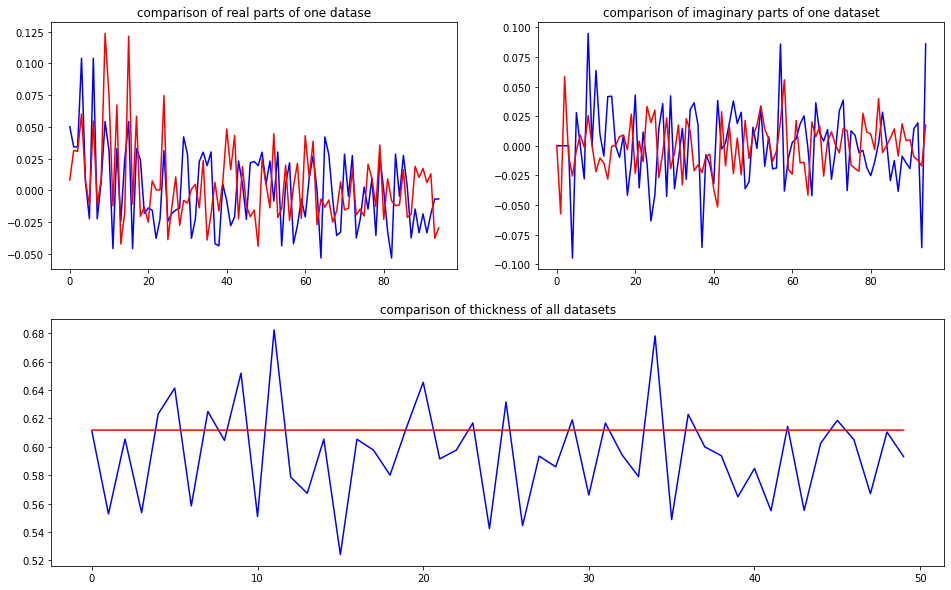

predicted thickness: 0.6117411


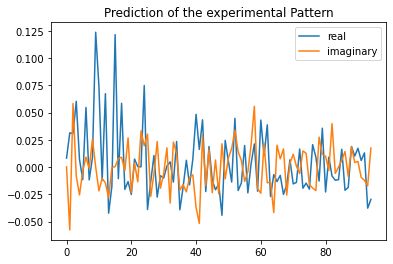

Applied shift of unit cell origin (fractional coordinates): 0.00020044220063856818 0.023754418211215825 0.1715262298926169
Ug[ 0 ]: 0.00821 0.0  =>  0.00821 0.0
Ug[ 1 ]: 0.06579 -1.07773  =>  0.06579 -0.0
Ug[ 2 ]: 0.06579 1.07773  =>  0.06579 0.0
Ug[ 3 ]: 0.05819 -0.14925  =>  0.05819 0.0
Ug[ 4 ]: 0.02676 -1.27077  =>  0.02676 -0.04378
Ug[ 5 ]: 0.01176 -3.02967  =>  0.01176 2.32504
Ug[ 6 ]: 0.05819 0.14925  =>  0.05819 0.0
Ug[ 7 ]: 0.01176 3.02967  =>  0.01176 -2.32504
Ug[ 8 ]: 0.02676 1.27077  =>  0.02676 0.04378
Ug[ 9 ]: 0.12291 -0.00126  =>  0.12291 0.0
Ug[ 10 ]: 0.07739 -0.2704  =>  0.07739 0.80859
Ug[ 11 ]: 0.01459 -2.47247  =>  0.01459 2.73424
Ug[ 12 ]: 0.06407 -0.18458  =>  0.06407 -0.33258
Ug[ 13 ]: 0.04995 -2.51833  =>  0.04995 -1.58859
Ug[ 14 ]: 0.01919 3.06706  =>  0.01919 1.84134
Ug[ 15 ]: 0.12291 0.00126  =>  0.12291 0.0
Ug[ 16 ]: 0.01459 2.47247  =>  0.01459 -2.73424
Ug[ 17 ]: 0.06407 0.18458  =>  0.06407 0.33258
Ug[ 18 ]: 0.01919 -3.06706  =>  0.01919 -1.84134
Ug[ 19 ]: 

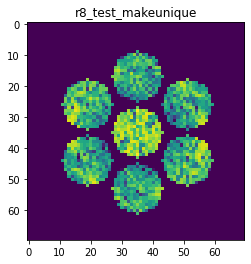

X_sim.max(): 0.913144166530138
nlogf_X_sim.max(): 6.817988290449267
>>>replaced the 112. dataset and train: 
Epoch 1/3
8/8 [==============================] - 5s 414ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 336ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 3s 320ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


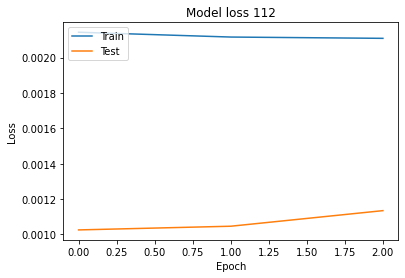

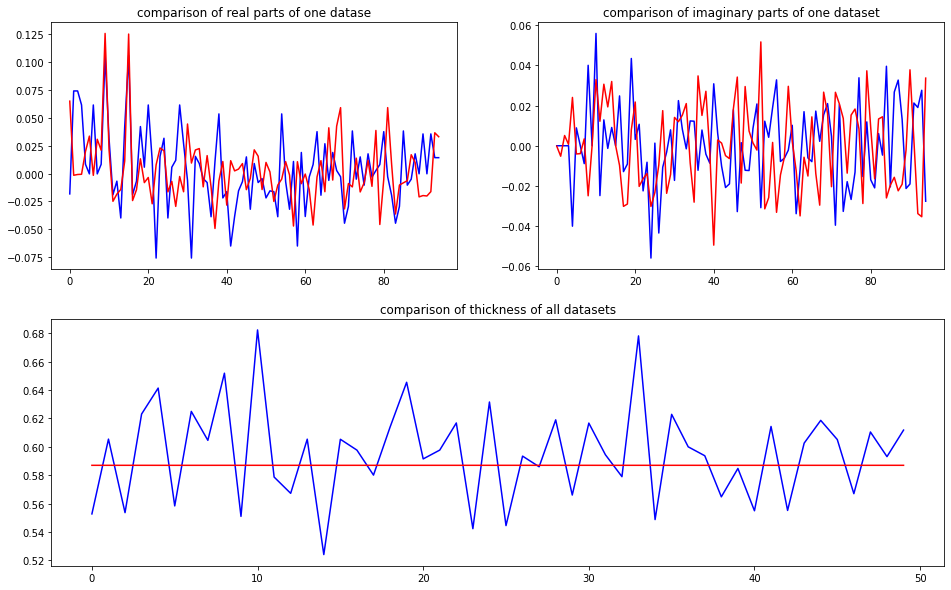

predicted thickness: 0.58694834


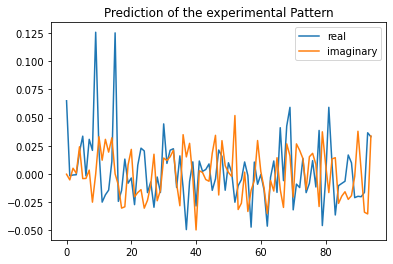

Applied shift of unit cell origin (fractional coordinates): 0.00013408236286458476 -0.32384937946032666 0.28754796537346206
Ug[ 0 ]: 0.06487 0.0  =>  0.06487 0.0
Ug[ 1 ]: 0.0053 -1.80672  =>  0.0053 0.0
Ug[ 2 ]: 0.0053 1.80672  =>  0.0053 0.0
Ug[ 3 ]: 0.00258 2.03481  =>  0.00258 -0.0
Ug[ 4 ]: 0.03182 0.87882  =>  0.03182 0.65073
Ug[ 5 ]: 0.03231 -0.1163  =>  0.03231 2.32536
Ug[ 6 ]: 0.00258 -2.03481  =>  0.00258 0.0
Ug[ 7 ]: 0.03231 0.1163  =>  0.03231 -2.32536
Ug[ 8 ]: 0.03182 -0.87882  =>  0.03182 -0.65073
Ug[ 9 ]: 0.12543 -0.00084  =>  0.12543 0.0
Ug[ 10 ]: 0.03801 0.98271  =>  0.03801 2.79027
Ug[ 11 ]: 0.02692 2.72003  =>  0.02692 0.91416
Ug[ 12 ]: 0.03462 2.06746  =>  0.03462 -2.18008
Ug[ 13 ]: 0.02629 2.19545  =>  0.02629 -0.24537
Ug[ 14 ]: 0.03287 1.1905  =>  0.03287 1.41943
Ug[ 15 ]: 0.12543 0.00084  =>  0.12543 0.0
Ug[ 16 ]: 0.02692 -2.72003  =>  0.02692 -0.91416
Ug[ 17 ]: 0.03462 -2.06746  =>  0.03462 2.18008
Ug[ 18 ]: 0.03287 -1.1905  =>  0.03287 -1.41943
Ug[ 19 ]: 0.01163 

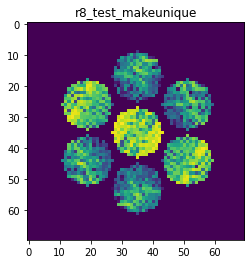

X_sim.max(): 0.9381030878455124
nlogf_X_sim.max(): 6.844925257895368
>>>replaced the 113. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 442ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 9.8271e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 263ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 298ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000


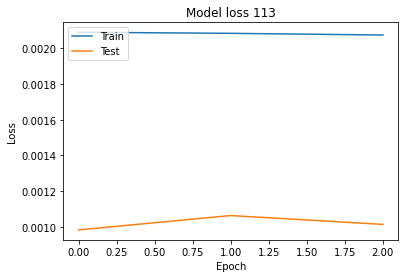

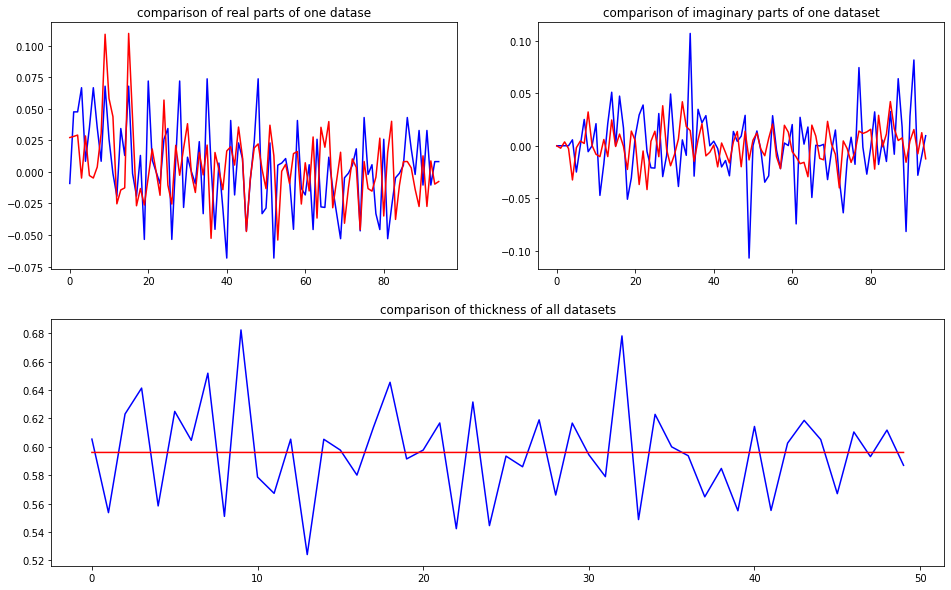

predicted thickness: 0.5960064


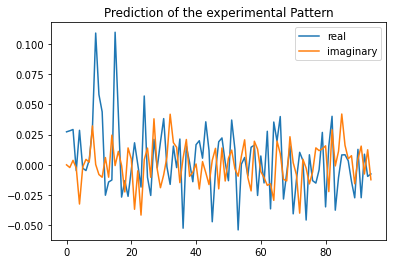

Applied shift of unit cell origin (fractional coordinates): -0.0006669420563646001 0.3987592949700138 0.016508261124621552
Ug[ 0 ]: 0.02728 0.0  =>  0.02728 0.0
Ug[ 1 ]: 0.02884 -0.10372  =>  0.02884 0.0
Ug[ 2 ]: 0.02884 0.10372  =>  0.02884 -0.0
Ug[ 3 ]: 0.006 -2.50548  =>  0.006 0.0
Ug[ 4 ]: 0.04386 -0.82917  =>  0.04386 1.78003
Ug[ 5 ]: 0.00207 -1.30666  =>  0.00207 1.09509
Ug[ 6 ]: 0.006 2.50548  =>  0.006 0.0
Ug[ 7 ]: 0.00207 1.30666  =>  0.00207 -1.09509
Ug[ 8 ]: 0.04386 0.82917  =>  0.04386 -1.78003
Ug[ 9 ]: 0.10965 0.00419  =>  0.10965 0.0
Ug[ 10 ]: 0.05795 -0.10666  =>  0.05795 -0.00713
Ug[ 11 ]: 0.04435 -0.24408  =>  0.04435 -0.352
Ug[ 12 ]: 0.02622 3.01638  =>  0.02622 0.50672
Ug[ 13 ]: 0.01725 -2.36852  =>  0.01725 1.50872
Ug[ 14 ]: 0.02683 2.07179  =>  0.02683 -0.5416
Ug[ 15 ]: 0.10965 -0.00419  =>  0.10965 0.0
Ug[ 16 ]: 0.04435 0.24408  =>  0.04435 0.352
Ug[ 17 ]: 0.02622 -3.01638  =>  0.02622 -0.50672
Ug[ 18 ]: 0.02683 -2.07179  =>  0.02683 0.5416
Ug[ 19 ]: 0.02852 2.700

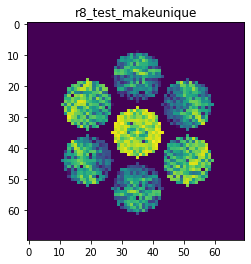

X_sim.max(): 0.9788323054389432
nlogf_X_sim.max(): 6.887381440123413
>>>replaced the 114. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 365ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 292ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 268ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 9.8005e-04 - val_acc: 1.0000


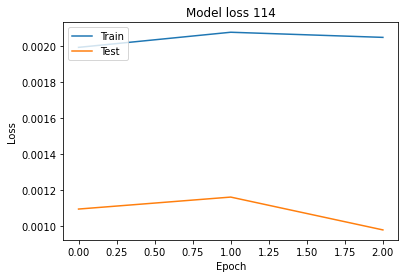

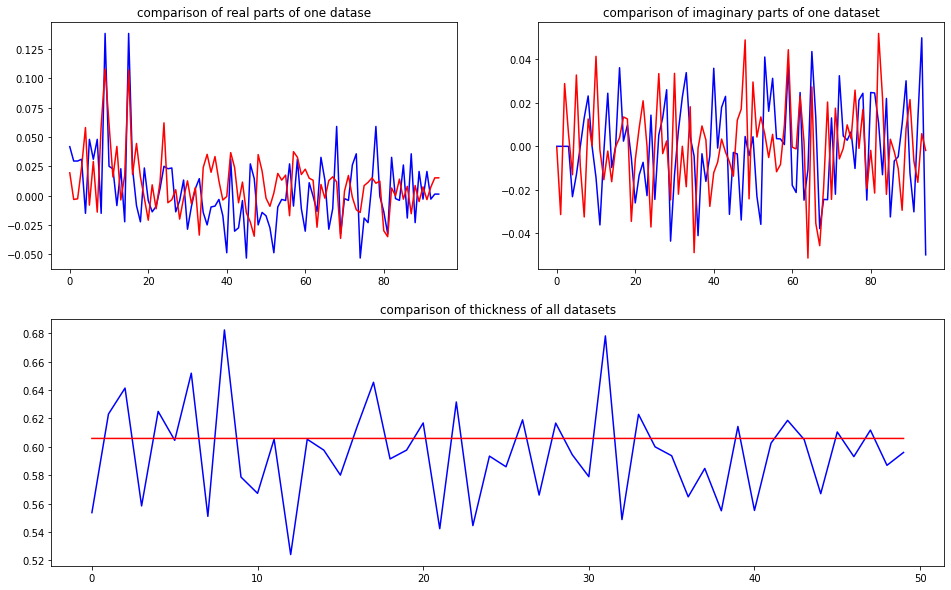

predicted thickness: 0.60586655


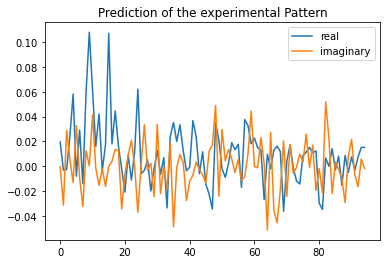

Applied shift of unit cell origin (fractional coordinates): -0.00031498152839277765 -0.04309780495311269 0.2654537730373182
Ug[ 0 ]: 0.01949 0.0  =>  0.01949 0.0
Ug[ 1 ]: 0.03029 -1.6679  =>  0.03029 0.0
Ug[ 2 ]: 0.03029 1.6679  =>  0.03029 -0.0
Ug[ 3 ]: 0.02761 0.27079  =>  0.02761 -0.0
Ug[ 4 ]: 0.06037 -0.21422  =>  0.06037 1.18289
Ug[ 5 ]: 0.03447 1.89622  =>  0.03447 -0.04247
Ug[ 6 ]: 0.02761 -0.27079  =>  0.02761 0.0
Ug[ 7 ]: 0.03447 -1.89622  =>  0.03447 0.04247
Ug[ 8 ]: 0.06037 0.21422  =>  0.06037 -1.18289
Ug[ 9 ]: 0.10794 0.00198  =>  0.10794 0.0
Ug[ 10 ]: 0.07324 0.56611  =>  0.07324 2.23202
Ug[ 11 ]: 0.01718 -0.16263  =>  0.01718 -1.83251
Ug[ 12 ]: 0.04569 -0.32151  =>  0.04569 -0.0527
Ug[ 13 ]: 0.00517 -2.78821  =>  0.00517 -0.85151
Ug[ 14 ]: 0.02205 -0.71467  =>  0.02205 -2.11376
Ug[ 15 ]: 0.10794 -0.00198  =>  0.10794 0.0
Ug[ 16 ]: 0.01718 0.16263  =>  0.01718 1.83251
Ug[ 17 ]: 0.04569 0.32151  =>  0.04569 0.0527
Ug[ 18 ]: 0.02205 0.71467  =>  0.02205 2.11376
Ug[ 19 ]: 0.

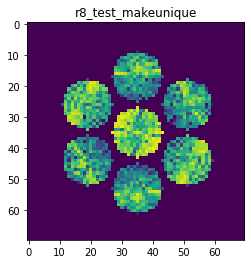

X_sim.max(): 0.9618750345731429
nlogf_X_sim.max(): 6.869923636579288
>>>replaced the 115. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 363ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 280ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 9.9318e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 284ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 9.0791e-04 - val_acc: 1.0000


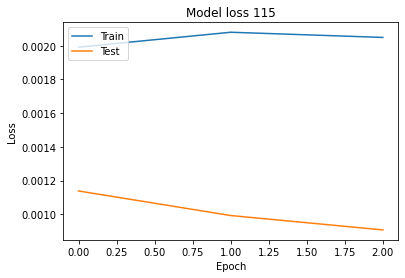

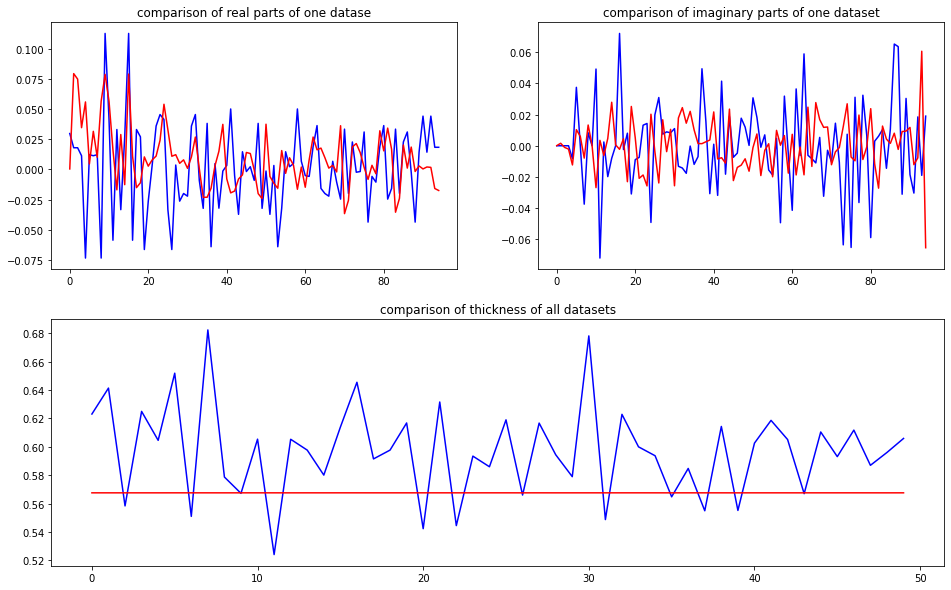

predicted thickness: 0.5675762


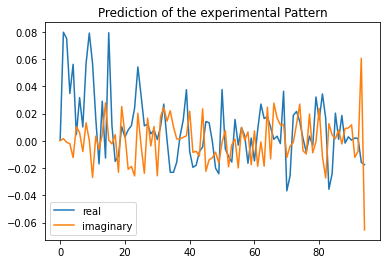

Applied shift of unit cell origin (fractional coordinates): 0.00042879385456037994 0.019384393693299914 -0.0027099588188864744
Ug[ 0 ]: 0.00045 0.0  =>  0.00045 0.0
Ug[ 1 ]: 0.07733 0.01703  =>  0.07733 0.0
Ug[ 2 ]: 0.07733 -0.01703  =>  0.07733 -0.0
Ug[ 3 ]: 0.03346 -0.1218  =>  0.03346 0.0
Ug[ 4 ]: 0.05784 -0.22303  =>  0.05784 -0.11826
Ug[ 5 ]: 0.01173 0.89014  =>  0.01173 1.02896
Ug[ 6 ]: 0.03346 0.1218  =>  0.03346 0.0
Ug[ 7 ]: 0.01173 -0.89014  =>  0.01173 -1.02896
Ug[ 8 ]: 0.05784 0.22303  =>  0.05784 0.11826
Ug[ 9 ]: 0.0791 -0.00269  =>  0.0791 0.0
Ug[ 10 ]: 0.06023 -0.40163  =>  0.06023 -0.41596
Ug[ 11 ]: 0.01391 0.20743  =>  0.01391 0.22715
Ug[ 12 ]: 0.0169 -2.81913  =>  0.0169 -2.93823
Ug[ 13 ]: 0.0313 0.13541  =>  0.0313 -0.00071
Ug[ 14 ]: 0.02808 2.00633  =>  0.02808 1.90426
Ug[ 15 ]: 0.0791 0.00269  =>  0.0791 0.0
Ug[ 16 ]: 0.01391 -0.20743  =>  0.01391 -0.22715
Ug[ 17 ]: 0.0169 2.81913  =>  0.0169 2.93823
Ug[ 18 ]: 0.02808 -2.00633  =>  0.02808 -1.90426
Ug[ 19 ]: 0.02676

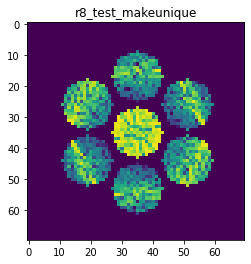

X_sim.max(): 0.9082773065908833
nlogf_X_sim.max(): 6.81265011541052
>>>replaced the 116. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 354ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 9.1179e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 269ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 9.9192e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 284ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 9.3037e-04 - val_acc: 1.0000


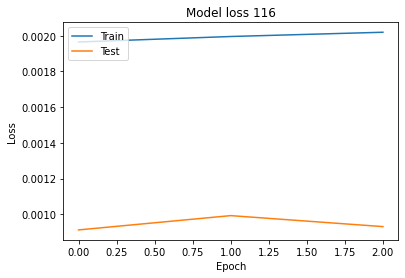

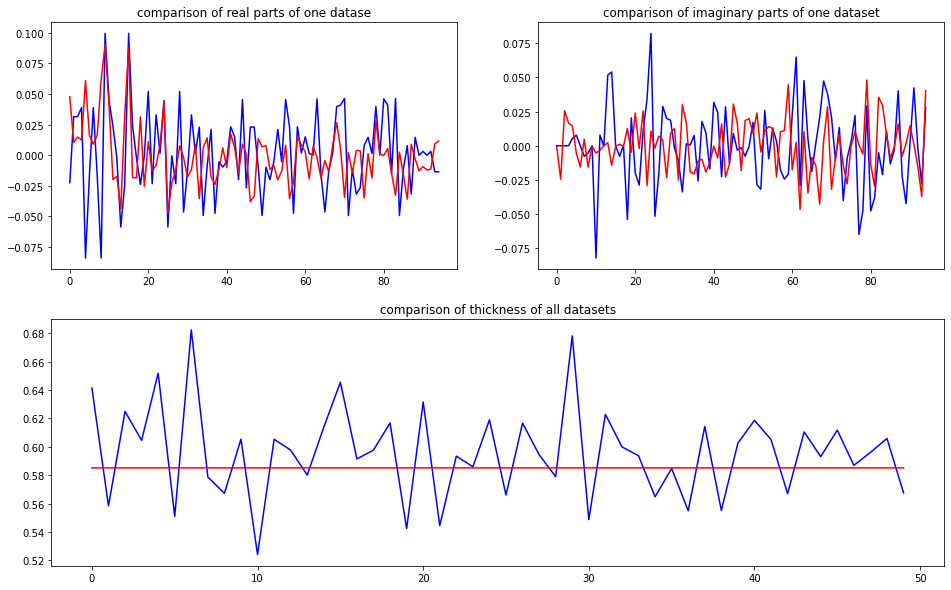

predicted thickness: 0.5851381


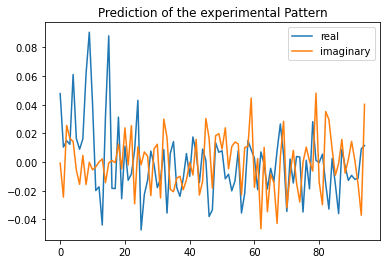

Applied shift of unit cell origin (fractional coordinates): -0.00036164632508762725 -0.15651919976396145 0.17550490033068836
Ug[ 0 ]: 0.04769 0.0  =>  0.04769 0.0
Ug[ 1 ]: 0.02803 -1.10273  =>  0.02803 0.0
Ug[ 2 ]: 0.02803 1.10273  =>  0.02803 -0.0
Ug[ 3 ]: 0.01927 0.98344  =>  0.01927 -0.0
Ug[ 4 ]: 0.06305 0.23978  =>  0.06305 0.35907
Ug[ 5 ]: 0.01703 -0.30656  =>  0.01703 -2.39273
Ug[ 6 ]: 0.01927 -0.98344  =>  0.01927 0.0
Ug[ 7 ]: 0.01703 0.30656  =>  0.01703 2.39273
Ug[ 8 ]: 0.06305 -0.23978  =>  0.06305 -0.35907
Ug[ 9 ]: 0.08905 0.00227  =>  0.08905 -0.0
Ug[ 10 ]: 0.04255 -0.1901  =>  0.04255 0.91036
Ug[ 11 ]: 0.01919 -3.02654  =>  0.01919 2.15164
Ug[ 12 ]: 0.01783 3.12832  =>  0.01783 -2.1737
Ug[ 13 ]: 0.04564 3.09722  =>  0.04564 -1.10207
Ug[ 14 ]: 0.03454 -0.40033  =>  0.03454 -0.52189
Ug[ 15 ]: 0.08905 -0.00227  =>  0.08905 0.0
Ug[ 16 ]: 0.01919 3.02654  =>  0.01919 -2.15164
Ug[ 17 ]: 0.01783 -3.12832  =>  0.01783 2.1737
Ug[ 18 ]: 0.03454 0.40033  =>  0.03454 0.52189
Ug[ 19 ]:

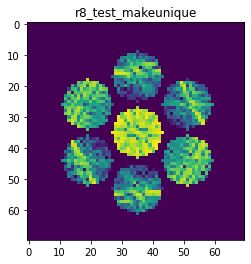

X_sim.max(): 0.915455062291666
nlogf_X_sim.max(): 6.8205130342082265
>>>replaced the 117. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 401ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 9.5029e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 278ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 8.8360e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 290ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 9.6332e-04 - val_acc: 1.0000


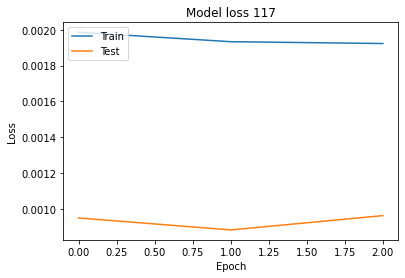

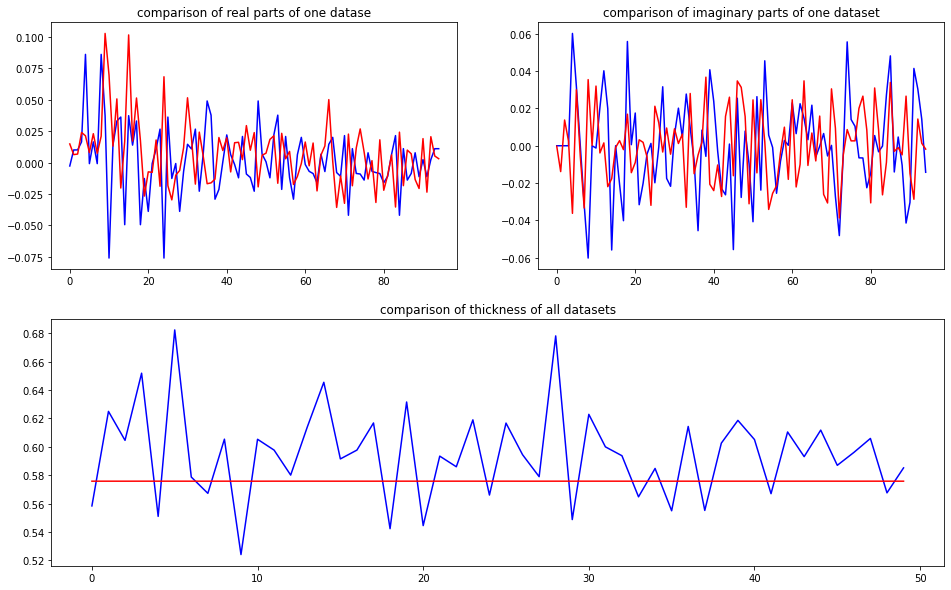

predicted thickness: 0.5757834


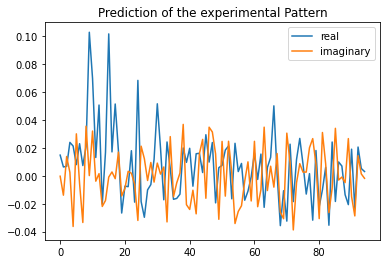

Applied shift of unit cell origin (fractional coordinates): -0.0008357093444202788 -0.027562971588476332 0.17967734045271921
Ug[ 0 ]: 0.0148 0.0  =>  0.0148 0.0
Ug[ 1 ]: 0.01532 -1.12895  =>  0.01532 0.0
Ug[ 2 ]: 0.01532 1.12895  =>  0.01532 -0.0
Ug[ 3 ]: 0.02381 0.17318  =>  0.02381 0.0
Ug[ 4 ]: 0.04167 -1.03788  =>  0.04167 -0.08212
Ug[ 5 ]: 0.03265 1.33386  =>  0.03265 0.03173
Ug[ 6 ]: 0.02381 -0.17318  =>  0.02381 0.0
Ug[ 7 ]: 0.03265 -1.33386  =>  0.03265 -0.03173
Ug[ 8 ]: 0.04167 1.03788  =>  0.04167 0.08212
Ug[ 9 ]: 0.10225 0.00525  =>  0.10225 0.0
Ug[ 10 ]: 0.0761 0.43399  =>  0.0761 1.55768
Ug[ 11 ]: 0.01545 -0.21573  =>  0.01545 -1.34992
Ug[ 12 ]: 0.05108 0.03534  =>  0.05108 0.20327
Ug[ 13 ]: 0.02898 -2.30163  =>  0.02898 -1.00475
Ug[ 14 ]: 0.02445 -0.78675  =>  0.02445 -1.74776
Ug[ 15 ]: 0.10225 -0.00525  =>  0.10225 0.0
Ug[ 16 ]: 0.01545 0.21573  =>  0.01545 1.34992
Ug[ 17 ]: 0.05108 -0.03534  =>  0.05108 -0.20327
Ug[ 18 ]: 0.02445 0.78675  =>  0.02445 1.74776
Ug[ 19 ]: 0.

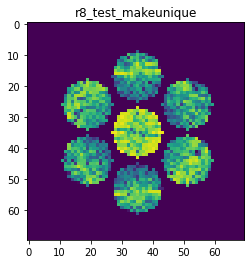

X_sim.max(): 0.9568365492026106
nlogf_X_sim.max(): 6.864677146715439
>>>replaced the 118. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 364ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 9.1634e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 276ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 274ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 9.4363e-04 - val_acc: 1.0000


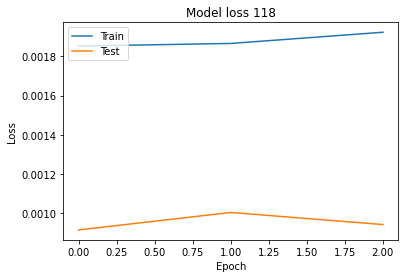

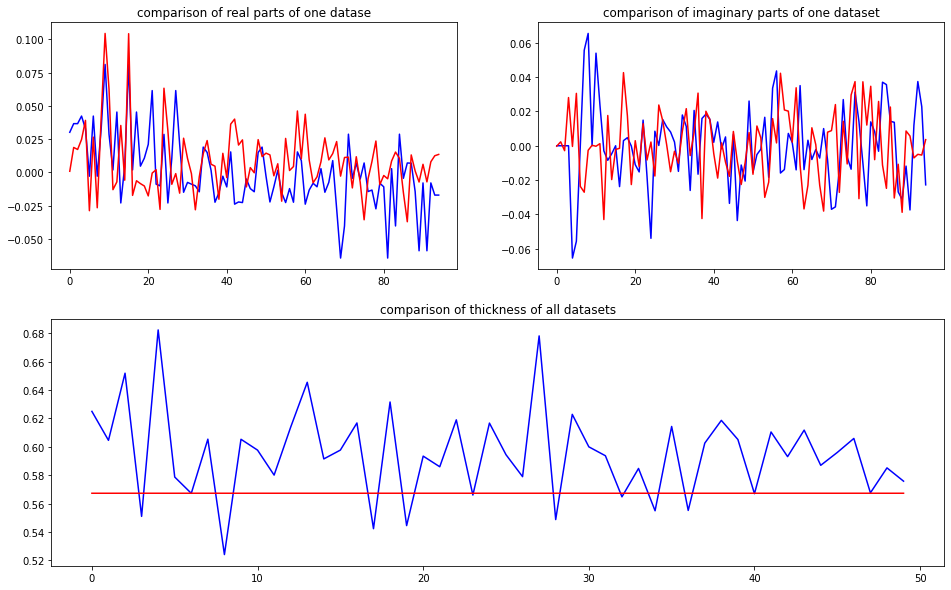

predicted thickness: 0.5672913


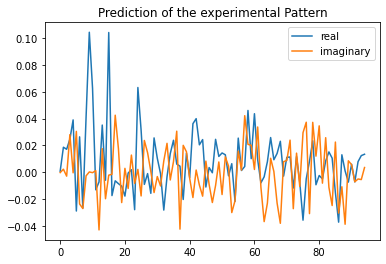

Applied shift of unit cell origin (fractional coordinates): -0.0018400157357077501 -0.12582395488075782 -0.022789316475114542
Ug[ 0 ]: 0.00078 0.0  =>  0.00078 0.0
Ug[ 1 ]: 0.01812 0.14319  =>  0.01812 0.0
Ug[ 2 ]: 0.01812 -0.14319  =>  0.01812 0.0
Ug[ 3 ]: 0.03636 0.79058  =>  0.03636 0.0
Ug[ 4 ]: 0.04006 0.02806  =>  0.04006 -0.9057
Ug[ 5 ]: 0.03999 2.33821  =>  0.03999 1.69083
Ug[ 6 ]: 0.03636 -0.79058  =>  0.03636 -0.0
Ug[ 7 ]: 0.03999 -2.33821  =>  0.03999 -1.69083
Ug[ 8 ]: 0.04006 -0.02806  =>  0.04006 0.9057
Ug[ 9 ]: 0.10447 0.01156  =>  0.10447 0.0
Ug[ 10 ]: 0.06298 -0.01936  =>  0.06298 -0.17411
Ug[ 11 ]: 0.01528 3.05301  =>  0.01528 -3.09855
Ug[ 12 ]: 0.04331 -1.72748  =>  0.04331 -0.94846
Ug[ 13 ]: 0.03766 0.48715  =>  0.03766 1.12297
Ug[ 14 ]: 0.01994 -1.94139  =>  0.01994 -1.01919
Ug[ 15 ]: 0.10447 -0.01156  =>  0.10447 0.0
Ug[ 16 ]: 0.01528 -3.05301  =>  0.01528 3.09855
Ug[ 17 ]: 0.04331 1.72748  =>  0.04331 0.94846
Ug[ 18 ]: 0.01994 1.94139  =>  0.01994 1.01919
Ug[ 19 ]:

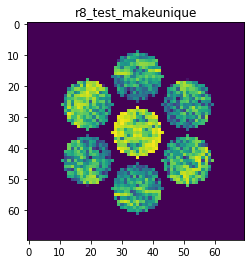

X_sim.max(): 0.8436875303346564
nlogf_X_sim.max(): 6.738966772383049
>>>replaced the 119. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 408ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 9.0312e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 284ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 9.1381e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 273ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 8.9293e-04 - val_acc: 1.0000


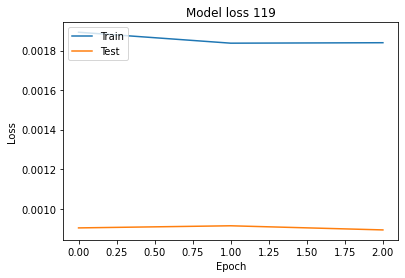

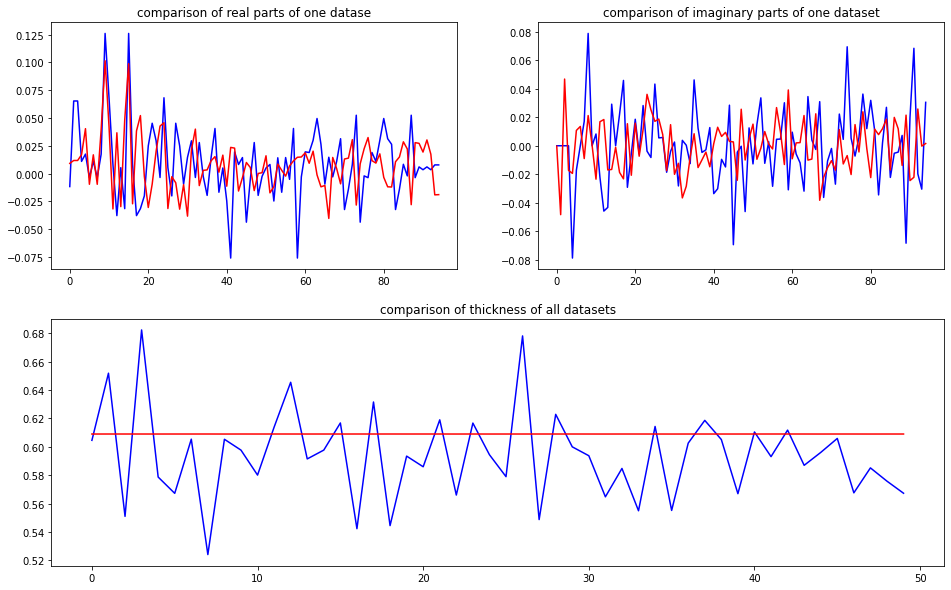

predicted thickness: 0.6089772


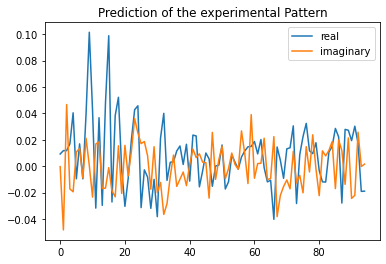

Applied shift of unit cell origin (fractional coordinates): -0.0012226110011263364 0.11722835494542293 0.2109991066683197
Ug[ 0 ]: 0.00925 0.0  =>  0.00925 0.0
Ug[ 1 ]: 0.04898 -1.32575  =>  0.04898 0.0
Ug[ 2 ]: 0.04898 1.32575  =>  0.04898 -0.0
Ug[ 3 ]: 0.0229 -0.73657  =>  0.0229 -0.0
Ug[ 4 ]: 0.04503 -0.46706  =>  0.04503 1.59525
Ug[ 5 ]: 0.01375 2.34157  =>  0.01375 1.75239
Ug[ 6 ]: 0.0229 0.73657  =>  0.0229 0.0
Ug[ 7 ]: 0.01375 -2.34157  =>  0.01375 -1.75239
Ug[ 8 ]: 0.04503 0.46706  =>  0.04503 -1.59525
Ug[ 9 ]: 0.1005 0.00768  =>  0.1005 -0.0
Ug[ 10 ]: 0.05043 -0.50316  =>  0.05043 0.81491
Ug[ 11 ]: 0.03436 2.59835  =>  0.03436 1.26492
Ug[ 12 ]: 0.04301 0.50451  =>  0.04301 -0.23974
Ug[ 13 ]: 0.03495 -2.63226  =>  0.03495 -2.05076
Ug[ 14 ]: 0.05285 -0.30837  =>  0.05285 -2.37837
Ug[ 15 ]: 0.1005 -0.00768  =>  0.1005 0.0
Ug[ 16 ]: 0.03436 -2.59835  =>  0.03436 -1.26492
Ug[ 17 ]: 0.04301 -0.50451  =>  0.04301 0.23974
Ug[ 18 ]: 0.05285 0.30837  =>  0.05285 2.37837
Ug[ 19 ]: 0.0198

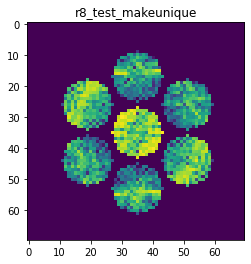

X_sim.max(): 0.9248607295485864
nlogf_X_sim.max(): 6.830723823279435
>>>replaced the 120. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 389ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 8.4361e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 280ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 9.3311e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 3s 320ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 9.4816e-04 - val_acc: 1.0000


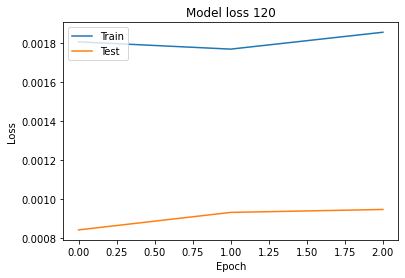

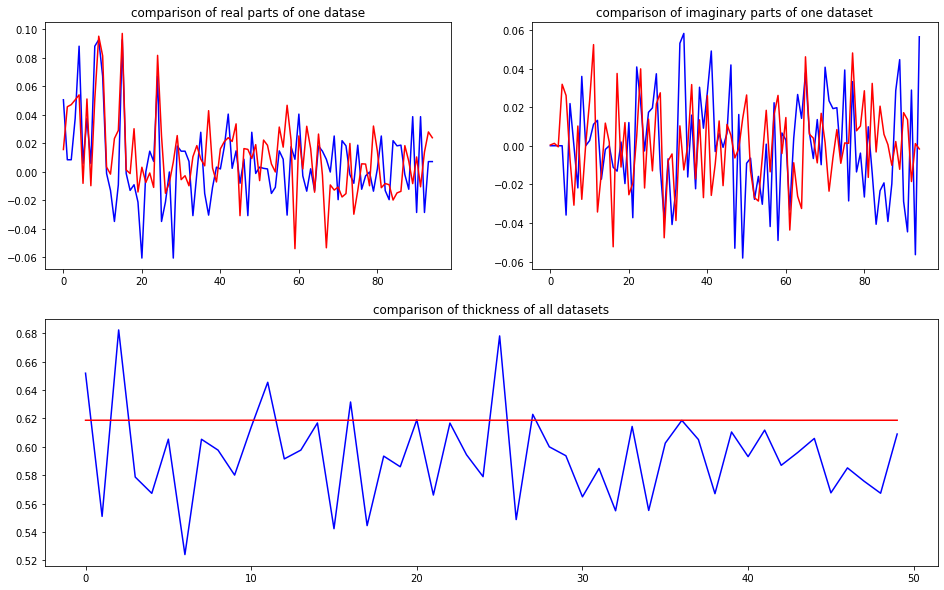

predicted thickness: 0.6186613


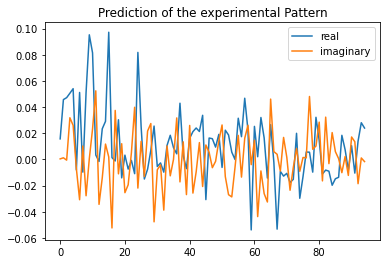

Applied shift of unit cell origin (fractional coordinates): 0.0011048612513715234 -0.08797328062078119 -0.003097579591553338
Ug[ 0 ]: 0.0157 0.0  =>  0.0157 0.0
Ug[ 1 ]: 0.04639 0.01946  =>  0.04639 0.0
Ug[ 2 ]: 0.04639 -0.01946  =>  0.04639 0.0
Ug[ 3 ]: 0.05964 0.55275  =>  0.05964 -0.0
Ug[ 4 ]: 0.05898 0.47323  =>  0.05898 -0.09899
Ug[ 5 ]: 0.01234 -2.37222  =>  0.01234 -2.90551
Ug[ 6 ]: 0.05964 -0.55275  =>  0.05964 0.0
Ug[ 7 ]: 0.01234 2.37222  =>  0.01234 2.90551
Ug[ 8 ]: 0.05898 -0.47323  =>  0.05898 0.09899
Ug[ 9 ]: 0.09593 -0.00694  =>  0.09593 -0.0
Ug[ 10 ]: 0.08446 0.2705  =>  0.08446 0.25798
Ug[ 11 ]: 0.05242 1.52661  =>  0.05242 1.55302
Ug[ 12 ]: 0.0359 -1.60977  =>  0.0359 -1.05008
Ug[ 13 ]: 0.028 -0.52074  =>  0.028 0.01949
Ug[ 14 ]: 0.03177 0.36588  =>  0.03177 0.94504
Ug[ 15 ]: 0.09593 0.00694  =>  0.09593 0.0
Ug[ 16 ]: 0.05242 -1.52661  =>  0.05242 -1.55302
Ug[ 17 ]: 0.0359 1.60977  =>  0.0359 1.05008
Ug[ 18 ]: 0.03177 -0.36588  =>  0.03177 -0.94504
Ug[ 19 ]: 0.01919 2

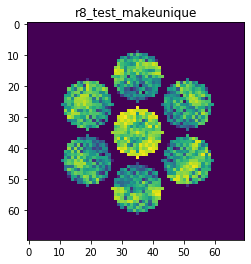

X_sim.max(): 0.8720288192241007
nlogf_X_sim.max(): 6.7719685670061835
>>>replaced the 121. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 399ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 9.6920e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 325ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 316ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 9.6056e-04 - val_acc: 1.0000


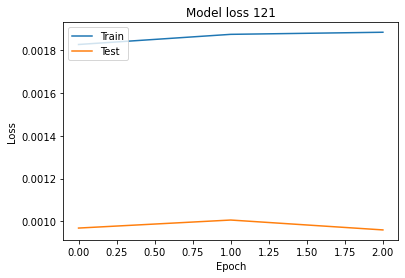

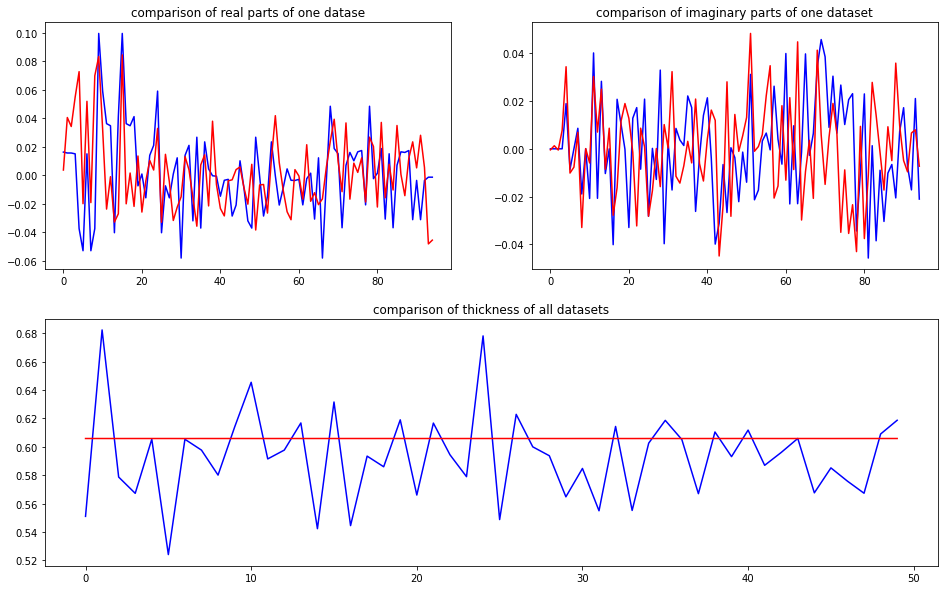

predicted thickness: 0.6058126


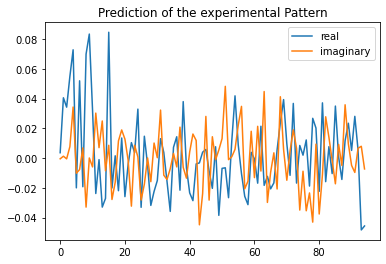

Applied shift of unit cell origin (fractional coordinates): 0.008054781555146072 -0.022783107650819714 -0.003774837617461688
Ug[ 0 ]: 0.00363 0.0  =>  0.00363 0.0
Ug[ 1 ]: 0.03743 0.02372  =>  0.03743 0.0
Ug[ 2 ]: 0.03743 -0.02372  =>  0.03743 0.0
Ug[ 3 ]: 0.05404 0.14315  =>  0.05404 0.0
Ug[ 4 ]: 0.07896 0.43988  =>  0.07896 0.27301
Ug[ 5 ]: 0.02136 -2.73198  =>  0.02136 -2.85141
Ug[ 6 ]: 0.05404 -0.14315  =>  0.05404 0.0
Ug[ 7 ]: 0.02136 2.73198  =>  0.02136 2.85141
Ug[ 8 ]: 0.07896 -0.43988  =>  0.07896 -0.27301
Ug[ 9 ]: 0.0842 -0.05061  =>  0.0842 0.0
Ug[ 10 ]: 0.03276 -0.10259  =>  0.03276 -0.0757
Ug[ 11 ]: 0.03635 2.21716  =>  0.03635 2.29149
Ug[ 12 ]: 0.01163 1.54786  =>  0.01163 1.74162
Ug[ 13 ]: 0.04232 2.46297  =>  0.04232 2.63301
Ug[ 14 ]: 0.02644 -2.75208  =>  0.02644 -2.5346
Ug[ 15 ]: 0.0842 0.05061  =>  0.0842 0.0
Ug[ 16 ]: 0.03635 -2.21716  =>  0.03635 -2.29149
Ug[ 17 ]: 0.01163 -1.54786  =>  0.01163 -1.74162
Ug[ 18 ]: 0.02644 2.75208  =>  0.02644 2.5346
Ug[ 19 ]: 0.0230

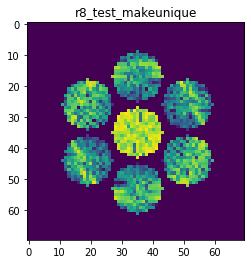

X_sim.max(): 0.9229893421199175
nlogf_X_sim.max(): 6.8287005370729075
>>>replaced the 122. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 411ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 9.8409e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 323ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 8.8388e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 290ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000


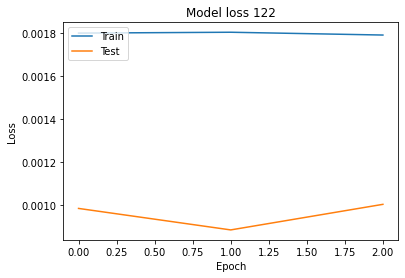

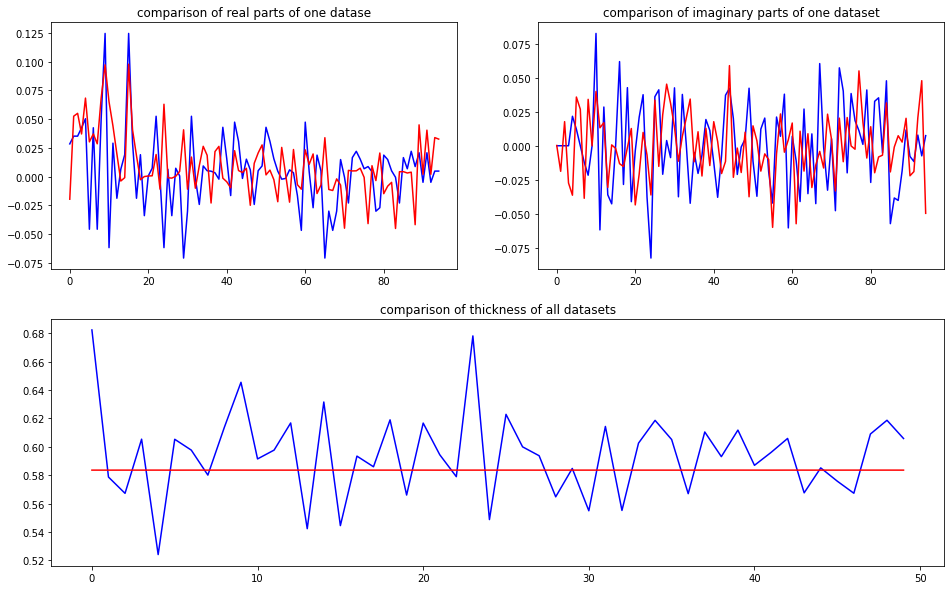

predicted thickness: 0.58356637


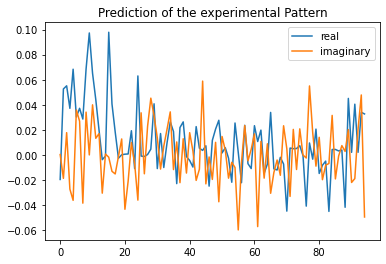

Applied shift of unit cell origin (fractional coordinates): -0.0015020340989759632 0.10029771176135815 0.05193556080512239
Ug[ 0 ]: 0.01968 3.14159  =>  0.01968 3.14159
Ug[ 1 ]: 0.05691 -0.32632  =>  0.05691 0.0
Ug[ 2 ]: 0.05691 0.32632  =>  0.05691 0.0
Ug[ 3 ]: 0.04601 -0.63019  =>  0.04601 0.0
Ug[ 4 ]: 0.07706 -0.4747  =>  0.07706 0.48181
Ug[ 5 ]: 0.04744 0.90148  =>  0.04744 1.20534
Ug[ 6 ]: 0.04601 0.63019  =>  0.04601 0.0
Ug[ 7 ]: 0.04744 -0.90148  =>  0.04744 -1.20534
Ug[ 8 ]: 0.07706 0.4747  =>  0.07706 -0.48181
Ug[ 9 ]: 0.09778 0.00944  =>  0.09778 -0.0
Ug[ 10 ]: 0.07462 0.53518  =>  0.07462 0.85206
Ug[ 11 ]: 0.04442 0.30131  =>  0.04442 -0.03445
Ug[ 12 ]: 0.0249 0.70356  =>  0.0249 0.06393
Ug[ 13 ]: 0.03217 -1.64616  =>  0.03217 -1.95947
Ug[ 14 ]: 0.0021 2.64851  =>  0.0021 1.68256
Ug[ 15 ]: 0.09778 -0.00944  =>  0.09778 0.0
Ug[ 16 ]: 0.04442 -0.30131  =>  0.04442 0.03445
Ug[ 17 ]: 0.0249 -0.70356  =>  0.0249 -0.06393
Ug[ 18 ]: 0.0021 -2.64851  =>  0.0021 -1.68256
Ug[ 19 ]: 0.

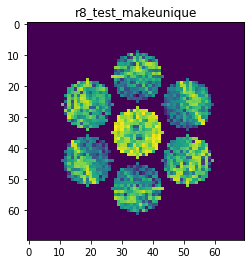

X_sim.max(): 0.9524431316544139
nlogf_X_sim.max(): 6.860079781577951
>>>replaced the 123. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 396ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 9.0339e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 331ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 8.9514e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 314ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 8.1252e-04 - val_acc: 1.0000


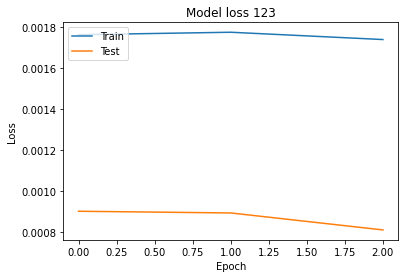

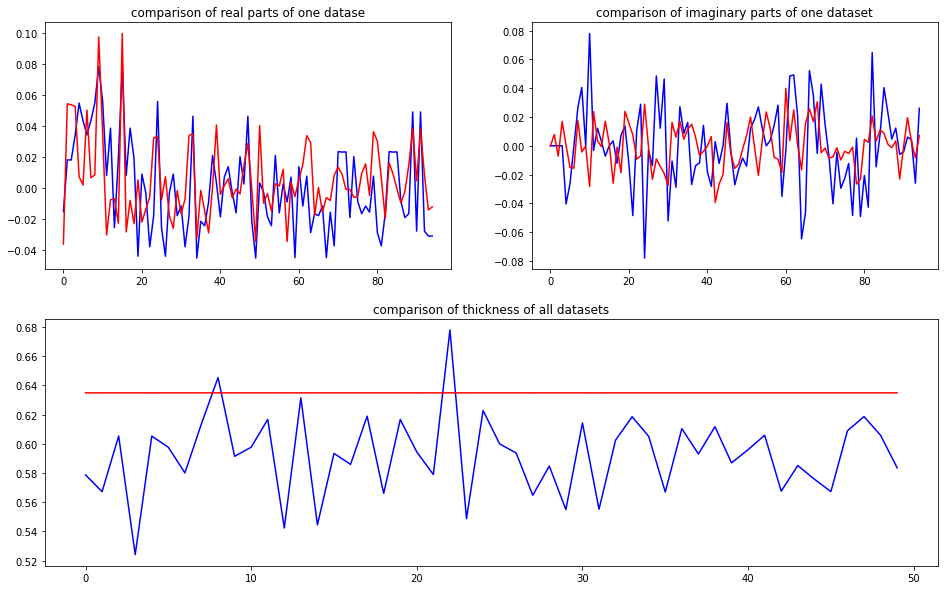

predicted thickness: 0.63492197


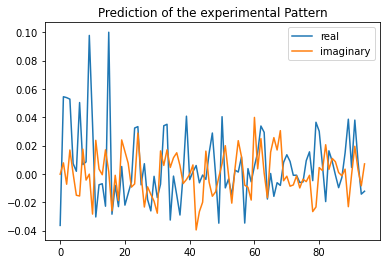

Applied shift of unit cell origin (fractional coordinates): 0.0014088342404163497 -0.04847472061412507 -0.021975483483668644
Ug[ 0 ]: 0.03632 3.14159  =>  0.03632 3.14159
Ug[ 1 ]: 0.05475 0.13808  =>  0.05475 0.0
Ug[ 2 ]: 0.05475 -0.13808  =>  0.05475 -0.0
Ug[ 3 ]: 0.05414 0.30458  =>  0.05414 0.0
Ug[ 4 ]: 0.00822 0.28126  =>  0.00822 -0.16139
Ug[ 5 ]: 0.01682 -1.31486  =>  0.01682 -1.48135
Ug[ 6 ]: 0.05414 -0.30458  =>  0.05414 -0.0
Ug[ 7 ]: 0.01682 1.31486  =>  0.01682 1.48135
Ug[ 8 ]: 0.00822 -0.28126  =>  0.00822 0.16139
Ug[ 9 ]: 0.09905 -0.00885  =>  0.09905 0.0
Ug[ 10 ]: 0.04469 -0.69413  =>  0.04469 -0.82335
Ug[ 11 ]: 0.03851 2.43869  =>  0.03851 2.58562
Ug[ 12 ]: 0.00813 2.86684  =>  0.00813 -3.10292
Ug[ 13 ]: 0.00732 3.13158  =>  0.00732 -2.97625
Ug[ 14 ]: 0.02909 2.47901  =>  0.02909 2.93052
Ug[ 15 ]: 0.09905 0.00885  =>  0.09905 0.0
Ug[ 16 ]: 0.03851 -2.43869  =>  0.03851 -2.58562
Ug[ 17 ]: 0.00813 -2.86684  =>  0.00813 3.10292
Ug[ 18 ]: 0.02909 -2.47901  =>  0.02909 -2.9305

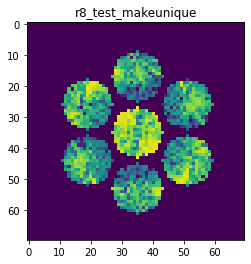

X_sim.max(): 0.9157248845772766
nlogf_X_sim.max(): 6.820807410423742
>>>replaced the 124. dataset and train: 
Epoch 1/3
8/8 [==============================] - 5s 420ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 8.7811e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 296ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 9.0048e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 312ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 8.1319e-04 - val_acc: 1.0000


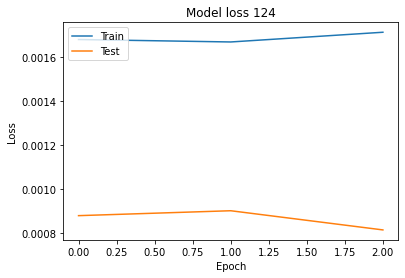

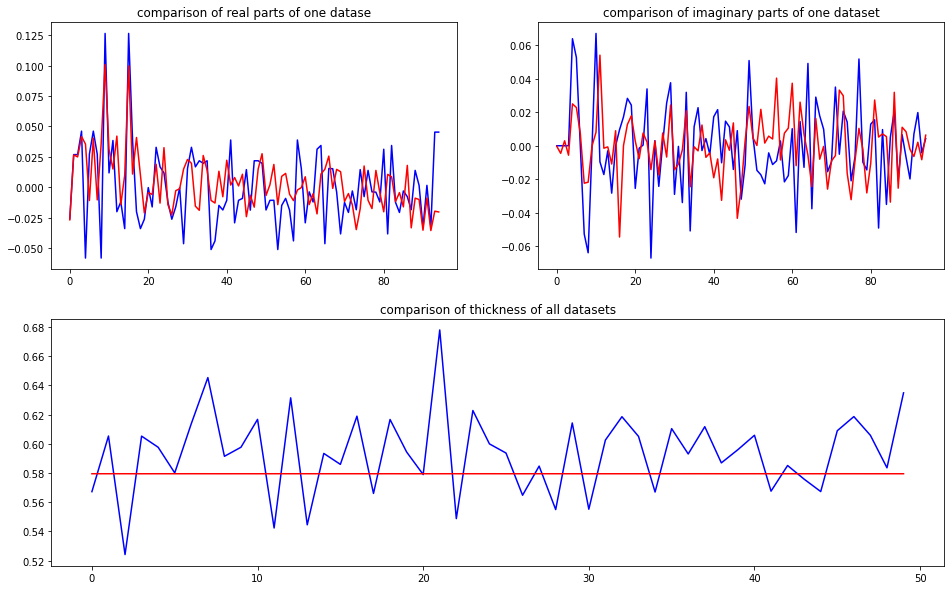

predicted thickness: 0.5795018


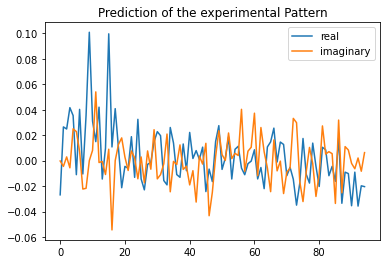

Applied shift of unit cell origin (fractional coordinates): 0.007128979409607821 0.025072282502937176 0.022987076279912765
Ug[ 0 ]: 0.02687 3.14159  =>  0.02687 3.14159
Ug[ 1 ]: 0.02593 -0.14443  =>  0.02593 0.0
Ug[ 2 ]: 0.02593 0.14443  =>  0.02593 0.0
Ug[ 3 ]: 0.04143 -0.15753  =>  0.04143 0.0
Ug[ 4 ]: 0.04247 0.58198  =>  0.04247 0.88394
Ug[ 5 ]: 0.02501 2.01612  =>  0.02501 2.02922
Ug[ 6 ]: 0.04143 0.15753  =>  0.04143 0.0
Ug[ 7 ]: 0.02501 -2.01612  =>  0.02501 -2.02922
Ug[ 8 ]: 0.04247 -0.58198  =>  0.04247 -0.88394
Ug[ 9 ]: 0.10017 -0.04479  =>  0.10017 0.0
Ug[ 10 ]: 0.03365 0.33822  =>  0.03365 0.52744
Ug[ 11 ]: 0.05569 1.33914  =>  0.05569 1.2395
Ug[ 12 ]: 0.04139 -0.01829  =>  0.04139 -0.13103
Ug[ 13 ]: 0.01451 -3.01801  =>  0.01451 -2.98632
Ug[ 14 ]: 0.0154 -0.87294  =>  0.0154 -1.13011
Ug[ 15 ]: 0.10017 0.04479  =>  0.10017 -0.0
Ug[ 16 ]: 0.05569 -1.33914  =>  0.05569 -1.2395
Ug[ 17 ]: 0.04139 0.01829  =>  0.04139 0.13103
Ug[ 18 ]: 0.0154 0.87294  =>  0.0154 1.13011
Ug[ 19 ]

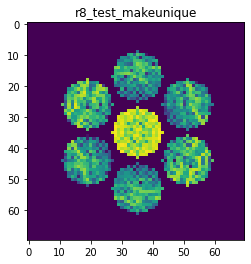

X_sim.max(): 0.9092953255525797
nlogf_X_sim.max(): 6.813769080435529
>>>replaced the 125. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 390ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 8.9025e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 288ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 8.7436e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 294ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 9.2973e-04 - val_acc: 1.0000


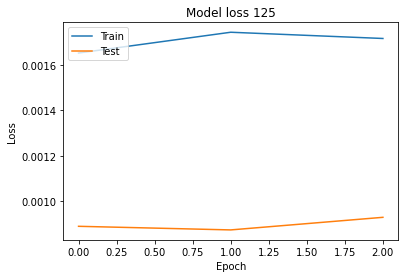

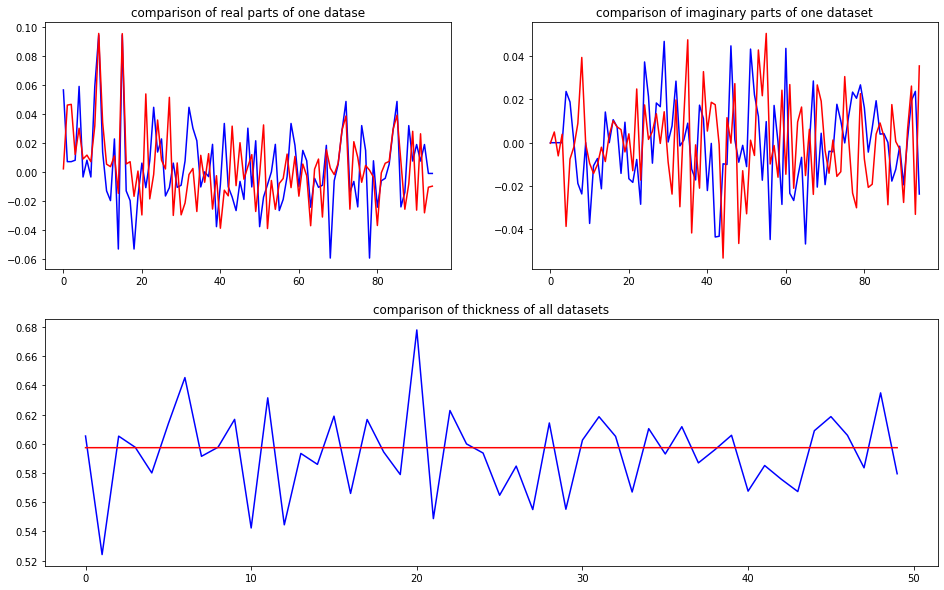

predicted thickness: 0.597361


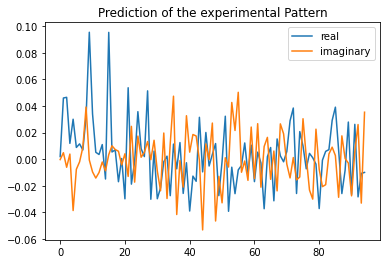

Applied shift of unit cell origin (fractional coordinates): 0.003374019914340554 -0.03861649007765497 -0.018757929381740153
Ug[ 0 ]: 0.00201 0.0  =>  0.00201 0.0
Ug[ 1 ]: 0.04663 0.11786  =>  0.04663 0.0
Ug[ 2 ]: 0.04663 -0.11786  =>  0.04663 0.0
Ug[ 3 ]: 0.0121 0.24263  =>  0.0121 0.0
Ug[ 4 ]: 0.04968 -0.90013  =>  0.04968 -1.26062
Ug[ 5 ]: 0.01142 -0.80363  =>  0.01142 -0.92841
Ug[ 6 ]: 0.0121 -0.24263  =>  0.0121 0.0
Ug[ 7 ]: 0.01142 0.80363  =>  0.01142 0.92841
Ug[ 8 ]: 0.04968 0.90013  =>  0.04968 1.26062
Ug[ 9 ]: 0.09545 -0.0212  =>  0.09545 0.0
Ug[ 10 ]: 0.03743 -0.36841  =>  0.03743 -0.46507
Ug[ 11 ]: 0.01326 -1.15601  =>  0.01326 -1.01695
Ug[ 12 ]: 0.01014 -1.02292  =>  0.01014 -0.75909
Ug[ 13 ]: 0.00968 -0.1866  =>  0.00968 -0.04063
Ug[ 14 ]: 0.01751 -2.708  =>  0.01751 -2.32631
Ug[ 15 ]: 0.09545 0.0212  =>  0.09545 0.0
Ug[ 16 ]: 0.01326 1.15601  =>  0.01326 1.01695
Ug[ 17 ]: 0.01014 1.02292  =>  0.01014 0.75909
Ug[ 18 ]: 0.01751 2.708  =>  0.01751 2.32631
Ug[ 19 ]: 0.0049 -1

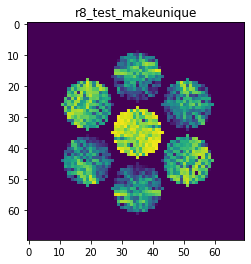

X_sim.max(): 0.9825308608966812
nlogf_X_sim.max(): 6.891149015981127
>>>replaced the 126. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 346ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 7.2910e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 258ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 7.5688e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 260ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 8.1605e-04 - val_acc: 1.0000


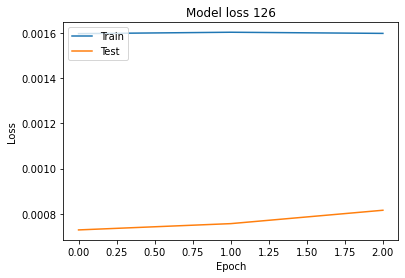

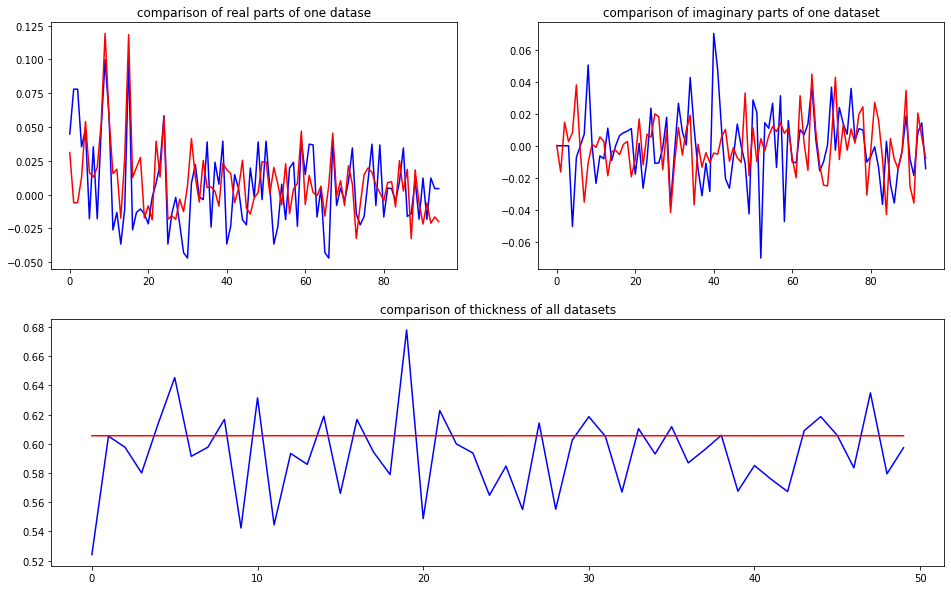

predicted thickness: 0.6055483


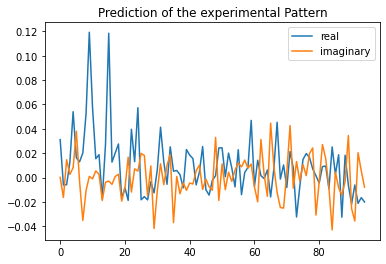

Applied shift of unit cell origin (fractional coordinates): -0.0025883894356344894 -0.036297151246729865 0.3085286057164647
Ug[ 0 ]: 0.03117 0.0  =>  0.03117 0.0
Ug[ 1 ]: 0.01663 -1.93854  =>  0.01663 0.0
Ug[ 2 ]: 0.01663 1.93854  =>  0.01663 -0.0
Ug[ 3 ]: 0.01319 0.22806  =>  0.01319 0.0
Ug[ 4 ]: 0.05419 0.17453  =>  0.05419 1.88501
Ug[ 5 ]: 0.04086 1.10752  =>  0.04086 -1.05908
Ug[ 6 ]: 0.01319 -0.22806  =>  0.01319 0.0
Ug[ 7 ]: 0.04086 -1.10752  =>  0.04086 1.05908
Ug[ 8 ]: 0.05419 -0.17453  =>  0.05419 -1.88501
Ug[ 9 ]: 0.11913 0.01626  =>  0.11913 0.0
Ug[ 10 ]: 0.05745 -0.05528  =>  0.05745 1.867
Ug[ 11 ]: 0.01513 0.37337  =>  0.01513 -1.58144
Ug[ 12 ]: 0.01951 0.0481  =>  0.01951 0.25989
Ug[ 13 ]: 0.02626 -2.31578  =>  0.02626 -0.16544
Ug[ 14 ]: 0.02758 -0.11717  =>  0.02758 -1.84391
Ug[ 15 ]: 0.11913 -0.01626  =>  0.11913 0.0
Ug[ 16 ]: 0.01513 -0.37337  =>  0.01513 1.58144
Ug[ 17 ]: 0.01951 -0.0481  =>  0.01951 -0.25989
Ug[ 18 ]: 0.02758 0.11717  =>  0.02758 1.84391
Ug[ 19 ]: 0.

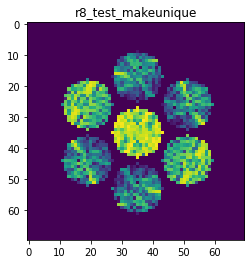

X_sim.max(): 0.9304417850897886
nlogf_X_sim.max(): 6.836733692210851
>>>replaced the 127. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 338ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 9.4398e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 244ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 9.0746e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 241ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 8.7384e-04 - val_acc: 1.0000


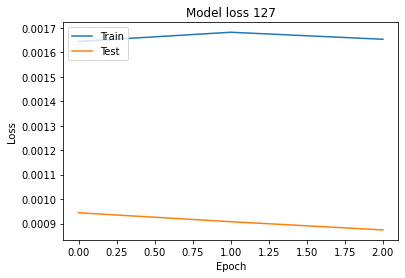

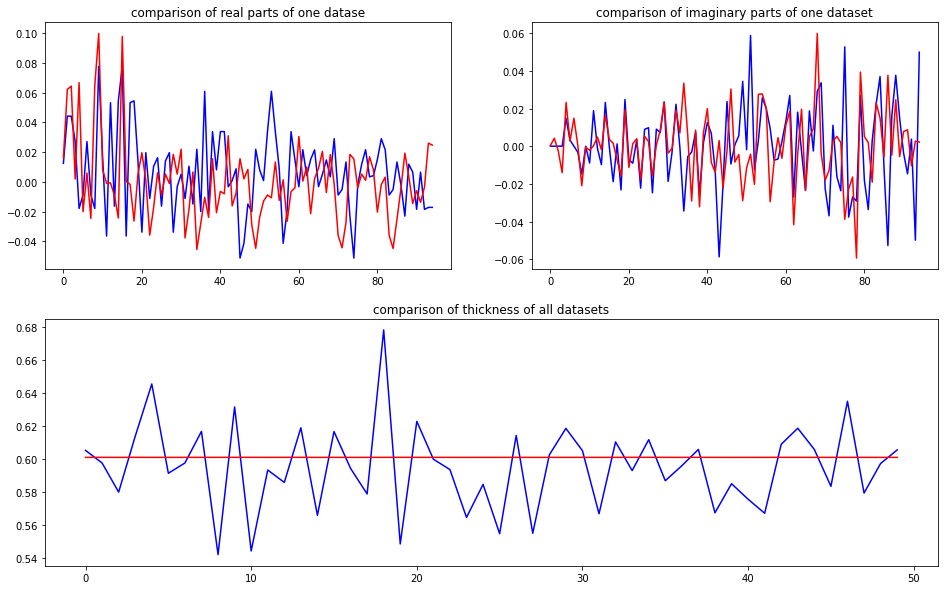

predicted thickness: 0.60106665


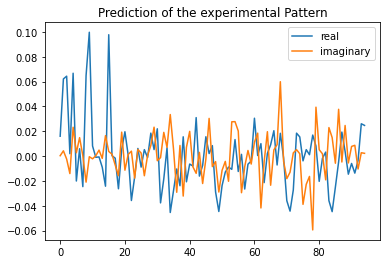

Applied shift of unit cell origin (fractional coordinates): 0.0033928759718957146 0.20770964224073765 -0.008334454049609153
Ug[ 0 ]: 0.016 0.0  =>  0.016 0.0
Ug[ 1 ]: 0.06327 0.05237  =>  0.06327 0.0
Ug[ 2 ]: 0.06327 -0.05237  =>  0.06327 0.0
Ug[ 3 ]: 0.01498 -1.30508  =>  0.01498 0.0
Ug[ 4 ]: 0.06933 0.32429  =>  0.06933 1.577
Ug[ 5 ]: 0.02235 3.08896  =>  0.02235 -1.83678
Ug[ 6 ]: 0.01498 1.30508  =>  0.01498 -0.0
Ug[ 7 ]: 0.02235 -3.08896  =>  0.02235 1.83678
Ug[ 8 ]: 0.06933 -0.32429  =>  0.06933 -1.577
Ug[ 9 ]: 0.09866 -0.02132  =>  0.09866 -0.0
Ug[ 10 ]: 0.00808 -0.48355  =>  0.00808 -0.5146
Ug[ 11 ]: 0.00071 -2.02482  =>  0.00071 -1.95113
Ug[ 12 ]: 0.00612 1.76367  =>  0.00612 0.47991
Ug[ 13 ]: 0.00918 -2.9046  =>  0.00918 2.04246
Ug[ 14 ]: 0.02997 2.57361  =>  0.02997 1.34222
Ug[ 15 ]: 0.09866 0.02132  =>  0.09866 0.0
Ug[ 16 ]: 0.00071 2.02482  =>  0.00071 1.95113
Ug[ 17 ]: 0.00612 -1.76367  =>  0.00612 -0.47991
Ug[ 18 ]: 0.02997 -2.57361  =>  0.02997 -1.34222
Ug[ 19 ]: 0.01831

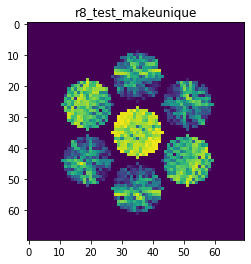

X_sim.max(): 0.98069048787745
nlogf_X_sim.max(): 6.889276073212244
>>>replaced the 128. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 366ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 8.5398e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 280ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 8.8614e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 271ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 8.0390e-04 - val_acc: 1.0000


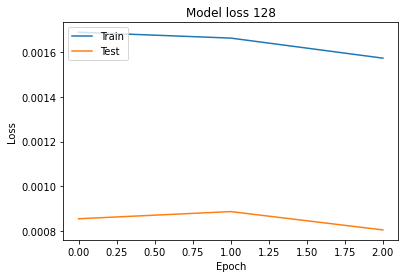

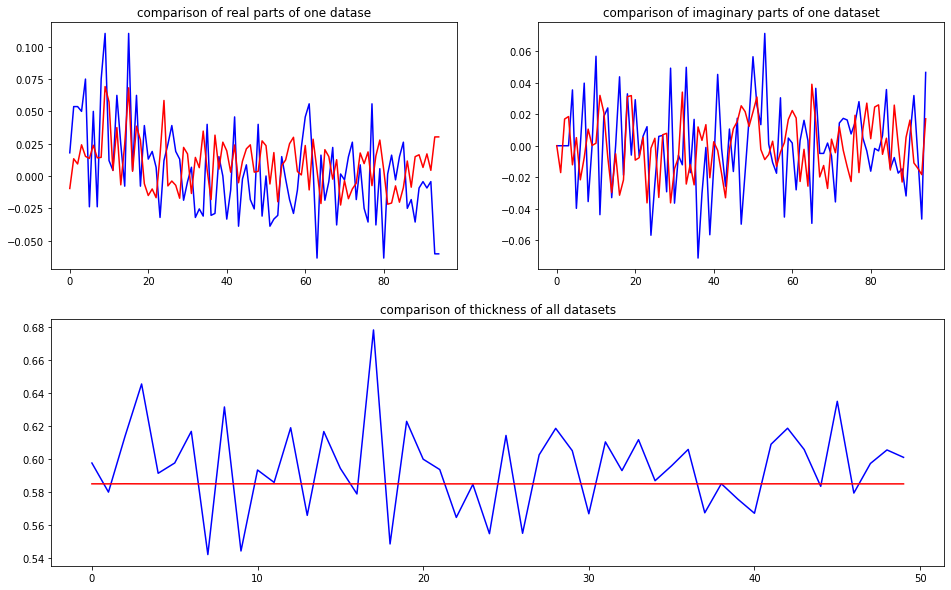

predicted thickness: 0.58506024


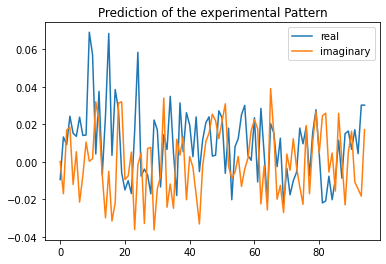

Applied shift of unit cell origin (fractional coordinates): -0.006115358655312701 -0.11016447913971303 0.15701110541231864
Ug[ 0 ]: 0.00947 3.14159  =>  0.00947 3.14159
Ug[ 1 ]: 0.02033 -0.98653  =>  0.02033 -0.0
Ug[ 2 ]: 0.02033 0.98653  =>  0.02033 0.0
Ug[ 3 ]: 0.03127 0.69218  =>  0.03127 -0.0
Ug[ 4 ]: 0.0186 -0.65391  =>  0.0186 -0.35956
Ug[ 5 ]: 0.01524 0.43248  =>  0.01524 -1.24624
Ug[ 6 ]: 0.03127 -0.69218  =>  0.03127 0.0
Ug[ 7 ]: 0.01524 -0.43248  =>  0.01524 1.24624
Ug[ 8 ]: 0.0186 0.65391  =>  0.0186 0.35956
Ug[ 9 ]: 0.06883 0.03842  =>  0.06883 -0.0
Ug[ 10 ]: 0.0578 0.02822  =>  0.0578 0.97633
Ug[ 11 ]: 0.03201 1.45103  =>  0.03201 0.42608
Ug[ 12 ]: 0.04372 0.51437  =>  0.04372 1.16813
Ug[ 13 ]: 0.00935 -2.45667  =>  0.00935 -0.81638
Ug[ 14 ]: 0.04033 -0.86088  =>  0.04033 -1.19365
Ug[ 15 ]: 0.06883 -0.03842  =>  0.06883 0.0
Ug[ 16 ]: 0.03201 -1.45103  =>  0.03201 -0.42608
Ug[ 17 ]: 0.04372 -0.51437  =>  0.04372 -1.16813
Ug[ 18 ]: 0.04033 0.86088  =>  0.04033 1.19365
Ug[ 19

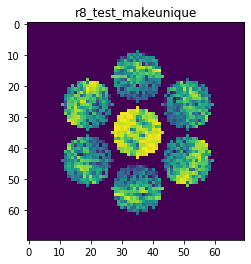

X_sim.max(): 0.9195124025314554
nlogf_X_sim.max(): 6.824930474272157
>>>replaced the 129. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 388ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 8.8671e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 302ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 8.6494e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 294ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 8.5868e-04 - val_acc: 1.0000


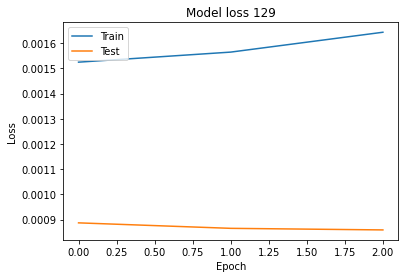

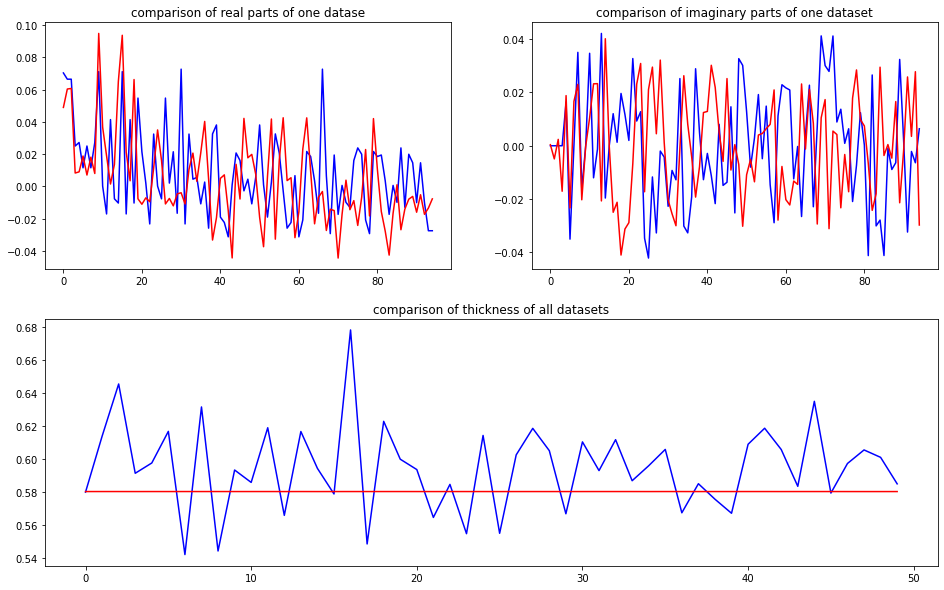

predicted thickness: 0.5804105


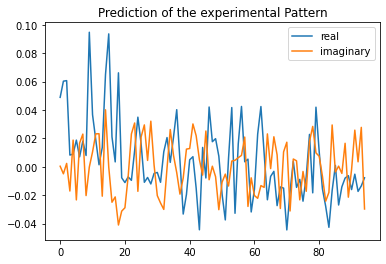

Applied shift of unit cell origin (fractional coordinates): 5.584962686140997e-05 0.18232844345224897 0.009614336794129272
Ug[ 0 ]: 0.04888 0.0  =>  0.04888 0.0
Ug[ 1 ]: 0.06055 -0.06041  =>  0.06055 0.0
Ug[ 2 ]: 0.06055 0.06041  =>  0.06055 0.0
Ug[ 3 ]: 0.0185 -1.1456  =>  0.0185 0.0
Ug[ 4 ]: 0.02129 1.16207  =>  0.02129 2.36808
Ug[ 5 ]: 0.0296 -0.89899  =>  0.0296 0.1862
Ug[ 6 ]: 0.0185 1.1456  =>  0.0185 -0.0
Ug[ 7 ]: 0.0296 0.89899  =>  0.0296 -0.1862
Ug[ 8 ]: 0.02129 -1.16207  =>  0.02129 -2.36808
Ug[ 9 ]: 0.09406 -0.00035  =>  0.09406 0.0
Ug[ 10 ]: 0.03838 0.36975  =>  0.03838 0.4305
Ug[ 11 ]: 0.03131 0.87746  =>  0.03131 0.8174
Ug[ 12 ]: 0.02237 1.46163  =>  0.02237 0.31638
Ug[ 13 ]: 0.02561 -0.95351  =>  0.02561 -2.03836
Ug[ 14 ]: 0.07701 0.55462  =>  0.07701 -0.65104
Ug[ 15 ]: 0.09406 0.00035  =>  0.09406 -0.0
Ug[ 16 ]: 0.03131 -0.87746  =>  0.03131 -0.8174
Ug[ 17 ]: 0.02237 -1.46163  =>  0.02237 -0.31638
Ug[ 18 ]: 0.07701 -0.55462  =>  0.07701 0.65104
Ug[ 19 ]: 0.03175 -1.869

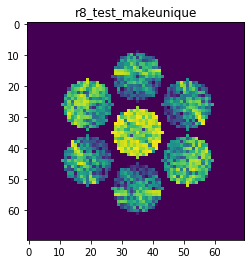

X_sim.max(): 0.9311561368034734
nlogf_X_sim.max(): 6.837500329413308
>>>replaced the 130. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 388ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 8.8653e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 291ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 9.0881e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 308ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 7.8116e-04 - val_acc: 1.0000


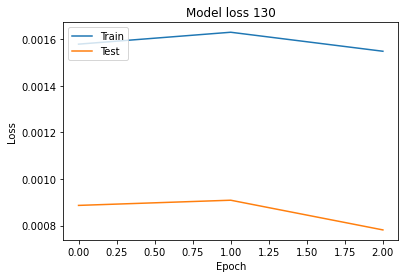

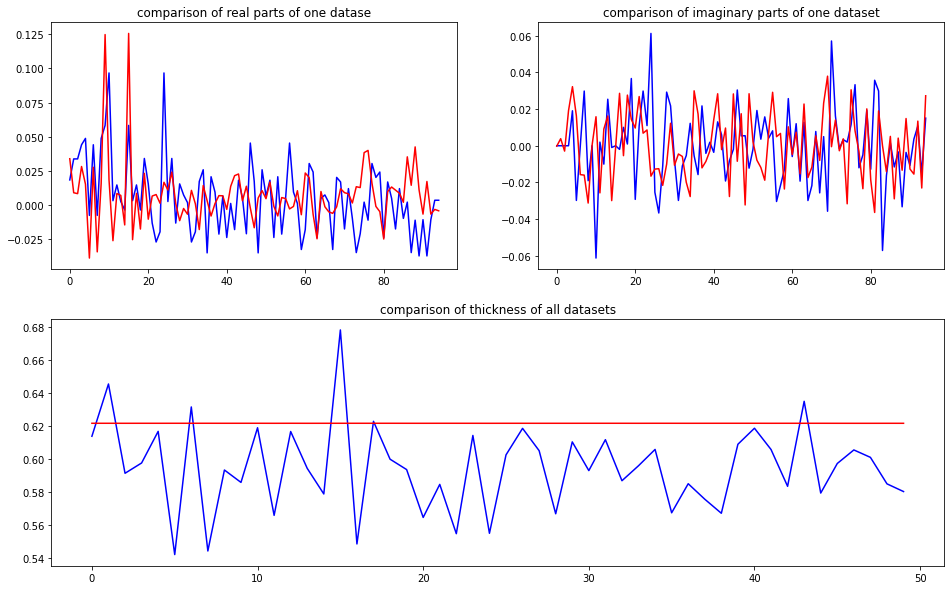

predicted thickness: 0.6216527


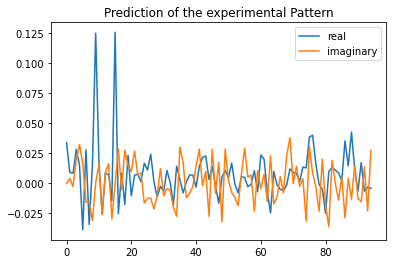

Applied shift of unit cell origin (fractional coordinates): -0.0006954121592428711 -0.08889322915215785 -0.05963247583625762
Ug[ 0 ]: 0.03383 0.0  =>  0.03383 0.0
Ug[ 1 ]: 0.00922 0.37468  =>  0.00922 0.0
Ug[ 2 ]: 0.00922 -0.37468  =>  0.00922 -0.0
Ug[ 3 ]: 0.03288 0.55853  =>  0.03288 0.0
Ug[ 4 ]: 0.03527 1.1182  =>  0.03527 0.18499
Ug[ 5 ]: 0.04009 2.72771  =>  0.04009 2.54386
Ug[ 6 ]: 0.03288 -0.55853  =>  0.03288 -0.0
Ug[ 7 ]: 0.04009 -2.72771  =>  0.04009 -2.54386
Ug[ 8 ]: 0.03527 -1.1182  =>  0.03527 -0.18499
Ug[ 9 ]: 0.12528 0.00437  =>  0.12528 0.0
Ug[ 10 ]: 0.0238 0.74794  =>  0.0238 0.36889
Ug[ 11 ]: 0.03748 -2.33222  =>  0.03748 -1.96191
Ug[ 12 ]: 0.01113 0.71371  =>  0.01113 1.26787
Ug[ 13 ]: 0.01701 1.01732  =>  0.01701 1.19681
Ug[ 14 ]: 0.033 -2.08341  =>  0.033 -1.15456
Ug[ 15 ]: 0.12528 -0.00437  =>  0.12528 0.0
Ug[ 16 ]: 0.03748 2.33222  =>  0.03748 1.96191
Ug[ 17 ]: 0.01113 -0.71371  =>  0.01113 -1.26787
Ug[ 18 ]: 0.033 2.08341  =>  0.033 1.15456
Ug[ 19 ]: 0.02718 0.5

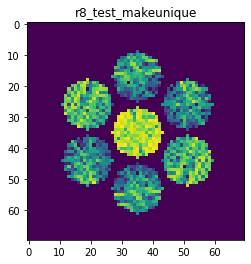

X_sim.max(): 0.9023020487161852
nlogf_X_sim.max(): 6.806056992188414
>>>replaced the 131. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 377ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 8.2816e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 283ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 7.8395e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 285ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 7.5333e-04 - val_acc: 1.0000


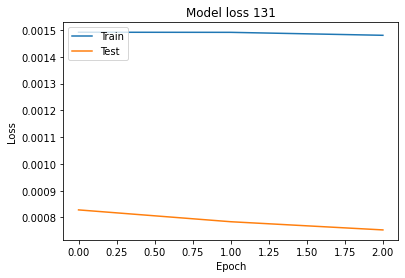

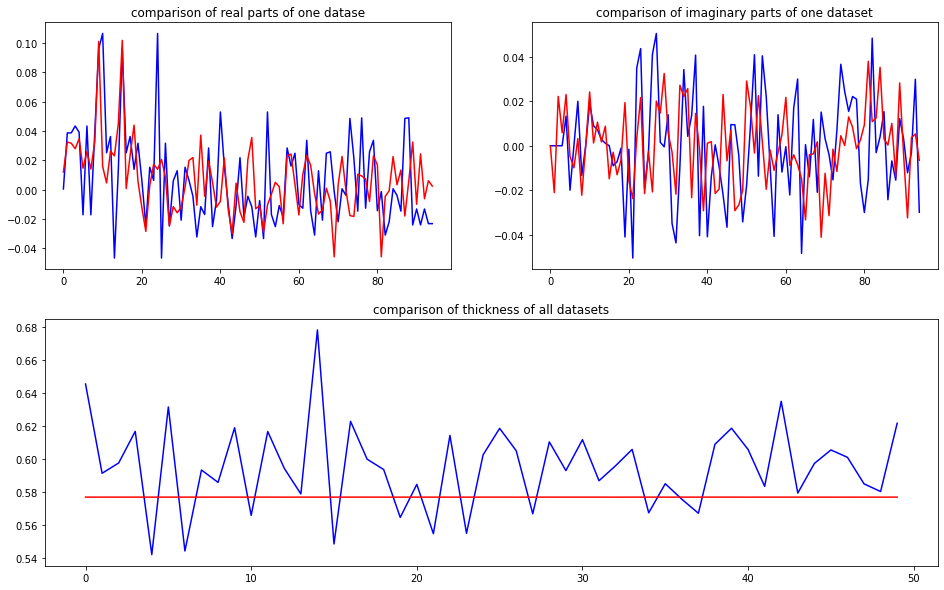

predicted thickness: 0.5770471


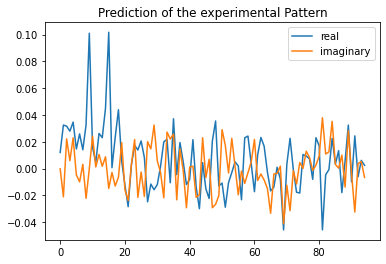

Applied shift of unit cell origin (fractional coordinates): -0.011548924012082254 -0.045442320606971 0.09435641385715697
Ug[ 0 ]: 0.01202 0.0  =>  0.01202 0.0
Ug[ 1 ]: 0.03869 -0.59286  =>  0.03869 0.0
Ug[ 2 ]: 0.03869 0.59286  =>  0.03869 0.0
Ug[ 3 ]: 0.02807 0.28552  =>  0.02807 0.0
Ug[ 4 ]: 0.04061 0.59087  =>  0.04061 0.8982
Ug[ 5 ]: 0.01488 -0.26957  =>  0.01488 -1.14795
Ug[ 6 ]: 0.02807 -0.28552  =>  0.02807 0.0
Ug[ 7 ]: 0.01488 0.26957  =>  0.01488 1.14795
Ug[ 8 ]: 0.04061 -0.59087  =>  0.04061 -0.8982
Ug[ 9 ]: 0.10178 0.07256  =>  0.10178 0.0
Ug[ 10 ]: 0.02725 0.99441  =>  0.02725 1.5147
Ug[ 11 ]: 0.00336 0.6656  =>  0.00336 0.00017
Ug[ 12 ]: 0.02749 0.44425  =>  0.02749 0.65721
Ug[ 13 ]: 0.02196 0.09813  =>  0.02196 0.90395
Ug[ 14 ]: 0.04514 0.16914  =>  0.04514 -0.21076
Ug[ 15 ]: 0.10178 -0.07256  =>  0.10178 0.0
Ug[ 16 ]: 0.00336 -0.6656  =>  0.00336 -0.00017
Ug[ 17 ]: 0.02749 -0.44425  =>  0.02749 -0.65721
Ug[ 18 ]: 0.04514 -0.16914  =>  0.04514 0.21076
Ug[ 19 ]: 0.02128 1.

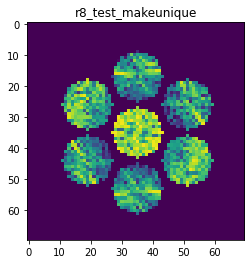

X_sim.max(): 0.9182729510520582
nlogf_X_sim.max(): 6.8235830870190775
>>>replaced the 132. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 381ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 8.1742e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 288ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 8.2558e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 287ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 7.7621e-04 - val_acc: 1.0000


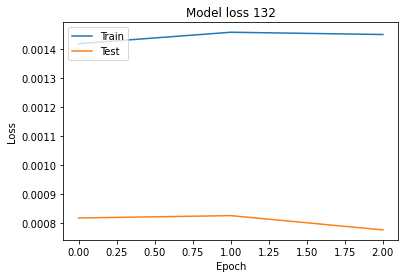

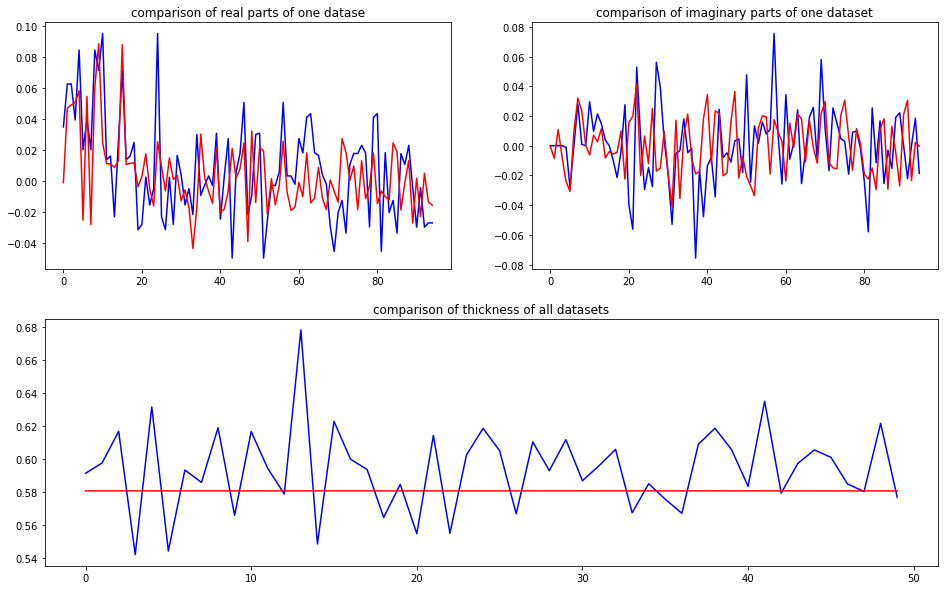

predicted thickness: 0.5808024


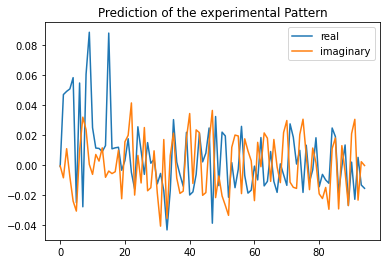

Applied shift of unit cell origin (fractional coordinates): -0.0039949833309741115 0.02640867834030995 0.0317079262626751
Ug[ 0 ]: 0.00094 3.14159  =>  0.00094 3.14159
Ug[ 1 ]: 0.04914 -0.19923  =>  0.04914 0.0
Ug[ 2 ]: 0.04914 0.19923  =>  0.04914 -0.0
Ug[ 3 ]: 0.05358 -0.16593  =>  0.05358 0.0
Ug[ 4 ]: 0.06413 -0.38106  =>  0.06413 -0.0159
Ug[ 5 ]: 0.04109 -2.27208  =>  0.04109 -2.30538
Ug[ 6 ]: 0.05358 0.16593  =>  0.05358 0.0
Ug[ 7 ]: 0.04109 2.27208  =>  0.04109 2.30538
Ug[ 8 ]: 0.06413 0.38106  =>  0.06413 0.0159
Ug[ 9 ]: 0.0884 0.0251  =>  0.0884 0.0
Ug[ 10 ]: 0.02609 -0.24536  =>  0.02609 -0.07123
Ug[ 11 ]: 0.01284 0.52072  =>  0.01284 0.29639
Ug[ 12 ]: 0.01189 0.30375  =>  0.01189 0.11272
Ug[ 13 ]: 0.01493 0.9047  =>  0.01493 0.91289
Ug[ 14 ]: 0.01542 -0.62695  =>  0.01542 -1.01721
Ug[ 15 ]: 0.0884 -0.0251  =>  0.0884 0.0
Ug[ 16 ]: 0.01284 -0.52072  =>  0.01284 -0.29639
Ug[ 17 ]: 0.01189 -0.30375  =>  0.01189 -0.11272
Ug[ 18 ]: 0.01542 0.62695  =>  0.01542 1.01721
Ug[ 19 ]: 0.

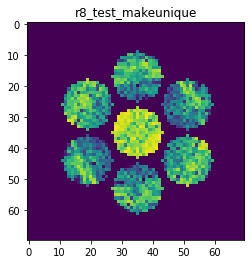

X_sim.max(): 0.9821846000192048
nlogf_X_sim.max(): 6.8907968950079255
>>>replaced the 133. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 392ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 6.2176e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 295ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 7.7393e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 304ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 7.3305e-04 - val_acc: 1.0000


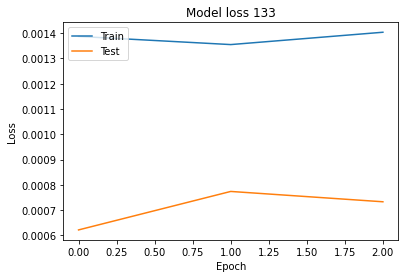

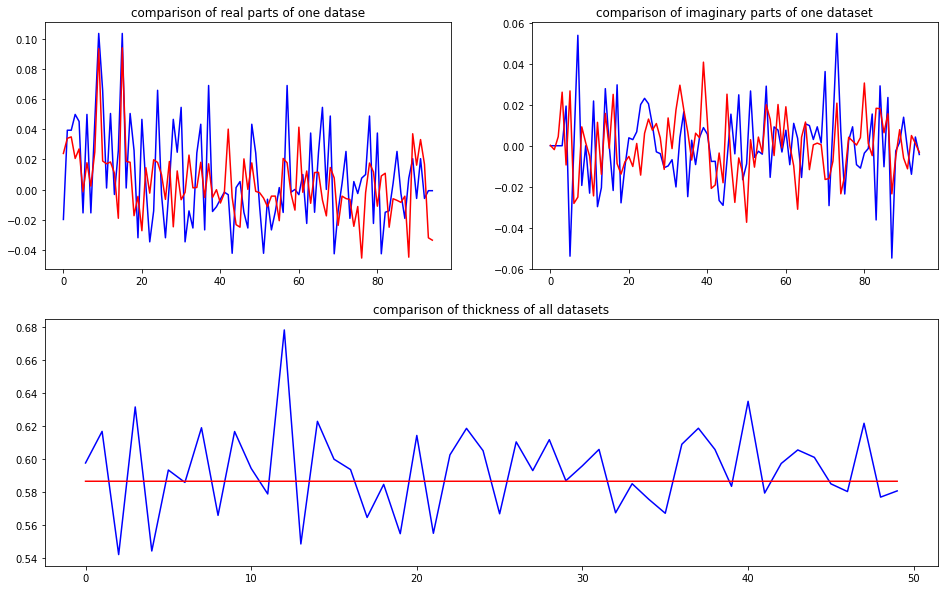

predicted thickness: 0.5866315


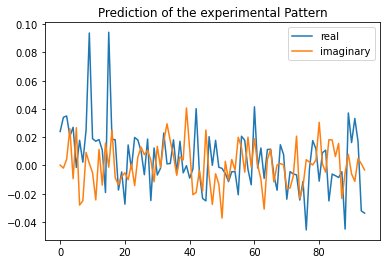

Applied shift of unit cell origin (fractional coordinates): -0.002261358846792484 -0.15154245315421302 0.014414552916869184
Ug[ 0 ]: 0.02406 0.0  =>  0.02406 0.0
Ug[ 1 ]: 0.03473 -0.09057  =>  0.03473 0.0
Ug[ 2 ]: 0.03473 0.09057  =>  0.03473 0.0
Ug[ 3 ]: 0.03323 0.95217  =>  0.03323 0.0
Ug[ 4 ]: 0.02761 -0.34269  =>  0.02761 -1.20429
Ug[ 5 ]: 0.02586 1.55368  =>  0.02586 0.51094
Ug[ 6 ]: 0.03323 -0.95217  =>  0.03323 -0.0
Ug[ 7 ]: 0.02586 -1.55368  =>  0.02586 -0.51094
Ug[ 8 ]: 0.02761 0.34269  =>  0.02761 1.20429
Ug[ 9 ]: 0.09412 0.01421  =>  0.09412 0.0
Ug[ 10 ]: 0.01934 -0.29226  =>  0.01934 -0.2159
Ug[ 11 ]: 0.03052 -0.94324  =>  0.03052 -1.04801
Ug[ 12 ]: 0.02082 0.50291  =>  0.02082 1.44087
Ug[ 13 ]: 0.01701 -0.91286  =>  0.01701 0.11567
Ug[ 14 ]: 0.02351 2.46184  =>  0.02351 -2.97395
Ug[ 15 ]: 0.09412 -0.01421  =>  0.09412 0.0
Ug[ 16 ]: 0.03052 0.94324  =>  0.03052 1.04801
Ug[ 17 ]: 0.02082 -0.50291  =>  0.02082 -1.44087
Ug[ 18 ]: 0.02351 -2.46184  =>  0.02351 2.97395
Ug[ 19 ]:

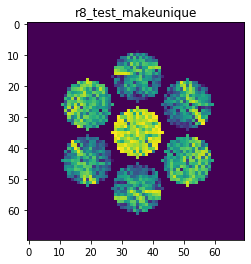

X_sim.max(): 0.900347934785448
nlogf_X_sim.max(): 6.803891348199455
>>>replaced the 134. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 434ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 8.3243e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 338ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 6.7953e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 320ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 8.6279e-04 - val_acc: 1.0000


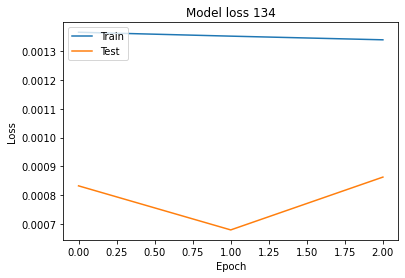

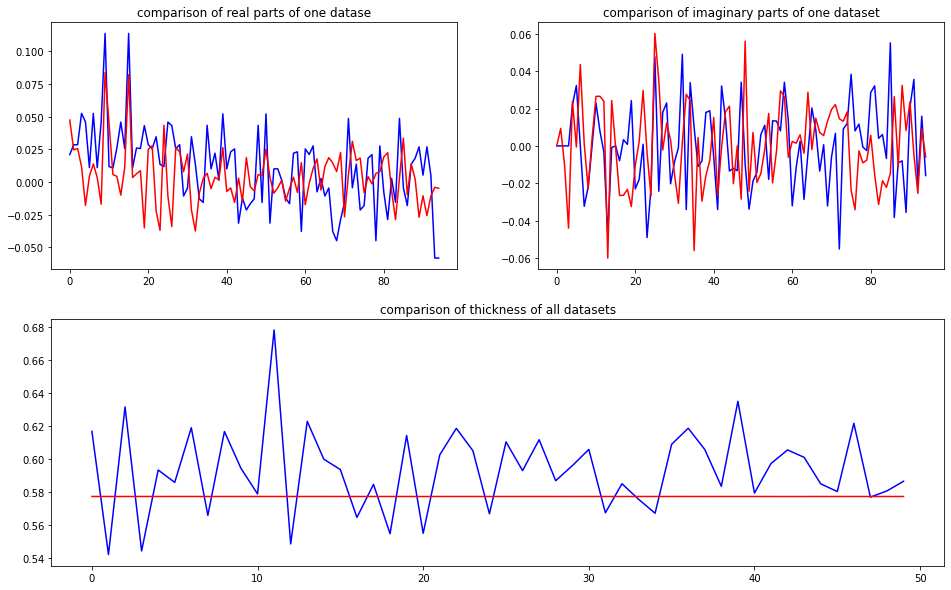

predicted thickness: 0.5774302


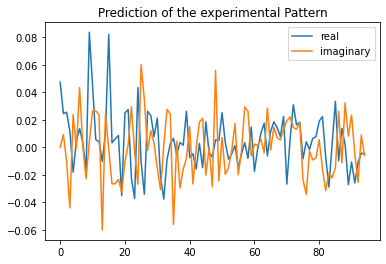

Applied shift of unit cell origin (fractional coordinates): -0.004726216956340744 0.2048106346864828 -0.05946041452662926
Ug[ 0 ]: 0.0474 0.0  =>  0.0474 0.0
Ug[ 1 ]: 0.02695 0.3736  =>  0.02695 0.0
Ug[ 2 ]: 0.02695 -0.3736  =>  0.02695 -0.0
Ug[ 3 ]: 0.04557 -1.28686  =>  0.04557 0.0
Ug[ 4 ]: 0.02917 2.21529  =>  0.02917 3.12855
Ug[ 5 ]: 0.00397 -0.21016  =>  0.00397 1.4503
Ug[ 6 ]: 0.04557 1.28686  =>  0.04557 -0.0
Ug[ 7 ]: 0.00397 0.21016  =>  0.00397 -1.4503
Ug[ 8 ]: 0.02917 -2.21529  =>  0.02917 -3.12855
Ug[ 9 ]: 0.08303 0.0297  =>  0.08303 0.0
Ug[ 10 ]: 0.05169 0.54077  =>  0.05169 0.13747
Ug[ 11 ]: 0.02691 1.40278  =>  0.02691 1.74669
Ug[ 12 ]: 0.0257 1.36461  =>  0.0257 0.04805
Ug[ 13 ]: 0.06098 -1.74318  =>  0.06098 2.84985
Ug[ 14 ]: 0.02568 1.18131  =>  0.02568 0.23835
Ug[ 15 ]: 0.08303 -0.0297  =>  0.08303 -0.0
Ug[ 16 ]: 0.02691 -1.40278  =>  0.02691 -1.74669
Ug[ 17 ]: 0.0257 -1.36461  =>  0.0257 -0.04805
Ug[ 18 ]: 0.02568 -1.18131  =>  0.02568 -0.23835
Ug[ 19 ]: 0.04832 -2.3

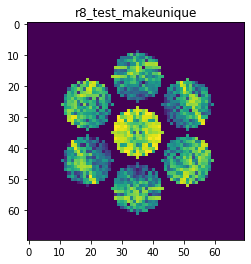

X_sim.max(): 0.8927511247521456
nlogf_X_sim.max(): 6.795427352471364
>>>replaced the 135. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 357ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 6.7549e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 272ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 7.2543e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 265ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 6.7597e-04 - val_acc: 1.0000


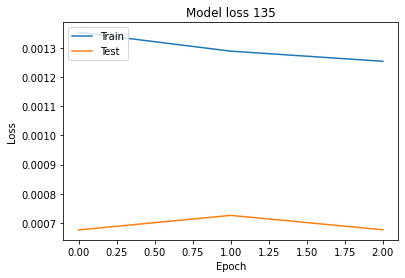

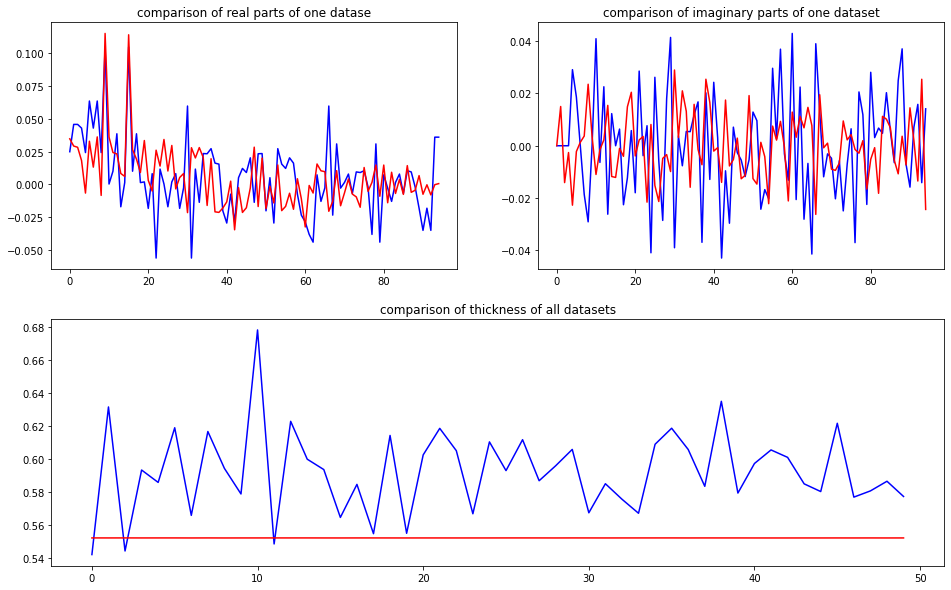

predicted thickness: 0.55238855


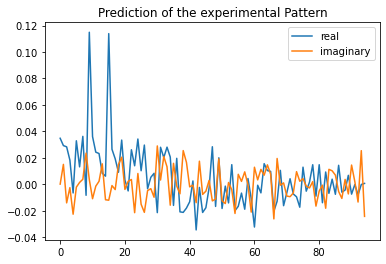

Applied shift of unit cell origin (fractional coordinates): -0.010844821654123636 0.019898904600253165 -0.07457739112863186
Ug[ 0 ]: 0.03476 0.0  =>  0.03476 0.0
Ug[ 1 ]: 0.03222 0.46858  =>  0.03222 -0.0
Ug[ 2 ]: 0.03222 -0.46858  =>  0.03222 0.0
Ug[ 3 ]: 0.01581 -0.12503  =>  0.01581 0.0
Ug[ 4 ]: 0.02428 -1.88439  =>  0.02428 -2.22794
Ug[ 5 ]: 0.03465 -0.08544  =>  0.03465 0.50817
Ug[ 6 ]: 0.01581 0.12503  =>  0.01581 0.0
Ug[ 7 ]: 0.03465 0.08544  =>  0.03465 -0.50817
Ug[ 8 ]: 0.02428 1.88439  =>  0.02428 2.22794
Ug[ 9 ]: 0.11476 0.06814  =>  0.11476 -0.0
Ug[ 10 ]: 0.03638 -0.26519  =>  0.03638 -0.80191
Ug[ 11 ]: 0.02534 -0.00906  =>  0.02534 0.39138
Ug[ 12 ]: 0.02144 0.14667  =>  0.02144 -0.0465
Ug[ 13 ]: 0.01787 1.02676  =>  0.01787 0.36501
Ug[ 14 ]: 0.01532 -1.05349  =>  0.01532 -0.77808
Ug[ 15 ]: 0.11476 -0.06814  =>  0.11476 0.0
Ug[ 16 ]: 0.02534 0.00906  =>  0.02534 -0.39138
Ug[ 17 ]: 0.02144 -0.14667  =>  0.02144 0.0465
Ug[ 18 ]: 0.01532 1.05349  =>  0.01532 0.77808
Ug[ 19 ]: 

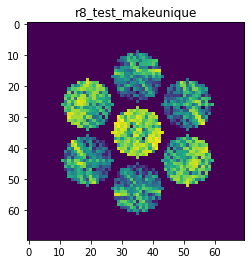

X_sim.max(): 0.9769412827562088
nlogf_X_sim.max(): 6.885449630150873
>>>replaced the 136. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 363ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 7.3795e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 275ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 7.8974e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 274ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 6.9444e-04 - val_acc: 1.0000


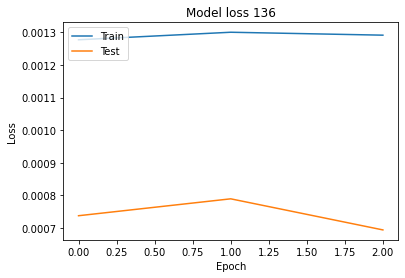

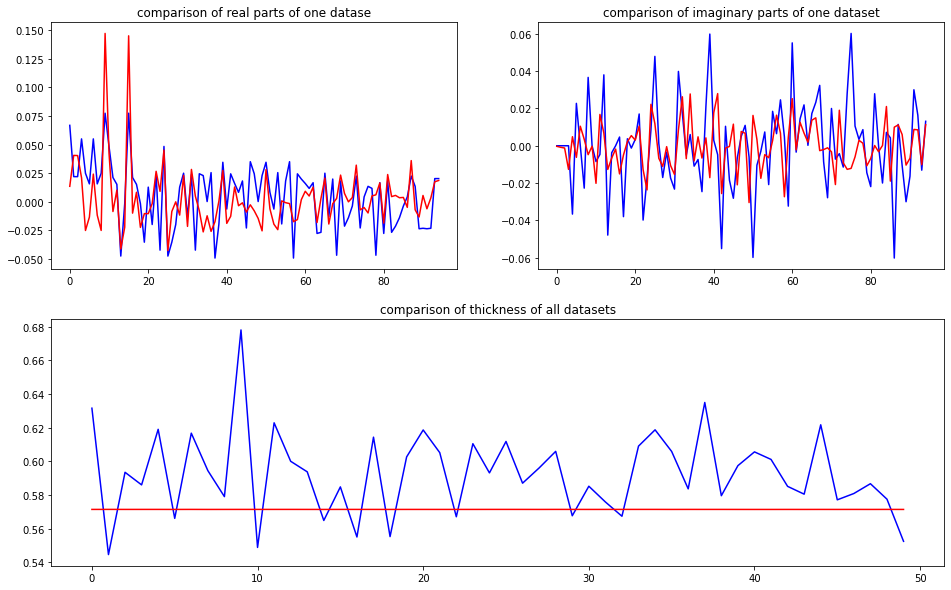

predicted thickness: 0.5713507


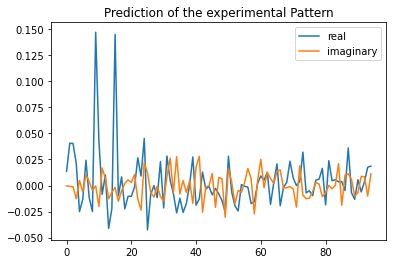

Applied shift of unit cell origin (fractional coordinates): -0.000817497840416187 0.07537821790928584 -0.0008152183160867485
Ug[ 0 ]: 0.01354 0.0  =>  0.01354 0.0
Ug[ 1 ]: 0.04046 0.00512  =>  0.04046 0.0
Ug[ 2 ]: 0.04046 -0.00512  =>  0.04046 0.0
Ug[ 3 ]: 0.02538 -0.47362  =>  0.02538 0.0
Ug[ 4 ]: 0.0255 2.95157  =>  0.0255 -2.86312
Ug[ 5 ]: 0.01345 -2.77353  =>  0.01345 -2.29479
Ug[ 6 ]: 0.02538 0.47362  =>  0.02538 0.0
Ug[ 7 ]: 0.01345 2.77353  =>  0.01345 2.29479
Ug[ 8 ]: 0.0255 -2.95157  =>  0.0255 2.86312
Ug[ 9 ]: 0.14588 0.00514  =>  0.14588 0.0
Ug[ 10 ]: 0.04864 -0.4503  =>  0.04864 -0.46056
Ug[ 11 ]: 0.01841 2.09474  =>  0.01841 2.09473
Ug[ 12 ]: 0.01094 0.5655  =>  0.01094 0.08675
Ug[ 13 ]: 0.0437 -2.85686  =>  0.0437 2.94245
Ug[ 14 ]: 0.02273 -2.94624  =>  0.02273 2.86331
Ug[ 15 ]: 0.14588 -0.00514  =>  0.14588 0.0
Ug[ 16 ]: 0.01841 -2.09474  =>  0.01841 -2.09473
Ug[ 17 ]: 0.01094 -0.5655  =>  0.01094 -0.08675
Ug[ 18 ]: 0.02273 2.94624  =>  0.02273 -2.86331
Ug[ 19 ]: 0.01121

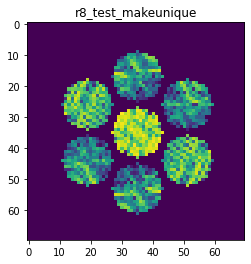

X_sim.max(): 0.9443338653805542
nlogf_X_sim.max(): 6.8515381617981586
>>>replaced the 137. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 406ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 7.2756e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 293ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 6.5649e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 291ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 7.3811e-04 - val_acc: 1.0000


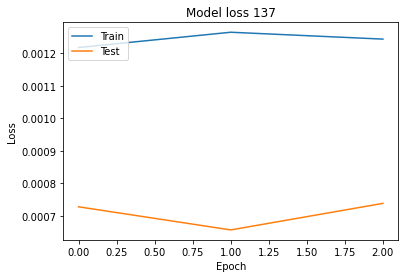

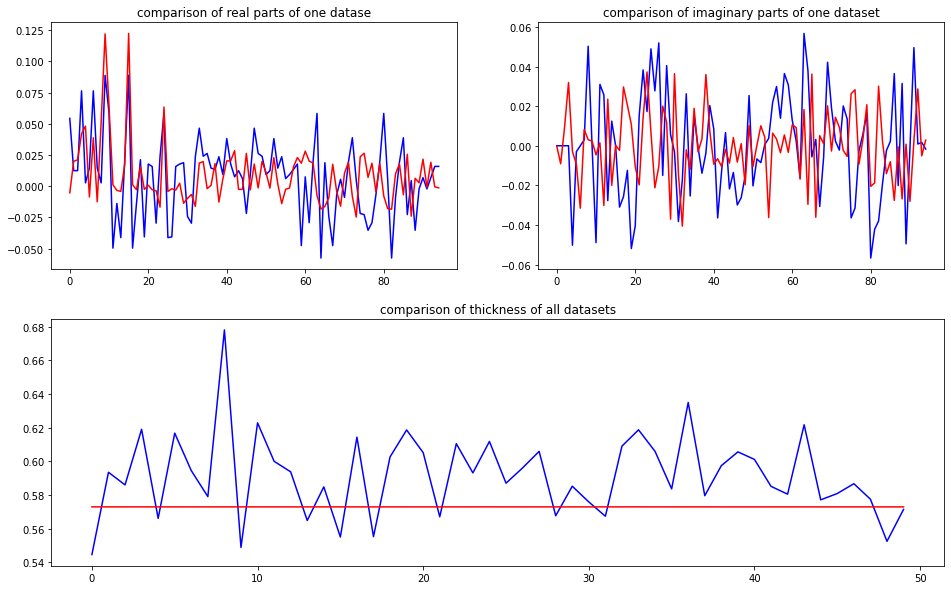

predicted thickness: 0.5728571


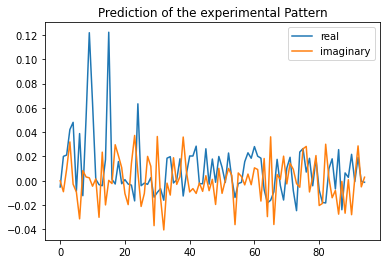

Applied shift of unit cell origin (fractional coordinates): -0.0013735689335907062 -0.10565649032108762 0.0674903383532126
Ug[ 0 ]: 0.00522 3.14159  =>  0.00522 3.14159
Ug[ 1 ]: 0.0226 -0.42405  =>  0.0226 0.0
Ug[ 2 ]: 0.0226 0.42405  =>  0.0226 0.0
Ug[ 3 ]: 0.05146 0.66386  =>  0.05146 0.0
Ug[ 4 ]: 0.05001 -0.06002  =>  0.05001 -0.29983
Ug[ 5 ]: 0.01367 -2.44701  =>  0.01367 2.74826
Ug[ 6 ]: 0.05146 -0.66386  =>  0.05146 -0.0
Ug[ 7 ]: 0.01367 2.44701  =>  0.01367 -2.74826
Ug[ 8 ]: 0.05001 0.06002  =>  0.05001 0.29983
Ug[ 9 ]: 0.12249 0.00863  =>  0.12249 0.0
Ug[ 10 ]: 0.064 -0.08857  =>  0.064 0.32686
Ug[ 11 ]: 0.00224 1.03066  =>  0.00224 0.59798
Ug[ 12 ]: 0.03006 -1.67045  =>  0.03006 -1.01522
Ug[ 13 ]: 0.02276 1.75344  =>  0.02276 2.83272
Ug[ 14 ]: 0.02617 -0.88394  =>  0.02617 -0.65277
Ug[ 15 ]: 0.12249 -0.00863  =>  0.12249 -0.0
Ug[ 16 ]: 0.00224 -1.03066  =>  0.00224 -0.59798
Ug[ 17 ]: 0.03006 1.67045  =>  0.03006 1.01522
Ug[ 18 ]: 0.02617 0.88394  =>  0.02617 0.65277
Ug[ 19 ]: 

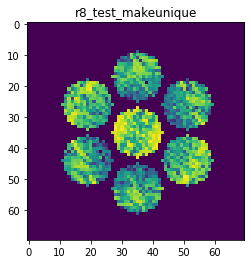

X_sim.max(): 0.8025620158194936
nlogf_X_sim.max(): 6.68905436430185
>>>replaced the 138. dataset and train: 
Epoch 1/3
8/8 [==============================] - 5s 407ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 5.9927e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 305ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 7.3436e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 316ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 6.9554e-04 - val_acc: 1.0000


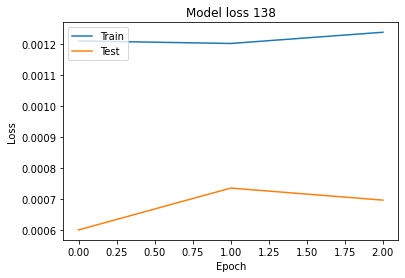

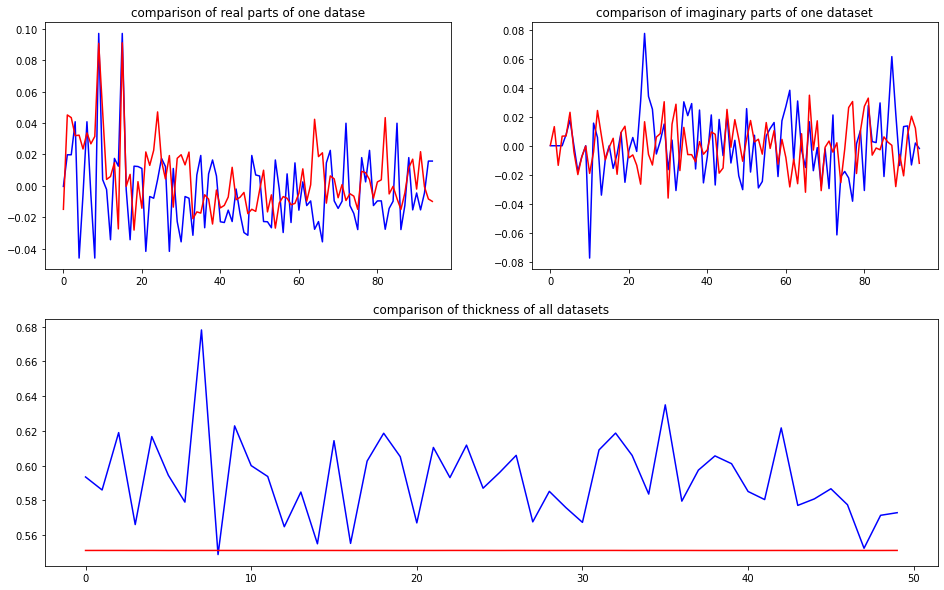

predicted thickness: 0.5511203


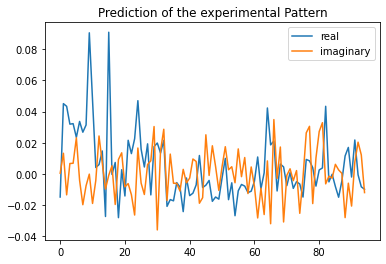

Applied shift of unit cell origin (fractional coordinates): -0.0006397550128330176 -0.025993851519522458 -0.04671479256099558
Ug[ 0 ]: 0.01494 3.14159  =>  0.01494 3.14159
Ug[ 1 ]: 0.04619 0.29352  =>  0.04619 0.0
Ug[ 2 ]: 0.04619 -0.29352  =>  0.04619 0.0
Ug[ 3 ]: 0.03321 0.16332  =>  0.03321 0.0
Ug[ 4 ]: 0.0326 0.22339  =>  0.0326 -0.23345
Ug[ 5 ]: 0.03302 0.7087  =>  0.03302 0.8389
Ug[ 6 ]: 0.03321 -0.16332  =>  0.03321 -0.0
Ug[ 7 ]: 0.03302 -0.7087  =>  0.03302 -0.8389
Ug[ 8 ]: 0.0326 -0.22339  =>  0.0326 0.23345
Ug[ 9 ]: 0.09072 0.00402  =>  0.09072 0.0
Ug[ 10 ]: 0.05033 -0.3619  =>  0.05033 -0.65944
Ug[ 11 ]: 0.00507 -1.20357  =>  0.00507 -0.91407
Ug[ 12 ]: 0.02298 1.28004  =>  0.02298 1.43934
Ug[ 13 ]: 0.01659 0.402  =>  0.01659 0.26778
Ug[ 14 ]: 0.02941 -2.81279  =>  0.02941 -2.35997
Ug[ 15 ]: 0.09072 -0.00402  =>  0.09072 0.0
Ug[ 16 ]: 0.00507 1.20357  =>  0.00507 0.91407
Ug[ 17 ]: 0.02298 -1.28004  =>  0.02298 -1.43934
Ug[ 18 ]: 0.02941 2.81279  =>  0.02941 2.35997
Ug[ 19 ]: 

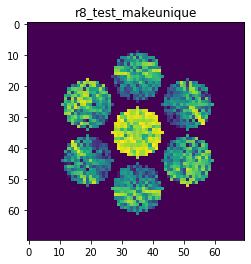

X_sim.max(): 0.9338429402425239
nlogf_X_sim.max(): 6.840378536828502
>>>replaced the 139. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 375ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 5.9745e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 293ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 6.4775e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 295ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 8.4659e-04 - val_acc: 1.0000


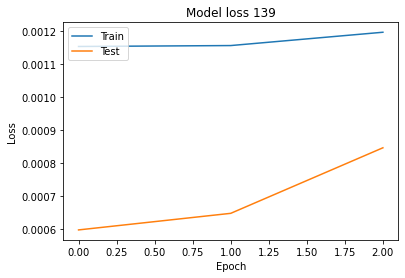

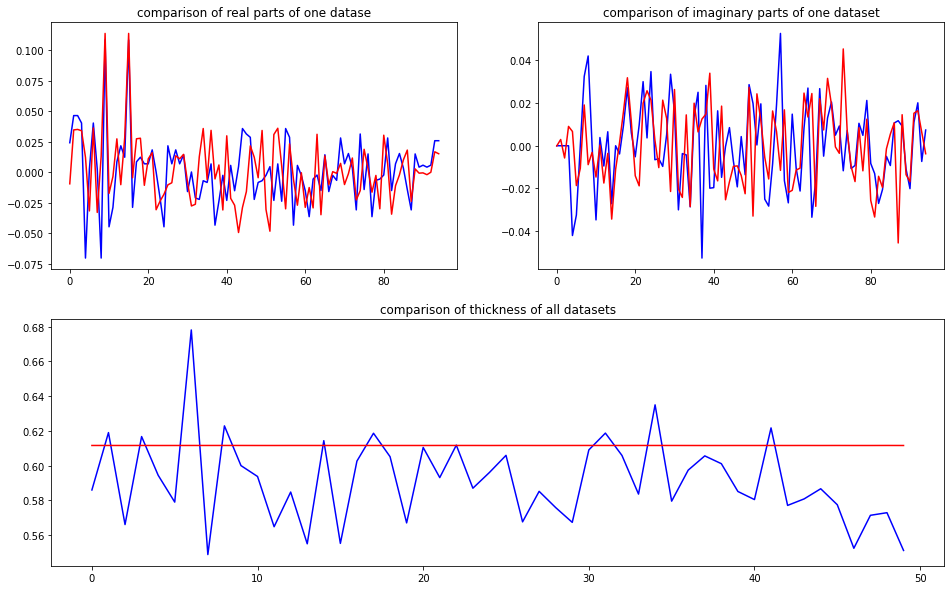

predicted thickness: 0.61154175


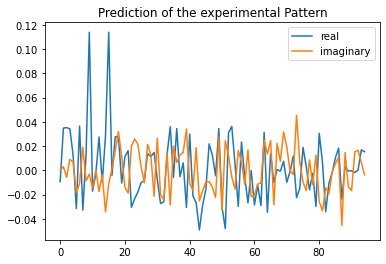

Applied shift of unit cell origin (fractional coordinates): -0.005549352804100575 -0.04330438449541684 -0.01958642488606874
Ug[ 0 ]: 0.00936 3.14159  =>  0.00936 3.14159
Ug[ 1 ]: 0.03525 0.12307  =>  0.03525 0.0
Ug[ 2 ]: 0.03525 -0.12307  =>  0.03525 0.0
Ug[ 3 ]: 0.03662 0.27209  =>  0.03662 0.0
Ug[ 4 ]: 0.01499 0.54574  =>  0.01499 0.15059
Ug[ 5 ]: 0.03733 -2.61019  =>  0.03733 -2.75921
Ug[ 6 ]: 0.03662 -0.27209  =>  0.03662 0.0
Ug[ 7 ]: 0.03733 2.61019  =>  0.03733 2.75921
Ug[ 8 ]: 0.01499 -0.54574  =>  0.01499 -0.15059
Ug[ 9 ]: 0.11375 0.03487  =>  0.11375 0.0
Ug[ 10 ]: 0.0252 -2.34253  =>  0.0252 -2.50046
Ug[ 11 ]: 0.00389 -2.99336  =>  0.00389 -2.90516
Ug[ 12 ]: 0.0322 -0.54703  =>  0.0322 -0.30981
Ug[ 13 ]: 0.01062 -2.83697  =>  0.01062 -2.72282
Ug[ 14 ]: 0.04355 -0.86575  =>  0.04355 -0.50546
Ug[ 15 ]: 0.11375 -0.03487  =>  0.11375 -0.0
Ug[ 16 ]: 0.00389 2.99336  =>  0.00389 2.90516
Ug[ 17 ]: 0.0322 0.54703  =>  0.0322 0.30981
Ug[ 18 ]: 0.04355 0.86575  =>  0.04355 0.50546
Ug[ 1

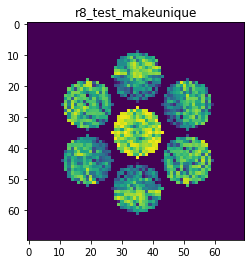

X_sim.max(): 0.912281078915962
nlogf_X_sim.max(): 6.817043696211552
>>>replaced the 140. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 406ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 6.6022e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 325ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 6.1077e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 3s 321ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 7.2014e-04 - val_acc: 1.0000


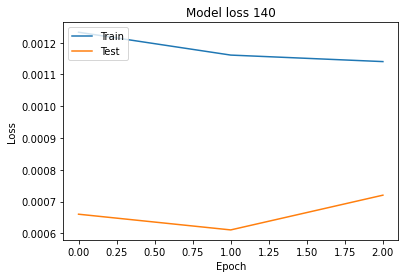

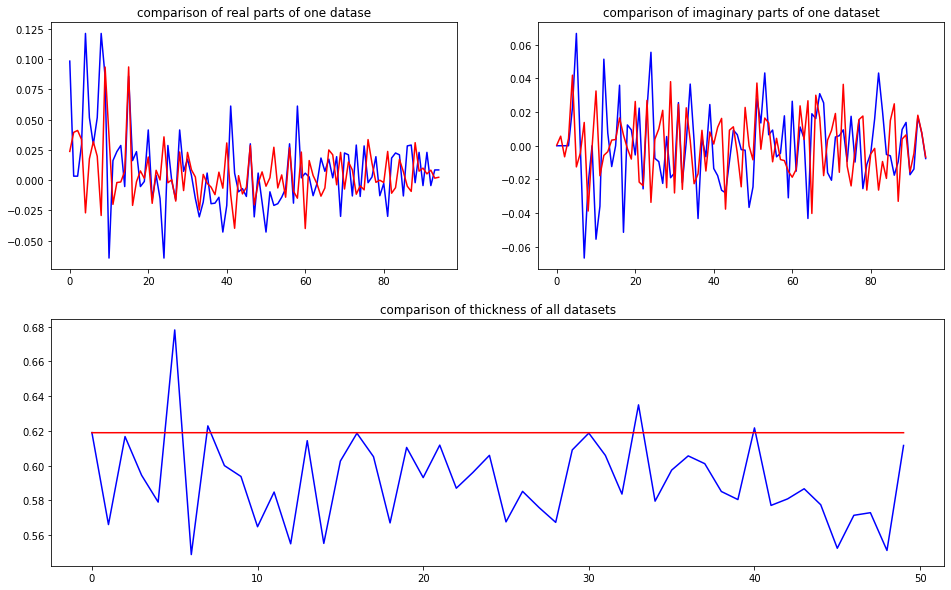

predicted thickness: 0.6188974


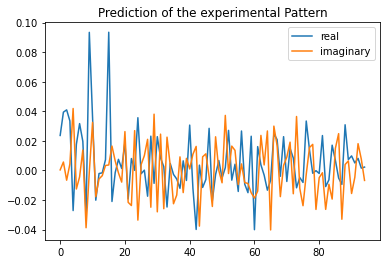

Applied shift of unit cell origin (fractional coordinates): 0.004007111151548865 -0.021091178824577752 -0.02415898728688981
Ug[ 0 ]: 0.02365 0.0  =>  0.02365 0.0
Ug[ 1 ]: 0.04061 0.1518  =>  0.04061 -0.0
Ug[ 2 ]: 0.04061 -0.1518  =>  0.04061 0.0
Ug[ 3 ]: 0.03283 0.13252  =>  0.03283 0.0
Ug[ 4 ]: 0.04922 2.18225  =>  0.04922 1.89794
Ug[ 5 ]: 0.02278 -0.61651  =>  0.02278 -0.59724
Ug[ 6 ]: 0.03283 -0.13252  =>  0.03283 -0.0
Ug[ 7 ]: 0.02278 0.61651  =>  0.02278 0.59724
Ug[ 8 ]: 0.04922 -2.18225  =>  0.04922 -1.89794
Ug[ 9 ]: 0.09325 -0.02518  =>  0.09325 0.0
Ug[ 10 ]: 0.04872 0.74519  =>  0.04872 0.61857
Ug[ 11 ]: 0.02675 -2.44698  =>  0.02675 -2.27001
Ug[ 12 ]: 0.00631 -1.84973  =>  0.00631 -1.69203
Ug[ 13 ]: 0.00419 -2.04988  =>  0.00419 -2.04398
Ug[ 14 ]: 0.00782 0.32466  =>  0.00782 0.63415
Ug[ 15 ]: 0.09325 0.02518  =>  0.09325 0.0
Ug[ 16 ]: 0.02675 2.44698  =>  0.02675 2.27001
Ug[ 17 ]: 0.00631 1.84973  =>  0.00631 1.69203
Ug[ 18 ]: 0.00782 -0.32466  =>  0.00782 -0.63415
Ug[ 19 ]: 

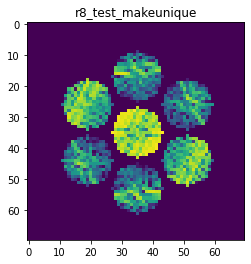

X_sim.max(): 0.9484919621045971
nlogf_X_sim.max(): 6.8559270648185064
>>>replaced the 141. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 426ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 7.1209e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 316ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 6.8259e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 302ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 6.5344e-04 - val_acc: 1.0000


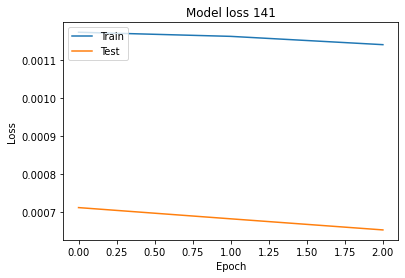

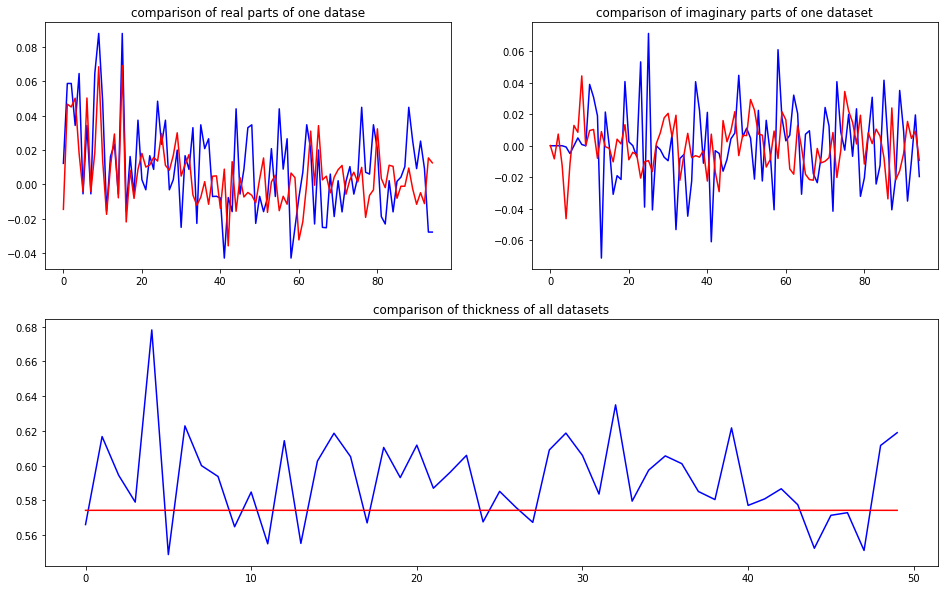

predicted thickness: 0.57422304


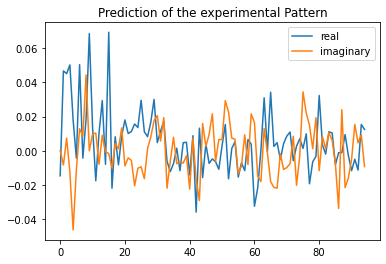

Applied shift of unit cell origin (fractional coordinates): -0.0018248875590400968 0.03928636054089274 0.02705158688525994
Ug[ 0 ]: 0.01466 3.14159  =>  0.01466 3.14159
Ug[ 1 ]: 0.0465 -0.16997  =>  0.0465 -0.0
Ug[ 2 ]: 0.0465 0.16997  =>  0.0465 0.0
Ug[ 3 ]: 0.05179 -0.24684  =>  0.05179 0.0
Ug[ 4 ]: 0.04878 -1.18849  =>  0.04878 -0.77168
Ug[ 5 ]: 0.0108 -1.9832  =>  0.0108 -1.90632
Ug[ 6 ]: 0.05179 0.24684  =>  0.05179 0.0
Ug[ 7 ]: 0.0108 1.9832  =>  0.0108 1.90632
Ug[ 8 ]: 0.04878 1.18849  =>  0.04878 0.77168
Ug[ 9 ]: 0.06885 0.01147  =>  0.06885 0.0
Ug[ 10 ]: 0.01697 0.62463  =>  0.01697 0.78314
Ug[ 11 ]: 0.02224 2.66242  =>  0.02224 2.48099
Ug[ 12 ]: 0.01109 -0.57698  =>  0.01109 -0.83529
Ug[ 13 ]: 0.0308 0.30347  =>  0.0308 0.21513
Ug[ 14 ]: 0.00813 -3.03037  =>  0.00813 2.82453
Ug[ 15 ]: 0.06885 -0.01147  =>  0.06885 0.0
Ug[ 16 ]: 0.02224 -2.66242  =>  0.02224 -2.48099
Ug[ 17 ]: 0.01109 0.57698  =>  0.01109 0.83529
Ug[ 18 ]: 0.00813 3.03037  =>  0.00813 -2.82453
Ug[ 19 ]: 0.0178

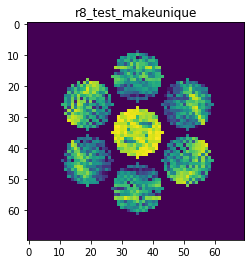

X_sim.max(): 0.9155684164880135
nlogf_X_sim.max(): 6.820636714235029
>>>replaced the 142. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 428ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 7.0290e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 321ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 6.8512e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 3s 352ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 6.9275e-04 - val_acc: 1.0000


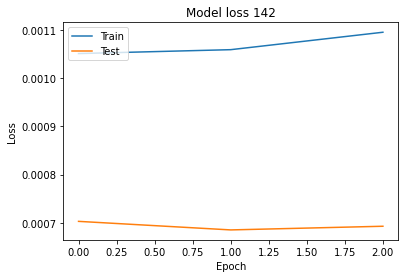

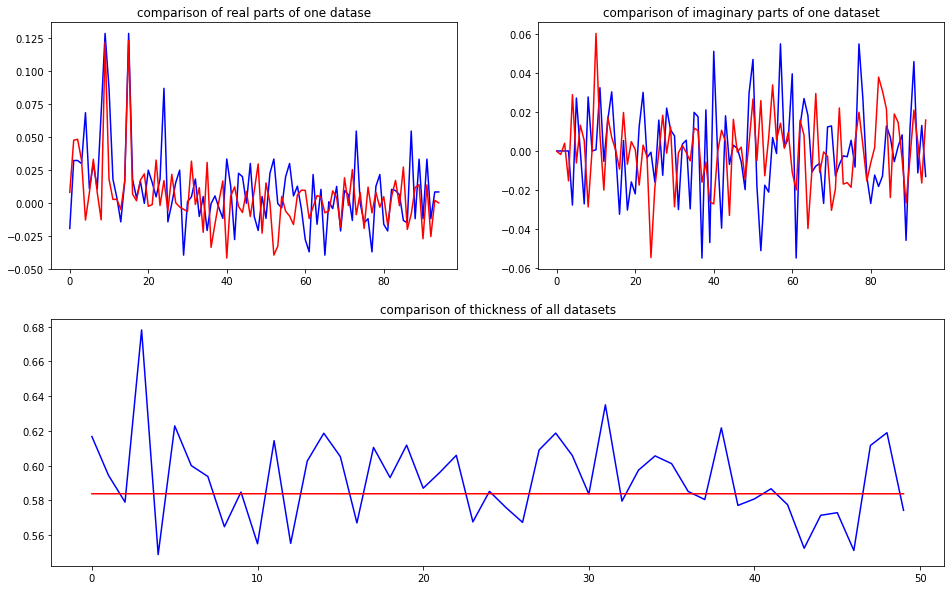

predicted thickness: 0.58375335


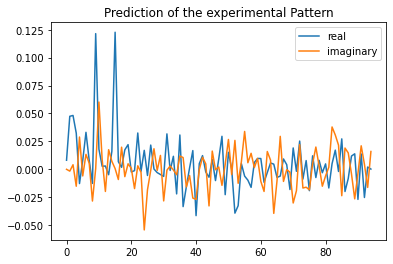

Applied shift of unit cell origin (fractional coordinates): 5.614364961757733e-05 0.06561783763983392 0.009535596778435112
Ug[ 0 ]: 0.00796 0.0  =>  0.00796 0.0
Ug[ 1 ]: 0.04789 -0.05991  =>  0.04789 -0.0
Ug[ 2 ]: 0.04789 0.05991  =>  0.04789 0.0
Ug[ 3 ]: 0.03564 -0.41229  =>  0.03564 0.0
Ug[ 4 ]: 0.03146 1.9921  =>  0.03146 2.4643
Ug[ 5 ]: 0.00969 -0.63154  =>  0.00969 -0.27916
Ug[ 6 ]: 0.03564 0.41229  =>  0.03564 -0.0
Ug[ 7 ]: 0.00969 0.63154  =>  0.00969 0.27916
Ug[ 8 ]: 0.03146 -1.9921  =>  0.03146 -2.4643
Ug[ 9 ]: 0.12241 -0.00035  =>  0.12241 0.0
Ug[ 10 ]: 0.05994 1.2757  =>  0.05994 1.33596
Ug[ 11 ]: 0.01007 1.09264  =>  0.01007 1.03308
Ug[ 12 ]: 0.01997 -1.45999  =>  0.01997 -1.87193
Ug[ 13 ]: 0.01874 1.86062  =>  0.01874 1.5086
Ug[ 14 ]: 0.0181 0.38969  =>  0.0181 -0.08216
Ug[ 15 ]: 0.12241 0.00035  =>  0.12241 0.0
Ug[ 16 ]: 0.01007 -1.09264  =>  0.01007 -1.03308
Ug[ 17 ]: 0.01997 1.45999  =>  0.01997 1.87193
Ug[ 18 ]: 0.0181 -0.38969  =>  0.0181 0.08216
Ug[ 19 ]: 0.02197 0.1

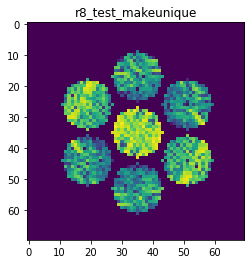

X_sim.max(): 0.9616846175737082
nlogf_X_sim.max(): 6.869725858234854
>>>replaced the 143. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 432ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 6.2481e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 327ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 6.4333e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 314ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 7.1859e-04 - val_acc: 1.0000


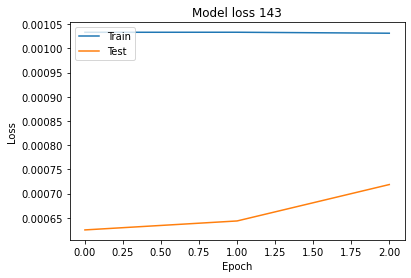

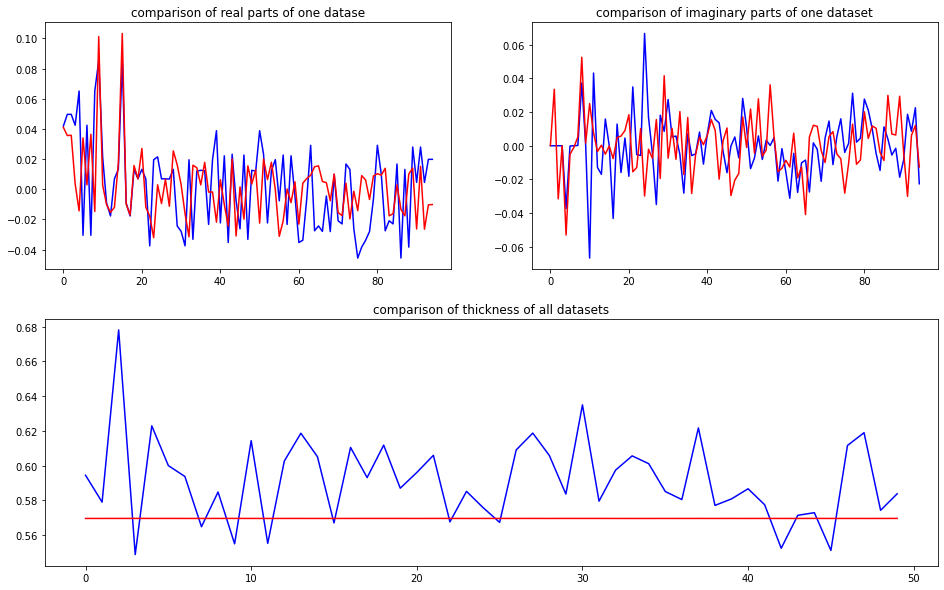

predicted thickness: 0.5695551


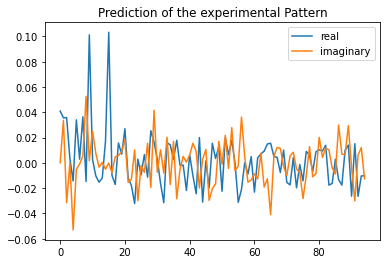

Applied shift of unit cell origin (fractional coordinates): -0.001378220954523497 -0.022462645987002632 -0.11758831635635628
Ug[ 0 ]: 0.04101 0.0  =>  0.04101 0.0
Ug[ 1 ]: 0.04831 0.73883  =>  0.04831 0.0
Ug[ 2 ]: 0.04831 -0.73883  =>  0.04831 0.0
Ug[ 3 ]: 0.00326 0.14114  =>  0.00326 0.0
Ug[ 4 ]: 0.05472 -1.83878  =>  0.05472 -2.71874
Ug[ 5 ]: 0.03561 -0.14521  =>  0.03561 0.45249
Ug[ 6 ]: 0.00326 -0.14114  =>  0.00326 -0.0
Ug[ 7 ]: 0.03561 0.14521  =>  0.03561 -0.45249
Ug[ 8 ]: 0.05472 1.83878  =>  0.05472 2.71874
Ug[ 9 ]: 0.10238 0.00866  =>  0.10238 -0.0
Ug[ 10 ]: 0.02759 1.46681  =>  0.02759 0.71932
Ug[ 11 ]: 0.01265 2.48955  =>  0.01265 -3.06347
Ug[ 12 ]: 0.01671 -2.88967  =>  0.01671 -2.75719
Ug[ 13 ]: 0.01081 3.03075  =>  0.01081 2.4244
Ug[ 14 ]: 0.0173 -0.31566  =>  0.0173 0.55565
Ug[ 15 ]: 0.10238 -0.00866  =>  0.10238 0.0
Ug[ 16 ]: 0.01265 -2.48955  =>  0.01265 3.06347
Ug[ 17 ]: 0.01671 2.88967  =>  0.01671 2.75719
Ug[ 18 ]: 0.0173 0.31566  =>  0.0173 -0.55565
Ug[ 19 ]: 0.01

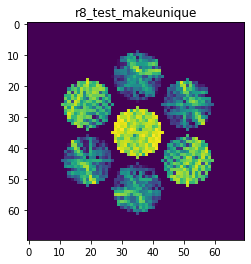

X_sim.max(): 0.9650886995489807
nlogf_X_sim.max(): 6.87325565147646
>>>replaced the 144. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 442ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 6.5724e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 3s 341ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 6.5613e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 3s 347ms/step - loss: 9.9209e-04 - acc: 1.0000 - val_loss: 6.1863e-04 - val_acc: 1.0000


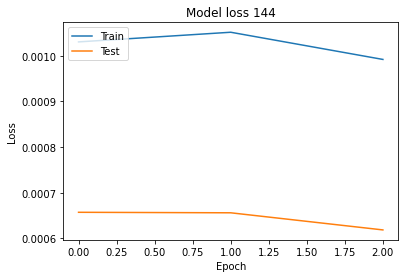

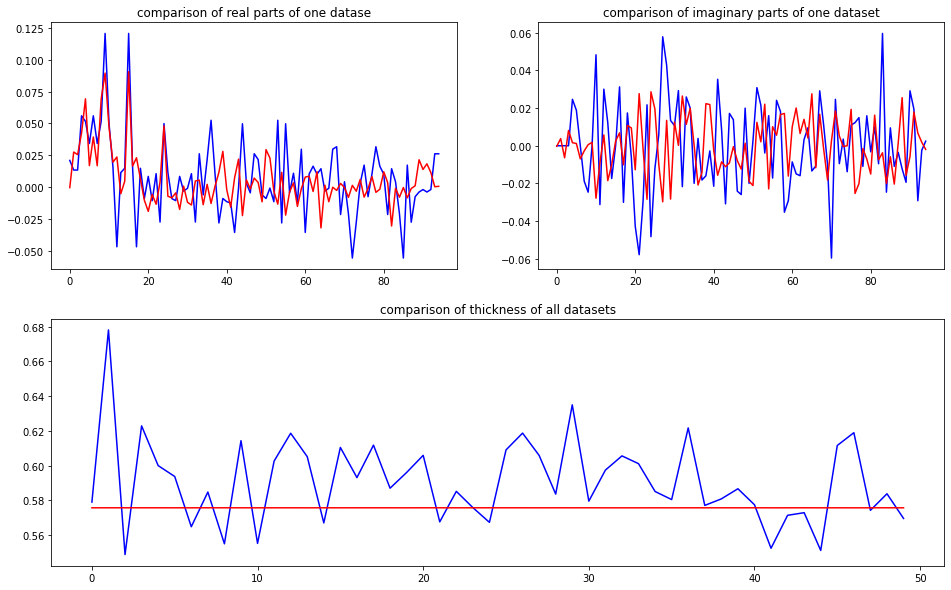

predicted thickness: 0.5756757


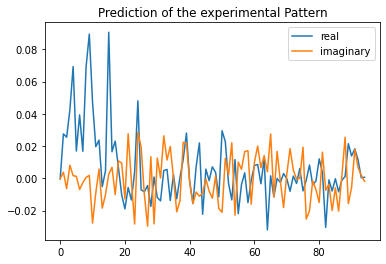

Applied shift of unit cell origin (fractional coordinates): 0.000605728869662501 -0.028878106100795584 -0.03029283956041657
Ug[ 0 ]: 0.00034 3.14159  =>  0.00034 3.14159
Ug[ 1 ]: 0.02699 0.19034  =>  0.02699 0.0
Ug[ 2 ]: 0.02699 -0.19034  =>  0.02699 0.0
Ug[ 3 ]: 0.04155 0.18145  =>  0.04155 -0.0
Ug[ 4 ]: 0.06911 0.00765  =>  0.06911 -0.36413
Ug[ 5 ]: 0.01695 0.11525  =>  0.01695 0.12414
Ug[ 6 ]: 0.04155 -0.18145  =>  0.04155 0.0
Ug[ 7 ]: 0.01695 -0.11525  =>  0.01695 -0.12414
Ug[ 8 ]: 0.06911 -0.00765  =>  0.06911 0.36413
Ug[ 9 ]: 0.08992 -0.00381  =>  0.08992 0.0
Ug[ 10 ]: 0.05524 -0.53557  =>  0.05524 -0.7221
Ug[ 11 ]: 0.0197 -0.41439  =>  0.0197 -0.22025
Ug[ 12 ]: 0.02466 0.32651  =>  0.02466 0.51177
Ug[ 13 ]: 0.01997 -1.88421  =>  0.01997 -1.88929
Ug[ 14 ]: 0.01183 -1.08049  =>  0.01183 -0.70491
Ug[ 15 ]: 0.08992 0.00381  =>  0.08992 0.0
Ug[ 16 ]: 0.0197 0.41439  =>  0.0197 0.22025
Ug[ 17 ]: 0.02466 -0.32651  =>  0.02466 -0.51177
Ug[ 18 ]: 0.01183 1.08049  =>  0.01183 0.70491
Ug[ 

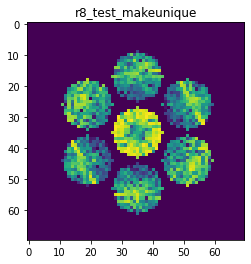

X_sim.max(): 0.9240832335441477
nlogf_X_sim.max(): 6.829883715674159
>>>replaced the 145. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 398ms/step - loss: 9.5874e-04 - acc: 1.0000 - val_loss: 6.7247e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 315ms/step - loss: 9.3901e-04 - acc: 1.0000 - val_loss: 6.1779e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 283ms/step - loss: 9.4355e-04 - acc: 1.0000 - val_loss: 5.9365e-04 - val_acc: 1.0000


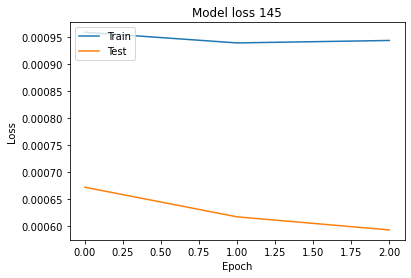

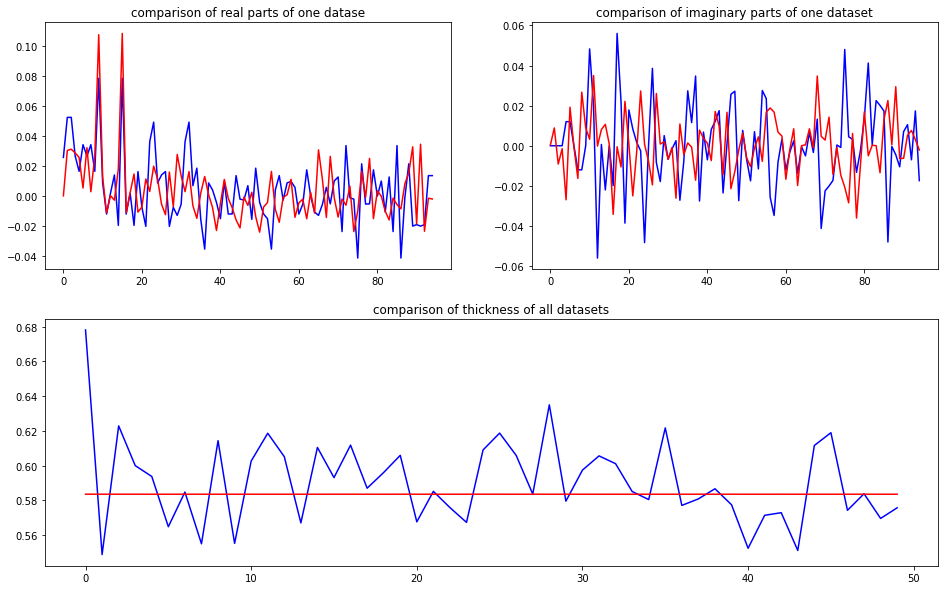

predicted thickness: 0.58349717


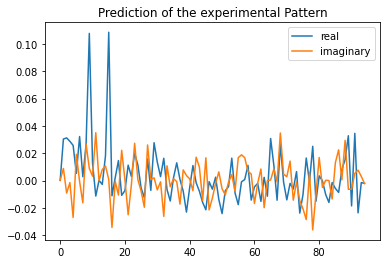

Applied shift of unit cell origin (fractional coordinates): -0.00590670265296012 0.0022230339732405677 -0.04527598687034501
Ug[ 0 ]: 0.00012 0.0  =>  0.00012 0.0
Ug[ 1 ]: 0.03213 0.28448  =>  0.03213 0.0
Ug[ 2 ]: 0.03213 -0.28448  =>  0.03213 0.0
Ug[ 3 ]: 0.03051 -0.01397  =>  0.03051 0.0
Ug[ 4 ]: 0.03745 -0.79928  =>  0.03745 -1.06978
Ug[ 5 ]: 0.01823 1.34543  =>  0.01823 1.64387
Ug[ 6 ]: 0.03051 0.01397  =>  0.03051 0.0
Ug[ 7 ]: 0.01823 -1.34543  =>  0.01823 -1.64387
Ug[ 8 ]: 0.03745 0.79928  =>  0.03745 1.06978
Ug[ 9 ]: 0.10833 0.03711  =>  0.10833 0.0
Ug[ 10 ]: 0.0121 0.10489  =>  0.0121 -0.2167
Ug[ 11 ]: 0.03639 1.88356  =>  0.03639 2.13092
Ug[ 12 ]: 0.0012 0.12978  =>  0.0012 0.0787
Ug[ 13 ]: 0.00888 2.05056  =>  0.00888 1.71501
Ug[ 14 ]: 0.01957 0.57376  =>  0.01957 0.80715
Ug[ 15 ]: 0.10833 -0.03711  =>  0.10833 0.0
Ug[ 16 ]: 0.03639 -1.88356  =>  0.03639 -2.13092
Ug[ 17 ]: 0.0012 -0.12978  =>  0.0012 -0.0787
Ug[ 18 ]: 0.01957 -0.57376  =>  0.01957 -0.80715
Ug[ 19 ]: 0.02385 2.

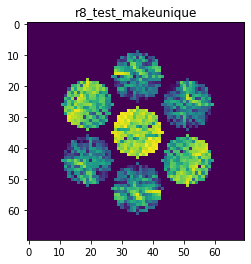

X_sim.max(): 0.9536771324559461
nlogf_X_sim.max(): 6.861373202120435
>>>replaced the 146. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 369ms/step - loss: 9.4414e-04 - acc: 1.0000 - val_loss: 5.9990e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 266ms/step - loss: 9.5637e-04 - acc: 1.0000 - val_loss: 6.4627e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 276ms/step - loss: 9.3086e-04 - acc: 1.0000 - val_loss: 6.3690e-04 - val_acc: 1.0000


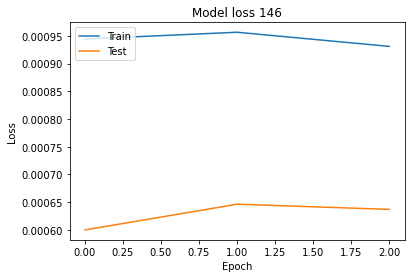

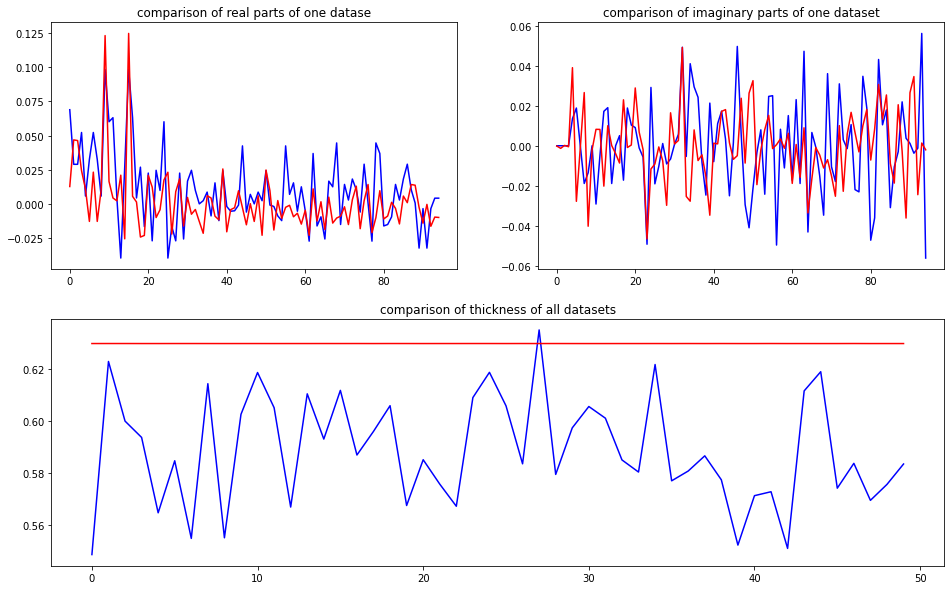

predicted thickness: 0.62970746


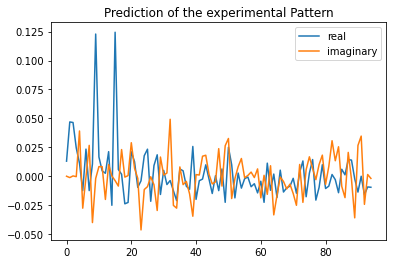

Applied shift of unit cell origin (fractional coordinates): -0.0011983991655676982 -0.0015797522914931703 0.002469109883333423
Ug[ 0 ]: 0.0129 0.0  =>  0.0129 0.0
Ug[ 1 ]: 0.04661 -0.01551  =>  0.04661 0.0
Ug[ 2 ]: 0.04661 0.01551  =>  0.04661 0.0
Ug[ 3 ]: 0.02385 0.00993  =>  0.02385 -0.0
Ug[ 4 ]: 0.04107 1.3053  =>  0.04107 1.31089
Ug[ 5 ]: 0.02994 -2.00411  =>  0.02994 -2.02955
Ug[ 6 ]: 0.02385 -0.00993  =>  0.02385 0.0
Ug[ 7 ]: 0.02994 2.00411  =>  0.02994 2.02955
Ug[ 8 ]: 0.04107 -1.3053  =>  0.04107 -1.31089
Ug[ 9 ]: 0.12359 0.00753  =>  0.12359 0.0
Ug[ 10 ]: 0.01976 0.52557  =>  0.01976 0.53356
Ug[ 11 ]: 0.00984 1.02479  =>  0.00984 1.00175
Ug[ 12 ]: 0.02167 -1.47803  =>  0.02167 -1.47563
Ug[ 13 ]: 0.02418 0.40689  =>  0.02418 0.4248
Ug[ 14 ]: 0.02464 3.12164  =>  0.02464 3.10853
Ug[ 15 ]: 0.12359 -0.00753  =>  0.12359 0.0
Ug[ 16 ]: 0.00984 -1.02479  =>  0.00984 -1.00175
Ug[ 17 ]: 0.02167 1.47803  =>  0.02167 1.47563
Ug[ 18 ]: 0.02464 -3.12164  =>  0.02464 -3.10853
Ug[ 19 ]: 0.0

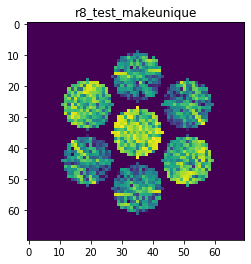

X_sim.max(): 0.9473272294388967
nlogf_X_sim.max(): 6.854699621427562
>>>replaced the 147. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 376ms/step - loss: 9.0569e-04 - acc: 1.0000 - val_loss: 5.5671e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 294ms/step - loss: 8.5894e-04 - acc: 1.0000 - val_loss: 5.5342e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 275ms/step - loss: 8.7256e-04 - acc: 1.0000 - val_loss: 6.3413e-04 - val_acc: 1.0000


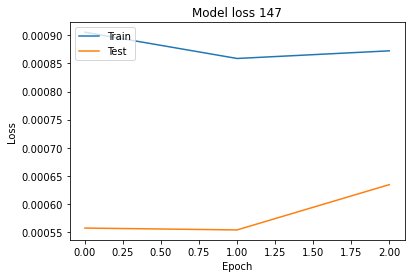

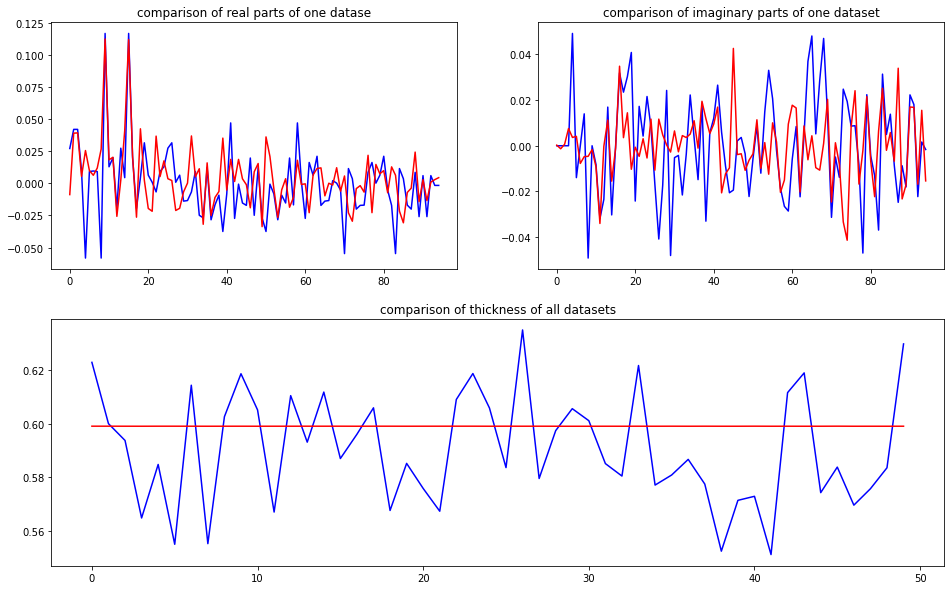

predicted thickness: 0.5990096


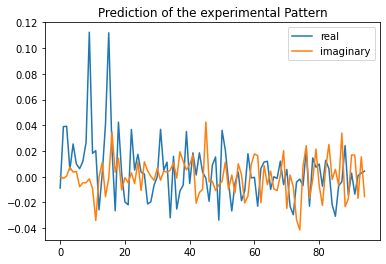

Applied shift of unit cell origin (fractional coordinates): 0.0004967795017511997 -0.14642261733200965 0.003983637161596406
Ug[ 0 ]: 0.00881 3.14159  =>  0.00881 3.14159
Ug[ 1 ]: 0.03913 -0.02503  =>  0.03913 0.0
Ug[ 2 ]: 0.03913 0.02503  =>  0.03913 0.0
Ug[ 3 ]: 0.00959 0.92  =>  0.00959 0.0
Ug[ 4 ]: 0.0264 0.15708  =>  0.0264 -0.73789
Ug[ 5 ]: 0.01176 0.38652  =>  0.01176 -0.55851
Ug[ 6 ]: 0.00959 -0.92  =>  0.00959 -0.0
Ug[ 7 ]: 0.01176 -0.38652  =>  0.01176 0.55851
Ug[ 8 ]: 0.0264 -0.15708  =>  0.0264 0.73789
Ug[ 9 ]: 0.11214 -0.00312  =>  0.11214 0.0
Ug[ 10 ]: 0.02068 -0.52916  =>  0.02068 -0.50101
Ug[ 11 ]: 0.04025 -1.0248  =>  0.04025 -1.04671
Ug[ 12 ]: 0.02611 -3.07013  =>  0.02611 -2.14701
Ug[ 13 ]: 0.01138 1.2996  =>  0.01138 2.24775
Ug[ 14 ]: 0.04431 -0.34436  =>  0.04431 0.55373
Ug[ 15 ]: 0.11214 0.00312  =>  0.11214 -0.0
Ug[ 16 ]: 0.04025 1.0248  =>  0.04025 1.04671
Ug[ 17 ]: 0.02611 3.07013  =>  0.02611 2.14701
Ug[ 18 ]: 0.04431 0.34436  =>  0.04431 -0.55373
Ug[ 19 ]: 0.0

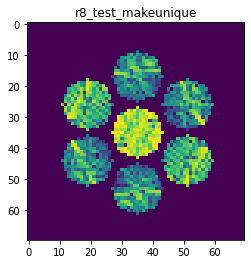

X_sim.max(): 0.879011004822968
nlogf_X_sim.max(): 6.779934412874705
>>>replaced the 148. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 338ms/step - loss: 8.8030e-04 - acc: 1.0000 - val_loss: 6.0779e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 248ms/step - loss: 8.7037e-04 - acc: 1.0000 - val_loss: 6.1770e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 245ms/step - loss: 8.4880e-04 - acc: 1.0000 - val_loss: 5.8033e-04 - val_acc: 1.0000


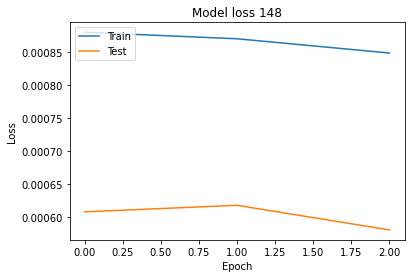

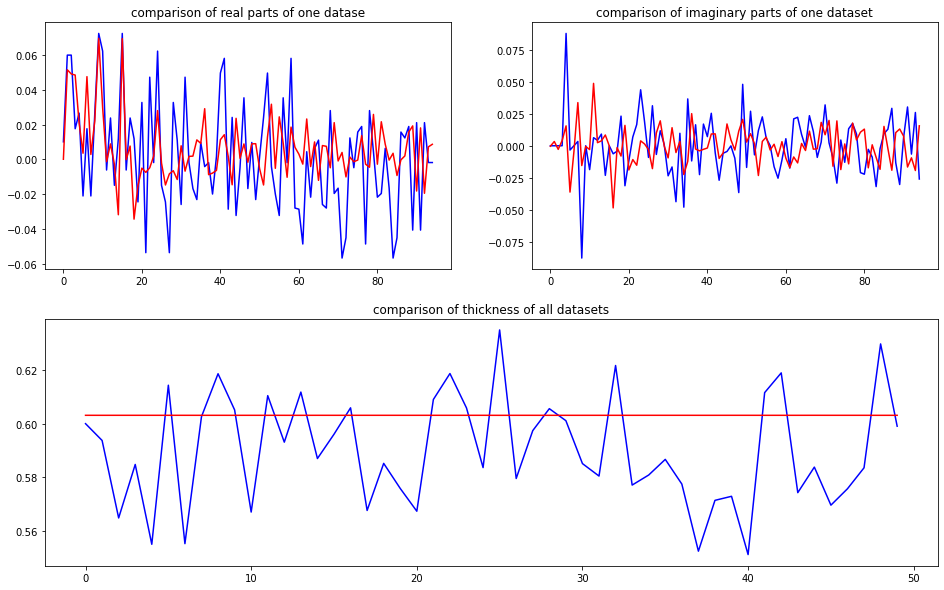

predicted thickness: 0.60307676


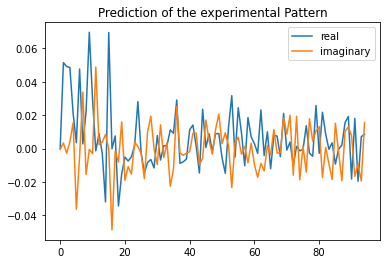

Applied shift of unit cell origin (fractional coordinates): 0.0004735050554741327 -0.014389926010443525 -0.009678869806534863
Ug[ 0 ]: 1e-05 3.14159  =>  1e-05 3.14159
Ug[ 1 ]: 0.05032 0.06081  =>  0.05032 -0.0
Ug[ 2 ]: 0.05032 -0.06081  =>  0.05032 0.0
Ug[ 3 ]: 0.0482 0.09041  =>  0.0482 0.0
Ug[ 4 ]: 0.02653 0.62469  =>  0.02653 0.47347
Ug[ 5 ]: 0.03518 -1.4816  =>  0.03518 -1.5112
Ug[ 6 ]: 0.0482 -0.09041  =>  0.0482 0.0
Ug[ 7 ]: 0.03518 1.4816  =>  0.03518 1.5112
Ug[ 8 ]: 0.02653 -0.62469  =>  0.02653 -0.47347
Ug[ 9 ]: 0.06942 -0.00298  =>  0.06942 0.0
Ug[ 10 ]: 0.02894 -0.07521  =>  0.02894 -0.13305
Ug[ 11 ]: 0.04873 1.58725  =>  0.04873 1.65104
Ug[ 12 ]: 0.00848 0.23713  =>  0.00848 0.33052
Ug[ 13 ]: 0.00424 2.20957  =>  0.00424 2.24214
Ug[ 14 ]: 0.03416 2.89825  =>  0.03416 3.05246
Ug[ 15 ]: 0.06942 0.00298  =>  0.06942 -0.0
Ug[ 16 ]: 0.04873 -1.58725  =>  0.04873 -1.65104
Ug[ 17 ]: 0.00848 -0.23713  =>  0.00848 -0.33052
Ug[ 18 ]: 0.03416 -2.89825  =>  0.03416 -3.05246
Ug[ 19 ]: 

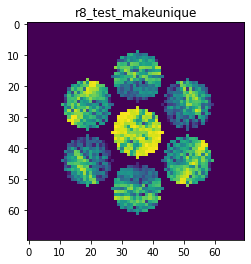

X_sim.max(): 0.9455528778956147
nlogf_X_sim.max(): 6.852826835856574
>>>replaced the 149. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 364ms/step - loss: 8.0954e-04 - acc: 1.0000 - val_loss: 5.9194e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 281ms/step - loss: 8.3762e-04 - acc: 1.0000 - val_loss: 6.1205e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 283ms/step - loss: 7.9486e-04 - acc: 1.0000 - val_loss: 5.6537e-04 - val_acc: 1.0000


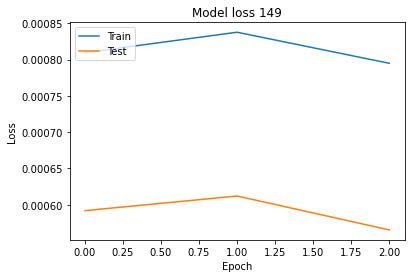

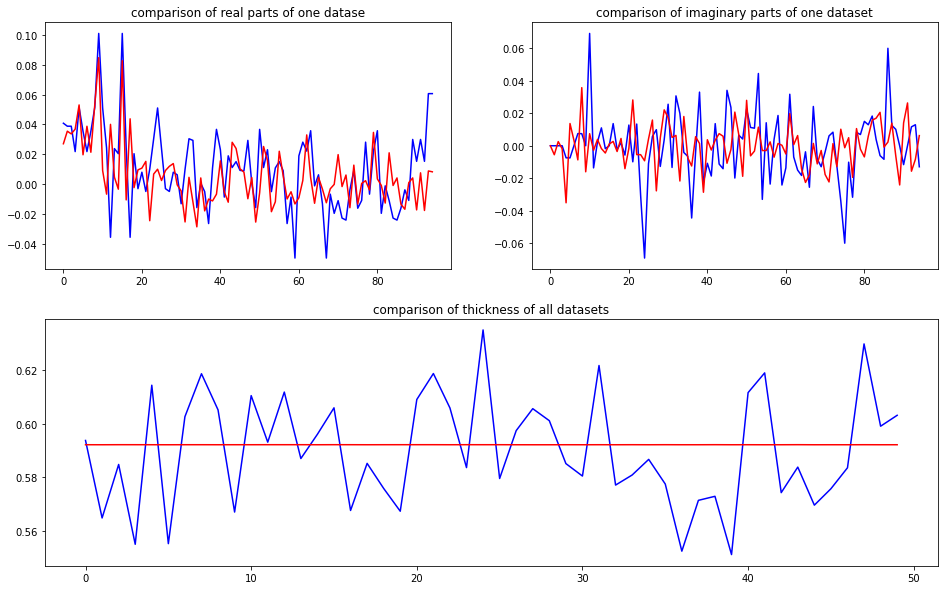

predicted thickness: 0.5921046


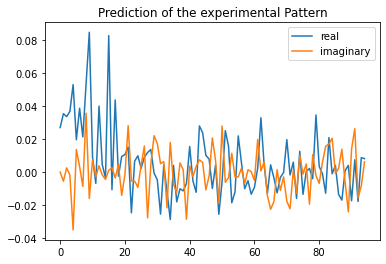

Applied shift of unit cell origin (fractional coordinates): 0.016205060781968376 0.010912768613595253 0.018546986554266783
Ug[ 0 ]: 0.02697 0.0  =>  0.02697 0.0
Ug[ 1 ]: 0.03472 -0.11653  =>  0.03472 -0.0
Ug[ 2 ]: 0.03472 0.11653  =>  0.03472 0.0
Ug[ 3 ]: 0.0378 -0.06857  =>  0.0378 -0.0
Ug[ 4 ]: 0.0638 -0.58734  =>  0.0638 -0.40224
Ug[ 5 ]: 0.02328 0.50027  =>  0.02328 0.4523
Ug[ 6 ]: 0.0378 0.06857  =>  0.0378 0.0
Ug[ 7 ]: 0.02328 -0.50027  =>  0.02328 -0.4523
Ug[ 8 ]: 0.0638 0.58734  =>  0.0638 0.40224
Ug[ 9 ]: 0.0841 -0.10182  =>  0.0841 0.0
Ug[ 10 ]: 0.01258 0.72346  =>  0.01258 0.94181
Ug[ 11 ]: 0.00917 -2.84083  =>  0.00917 -2.85554
Ug[ 12 ]: 0.04198 0.08816  =>  0.04198 0.12141
Ug[ 13 ]: 0.00451 -0.70745  =>  0.00451 -0.55766
Ug[ 14 ]: 0.00538 -2.15903  =>  0.00538 -2.24231
Ug[ 15 ]: 0.0841 0.10182  =>  0.0841 0.0
Ug[ 16 ]: 0.00917 2.84083  =>  0.00917 2.85554
Ug[ 17 ]: 0.04198 -0.08816  =>  0.04198 -0.12141
Ug[ 18 ]: 0.00538 2.15903  =>  0.00538 2.24231
Ug[ 19 ]: 0.01755 -1.01

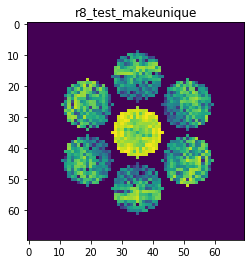

X_sim.max(): 0.9273071100849376
nlogf_X_sim.max(): 6.833362615629961
>>>replaced the 150. dataset and train: 
Epoch 1/3
8/8 [==============================] - 4s 340ms/step - loss: 7.4998e-04 - acc: 1.0000 - val_loss: 6.1831e-04 - val_acc: 1.0000
Epoch 2/3
8/8 [==============================] - 2s 273ms/step - loss: 7.5949e-04 - acc: 1.0000 - val_loss: 5.0320e-04 - val_acc: 1.0000
Epoch 3/3
8/8 [==============================] - 2s 298ms/step - loss: 7.6045e-04 - acc: 1.0000 - val_loss: 5.7332e-04 - val_acc: 1.0000


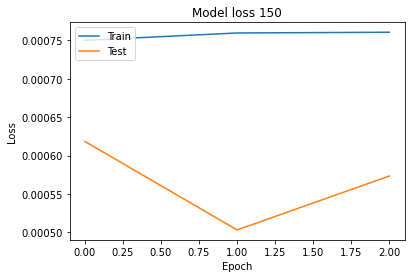

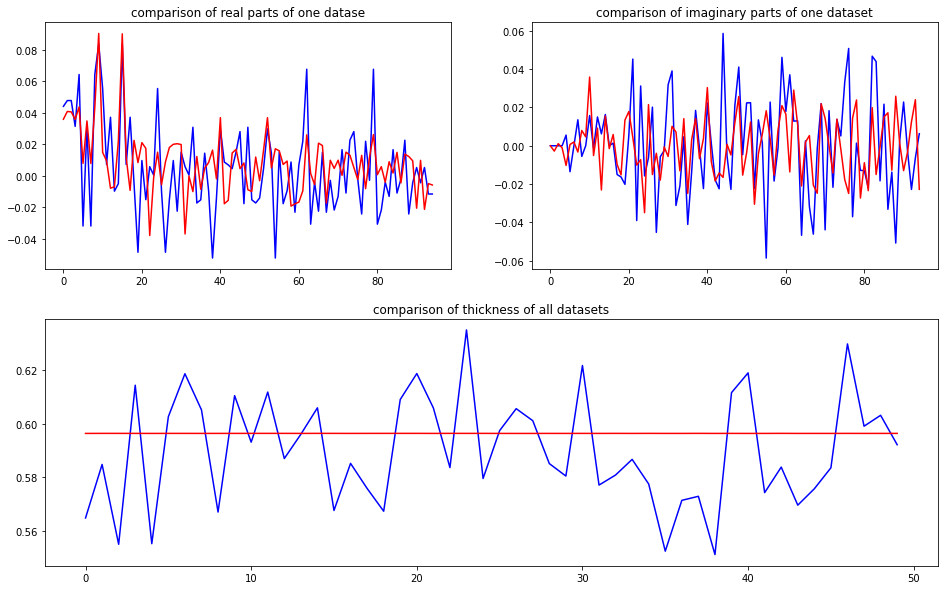

predicted thickness: 0.59633106


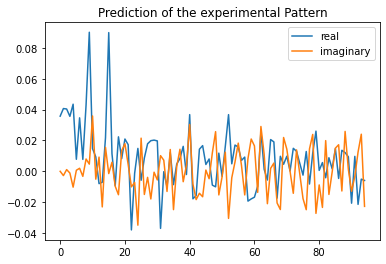

Applied shift of unit cell origin (fractional coordinates): -0.00540976767508407 0.007008751219095987 0.007620953293429063
Ug[ 0 ]: 0.03578 0.0  =>  0.03578 0.0
Ug[ 1 ]: 0.04064 -0.04788  =>  0.04064 0.0
Ug[ 2 ]: 0.04064 0.04788  =>  0.04064 -0.0
Ug[ 3 ]: 0.03521 -0.04404  =>  0.03521 0.0
Ug[ 4 ]: 0.04427 -0.20767  =>  0.04427 -0.11575
Ug[ 5 ]: 0.008 0.24945  =>  0.008 0.2456
Ug[ 6 ]: 0.03521 0.04404  =>  0.03521 0.0
Ug[ 7 ]: 0.008 -0.24945  =>  0.008 -0.2456
Ug[ 8 ]: 0.04427 0.20767  =>  0.04427 0.11575
Ug[ 9 ]: 0.09028 0.03399  =>  0.09028 0.0
Ug[ 10 ]: 0.0384 1.17484  =>  0.0384 1.18873
Ug[ 11 ]: 0.01172 -0.48764  =>  0.01172 -0.56951
Ug[ 12 ]: 0.01284 2.31345  =>  0.01284 2.23542
Ug[ 13 ]: 0.02322 -1.85283  =>  0.02322 -1.88298
Ug[ 14 ]: 0.02689 0.60816  =>  0.02689 0.48225
Ug[ 15 ]: 0.09028 -0.03399  =>  0.09028 -0.0
Ug[ 16 ]: 0.01172 0.48764  =>  0.01172 0.56951
Ug[ 17 ]: 0.01284 -2.31345  =>  0.01284 -2.23542
Ug[ 18 ]: 0.02689 -0.60816  =>  0.02689 -0.48225
Ug[ 19 ]: 0.01655 1.0

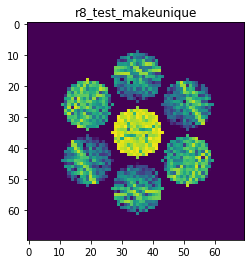

X_sim.max(): 0.9426592646184703
nlogf_X_sim.max(): 6.849765152490529
Time:  2000.563411566


In [22]:
Ug_t_exp_pred_matrix = [] #matrix to save the predicted {Ug,t} of the experimental pattern
Ug_exp_pred_matrix = [] #matrix to save the predicted Ug of the experimental pattern
t_exp_pred_matrix = [] #matrix to save the predicted t of the experimental pattern
simulation_pattern = [] #matrix to save the simulation pattern produced by predicted {Ug,t}
scale = 0.1 # scale of random offset 

DoDiverse = True
MakeUniqueUg = True

start = timeit.default_timer()
for i in range(0,trainsize+1):
    
    if i == 0:
        print('>>>train the initial training set:')
        Epochs = 10
        
    else:
        print('>>>replaced the {0:d}. dataset and train: '.format(i))
        Epochs = 3
    
    # load and compile the model
    model = load_model(name+'.h5')

    # invert the 1 channel image Array to 3 Channel, to use ResNet50
    X_train_3C = np.concatenate((X_train,X_train,X_train),axis=3) #same value for every channel
    X_test_3C = np.concatenate((X_test,X_test,X_test),axis=3)
    

    # train the model
    model.fit(X_train_3C, Y_train, validation_data=(X_test_3C, Y_test), batch_size=20, epochs=Epochs)
        
    # save the trained weigths of the model, delete the existing model
    model.save(name + ".h5")


    # plot the model loss
    plt.plot(model.history.history['loss'])
    plt.plot(model.history.history['val_loss'])
    plt.title('Model loss {0:d}'.format(i))
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    #plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Model_Loss' + '/' + 'Model_Loss{0:d}.png'.format(i))
    plt.show()
    plt.close()
    

    # Prediction of the testing set
    Y_test_pred = model.predict(X_test_3C)    
    Ug_test_pred_complex = Y_test_pred[:,:2*numUg].reshape(-1,numUg,2)
    Ug_test_complex = Y_test[:,:2*numUg].reshape(-1,numUg,2)    
    t_test_pred = Y_test_pred[:,2*numUg]
    t_test = Y_test[:,2*numUg]
    
    # plot the comparison of imaginary parts, real parts and thickness
    gs = gridspec.GridSpec(2, 2)
    fig = plt.figure(figsize=(16,10))
    
    ax1 = fig.add_subplot(gs[0, 0]) 
    ax1.plot(Ug_test_complex[2,:,0],'b')
    ax1.plot(Ug_test_pred_complex[2,:,0],'r')
    ax1.set_title('comparison of real parts of one datase')
    
    ax2 = fig.add_subplot(gs[0, 1]) 
    ax2.plot(Ug_test_complex[2,:,1],'b')
    ax2.plot(Ug_test_pred_complex[2,:,1],'r')
    ax2.set_title('comparison of imaginary parts of one dataset')
    
    ax3 = fig.add_subplot(gs[1, :])
    ax3.plot(t_test[:],'b')
    ax3.plot(t_test_pred[:],'r')
    ax3.set_title('comparison of thickness of all datasets')
    #plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Comparison' + '/' + 'My_Comparison{0:d}.png'.format(i))
    plt.show()
    plt.close()
    
    
    # Prediction of the experimental Pattern
    X_exp_3C = np.concatenate((nlogf_X_exp,nlogf_X_exp,nlogf_X_exp),axis=3) #X_exp.shape=(1,70,70,1); X_exp_3C.shape=(1,70,70,3)
    Y_exp_pred = model.predict(X_exp_3C) #Y_exp_pred = (1,191)
    
    Ug_t_exp_pred = Y_exp_pred[0,:] #Ug_t_exp_pred.shape=(191,)
    Ug_exp_pred = Ug_t_exp_pred[0:2*numUg] #Ug_exp_pred.shape=(190,)
    t_exp_pred = Ug_t_exp_pred[-1] 
    
    Ug_t_exp_pred_matrix.append(Ug_t_exp_pred)
    Ug_exp_pred_matrix.append(Ug_exp_pred)
    t_exp_pred_matrix.append(t_exp_pred)
    #np.savetxt("/Users/chenjie/pyQEDA/training_Data/My_Model_ZnO/My_Prediction/predicted_Ug_t_{0:d}.csv".format(i), Y_exp_pred)
    
    #if t_exp_pred < 0:
    #   t_exp_pred = np.random.randint(200,1001)/1000
    #   print("negative thickness, use random thickness: ", t_exp_pred)
    #   t_exp_pred = np.random.randint(200,1001)/1000
    #    Ug_t_exp_pred[-1] = t_exp_pred
    #else:
    print("predicted thickness:", t_exp_pred)
 
    
    # plot the results
    plt.plot(Ug_exp_pred[0:2*numUg:2],label='real')
    plt.plot(Ug_exp_pred[1:2*numUg:2],label='imaginary')
    plt.legend()
    plt.title('Prediction of the experimental Pattern')
    #plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Prediction' + '/' + 'Ug{0:d}.png'.format(i))
    plt.show()
    plt.close()
    
    # diverse the predicted Ug and thickness
    if DoDiverse == True:
        # scale will be reduced by iterations
        scale *= 0.99
        offset_Ug = (np.random.random()*2-1)*scale
        for j in range(len(Ug_t_exp_pred)-1):
            # for real part of Ug
            if j%2 == 0:
                # the offset if propotional to the magnitude of the Ug
                Ug_t_exp_pred[j] += offset_Ug*(Ug_t_exp_pred[j]**2 + Ug_t_exp_pred[j+1]**2)
            # for imag part of Ug
            else:
                Ug_t_exp_pred[j] += offset_Ug*(Ug_t_exp_pred[j-1]**2 + Ug_t_exp_pred[j]**2)
                        

    # normalization
    Ug_pred = np.array(range( np.int((Ug_t_exp_pred.size - 1)/2) ), dtype=complex)
    Ug_pred.real = Ug_t_exp_pred[0:-1:2]
    Ug_pred.imag = Ug_t_exp_pred[1:-1:2]
    Ug_pred_normalized = nf.normalization(file=File, origin_Ug=Ug_pred)
    Ug_pred_normalized = np.asarray(Ug_pred_normalized)
    
    # Make unique Ug
    if MakeUniqueUg == True:
            UgUnique, r0 = mu_3D.makeUniqueUgVector(Ug_pred_normalized,1,6,9,file = File)
            Ug_pred_normalized = UgUnique
    

    # reshape
    Ug_pred_normalized_2real = np.concatenate((np.array(Ug_pred_normalized.real,ndmin=2).T, np.array(Ug_pred_normalized.imag,ndmin=2).T),axis=1)  
    Ug_pred_normalized_2real = np.asarray(Ug_pred_normalized_2real)
    Ug_t_pred_normalized_2real = np.append(Ug_pred_normalized_2real.reshape(numUg*2), Ug_t_exp_pred[-1])
        
    
    # Compute the LARBED pattern: X_sim, from the predicted {Ug,t}: Y_exp_pred
    file = File+".qed"
    X_sim = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg=Ug_t_pred_normalized_2real, InputUgdoFlip=False)
    X_sim = X_sim.reshape(Nx,Nx,1)
    nlogf_X_sim = nlogf(X_sim)
    
    simulation_pattern.append(X_sim)
    print("X_sim.max():",X_sim.max())
    print("nlogf_X_sim.max():",nlogf_X_sim.max())
        
    
    # replace the training set & testing set with new training set
    if i < trainsize:
        X_train[i] = nlogf_X_sim               
        #X_train[i] = X_sim               
        Y_train[i] = Ug_t_pred_normalized_2real

        if i < testsize: 
            X_test = X_train[:testsize]
            Y_test = Y_train[:testsize]
        else:
            X_test = X_train[i+1-testsize:i+1]
            Y_test = Y_train[i+1-testsize:i+1]

stop = timeit.default_timer()
print('Time: ', stop - start)

-------------------------------------------------------------------------------------------------------------------

# IV. Compare the Prediction with the true value

1. diffraction pattern:

In [23]:
simulation_pattern = np.asarray(simulation_pattern)
print('the shape of the simulated pattern', simulation_pattern.shape)
print('the shape of the experimental pattern', X_exp.shape)

the shape of the simulated pattern (151, 70, 70, 1)
the shape of the experimental pattern (1, 70, 70, 1)


Text(0.5, 1.0, 'experimental Pattern')

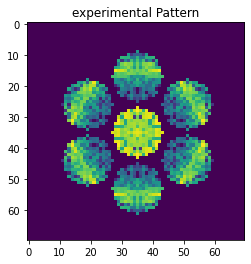

In [24]:
# plot the experimental Pattern:
plt.imshow(nlogf_X_exp[0])
plt.title('experimental Pattern')

Text(0.5, 1.0, 'simulation pattern')

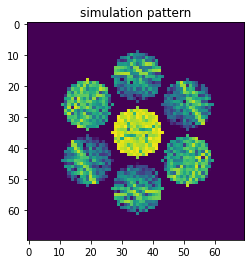

In [25]:
# plot the final simulated Pattern:
plt.imshow(nlogf(simulation_pattern[-1]))
plt.title("simulation pattern")

2. thickness:

Text(0.5, 0, 'iteration')

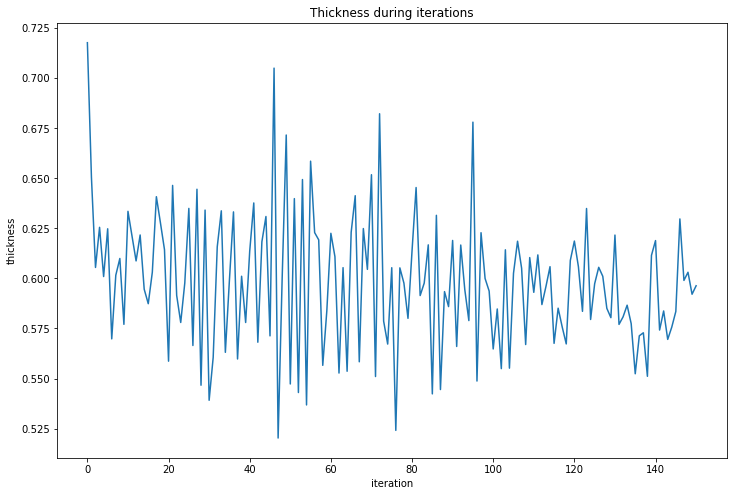

In [26]:
# plot the prediction of thickness during iterations:
plt.figure(figsize=(12,8))
plt.plot(t_exp_pred_matrix)
plt.title("Thickness during iterations")
plt.ylabel("thickness")
plt.xlabel("iteration")

3. R-factors:

Text(0.5, 0, 'Iteration')

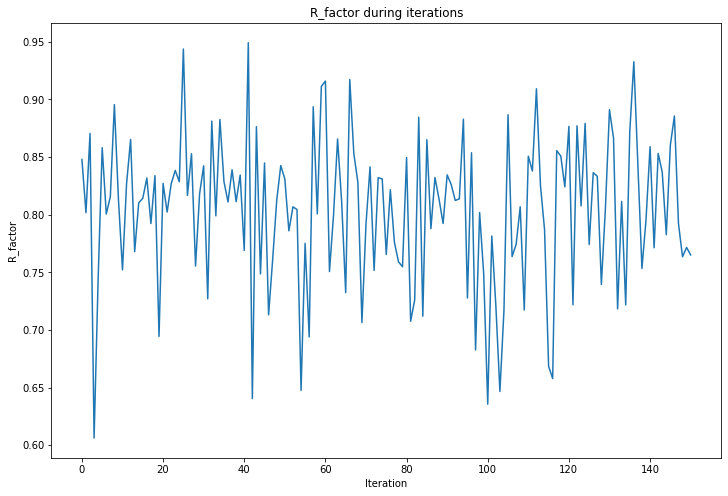

In [27]:
# plot the R-factors during iterations
exp_Intensity = X_exp.reshape(-1)
sim_Intensities = []
R_factors = []
for i in range(len(simulation_pattern)):
    sim_Intensity = simulation_pattern[i].reshape(-1)
    R = np.sum(np.abs(sim_Intensity - exp_Intensity))/np.sum(exp_Intensity)
    R_factors = np.append(R_factors, R)

plt.figure(figsize=(12,8))
plt.plot(R_factors[:])
plt.title('R_factor during iterations')
plt.ylabel('R_factor')
plt.xlabel('Iteration')

R_min: 0.6061624047424216


Text(0.5, 1.0, 'simulation pattern')

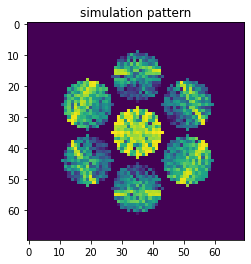

In [28]:
R_argmin = R_factors.argmin()
R_min = R_factors.min()
print("R_min:", R_min)
plt.imshow(nlogf(simulation_pattern[R_argmin].reshape(Nx,Nx,1)))
plt.title("simulation pattern")

In [29]:
t_exp_pred_matrix[R_argmin]

0.6255186